### Project 6
### Recommended System By Bappa Bhalsing

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
# Load Data Set
ratedf=pd.read_csv('ratings_Electronics.csv', names=['Userid', 'Productid','Rating','Timestamp'])

ratedf.head()

,Userid,Productid,Rating,Timestamp
0,AKM1MP6P0OYPR,0132793040,5.0,1365811200
1,A2CX7LUOHB2NDG,0321732944,5.0,1341100800
2,A2NWSAGRHCP8N5,0439886341,1.0,1367193600
3,A2WNBOD3WNDNKT,0439886341,3.0,1374451200
4,A1GI0U4ZRJA8WN,0439886341,1.0,1334707200


In [3]:
ratedf.shape

(7824482, 4)

- Data Frame has 78 Lakh plus rows and 4 columns. This is Big Data and may encountered with memory issue with Personal Computer or non productional machine.

In [4]:
ratedf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7824482 entries, 0 to 7824481
Data columns (total 4 columns):
Userid       object
Productid    object
Rating       float64
Timestamp    int64
dtypes: float64(1), int64(1), object(2)
memory usage: 238.8+ MB


- User ID & Product ID are Object type and Rating is Float type and Time Stamp is Integer.

In [5]:
ratedf.isna().sum()

Userid       0
Productid    0
Rating       0
Timestamp    0
dtype: int64

In [6]:
ratedf.isnull().sum()

Userid       0
Productid    0
Rating       0
Timestamp    0
dtype: int64

- Rating Data does not have any missing value or Null Value.

### EDA

In [7]:
ratedf.describe().T

,count,mean,std,min,25%,50%,75%,max
Rating,7824482.0,4.012337e+00,1.380910e+00,1.0,3.000000e+00,5.000000e+00,5.000000e+00,5.000000e+00
Timestamp,7824482.0,1.338178e+09,6.900426e+07,912729600.0,1.315354e+09,1.361059e+09,1.386115e+09,1.406074e+09


- Mean of Rating is 4  & 50 % value of Rating is 5 indicates maximum value of rating is above 4. This type of distribution may lead to Outliers
- Only 25 % data have rating below 3 or equal to 3

5.0    4347541
4.0    1485781
1.0     901765
3.0     633073
2.0     456322
Name: Rating, dtype: int64


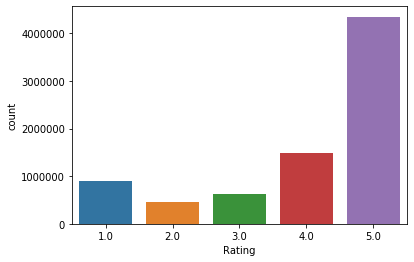

In [8]:
sns.countplot(data=ratedf, x=ratedf['Rating'])
print(ratedf['Rating'].value_counts());

- Data having rating of  4 & 5 are highest in number that of rating of below to 4
- 43.47 Lakh Consumers has given rating of 5 & 14.85 consumers has given rating 4. So total 58 lakh plus customer has given given rating above 5

### Insight in Data Sets

In [9]:
print("Unique Information of data ")
print("*-"*40)
print("\nTotal No. of ratings :",ratedf.shape[0])
print("Total No. Unique of Users   :", len(np.unique(ratedf.Userid)))
print("Total No. Unique of products  :", len(np.unique(ratedf.Productid)))

Unique Information of data 
*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-

Total No. of ratings : 7824482
Total No. Unique of Users   : 4201696
Total No. Unique of products  : 476002


In [10]:
# Dropping Time stamp Column from data sets
ratedf1=ratedf.drop('Timestamp', axis=1)

In [11]:
ratedf1.head()

,Userid,Productid,Rating
0,AKM1MP6P0OYPR,0132793040,5.0
1,A2CX7LUOHB2NDG,0321732944,5.0
2,A2NWSAGRHCP8N5,0439886341,1.0
3,A2WNBOD3WNDNKT,0439886341,3.0
4,A1GI0U4ZRJA8WN,0439886341,1.0


### Popularity Recommender Model

In [12]:
#Keep the users only who has given 50 or more number of ratings

new_df=ratedf1.groupby('Productid').filter(lambda x:x['Rating'].count() >=50)

In [13]:
new_df.head()

,Userid,Productid,Rating
183,A1BKC6B7YHYTVV,0972683275,4.0
184,AWVFSIB42LHKJ,0972683275,4.0
185,A36MQBNADRH8YY,0972683275,5.0
186,A3SRXMPLAEZ6DP,0972683275,4.0
187,A20XXTXWF2TCPY,0972683275,5.0


In [14]:
new_df.shape

(5374313, 3)

- Data frame size has been reduced from 78 Lakh to 53.74 Lakh and kept only user who has given 50 or above ratings

5.0    3070257
4.0    1017201
1.0     572060
3.0     415370
2.0     299425
Name: Rating, dtype: int64


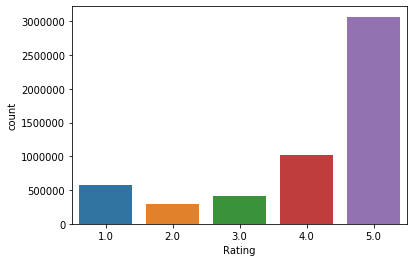

In [15]:
# Repeated previous step
sns.countplot(data=new_df, x=new_df['Rating'])
print(new_df['Rating'].value_counts());

- In new data frame,  40 Lakh plus users have rated above 4 rating

In [16]:
new_df.groupby('Productid')['Rating'].mean().head()  

Productid
0972683275    4.470980
1400501466    3.560000
1400501520    4.243902
1400501776    3.884892
1400532620    3.684211
Name: Rating, dtype: float64

- The Output indicates mean rating for every product given by users

In [17]:
new_df.groupby('Productid')['Rating'].mean().sort_values(ascending=False).head()  

Productid
B002E6R7NG    4.980392
B004I763AW    4.966667
B003J9QQWU    4.964286
B0043ZLFXE    4.955556
B000TMFYBO    4.953125
Name: Rating, dtype: float64

- Highest mean rating is 4.98 goes to product B002E6R7NG. This also given kind of Recommendation for next buyer/User
- Likewise recommendation pattern followed for other products

In [18]:
new_df.groupby('Productid')['Rating'].count().sort_values(ascending=False).head()  

Productid
B0074BW614    18244
B00DR0PDNE    16454
B007WTAJTO    14172
B0019EHU8G    12285
B006GWO5WK    12226
Name: Rating, dtype: int64

- In this output product id B0074BW614 received 18244 ratings also an attention seeker for potential buyer.

In [19]:
ratings_mean_count = pd.DataFrame(new_df.groupby('Productid')['Rating'].mean()) 

In [20]:
ratings_mean_count['Rating_counts'] = pd.DataFrame(new_df.groupby('Productid')['Rating'].count())  

In [21]:
ratings_mean_count.head()

,Rating,Rating_counts
Productid,,
0972683275,4.470980,1051
1400501466,3.560000,250
1400501520,4.243902,82
1400501776,3.884892,139
1400532620,3.684211,171


The final out put of Popularity based recoomender system shows that product ID has recieved Count of Rating and Rating. This way of recommendtion will help potential buyer to choose right product.

In [22]:
ratings_mean_count.describe()

,Rating,Rating_counts
count,26226.000000,26226.000000
mean,3.980288,204.923092
std,0.527460,437.950769
min,1.127273,50.000000
25%,3.677881,67.000000
50%,4.074805,100.000000
75%,4.375000,188.000000
max,4.980392,18244.000000


### Splitting Data in Train and Test Set

In [23]:
from surprise.model_selection import train_test_split
from surprise import Reader
from surprise import Dataset
import os
from collections import defaultdict

In [24]:
# Reduce the Data Frame rows as this is big data encountered with Memory Issue with 54 Lakh rows.
# Selected only first 1 Million rows
df_col=new_df.iloc[0:1000000,:]

In [25]:
#Reading the dataset
reader = Reader(rating_scale=(1, 5))
data = Dataset.load_from_df(df_col,reader)

In [26]:
trainset, testset = train_test_split(data, test_size=.30, random_state=100)

### Collaborative Filtering Model

### Item-Item Collaborative Filtering Model - with Cosine Similarity

In [27]:
from surprise import KNNWithMeans
from surprise import accuracy

In [28]:
algo = KNNWithMeans(k=5, sim_options={'name': 'cosine', 'user_based': False })

In [29]:
algo.fit(trainset)

Computing the cosine similarity matrix...
Done computing similarity matrix.


In [30]:
# run the trained model against the testset
test_pred = algo.test(testset)
test_pred

[Prediction(uid='A2WDK8LH3X0JGF', iid='B00009R6TA', r_ui=5.0, est=1.215809685641462, details={'actual_k': 1, 'was_impossible': False}),
 Prediction(uid='A33WZ2TAWSBPXO', iid='B000WL6YY8', r_ui=5.0, est=4.0591485714285716, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='AEQYAG42F9128', iid='B000G5S4JI', r_ui=5.0, est=4.531914893617022, details={'actual_k': 0, 'was_impossible': False}),
 Prediction(uid='A1SWSWXNVYV4FH', iid='B000P0PF9G', r_ui=5.0, est=4.0591485714285716, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='AER6PLWWPWH9I', iid='B000O3OEGE', r_ui=4.0, est=4.0591485714285716, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='A3KZ04F9JOJFNI', iid='B00007KDVI', r_ui=5.0, est=4.0591485714285716, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='A2J1O7OGAH0VMP', iid='B0007ZL6DS', r_ui=1.0, est=4.05914857142857

In [31]:
# get RMSE
print("Item-based Model : Test Set")
Accuracy1=accuracy.rmse(test_pred, verbose=True)
Accuracy1

Item-based Model : Test Set
RMSE: 1.3481


1.348090083487297

In [32]:
results = pd.DataFrame({'Model':[['Item-Item Collaborative Filtering- Cosine Similarity']], 'RMSE': [Accuracy1]},index={'1'})
results = results[['Model', 'RMSE']]
results

,Model,RMSE
1,[Item-Item Collaborative Filtering- Cosine Sim...,1.34809


In [33]:
def get_top_n(test_pred, n=10):
    # First map the predictions to each user.
    top_n = defaultdict(list)
    for uid, iid, true_r, est, _ in test_pred:
        top_n[uid].append((iid, est))

    # Then sort the predictions for each user and retrieve the k highest ones.
    for uid, user_ratings in top_n.items():
        user_ratings.sort(key=lambda x: x[1], reverse=True)
        top_n[uid] = user_ratings[:n]

    return top_n

In [34]:
top_n = get_top_n(test_pred, n=5)

In [35]:
top_n

defaultdict(list,
            {'A2WDK8LH3X0JGF': [('B00009R6TA', 1.215809685641462)],
             'A33WZ2TAWSBPXO': [('B000WL6YY8', 4.0591485714285716)],
             'AEQYAG42F9128': [('B000G5S4JI', 4.531914893617022),
              ('B000O7K4LO', 3.4218009478672986)],
             'A1SWSWXNVYV4FH': [('B000P0PF9G', 4.0591485714285716)],
             'AER6PLWWPWH9I': [('B000O3OEGE', 4.0591485714285716)],
             'A3KZ04F9JOJFNI': [('B00007KDVI', 4.0591485714285716)],
             'A2J1O7OGAH0VMP': [('B0007ZL6DS', 4.0591485714285716)],
             'A19QPZX5RRX8CV': [('B0006O4VNC', 4.644444444444445)],
             'A259ZXULSLXW3U': [('B0002SQ2P2', 4.0591485714285716)],
             'A3711SB7YUXY8X': [('B00005UK9P', 4.0591485714285716),
              ('B000NVLQ72', 4.0591485714285716),
              ('B000OP8BVG', 4.0591485714285716)],
             'AF954PR8BJFVA': [('B000EGLZU4', 3.7818181818181817)],
             'ATZNS83HXZHD5': [('B000CCXCYC', 4.0591485714285716)],
           

In [36]:
# Print the recommended items for each user
for uid, user_ratings in top_n.items():
    print(uid, [iid for (iid, _) in user_ratings])

A2WDK8LH3X0JGF ['B00009R6TA']
A33WZ2TAWSBPXO ['B000WL6YY8']
AEQYAG42F9128 ['B000G5S4JI', 'B000O7K4LO']
A1SWSWXNVYV4FH ['B000P0PF9G']
AER6PLWWPWH9I ['B000O3OEGE']
A3KZ04F9JOJFNI ['B00007KDVI']
A2J1O7OGAH0VMP ['B0007ZL6DS']
A19QPZX5RRX8CV ['B0006O4VNC']
A259ZXULSLXW3U ['B0002SQ2P2']
A3711SB7YUXY8X ['B00005UK9P', 'B000NVLQ72', 'B000OP8BVG']
AF954PR8BJFVA ['B000EGLZU4']
ATZNS83HXZHD5 ['B000CCXCYC']
A2JMN2JA9LSHVL ['B00020M1U0', 'B000PCVF3E']
A19YFOIT52CUPU ['B000CRT07U']
A2NYCTR10V9216 ['B00000DM9W']
AHV8UBV8XHBGH ['B0002GUBIS']
A2G7B5HKPFE5GL ['B0002WPSBC']
A2RKYZQPNB2YUU ['B000EOSHGQ']
A2BB9J6BV87SJE ['B0000CD7K9']
A3LGFT8Z2CL2AO ['B0006TIA02', 'B000NVLQ72']
A3DHMZXGO6VMDH ['B0002Y5WZC']
ADO6AKL7LF41B ['B000RGZMYQ']
A10HIKD7U5JNJN ['B000EVM5DU']
A1J1GI9JV9CFW8 ['B000NQ16NG']
A5QKADY7T6ZIK ['B000UO796Y']
A2265D1MIL1LQL ['B0002L5R78', 'B00005ML7Q', 'B000BV8604']
A2Z99HWM5C0FVB ['B0002BETIG']
A2FNCKLZ9AOYN3 ['B000U8Y88M']
A1K93O68KBD1LE ['B000I06JLQ']
A2RVNSH8OWDM0D ['B000MX48VM', 'B000T925

AQHQSBSC8J6PE ['B00067OF80']
ARGA909RRJ5UO ['B000J01I1G']
ATDCD0OX40ST6 ['B000204SWE']
AVPAK0CI6J6VM ['B0000633EM']
AT0344NUEA1OZ ['B000F7QRTG']
A2N8PNR6HFHVBY ['B000P0NJPS']
A3V3JNQV41PFT6 ['B000M87F0I']
A27FWDXVTHQORN ['B0009EUSYU']
A2D1GP3JX6371B ['B00007KDX5']
A2OYI5K56B5HOP ['B00005NVBF', 'B00005O0IU']
A3NIB2ARQLIAH5 ['B000095ISG']
AAQ60HXJCFFQB ['B0001WXTF0']
AMK55MIRG2OOF ['B000EVSLRO']
AF03HWQM4UIG4 ['B0009V6TL4']
ARQM5Y5C289R ['B000WAHFBK']
A1VUGOPL65G37B ['B0000665V6']
A2DLILEQX8UAH ['B0002Z241Q', 'B000GD3J3G']
A295VPW9H9BB8X ['B000EUGX70']
A1SH0KMPSKGVE4 ['B000051299']
A3O7MRFJ8ZGRCB ['B000RPVGJ2']
A1NE9O2JWOE7UB ['B000I68BD4']
A1ZBT6KCS1SX55 ['B00005N6KG', 'B00004T8R2']
AHRC05FW8ZXUL ['B000BP8GQO']
ALIACMRLJXG0V ['B0007N55NW']
A4NKBV40VAZAL ['B000BQ7GW8']
A256SA0PNN78BD ['B000UMX7FI', 'B000NW12C0']
A5BL0E7LDR0AE ['B000LRMR26']
AMPE1W2496JL1 ['B000QIZXHG']
A14YFK2MI8TUPW ['B000TG4BA0']
A28IWJLIDCPJMP ['B0002HS1A2']
A2WH7MDKT3K7DG ['B000JZDKW6', 'B0000A1G05', 'B0001OY2W2']
A6

A17BUUBOU0598B ['B000BR0MFK', 'B000V9RL6G', 'B000UHE8Y2', 'B000UZN2ZK', 'B000WM2YS2']
A1905TLFXR39ZM ['B0000665P5']
A2FAI2LPS324PO ['B0009L1GMG']
A3GIKVYVAFPUB2 ['B00008OE43']
AFU1MF7T2DY92 ['B000CQPWMS']
A3HVIXLT2E8ZUO ['B000065DQ2', 'B00007E7JU']
A3RBPRZRFBAM3X ['B0009VFOME']
A1JD4FJT4VWTNV ['B000JNQSIQ']
A1DR4YFB35CH8S ['B000E6G9RI']
A38DXZX3P56XCF ['B000EFIJTA']
A35WJ9VHFIGXVW ['B000EDK8XC']
A3723S42U95CJV ['B000GEBEDM']
A2DDDKF5NZMTFY ['B0009VKJH4']
A2ANIYAD69UG6Q ['B000GG5LUW']
A1MDUZ9UXWM3HB ['B000MF7L50']
A1I6D6PSZ0WLGB ['B000OH26OM']
ABNI7Z61A82R4 ['B000BFHWXM']
A5PYXHJ92YKEK ['B000M51NRM']
A23IK250Y080DN ['B000LRMS66']
A3TVVGOQA63BPC ['B0006Q7FFG']
A21846EO7C6A7K ['B000DZFWL4']
AAQ1SDZPZUX2T ['B00028ONIA']
A12B2Q2P8TJG0 ['B000V5G4TK', 'B000792SA4', 'B000NKJ2X8']
A241SJK6Q2ZGGQ ['B0007QCO6A']
A3UTE2KMYA7DF7 ['B000IDC0K2']
A2KIF687BQ27ZJ ['B0002L5R78']
A31WLCHSRE0ZE9 ['B000A6NUUQ']
A1IHTBXXPG6F6C ['B000ANCPNM']
A2YTJFYH5JS7Z8 ['B000IKWBC2']
A3BLVHIYD3MU02 ['B0002EKEHS', 'B00009

A36DIV945P3H6L ['B000M2TAN4']
A163EC6K3HBC51 ['B000EEQ83K', 'B00067TTY0']
A1UEE2X9TH9EU ['B0002ZPJZY', 'B0001G6U9I']
AONKMC9CQP4FC ['B000JV9LUK']
A34I19FV69P6Z1 ['B000RQSGYO']
A2MO86UQ0OQU17 ['B00003CWDH']
A28ZVJUVL4041C ['B000067SMH']
A32P4MLAR4TOLZ ['B000H859RE']
A1U0LRBFD06ZAS ['B000092YPR']
A3EJ859FCT30GR ['B000CC6I5W']
A3BJM4Z3CELVLZ ['B000FHAXPA']
AKJ9UIHPKCUC ['B0007R4LI8']
AWSCMPPM5BLZ8 ['B000NONHYY']
AQ9AZVC6Q9SWD ['B000EW8074']
A25FL6VLD7S23S ['B0000BZM56', 'B000EOSHGQ', 'B000V2FJAS', 'B000144I30', 'B000FKKWVM']
A6JMOLDZ95VQ9 ['B000O5U150']
A3TP64ZNHPBOWD ['B0002F8578']
A2SLOF5VO6GIMI ['B00007E7JU']
A1V4YKYMMY5KN4 ['B000ENRQ3M']
A34PYPXWOW0330 ['B000P3X7OI']
A16I1ZG3MBLZUW ['B000F9YN22']
A1IN9HECIIO6CV ['B00008VIX2']
AH2FSBOFFV8ZD ['B00004T8R2']
A12SBBKH5LD4NS ['B000N4Z42C']
A3QBN7UFUIFYO7 ['B000NWVAFO']
A24BVF6L2R6ZN0 ['B000IXLHM4']
A28FVQEDXE0O17 ['B000VM60I8']
AM8OUD9CL1EST ['B000X24ISU', 'B000F9YN22', 'B00008Z1PS']
A34IZRVZ7XW3SX ['B00005V619']
A3M5OCKK0WRX6W ['B00007IFDR

A2F2MG56UAXTKW ['B000P708NM']
A358R25UWYI07D ['B000QD7B6W']
A3FANIYI39B13P ['B0007QKMQY']
A2QHY3CL43OU7K ['B000067RVL']
A3ME4DE1J9J6LY ['B000EVM5DK']
A13MKSASQ6YWL7 ['B000Q30420', 'B00000JMUG']
A7DYUDANTXOSM ['B000U5TUWE']
A347HCE9FMP734 ['B00005T3G0']
AANG87SKNL3T7 ['B00007KDVI', 'B0000U19F0']
A2LZYZ5QE4I99U ['B000WL6YY8']
A11UZ3ZP2K51S2 ['9575871979']
A1O1EG2GIB8BWJ ['B000QD7B6W']
A1O6GX06QPGTQB ['B000066AX5']
A13NHGQPXYSJBC ['B00022OBO2', 'B0000AZK4G']
AJHRVLWMD7WGM ['B000V0IE6G']
A362V1J4KQ92S5 ['B0000645C9']
A19YPCHH02WHVV ['B00005853X']
AUQZN4U4IIUHY ['B0009VU7TO']
A3JV4L6ZKF7LDP ['B000SNOT4C']
A3OH101U0CPUC7 ['B000I5JHB0']
A1QVRJDP1O2C1P ['B0007MGG2M']
AOFTTU1IA9Z91 ['B0002DQUHC']
A14BFRX08D7GK7 ['B000VOE466']
AZJEHF2URL3PF ['B000PKX2KA']
A3MPWONT80G4RQ ['B000HB2TJ2']
A2S8H7LWMRT3W4 ['B00009UHXR']
A1AN1NJL5GYDSU ['B0002Q7VO0']
A2QVUMOS8E48TU ['B000NHWM0G', 'B000FJEYZS']
A3FON9LQUAWD0 ['B000OK2X6K']
A19JPSG27CKML2 ['B00007E7JU']
A3O9UWB45ICKGR ['B000EXS1BS']
A35N8F5V2PELR9 ['B000

A2NY9QI3U54J57 ['B00028VKLI']
A1A4SQ21KCO8PD ['B000V4PZFU']
A1FVORC8EOPEF5 ['B00007E7JU']
AOP9FIY9U6PNN ['B000IVDIL4']
AYINNKPX9D60N ['B0001Y7UAI']
A2GVM2T7J83D22 ['B0002L5R78', 'B000ELOQS2', 'B000VTYKRY']
A178E2574H56ZJ ['B000EVM5DU']
A1EK3R97CLC6TV ['B0001G6U3Y']
A1WGP8235KFSRD ['B00006JQ06']
A1XB35WU964AXP ['B000EVSLRO', 'B000B9RI14']
A1WO22UUOLNK3L ['B000EGI7V4']
A3V6FQ71RSCHQW ['B000KE48CM']
A14RNU5S6FW7Y1 ['B000JJSQBW', 'B000MT4JTC']
A149C701MLJDJC ['B00005NHHA', 'B000089GN4']
A2H9K1YJ51ZCG5 ['B0001OQTLY']
AVBTEZN2JIF7I ['B000ELQTZA']
A1ZXG11BS594QU ['B000K41PH8']
A27LV094I6P35C ['B000067RBT']
A3BWOI7M52JVDM ['B000WL0I1I']
A1TQBKX1FWYR98 ['B0007LJHVK']
A2MILLVISBQTAD ['B000SJ2TJ8']
A1GA32BU0SRF8T ['B00005LEN4']
A17FECXYPT9DPN ['B00007EDM0']
A2JZJW039EY1K3 ['B000CSOXTO']
A5P3J5S3MIU0G ['B000JVBU9K']
AJ2DDZO4V2FLN ['B000NUYW92']
A1ZKHJIB0FHNW8 ['B000089GN2']
A266TEDQQ5XBMU ['B000ER5G58']
A31JSBFUVQG9J8 ['B000EUGX70']
A2KUMZNIQGGJ0P ['B000SDW84K']
A3V3FIOW3VKC99 ['B0009HTB0Y']
A2JE9

A1NPXLJ03TYNPR ['B000GK8LVE']
A3PEZ2H03S1H75 ['B000AP05BO']
A15C5S0L07Z6FT ['B00004Z5M1']
AE5UGQ696VKHE ['B000X1TS54', 'B000V7AF8E']
A2NNNB8T53QELU ['B0006FS1Z0']
A2ZSNUA075J9IJ ['B000WAHFBK']
A2Z2T4QRWPCQEC ['B000WYVBR0']
A28856U9KKTWJV ['B00006B9HK', 'B000GGQ2ZU']
A1IURMNU5CY5Q5 ['B000QUUFRW']
A2UZBOLV32OMMB ['B000WYVBR0']
A2WIE0EQTKW793 ['B00004T8R2']
A12TBZQJPRHMJG ['B000NW12C0']
AELNN5H8I4LHP ['B000FNPW96']
A2CJO12IHT54XU ['B000B9RI14']
AHX8LNAYUCL8W ['B00006I5J7']
AOX7UMYFJKQTD ['B000H72MMU']
A1IA7FU6QKFKI6 ['B0002BF0DE']
A3MV2P6F0Q16NL ['B000OV85NE']
A1CT54WX5QTHPT ['B000UE50O2']
A2OP5KE97195VP ['B00065TGTA']
A2I2JBZS9COVFD ['B00030099O']
A3KPRWU6ZD46LD ['B00005ATMB', 'B000C3UWHQ']
A1VYZEFSEOI8AK ['B000BP50AY']
A2F0HMMTODQHNK ['B000GYI76Y']
A1CDY0ZKLU9DYV ['B000U9XMCE']
A32IBIB674FEXF ['B000BP50AY']
A2B47B8FJ8RQ9H ['B0002BEX8W']
A13OR6VTA2EBH9 ['B000V5K3FG']
AQJRKHAWU1TCU ['B000F6X7RM', 'B00008AWL0']
A1GOJ9RE4IZHJ0 ['B000ERAIQ0']
A2GZUAOK5JLN92 ['B000AMDOEM']
A220DD0KFLGHN8 ['B0

A3O1QQD3BFLH0E ['B000BTL0OA']
A2ETIRVKYDDTKK ['B000VQ7ZK6']
A3L61LOQ3YR4AO ['0972683275']
A2O74WBGST28A8 ['B000928KII']
A1KA2W0B1AOO8O ['B000EMPPBS']
AEJQUN79JRMIT ['B000WL6YY8']
A1SCG9DEXBWZ1L ['B000067O5G']
A2ZPKJHRUWRVCD ['B000VX6XL6']
A2PZO2V0HWG7IF ['B000SDW84K']
A2X3DND07EKBKU ['B0009Q4UBK', 'B0000DIFGJ', 'B000CS1JRS', 'B00005NWR0', 'B000050NPX']
A4979ZEMAC08C ['B000CKVOOY']
A25X07RKY3X40D ['B0002L5R78']
A3G8QP7NK5RZP9 ['B000I68BD4']
A2Q3AARSZVM6P1 ['B0009JB7GI']
A3V3E44A0CKQOU ['B000U5ROZE']
A2P1Y7OIBIVCJR ['B0009OAFJ8']
A2I0HOY7DY69CA ['B000O7PH34']
A1TBIDJ5Q7HB46 ['B000HPV3RW']
A2BDXM5UX5PJZ4 ['B000I62PEU']
AKBWS9IAR3PTG ['B000SP2F1Y']
A2QMEDE4UG3C4V ['B000WH6H1M']
A1CKZGG8OQ2DTS ['B0006OCFFS']
A2EF252J45XMZ2 ['B000RZNI4S']
A27XPVJ5E5XF8G ['B000IN09C8']
AH98ULE5FDC8X ['B000EB7OTU']
A2B6WEJ1TY1FXO ['B00007GQLS']
A2JYJPRNXHKRO1 ['B00009R9EO']
A2WI0506D525AE ['B000RJTZZ0']
ALBAU0Z3HG6GH ['B000VWKSHM']
A126ZIW0CAQZRT ['B000FW1X4K']
A1NXWWFUDUD09W ['B000LRMS66']
A27R8EDFGBEL30 ['B0

A7SPDLZWWJ5OT ['B000RHZJN4']
A6EH58AKFHXTH ['B000U94KMU']
A3G1RJW6BL2SYA ['B000B0NC2W']
AVP03K2I6YV5P ['B000AUIM9G']
A2B8FTE77TVBJ4 ['B00068DIB4']
A282GHZU48ONQZ ['B00022OCCI', 'B000IJY8DS', 'B000067SRA']
A2MPPP0IOJBT5E ['B000JMJWV2']
A1ZBR4NYVGY7U7 ['B000JQ3A7A', 'B00004T8R2', 'B00006JN3G', 'B00006I5J7']
A19TYYNNZ59TFB ['B000I4WHD6', 'B000H51GA6']
A1QJBX1FOG1PFO ['B0006TI9WG', 'B000V3H0OA', 'B0007S8C7I']
ARQ8LLDMHAQDY ['B0002DUQCM']
A2P1EJLJU43M7S ['B00006JN3G']
ABZK6MDWYBPVC ['B000GL3MOY']
A3W1293LH215QY ['B000CC6I5W']
A251DNCRYU6LQX ['B00003CWDH']
A37UFGCMY6MTQ4 ['B000JLP5UK']
A445NFQBXAAK3 ['B00021EE4U']
AI8K26A44NG30 ['B00007E7C8']
A27U78QJF28G0D ['B000A6JTHO']
A146CA37V0450V ['B000RZQZM0', 'B000Q8UAWY', 'B000087NBV', 'B000E9U9GC']
A2QZT9L3HLEFTL ['B000EY5F5C']
A1ZTVXB13ZSLFL ['B000092YQW']
A1R3RSFQ6GPZV4 ['B0000510ZO']
AZXE7L2Q0E0CM ['B0000E6I1N']
A2ZH05XHYUL4UU ['B0007TC9LW']
A36B7738LJU47R ['B000JFGAUU']
AR8LHJV7AOO8A ['B000ACGQI8']
A10WSSQ48YBFHP ['B0009EXWJS']
A3MEGYZW0RGPK1 

A355RC1I9JEK4H ['B000VIHFZ4']
A3UXK8YRT64E5K ['B000RZQZM0']
A2CRBUPC7KJNPD ['B0000DIESW']
A2FD834RITVVXH ['B000R9AAJA']
A3OUTOY7M7MCWI ['B000P17188']
A5UOYKJN3CQJY ['B000652T8A']
A3RWIM0OZN2X5M ['B000TKHGL2']
A1FCIXTLGHJ0F5 ['B00007KDVI']
A1NYS963A059CS ['B000F7JCRA']
A3HQDM4SRL2IE8 ['B00009KH63']
A3MGDRV8R5NELV ['B00008X5DF']
A1DD1UTFUCH4KS ['B0009TQB00']
A1FCN0ZKCUWNHB ['B000165AS0']
A3K2BMCVK6QXF ['B00005853Z']
A2LA6G058AZZ78 ['B00028ONIA']
APHNGFZ8C7BW6 ['B000ON9TKU']
A1NADKSHMF3S6K ['B000LRMS66', 'B000PDR230', 'B000AYGDIO']
A1XNLU6ID8C4SB ['B000FBF400']
A3UR8JHIKV3IN0 ['B00009R6TA']
A33CFQECCWY4Y7 ['B0000DZET4', 'B000VX6XL6']
A1FO3OU4UXKDZV ['B000BI2CIO']
A193V72VSNG8OU ['B00009UT9B']
A28HUBMSCXVQW0 ['B000UVM0ES', 'B000BIFY6Q']
ANL9515LFN0Y3 ['B000TB0RY4']
A0196552RI15HI7JB9PW ['B000P8AUMU']
A2I9LWM2C7BRBY ['B0000632H7']
AMMPHM3SZBCJA ['B000I68BD4']
A2H9IWFL1TIDVN ['B000U9WVW6']
A9TMVRRS7A8NZ ['B000I4RMOU']
A1YRTS7C4UNHTS ['B0000D8IYC']
A47XRQSLBUSZA ['B000I5PGOM']
A20VL4VCI9OB7X 

A15P80UWO3GL9 ['B000GZYMHG']
A1E7KSJ9FE7VOJ ['B000M87F0I']
A2NOEX4EJZ8DV3 ['B000MVJ1M0', 'B000MVJ1MA']
A13OUS97G7238Q ['B000167OAC']
ATIIHGKE8T29H ['B00007KDVI']
A12NL7W0O8QKZF ['B000BDG3HU']
A2R6F8XP2DL6RC ['B0001F347K', 'B000652M6Y', 'B000J3G2CS', 'B000067VBM']
A1ROPQIE3UMS9I ['B000F28DP2']
A8W5EOI5L899L ['B000FVDD30']
AI8TK2C8KHG7W ['B0006HTZ76']
A2ML7XZQX41FLH ['B0000BVV37']
A39BKKMP3EKBUJ ['B000P8AUMU']
AHLRVGFTJ9WEI ['B000I1ZWRC', 'B000NVSPZI']
A3I22LDNH0ESKB ['B000EVOANS']
A2F0NLARH224U2 ['B000PT18OS']
AINKPPMFPV2VI ['B000HZDF8W']
A3LS9YCADGEVQP ['B0001FV2YM']
A2Y0G6XI8ZSENP ['B000AUIM9G']
A1KK677IJW6U2E ['B000I68BD4']
A24ALQJ7JNZIG6 ['B000069K98']
A296A6HRQBEUG ['B000EOPQ7E']
A28DV1VC62GB7Q ['B000JMJWV2']
A806MUC4D2IYE ['B00009R6TA']
A1KSX31BBOH0BI ['B000BJ3BRO']
A1NQ8N42841FHE ['B000095SB6']
A132L0QWXE6B1 ['B000B6MLPU', 'B000T8PTLI']
A23PE01NIDX7ML ['B000092YPR']
A8EUHW6V9D95L ['B000VG802I']
A35GSI5ZVHQBB6 ['B000V01RLK', 'B0000C3GWU']
A1A7OZE69QJZQL ['B00007E7C8']
A29O78Z2NTRF

A32N18QV8VDZGC ['B000TKHBDK']
AECABZ3I5R3CI ['B000NOR7PY']
A2I05JD95B6N89 ['B00001WRSJ']
AWTFA96VPVIC1 ['B000243DNA']
A53B2U9NQTDLX ['B000FIY08U']
A1E9N1CEAORM37 ['B00004Z6Q6']
A2G0V99FJDEJ7N ['B0009204RI']
A2T4OJPEP5BSXD ['B000067O5G']
A1L27Y8KMJP165 ['B000TG4BA0']
A1FEYQT17OO7QI ['B000UV4EU6']
AYWIO6OYAGFGQ ['B000WKTG76', 'B000779RZA', 'B00000J434', 'B0000C20XD', 'B000JLKIHA']
A2JPI61CPEPJ6L ['B000BM2Q7W']
A1VN8NNYQF3NOL ['B000F657DY']
A3309FT3AXMNR1 ['B000HZ9CCA']
A2MNCI51C2L34I ['B000BI95W0']
A2KHV9BF02Y4LH ['B00004Z5L8']
A3U33FRD5JY8EG ['B000066R6M', 'B0000EI9UC']
A1KD8MR1V4JVK0 ['B0000AI0N1', 'B000068P8W']
A2D9VD96W8PADC ['B000M2TAN4', 'B000A4AWE0']
A1VZYUWUOZ0LKI ['B000DZG66O']
A1TQBAHI3M4ZBQ ['B00020S7XK', 'B0002L5R78', 'B0000A0AEM', 'B000HWVOFQ', 'B0002E52S4']
A35E3SV65VIUEW ['B00006B7RK']
A25PNHM97EALLU ['B000M5UO04']
A115ID0V6WU7HO ['B000SAB34O']
A1H3PB8ETA7NGJ ['B0009EXVFI']
A1CW0LQZFP4LSW ['B0009K9FZW']
A7637GCCXH6QG ['B000JO7PIM']
A21F9QHZIQH13I ['B000M5VXVS']
A1CWDJBIBMN

A3RAJ6EN3POXB2 ['B0000DYTDJ']
A1VBDWDOPWECZU ['B000OG4E1G']
A1YBYEHRO9PKB7 ['B00006JPRQ']
A2T18JHPEE7ZT ['B00006HOKR']
A2UVID538TQPLG ['B000IDUP3G']
A2O2GMLAFFMLWA ['B000R9AAJA']
A2H260NEWAINP6 ['B000V07N9U']
A31I106E3JP257 ['B000OFSN4G']
A338RSQZINFCK ['B00007E7JU', 'B00092GM0Q']
A18LMESO7EN5BQ ['B000UEZ36W', 'B0007Z1M50', 'B000P8Z3MM']
AQKE1P82T8QHF ['B00006JILW']
A24DSEDXMM0F8A ['B0000WKYU4']
A2JS0FAIHCAUG1 ['B000B69WVG']
A3R803J7QXVUI1 ['B00006JILW', 'B000BKJZ9Q']
A3G97VUHNXJ5MM ['B00006I5FQ', 'B00067KZ8Y', 'B00067LYFW']
A18HXK6HTUTNZS ['B000TME35W']
AZWEICMJHGT1Q ['B000KZ70JE']
A2FV8DCLX14TH6 ['B0002MQGKO']
ARTVJ2DHWZ7SL ['B000J0AON4']
A23JQEQPXFZKT0 ['B000UXZQ42']
A3W20FGJEOH1JQ ['B00007IFMJ', 'B0007CGXSO']
A2HFHD8AONWMV2 ['B0001D3K8A']
A33EUZHX4JJ55O ['B000V0IE5M']
A30LQLFU8JFDPM ['B0002SQ2P2', 'B000JKERJG', 'B0000CE1UO', 'B0002F3G7M']
A3MSUFQECMBE43 ['B00008W7LS']
ATMBL2PO9B18B ['B000629GES', 'B0001D3K8A']
A3K6I9PO12NVTS ['B00066EK36']
A1JRF2B0LVGLMZ ['B000CRT07U']
A3CELU3TPXN1

A2LY37YY016TTR ['B00004ZCJE', 'B00005BMSN']
A2LVJEI27D7S42 ['B0009JR41U']
A48BC8YL7KJJC ['B000KFRSG4']
A3K5NP63E32ZBG ['B000BTL0OA']
A163ZCYOFDHEVZ ['B000J4WPW8']
A1XLW44QPZ3ZQ6 ['B000F6SR0O']
A3U41ZL33SS92P ['B0006A7X36', 'B00093IIRA', 'B00008W7LN', 'B000F007K8', 'B000FBK3QK']
APHPXV5RY2SDP ['B00017LSPI']
A22G1YTUVN14MN ['B000S5Q9CA']
A2NHS26N5QR3X4 ['B000CNPAAA']
A29IB18AGZ0MAT ['B000OE02G4']
A2YEFWGW60686G ['B0009IRUKG', 'B000BRWHMQ']
AG75MJHA068G6 ['B0000C73CQ']
A23M6NVWJDFYAA ['B0002I5RHG']
A1IZ07KTOIYS52 ['B000CQPWMS']
A1EO830GW8ALMA ['B000IN72KK']
A3HBNMVA3JQXU8 ['B0002OZXGU']
A2201YLB3SGLD8 ['B00006343O', 'B00018Q4GA']
ATYHKPTP5Y9QR ['B000B6D39I']
A1CQEW69DHQQE6 ['B0000658CH']
A2VYB07TMKONDB ['B0000BZL5A']
AD6OG4B3OQGWP ['B00009PZX6']
A14P9IDKUY15O7 ['B0002KMQJ6']
ALNF2ZY36YIKU ['B000V9RL6G']
AF53CIEOPHCQ1 ['B0007QCO6A']
A2UE3M8490TZID ['B0000DK5LW']
A3W06YJC2YACTH ['B000FBK3QK', 'B000Q76LBY']
A2IM239IBT0FCT ['B00028DJTY']
A1AR8IR5XHDIP4 ['B000MF4Z4A']
A2XHOPTTNC25MQ ['B000KE48

AM44RT82Q0HPQ ['B00007FGUF']
A244PWAMCFMRCU ['B000KJQ1DG']
AQPD9PWT9ILHZ ['B000R9AAJA']
AK6AKMA3147X0 ['B000F9YN22', 'B000OTF6G0']
A2EUB0483LPYJL ['B000NUYW92']
A1TEDPXOH0GFEW ['B000CKVOOY']
A4M62VJPZS8J0 ['B000T8THL6']
A2VQ24Z114TCUU ['B000AY5Y5W']
A1IHKEK41DDYPW ['B0001A967W']
A15SIAFIG7DYF3 ['B000KJQ1DG']
AYZ9OAA0M8GMV ['B0002L5R78']
A1JX88K41QF3O2 ['B000HZDF8W', 'B000JE7GPY']
A3AUT07D3WL69G ['B00005T3G0']
A2R0MYROYFQIXY ['B000MX48VM']
A1KTHJZNYL39A0 ['B00007E7JU']
AF3ASIU0VVW7D ['B000067SOH']
A26MKYA0OFD9XI ['B000V1JUIG', 'B000UU7ZPS']
A1PK28PLNLO2HQ ['B000RHZJN4']
A2XATMDFBVMB9W ['B000V07N9U']
A1XV3TJNU7Y6EI ['B000OMKR8E']
A237UJ2IHGUJNN ['B000SMVQK8']
A1DGOQEA0KPBQK ['B000B651DO']
A1FTXO65S2H27 ['B0000A1GOF']
A1KOUIAKM3PMXU ['B000RQSGYO']
A263OU6234MFUN ['B0000DZEZB']
A3658BFQZ8YL1H ['B0002CZHN6']
A2MMO0QPJS6SRD ['B000VE2RP6', 'B000EXR0SI']
A29GI5GWFBNY3Z ['B00006JINY']
A1RO98DUEZ53UG ['B000F2BLTM', 'B000EXT5AY']
A1HVR12V7N8QUG ['B000M2TAN4']
A2A84R638EYO1A ['B000CHRK6S']
A2XW8B7

A3DXJ9357HVXAZ ['B0007R4LI8']
A36VOH9FW1W6Q6 ['B00005T380']
A1OQVHE3B9QJ7N ['B000095SB4']
A38HVB3Z4S2I75 ['B0002KVQBA']
A2K7W06H9BLT49 ['B000BSLTIS']
A1HCY9XE9W74UP ['B000050NPX']
A2BWI849007YL8 ['B000EPLP3C']
A3VY3R7QEQUGRB ['B000V5QAYE']
AOPQ0KA1B7BFD ['B000TQ4D8K', 'B00007E7C8']
AA9ZZONQU36OL ['B000ID7QNI']
A3NTZ8BF0Z3OA0 ['B000BQ57BU', 'B0002WPSBC']
A3UVE2ANYISM2U ['B000RK89M4']
A1JLQKHPFGD3DP ['B00006HYKM']
A1JT6DCIUQZQKH ['B00005N6KG']
A354HO8JU5XVP2 ['B000KMZKTO']
ASBB0N41LF1E3 ['B000HDQ2G6', 'B000OOZVD8', 'B000OTF6G0']
ALJBYASMAJRTP ['B000WAT79S']
A235MGZ86808DX ['B00004WCID']
AC4KHWDIQ3ES0 ['B0009RTGFY']
A1JH7G44NP3MXK ['B0001OHH0Q']
A1XA39HKXDFKAT ['B000V7AF8E']
A3KEU6R84RS7UH ['B000TMI17I']
A2ESZHFB64POWC ['B000W5TXWO']
AEX8VFR0QEKWT ['B000FJUMWC']
A346DFQAMGZ8QX ['B000I661J0']
A8NFOS2ZMR5TR ['B00005T3G0']
A2BIZK2Y2J5QK9 ['B000FVDD30']
A17HRUEIHNGY1O ['B00008Y0VN']
A14NH4WBIYX6XO ['B0000510ZO']
A2ECZUFE07PXMM ['B00001P4ZH']
A20VGSBIAFHIP3 ['B00004WCFY']
A2JRFV125VJ71R ['B000

A2IO4Q63MTYPSH ['B000P3XKRM']
A2OXPYAFMGSGZ ['B000OQB76G']
A3NEZFAHON0N21 ['B0000YTZOS']
A98CSAPCVZCZ7 ['B0002L5R78']
A2MHF49M4O389A ['B0007WK8KS']
A1JBRN05BHGXYV ['B0007U00X0']
AZ3LWCRGELEGO ['B000UGLIXC']
A2KT16MZQW7XGI ['B000I8FZQI']
A2XTE9TL2RE6BW ['B0007G6RZE']
AEH9PG1CQV5P4 ['B000NMFCIA']
A21QL8L6OR4ZQ7 ['B00017LSPI']
A12K2ILTX1FLNI ['B000WL0I1I']
ALIEYVSTQ9J8E ['B00081A2DQ', 'B000BQ57BU']
A1BL7PHKF2W2ZU ['B00008SCFL']
A3A3L6MOFPIOFL ['B00004SB92']
A2CF2WVQA5FUZV ['B000CS7U1C']
A2G25VSOQ8CCGS ['B000EIXX4S', 'B00005NIMJ']
A22A3WU3URWLUL ['B000EF3D64']
AFPTG34C1C66L ['B000A6QVE8']
A2D0Y49J902SPG ['B00006B9HK']
A15A9Y46ODMHQN ['B000NJ5VLQ']
A1FEWKK2UHP44T ['B000FPIVLU']
AXFFO9R2H8P6P ['B000EGI7V4']
A24CR54XYJ7623 ['B0007XJSQC']
A2P1KJFQ7KBHQQ ['B0007GBAZG']
A258W6BMG6C4ER ['B000063TJY']
ALWP55HN06LZD ['B000MAFPVW']
A3R37H6AVEH24O ['B0001FTVEK']
A19S7EERNXZESN ['B000CRFOMK']
A2XMR4FJO34NGJ ['B000WYVBR0', 'B000KZWB0W']
A5LAZAPT953PY ['B000WOIFGU']
A281MU9TTKJLBO ['B000NVCJMS']
A3AWB87

APRETHT0JCFSX ['B0008D5FRW']
A1K2C3OKK7UTQT ['B00005Y6OR']
A16JECDJZC1HDH ['B000067RVL', 'B000OMKR8E']
A2B7BUH8834Y6M ['B0000AKA90', 'B00009KH63', 'B0000899ZB', 'B0007KX4TM', 'B000IN048C']
A2NVP8P4CNZPN2 ['B00006JPRP']
A3595T4N7HBPES ['B0002Y5WXE']
AXURE32Z3QQZV ['B00067TTY0']
A3HDZ6936C4JO4 ['B0009I6K7K']
A9T1G07W7QAKF ['B000CRT07U']
A1FAH9N7MG83UJ ['B000KKJXP8']
A1ZG7WRSB4T7MC ['B000O8R466']
A1ZQXUPGRL3P7A ['B000IM88EA']
ATZJ8AK8BG8OF ['B000JO3N3S']
A1RG0KYJP1201D ['B0000A0AE7']
A1ZV2HRM1TOXDI ['B000652M6Y']
AP98H3L9JP65Q ['B000BQ7GW8']
A1UV6C6ZBTTSW ['B00001OWYM']
AVNA3H7DJINQN ['B000VM60I8']
AAWVYOQRXX5W5 ['B000CSWCQA']
A35I7LJB66XGOU ['B000065BPB']
AGA9KNNMXB4GX ['B0000AZK0D']
A3R2G3EOHKFWAF ['B000NK3NBA']
A1PKHDGWVV9GOF ['B000RT8CM2']
A1UCUVJNLUS8ES ['B000067RC4', 'B000HKGK8Y']
A2CZOOV376EJWY ['B000BEQLFS']
AEOEG1PJLHJ73 ['B000F7857S']
A1N3C361B0ZNWE ['B00009R6WO']
A2O65GYCRO2SQC ['B000A3WS84']
AVPIF8BHMPYEI ['B000053HH5']
A3PXM7A2OQ8TFW ['B0007QN18U']
A3H83QXS7YD0Y9 ['B0000DK5LW

AYMDJBW2Y2IDT ['B00009WQS1', 'B000RZ8WHG']
AXFINZCCNA8NV ['B0002E1RZQ', 'B0000BZL1P', 'B000I23TTE']
A155XLOQAPYJC9 ['B000TNFAQ2']
A1A6UKJGZQGNY9 ['B000IE8Z4Q']
ALPT2FKPXTSPG ['B000ID7QNI']
AGDWIWDZJ9Y3L ['B000O161X0']
AKUJ0U5HIE0H7 ['B0000AMK36']
AQO0NMQHBA27J ['B00006HSM2']
AZZLJRPE609ZB ['B000BKJZ9Q']
A1AIYJV9E2DXC8 ['B000OEV88K']
ASEX8LA7AHQ0Z ['B000WYVBR0']
A2HC7I5IAWOY9M ['B000FJD5IA']
A2YS7D3LWY81S9 ['B000EIXX4S']
A1DPOLT4I1OX4Q ['B0002JTD2K', 'B000CQPWMS']
A1OP217NOXQFTC ['B000V1JUIG']
A35G4YU1DH1AZB ['B0009SCMKY']
A15N6R7ZHUZ2V0 ['B0000CD0B7', 'B00029U1DK']
A224DT68BU1VDS ['B0002MQGOU', 'B000T8THL6']
A15I3PVXRXD7UO ['B000P8AUMU']
A8C96SKDJEG4P ['B000VZS2EU']
A732WIXJOA7Q2 ['B0001DYTY4']
A2PWBFUSGS1ANS ['B000AA2RCY']
A3WW9LRYU3MSX ['B000B753CC']
A12VX55TOQ3PQ3 ['B000WIK61I']
AHDU7T7XI15ZE ['B000J43HJ8']
AODB9OWHKR86R ['B000MXYD2Q']
A2MGMIS3N57U6F ['B000CSWCQA']
A1M2MPPL6OK3QJ ['B0002L5R78', 'B000IXNEI4', 'B000X6HXLA']
A3S5E0GZA8PCF7 ['B000EOPQ7E']
AYASVHBRCOV57 ['B000JNQSIQ']
AA

A2D5UR2N8TYK17 ['B0009VKJH4']
A2VSFKX6M5YNNX ['B000I94FLS']
A15QFHE843R8C ['B0007SXHP0']
A2H7FOEMFEV91B ['B000N99BBC']
A2ZDY0V4Q1SZD7 ['B000I1IG8Y', 'B000EUFJXE', 'B000CRFOMK', 'B00062UW5A']
A53RXZJBDHAQI ['B000WN00FK', 'B0007WK8MQ']
A3QH9IJRP1RP5X ['B000CS7U1C']
A1R3R20BKBYRQG ['B0001MMH9E']
A214LFNT5KUK2Y ['B0000TNZDK']
A2N2Z6W5N4QWW6 ['B000WI9CIG']
A1MVRCV3A3XS5L ['B00008VIX2']
AWIL0XQJQ3XXF ['B000IXP946']
A9WWIOS1STP85 ['B00005BMSN']
A1D87URNVTY6IB ['B000087NBW']
A29KKJFO793K7H ['B000I8AGRG']
A2ERD4SJ0XMDH ['B000ERAOMS']
A3AJOZ2II00D6G ['B000HWVOFQ']
A22LPXGT3C82U8 ['B00065L5TE']
A3QWY2UECEVHDO ['B00007E7K1']
AFOSTO1XMGZT7 ['B000TKHBDK']
A2C6MYLDEAVP0E ['B000IVL3DE']
A3ESOW15U36KOU ['B000HI9O5W']
ARTUS3M5SWQR3 ['B000P708NM']
A3FZPK8NATT1U0 ['B0000AC88K']
A1XBF4G9LN52LY ['B000RZDBM2']
A3O7R60LNFZRHW ['B000KGLL84']
A33WHJ2F9CBX3H ['B00006IRR4', 'B00093IIRA']
A2E5ZK0NAI7ONF ['B000S5Q9CA']
A2UXEHOVQGL4HJ ['B00000JFIF']
ABQLKMR8ZS2FO ['B0002K6Y9E']
AXI19N9JTX94V ['B000V0IE6G']
AC5B98E0B

A2S585U7BSYI0Z ['B000053HH5', 'B000AZ57M6', 'B000MQNMQ6']
A10818WF2KBQDD ['B0006I1TRY']
A3JFIE4UYWN1T4 ['B00007M1TZ']
A3UG4BJ0O9KKCX ['B0007UVRVO']
A3ORZZ5W2WW897 ['B0002QWU3W']
A1HFIEWJVPMHGN ['B000067RC4']
A13NF0PDGK17F5 ['B000065BP9']
A2N9BIJCPADN8M ['B00061W8EO']
A2YV0KLYRZR4B1 ['B000F2P32S']
A1CZKAV38L9P2K ['B000E95T58']
AJPM4RF77BPJF ['B000144I2Q']
A21GV8BQY5C69W ['B0002SQ0AE']
A15I539M1X84CG ['B000O9T5IA']
A1Y48RQ8FXD1UD ['B000V8VW6W']
A1I227M6LNUWNQ ['B000NW0Y9W']
AT5P687SB9D2F ['B000PQL7AQ']
A1RKEOHEVF7O9X ['B00007EDZG']
A3O75UULU0XR60 ['B000I963FE', 'B000FBK3QK']
A302CCJ17HJ8N2 ['B000BQ57BU']
A2KEOX91WSGOL5 ['B0000X0VCY']
A3SMSEV85CBX2H ['B000JNG45I']
A67851F92J3OO ['B0007WK8MQ']
A1FEFQ0ZD9ZD7J ['B0002ZAIMI']
AMLSXMKA9W8Y7 ['B00020S7XK']
A18MCFHGJMTFCE ['B000MUXVZO']
A2IY1BQ1QRXNDB ['B000II6YEA']
AWE7HL2VOW4HI ['B000UU7ZPS']
A3A6Y0CO6BE2WO ['B0006GCCO0', 'B000I98ZQY']
AJB60AU9YLCII ['B0002BG69Q']
A1PV5UCGXT5JR9 ['B000MSYFW4']
A2R2ZC1YMCGNI8 ['B000EW2XQ8']
A3NVZTGPORNPRW ['B00

A2DBS5OJPY2ERF ['B000NFIW98']
A3VVLD0I7AITYN ['B0001FXLW8', 'B000RY2PLQ', 'B000J1HPXK', 'B000WBQOZW']
ABRIPSMTVNJIT ['B000BJ3BRO']
A29Y95PTT0DYKD ['B0009SUEX6']
A7CODJ78YX82P ['B000069EUW']
A1J6T0GVJD8NL3 ['B000WBDD56']
A34EHPQIQ22W97 ['B000S5Q9CA']
A34LA8EKXE9JXA ['B00006HYWR']
A1ML77NS1PXFA5 ['B00004SABB']
AQCNX0UNKKLRH ['B0000DIK0U']
AS7Y6K7K4B5IO ['B000VXED54', 'B000FKP7TY']
AA5ZYBU3AUOW4 ['B00008N6Y8']
AXH2BC15K7E1K ['B0007LJHVA']
A1TBSO3A4QPX5S ['B00009PLIM']
ACJ1THQH3CPMF ['B000BBCTHU']
A110SM6LKIP4VX ['B000MUXVZO']
ABUCG4PO3ZVHT ['B000CSWCQA']
A15O6U30N37LA ['B000OBJW1S']
AXCI3RZWQJ4T2 ['B000NJFJJK']
A1O0C0E4CWJR93 ['B000GGQ2ZU']
A1RKSJTBH8OHT8 ['B00005AR4L']
A3PR3E99W9MSN7 ['B0002JUHS4']
AJ7RDTXQSOGT4 ['B000WYVBR0']
A2OJMGEU105MAL ['B0002XQI2E']
A19B66XML2UM8P ['B000BOLHH0']
A1QSAFHPQQIGIX ['B000SIAFCM']
ATEUCBITZJ5XO ['B000FKP7TY']
A17B1QTFXQ3PF4 ['B000PMGZDO']
A3KNOSPFU3Y5UF ['B000AA2RCY', 'B000GZ6ZQW']
A1QJ3AQR891OB3 ['B0002L5R78']
A1EDVPG9WJRRAB ['B000FOYMKU']
A3QEFCDS6P4S

AIQZOE3PWPLQV ['B000RZNI4S']
A2D480VC644DIC ['B00005BMSN']
A1JM5HJC3P9P6N ['B000OKH6ZI']
A364G1J5EEQURI ['B000GU8B28']
A2KPU1TZTJIREW ['B000E8OVNK']
AOW25AZOWAAXX ['B00007M1TZ']
A1QWN134GJ8KCS ['B000F28DP2']
A1BIL65NSE1UX6 ['B0001OHH0Q', 'B000JE7GPY']
A1V9AV76ZGNK35 ['B000HCUTU2']
A2ZWI4C9L5XUNR ['B000PALZE0']
A3DBG3IETULYCN ['B000065BPB']
A3JXVF962D3NH8 ['B000SOQ6KQ']
A34OCGTSCYOQ04 ['B000IN004K']
A38LAZIUVWDEXN ['B00009R6TA']
AE6DDIKFMC2RY ['B0006U3A1U', 'B000VX6XL6', 'B00003006E', 'B00009WQS1', 'B000068CS0']
A1MUNBU1Q0FL6Q ['B000NOEDGK']
A2ZJZVDPUAE6HO ['B000FL2EJE']
AUQPDBDD50758 ['B0006BKH3S']
AQCEMXASZXXLK ['B000092TT0']
A62127XOOQ1DJ ['B0002L5R78']
AZESADMMXWUPR ['B00004T1XK']
A36T7ZTSOEWSB4 ['B0002D017M']
A2T3L5VLPGLO50 ['B000Q8UAWY']
AW8NS2G00IFY5 ['B000BQ7GW8']
A18PESPYS50BBO ['B00030099O', 'B000B651DO']
A1NUVVQFEAKFLG ['B000O7MR5A']
AZF94G2NVN1C7 ['B000PH2E3E']
A1MYRZHX59TC36 ['B0001IXUDK']
A363JDO85SFGND ['B000EWHH7I']
A2S4LI66SUS96E ['B000R805L4', 'B000F2KUK8']
A2QICPOYG6V

AJHZ694YZHP3V ['B000BM8RFM']
A3LIZY8BL6XPCO ['B00007M1TZ']
A39Q2VH11IKZVE ['B000I1ZWRC']
A3FGDETP9WH1G8 ['B000O2KIMO']
A28V4FU61R4OWM ['B000MX48VM']
A1VU49QRVUKF1G ['B0001F22R8']
A2VQLZ28RT3IL3 ['B000BWSQ2G']
A1C0TYKDE1AYKB ['B000LRMS66']
A3CAKY3UEMIPYO ['B000M2GYF6', 'B000ERAON2', 'B0000AZK0D']
A21AOHWYUQ3QEY ['B000HZDF8W', 'B000IBTK7U']
A3A3W1YDAVVYGZ ['B0009GZAGO']
A1S6UQ9E64EARH ['B0000665P5', 'B000VM60I8']
A91VKOWSJTNO1 ['B000R1C42O']
APG27QPGITFW3 ['B000ID7QNI']
AE7677NWQUEN6 ['B000MEANKQ']
A2U7L5HFMD02O2 ['B000ALLMI8', 'B000PTFDYO', 'B0007Y794O']
AQ46AP65MQTXZ ['B000IS1ZYO']
AVGLLHAUQKGP2 ['B0001FV3AK', 'B000AOKTJ8']
A3VQ39832SS2BI ['B0001G6U5M']
A3NGBVTY76AIR8 ['B000E1DSAE']
A3LEZT8FUECZHJ ['B00004SGD3']
A7NUBU04NUYM5 ['B0002L5R78']
A1V533DH8GCKNM ['B00005UOS4']
A2OWP77U6I039J ['B000B8AJ2U']
A1189NRXDCRHUH ['B000IMWI6E']
A2VO4EC9MMPSAK ['B000LP4RMQ']
AKFJHL1N63EP3 ['B000GZYMHG']
A1BLGSCR5XJAZQ ['B0002L5R78']
A2CQQOS9H5PBLC ['B000AO3L84', 'B00007E7JU']
A9SNUPG09SN50 ['B0000645RH

A2O4TGL0X6BSF6 ['B000AYJDD6']
A27QCAFQFWOUA6 ['B000JMJWV2']
A1H050GRKK6L4N ['B000Q85WRC']
A237FKTD2GN741 ['B000J01I1G']
A2O26XU8WGOQSC ['B00000J1V5']
AUA5V0Z49D3V ['B000EU02YK']
A2BSM4BV5XH63D ['B000629GES', 'B000EWJYYW']
AYTXVR6V1LXXO ['B000F28DP2']
A1KEY5HBFZUA1U ['B0002K6RK0', 'B00066IJPQ']
A1QNUHD63OIPVP ['B000JV9LUK']
A3DXXHBOL3CREL ['B000C1Z0HA']
A7PVACVN8OVX7 ['B0000632H7']
A35U0NXVRJK2RD ['B0002855KK']
A749DYLEVR4N5 ['B000HKLIVI']
AIZMFC5ZYLR9G ['B000TME35W']
A2MN7V89ZQHHM1 ['B000CRFOMK']
A3O32A9K70Z0XJ ['B000WH6H1M']
A23E3HKW85RT41 ['B000P3UB24']
A1JEXXWT1G4IHO ['B00001P505']
A3F236RH5MWGKJ ['B000EXTXSI']
A1QVGERSXQD8CA ['B000NMFCIA']
A3P5IXAX1DBEOD ['B00005QFZG', 'B000A3XRSO']
A13YZ510EX742F ['B0009MZ9UK']
A3FUTKW59AWR6C ['B000CC6I5W']
ADWM11OG5C81F ['B000F7857S']
A1N22W21BYIZ5L ['B0000E658Q']
A33I3Y68X7AAHJ ['B000A5TAT2']
A26DOOUYPB32FN ['B000CKVOOY']
A1LL00VFPJS8DO ['B00004ZC8Y']
A4BWCJCLY8XHH ['B000W9DJ1Q']
A1CIYAUTZRNBPX ['B000MMWBK8']
A2TBDTM08ZLO0I ['B000EOMXM0']
AAA3HZ

A3SXBI8NUHZEG9 ['B000F4YZWU']
A3CI94YX6NC8E ['B000R9A9JG']
A1BY7IGX3TOJPY ['B00006SNZN']
A251N5IFXCSBMF ['B000BQ7GW8', 'B000EVSLRO', 'B000O7K4LO']
A2P6EPQ906M3AJ ['B000CRFOMK', 'B0009V140K', 'B000093IRC']
A12TGWKJLSP0QD ['B000FW60FW']
A34RP9V1MRFO0Z ['B00005T3G0']
A8T06H7NPOCUM ['B00005T406']
A2ZT3BMQFMBGIP ['B0007U00X0']
AJ0CVB9WZWPLU ['B000B88UF8']
A29PYTZI6055WV ['B000CMS0XU']
A35NNJFAI3STE2 ['B000V79G0M']
A3F7YFHH3634C2 ['B00023433U', 'B000F6OJOC', 'B0009FJEUS']
A2HZY01V4DTMLO ['B000FCSXBQ']
A2R0MH3WVKSNGB ['B000VW2VRM', 'B000A3XRSO']
A1APHV9VORM7QI ['B00006JPRP']
AIB7GH9622AXM ['B0001FXLW8']
A1841BMT7KT3WA ['B000065DQ2']
A1L1CS6LNESJZ9 ['B0002SQ2P2']
A38SO5C0KX1GT2 ['B0007POE6O']
AIZM6KVH7LZ9K ['B000B8IHDS']
A32KNWBTCOW4XS ['B000LRMS66']
A2X83K93VZQ2XJ ['B000CSOXTO']
A1V2W732KNXBP ['B000W8UIZW']
A21ZAERHS1KROM ['B000BQ7GW8']
AXRYD0BPE4G4Q ['B0007WK8MQ']
A17UZFAPV6O5L1 ['B000JLI4Q2']
A1RCS8MU8519MW ['B00009R6TA']
A2D5BGR14WZWJ7 ['B00009WO51']
A78OW26K0MT31 ['B0002XQJFA']
A2F382Z3N3

A1J1QYSXHBLSCP ['B000MIXFWA']
AFDYDL927PWH1 ['B000V5P90K']
A1AICWUPY6EGNV ['B00008Y0VN']
A2NDB3JGCC8DSA ['B0001F1ZY4']
AG3Y5UIIX6IKU ['B0007XJSQC']
AK3NNR3QW2UNH ['B000LRMS66']
ANV127OI60202 ['B000JSFT0Y']
ABHW7BOXBQYRK ['B000OSZA44']
A2CBEJSJO7Y2D7 ['B00009KH63']
A11G6FT1EV2BA8 ['B000BKJZ9Q']
A1SMVI75746Q4E ['B000069K8N']
A84RKIL4RSDA7 ['B0000645RH']
AXMW38OL8H5Z1 ['B000I68BD4']
AFG2NL7Q7GW5P ['B000IF4788']
A3H9TCO3URM8AH ['B0002LEMWE']
A25XYQNVVE61SL ['B000ENRQ3M']
A2SDKPQEBTWOZW ['B000FBK3QK']
A3JMVSL5NN7FWI ['B000FEDRN8']
A2V4V78CDKYGMT ['B000IM9542']
A36FTGI8XC2PC4 ['B00007056H']
A341HCMGNZCBIT ['B000LRMS66', 'B000BULO5E', 'B0002DG9XW', 'B0006TIEZS']
A357MBYJ4Q5DVG ['B000EGQS5G']
A24FHQB6VC8DAR ['B000E1PTGK']
A2KSZTI0QAM92E ['B000DLB91A']
AEYJNM1M3SD7K ['B00006JPDI', 'B000OL3QTW', 'B000GU78Z4']
ACQFLOAAIHO3J ['B000WYVBR0']
A2O89FVNP5PW3I ['B000VEMNRS']
A3F9710KIUVDGC ['B0006A7X36', 'B00005NVBF']
A2JK4Y7OFF1L6O ['B000PGDT8O']
ADEZPLZP1C4W4 ['B000KE48CM']
A22SD4CPCR9BIF ['B0000AE66S

A5JMPGDPTXMAL ['B000068P8W']
A18KD8UPOCS5J8 ['B000JE7GPY']
A2P99AYRPV6FO ['B000OG6I6A']
AGAQ70OEF3U10 ['B00005ARK3']
A27V3JNJF5Z2IB ['B000VX6XL6']
A12AXNQVPIV93O ['B000LRMS66']
A332O93KKYWJ86 ['B00009PUM0', 'B000V1VG5G', 'B000WO6HJW']
A2NDLLKKFW9JBL ['B000ONDRDU']
A2LZVPZ133FR49 ['B000UEZ36W']
A1H3KXSE2EWU1P ['B000FQ245I']
A3QDVAW6ALLNJW ['B000VM60I8']
A1SOI3YT34016D ['B00081A2KY']
A1R6CT71V7H3CH ['B00030DEQE']
A3EVJFU8OGK8IT ['B00001P505']
AWC97DS45VZA6 ['B00009UTL1']
A3TES8LSJL67EP ['B0002L5R78']
A372QSX7JT3FVP ['B000068O3C']
A3QDDO193UB2US ['B0009JR5K0']
A1BOGWF8PZKFIR ['B000WYVBR0']
A20NS93H0LCAZO ['B000GJYPEC']
A38KVW9ML3VOZR ['B000136P8W']
A30DNE0RJTRSJK ['B000IEO964']
A1CQ8O128ENF0D ['B000CKVOOY', 'B00004Z0C7']
A3SSW9U6OXK391 ['B00026BQJ6']
AQD9N0QJ1IRVO ['B000P3Q0YW', 'B000E6G9RI']
A2P2F372E976JU ['B000Q5APCC']
ABOOPMQR0PP08 ['B0000B006W']
A2JQUIZZEGHVHK ['B000068O3T']
A1RIYC2W82A78Z ['B0002JKGRQ', 'B000ES8EG0']
A24T6DVWSVVNHD ['B000PQL7AQ']
A35GA5JPQ2YBJW ['0972683275']
A23X0P

A7E9O8A5YR2C2 ['B000Q3VECE']
A3VZXEXVFUIS6C ['B000IJY8DS']
A3VNBB2Q0ZRW3N ['B00005QFZF']
AWWBWAEQ8UUO0 ['B000BQ7GW8', 'B00005N5X2', 'B000I5LACO']
A2EMAWJ4TCI91G ['B000R2PC2M']
AOK3H74AAP82Z ['B000GZSGMI']
A35NOF70NZYSGZ ['B000BEQLFS']
A37MVYXC5I46OS ['B000VW2W94']
A2LXMD2W1V2IPG ['B00005T3G0']
A2BPRCRJA1H0V2 ['B000I68BD4']
A2AI34UMH5TNMN ['B00062PN6I']
A3SVA24SIGLXHT ['B000IV413S', 'B00005Y7DP']
AAMY8117G1WTL ['B000VKU33S']
A28BM5HLJV7CFO ['B00005V5YP']
AG4Q277CENFZW ['B00001P4ZH']
A2V4MNRZGWVQYU ['B0003NN83K']
A3TT2FHZ0DZ1FD ['B0002KVQBA']
A217UN1M3D9TND ['B0007VTUB2']
A18N1ZG1M6272N ['B0002ZPFD0']
A2DFARAH4MCY4D ['B00000DM9W', 'B000HDQ2G6']
ADWYFZ0NHQO6H ['B00006B9W3']
A21EFZL1O9HA4Z ['B0006TI9WG']
A3VKXTBE2POITN ['B00007GQLU', 'B00007E7JU', 'B0007Y794O']
APHMYFLM8Z5V8 ['B000807GJK']
A1UL00CSNJM7LU ['B000HPV3RW']
AWSVR3BDMZLTP ['B00007M1TZ']
A3PDUTH7YZ4O1A ['B000V1R96Q']
A2KFA1K8SHS1LD ['B000JMJWV2']
A2LMJR373AJT37 ['B0002KVQBA']
A1IN4ZYN19I48 ['B000OMKR8E']
A1PQ768G1DNW43 ['B000DZMC

ASVHHIRTRH03G ['B000FVDD30', 'B000IZC0GO']
ABLOQZIL42W7I ['B0002XQJFA', 'B000H12VI6']
A1FHTWOEOWWU8I ['B000VG802I']
A2DH68FAWCYH1J ['B000EIXWPI']
AFZ1OJMYMR4RB ['B000CHPJAM', 'B00020S7XK']
A3VIHPST675CY3 ['B00009UT3F']
A17NVRZX7MVGAS ['B000N7VPZO']
AL9A52CCV5SKU ['B0001IM95U']
A3HWOL7LZ1MR5M ['B000EUJ1PQ']
A12YC6V83O76JI ['B00080O0UI']
ADBINDX48HI1W ['B000RQ9TVI']
A24HC5XR0BBKVS ['B00004WCGF', 'B0000A2QBX']
AOIYXPTNR2GBQ ['B00008AYBF']
A3RNHUZ2X9IVJ5 ['B000HPV3RW']
A1UT9137EMTFFR ['B000IZDN60']
ACIZTFF50USXN ['B000KU5CN0']
A3QW8V6KJY8G35 ['B000MLHMAS']
A3H0JGT2GLNX5Y ['B0001N3ZRQ']
A1W0EZZBETABDC ['B00004WCFT']
A33F77U66QUKV2 ['B00001ZWXA']
A25KZUMMDJZ38R ['B00006B7DA']
A2EEIZPI79NDTB ['B0002ZW5W4']
A16BFP6A3S2N54 ['B000FP0K78']
A2LMK9RAFROW5N ['B000F5FKHI']
A3GH262JDCEBN1 ['B00081A2DQ']
AV3694VFG9K5O ['B000BV8604']
A1R28PYIO2C40P ['B000BONJXU']
A33ZRK1JD9YHEN ['B000GL3MOY']
A2F0NKPRXV7KK5 ['B000UV4EU6']
A3W1EO0CTY8ERA ['B000JMJWV2']
A1DQU6HQ77V9N6 ['B000U9WU0O']
A32JQP74JXS762 ['B000T

A156W1H9T61OGQ ['B000I68BD4']
A3I6YRPEM5KOI2 ['B0000C3GWU']
A33I26K8S1BIOC ['B0001VGFKW']
A3GHYUGPT4AFOE ['B000SMVQK8']
A1GCVBPW8SCV8S ['B00021ZVL0']
A1I7QXZLOHHZEU ['B0002BEY22']
A1TD2WY9LX4RWP ['B000WW1YVU']
A1S1KZZATCPTNT ['B000NQ16NG']
A18HOH0LOAJJMQ ['B000V7AF8E']
A37RR2Y52925N4 ['B000NK5Z8Y']
A36WJK83VI7AAC ['B000BTL0OA']
A1XU7X9QE9WXVU ['B000S5Q9CA']
A3HSNIHTEKF4N9 ['B000V2FJAS']
A39YBYT8SX7GOZ ['B000EC3GDC']
A1AQ3DVOCR7II9 ['B00007IFED']
AYMV7PF8HWOIE ['B000O161X0']
A2T3A7S50ESZWZ ['B000WAHFBK']
A1POMKOLGI1KON ['B000EP4TWQ']
A3HGIF6Z41KLQ6 ['B00004ZCDD', 'B00005LEN4']
A1DHM96WR6P0WS ['B00005B4BW']
A1XVI5WRD1UYGH ['B000BTL0OA']
A12V5LQ0C7VYPT ['B0002Y5WZM']
A3BYHAAOGDU5RE ['B00000JSGF', 'B00003ETSJ']
A1DM4EHJTLQQAU ['B0002QLQ96']
A2YBU04TEXCASM ['B000HSS78M', 'B000CNAEEW']
AXK3KYH8NQ9G2 ['B000P1O73A']
AQEDV03QLUACJ ['B000OX1WD2']
A7UFQ1SVN8ERW ['B000P4ZKUG']
A3PZF658VCH34G ['B000GDAY6Q', 'B000P3XKRM']
A108IZVJBPQVD0 ['B00028D778', 'B0002IOIMQ']
A3GB2MWBVB4O7P ['B000TEVQVO']
A13H

AWWEUYMZS25W ['B000RKUKMG']
A1E9P5FMNGCMX2 ['B0001FTVEK']
A3PBM5FYGX8B2J ['B000EHYG9K']
A12N649CBVXQS4 ['B0000AKVJC']
A2TJX089K0QQNV ['B000HE6OAE']
A2F5SE3RC74X6C ['B0000AI0N1']
A3KRGULENEPYTR ['B000NSGYH2']
A1X7JYRW94Y7HK ['B000V1R92U']
A1OMZ6EECV13JA ['B000RJTZZ0']
A14HRMRQX3ZME0 ['B00009UT9B']
A1CVE9C76836J9 ['B0002Y22VE']
A1X4C8RGHV5T0O ['B0007QKMQY', 'B0002Y5WZC']
A3V3S4G2RU0CBY ['B000B9RI14']
A38KVCOUKVGQ9U ['B000NK8EWI']
ALW1426JFOSMB ['B000AZ57M6', 'B00007GQLS']
A1N9TMWD85KL9G ['B0001H27PS']
AHJIP5S81RU3L ['B000P5AJXI']
A3HGDIL4M1KAAD ['B0006VX1G8', 'B00008SB1D']
A1WGBXNB6W6KWQ ['B000O161X0', 'B00020M1U0', 'B000BYCNM8']
AGZMZ4NIMZ2J7 ['B000I6P1I2']
A3NF3KBIR082ZO ['B000E8X5Z0', 'B000O5N5AI']
A2OZO1NTA716DV ['B000I1ZWRC', 'B000EDB1II', 'B00009XVCU']
A3KA0Z3X5RB1YK ['B000NV0SG2']
A2FI657KG1SIJR ['B000NK5Z8Y']
A274CAN3YQAH2A ['B000J6FWT4']
A3BGF0V1AHDF7U ['B000P1R9QM']
A1MX1AO4RSR7FO ['B000F7857S']
A1TX4HHIGMYAS7 ['B000FOYMKU', 'B000FFISV8']
A1RIWO224UFFTM ['9573212919']
AAFNBLNQJ

A2FB5AWV7Z8DNK ['B000EOPQ7E']
AKU49CNINH4JE ['B000Q6UZBM']
A1WPNFC4702EVB ['B000EPLP3C']
AD08G1R6YGU9X ['B000067RVL']
A1XMRYRGKIICY7 ['B000BTL0OA', 'B00008KWWF']
ABNO49S3N8C7I ['B00011KM38']
A1FRL0WHYUI38D ['B000BP50AY']
A2HK61GMV2BK7A ['B000BQ7GW8']
AAZYDX29UPBDF ['B00019OWU4']
A26BRF3LAUVO9Y ['B000DLB91A']
A1VYPJIW08N05Q ['B00007FSB9']
A3BEFGL3HKTR78 ['B00024L6P2']
A2ENO6S8GG6UO5 ['B00066UTBS']
A2NCUXB9NT31OJ ['B000NM8DI6']
A3KAV8RMNHEJIW ['B000062VUO']
A26QBVHLO99I4K ['B0007VMROE']
AJOWDSYZ0WFUJ ['B00006JN3G', 'B00064V6RG']
A27CIV953B3819 ['B000WYVBR0']
AAOL3R55JOMPM ['B000BTGVV2']
A1JC5I3X6O9G0Y ['B000O1QZW2']
A16ALFZD9WEOUX ['B000FBK3QK']
AYIAAUMNVZ317 ['B000ID6DTG']
A39EC0GRH69D0Q ['B000F2KUK8', 'B000089GN2']
A2VCW0573Q0GW0 ['B0001GZ87I', 'B0007XJSQC']
A1LJXS7BE88VAO ['B000CS7U1C']
A1PSKV11JZ18N1 ['B000VY2BC0']
A359RD48HE1U6D ['B0006SD4PE']
A37MKT2W2AAWYX ['B000LRMS66']
A8LBH1QFUUTRT ['B000IXOQOK']
A1IAYC69NNXZ6X ['B000A3WS20', 'B0007XCT18']
A37FYZY0X7YFNO ['B000UOC3WY']
A1RNLAK4

A1KKFWVCO46AZR ['B00009UT9B']
AK9IG835URR77 ['B0002BEUZ8']
AJUEELFVJBRCB ['B000VM60I8']
A2Y6DK1IT524YX ['B00009R6TA']
A26NFUWRMU1BD4 ['B000EUGX70']
A307O6E57TDH80 ['B000V5P90K']
AVR6OGZ4EFSCX ['B0001FXLW8']
A39H00OQXZO94H ['B000JV9LUK']
AW6GE8PH722HP ['B000V9T2JA']
A33YZRSWUMZTC8 ['B000MVJ1M0']
A3SYKCEX36SAQT ['B00022OBO2']
A29UURXVTZT8UB ['B000RUNZVO']
A1CALPN153GJ1L ['B0007XXHNW', 'B000JLKIHA']
A33KJZ6GCAUKOV ['B0007LJHVK', 'B000MFA1NE']
AJDMYM4GFQRC7 ['B0009YJXMS']
A18KN9QVXMV6O ['B0002OZXHO']
A36ZJPDQRC2WQD ['B0000B006W']
A2GWE5H2P9QEK1 ['B0000U19F0']
AF721DCCOT8GM ['B000CSWCQA']
A37WL7UOKSCV0S ['B00008X5DD']
A20RU4QWIS6JRY ['B0009GWXAK']
A2P2YQ9AZYF539 ['B000MXYCM2']
AU627A4UGIW6V ['B00004ZCJE', 'B00009UT28', 'B000KX65K6']
A3UBYYUZQHN7RR ['B0000B006W']
A1BKL9EON3V761 ['B000IN09C8']
AOHK68WRJ6ACR ['B000UO6C5S']
ADA37GJ9DMLFC ['B00009XV3M']
A141R97FHSSUQ0 ['B000N99BBC']
A2Z7C53O098ME5 ['B0008G1VCC']
A514DY8AZSSCF ['B000BUDHNQ']
A1FVN80HHHR3RA ['B00000J4EY', 'B000VZS2EU', 'B00004T8R2

A3F45MV3BYALAQ ['B0000TW3N8']
A1HO90CH0VYZWV ['B000P1O73A']
AYDTNZ9RGT6S5 ['B000WOF5L8']
AYD5BA6OJIB9Q ['B000EW2XQ8']
AL07GGJ5C51W8 ['B000ENP9GS']
A3GM9XWWT2ZKMA ['B00006RVPW']
AVVLZ4LAK54XW ['B00004WCGF']
A3CZPAWBBA16M6 ['B000V9T2JA']
A39SQD0GFSVGIX ['B00007E7JU']
A1L5KD3BNHLMFP ['B000E8SY5G']
A2W29RNHFDLQ2Q ['B000F46CQM']
A3AGKQWJQEDX0X ['B000I6F0T2']
A1QSJB8SSGHCMW ['B00006412G']
A333QJN8FIHMNF ['B000V1JUJU', 'B00008NJEP']
A1S6ARHUC8YICA ['B0007SL4IW']
A17292NJS7UBII ['B000PDR1LS']
A2IIDGLWMD446X ['B00029U1DK']
A3963R7EPE3A7E ['B00000JDF5', 'B000CRFOMK', 'B0007MXZB2']
A3658GMHS7SPU2 ['B00009U0XI', 'B0002OD3JY']
ATMGE2ZDPL1FH ['B000XDLN96']
A3BDMKYFT0IO5X ['B000PT18OS']
A34PX26YNVLRUY ['B000066TPN']
A1G6X68M8WQMCR ['B000AS2XPC']
A3V5QB2LCTQ8P5 ['B000M5VXVS']
A1X5HULMRJ5FT6 ['B0006DPMU4']
A1RIOGCECEQIET ['B000KKJXP8']
A3N6F77S34IPOV ['B000NW12C0']
A1HUCUAIH6U5W2 ['B000A2BLEC']
A2VD0130GNA6VC ['B000093US3']
A34FOFJDQOYA5Q ['B000SMVQK8']
AK7WBMMILZJ0W ['B000NUBY0C']
A2ZHE92E6HHAV ['B000

AX78GZQEUXKYW ['B000F5IE9Y']
A2OYSVLVPE0LRN ['B00005ABC5']
A2CAH7TA2YA4JX ['B000204SWE']
A3O82AI3BEFMP3 ['B000MW3YE0']
A1FOZFU4JGSL35 ['B000V7AF8E']
AIKXX5MG7SX3H ['B0007KX4TC']
A2O67SK7GYR2H5 ['B000HEW0KW']
AYVG3YRPFQQCA ['B00009R6WT']
AS8ETPMJ5WY8B ['B000BP8AY2']
A3A93JDI1CFDI1 ['B0007XJSQC']
A2Z08E6VPEZUMN ['B000OH63MI']
A2J7Q6SC7ZG8I6 ['B0007XJSQC']
AMIMG7HKLZXD2 ['B00004X0ZO', 'B000NO5QVG']
AVFPGL717G2UL ['B00005NIMJ']
A39NFH8QGCW5LA ['B00004WCIC']
A9Q4ZJJ4449AI ['B000RHZJN4']
A2SFLC3HHQYCY3 ['B000EMWBV0']
A207TX58OR3VSC ['B00007EDZG']
A1AMP3EN50JL9U ['B000A6PPOK']
A3MV6MGLJNALQ7 ['B0000UXOHG']
AAQ55V58CJN6T ['B000VXKD8K']
A2XZ17U949T053 ['B000IV6S9S']
AAL71KGA7YPOK ['B000JE7GPY']
A1ZTAQJWUCBF2E ['B000L4D42Q']
A2PMMFZI0SRN3L ['B000EDB1II']
A3E4YUFFX5CV4C ['B000IVDTSG']
A1QH26SQZHVZIW ['B000R9AAJA']
A10LEGVD70LK5M ['B00008W7LS']
A5PFL3688ZVZL ['B0002SAE56', 'B000LZCIXQ']
A23T2Z26QATVKD ['B000V1LX40']
A2FCIFA1VHYATC ['B000CSOXTO']
A28B0H9UTDNAO1 ['B000JE7GPY', 'B00093IIRA', 'B00069E

A311NKZPJR2YZ ['B000I4LEGC']
A3CT2N0H1VYYIS ['B00006HYKM']
A2NU7U5P1SHCDB ['B0002MSTW2']
A29G2JFHIEKWDU ['B000O5N5AI']
AN1E3I24398H5 ['B0002CPBWI', 'B000TXZIDM']
A2C4KTNEDL9IX1 ['B000J1HPXK']
AAADZPT6VJM2F ['B000165AS0']
A24O3AN190W3AB ['B000FGCUSE']
A2L4YP230JUP2T ['B00004TH2X']
A253B3AKZ5VYO ['B000I6P1I2', 'B000TXZIDM']
A1BI2EKJUZN4VS ['B000HMLP5A', 'B000TYL27M']
AZ87V1EDSX0XH ['B0006PUDQK']
ADRDYQLUOQAHN ['B000WYVBR0']
A2G5KNYFNFAXMW ['B000I23TTE']
A3MDQZCTOWL1WY ['B000HI9O5W']
AWOXY5CB7KRCD ['B000JJM2GW']
AA2Z1GH3EQNF6 ['B000V0IE6G']
A3437V9IGJD842 ['B000GZ6ZQW']
A1JFWF86FB7DI6 ['B000P0PF9G', 'B000ETXOC8', 'B000OTF6G0']
A1RA0HFH9IJXY1 ['B00066EK3G']
A3KD6Y4XU1APMQ ['B00084YFGS', 'B00009KAPX']
A16HJ0V8ND3D6B ['B000EP5MOA', 'B000WVCO7Y']
A13NFT2W9B20F7 ['B000AY5YI4', 'B000L4D42Q']
A33T2ZSD5RXTCP ['B000N254LU']
A1YX1OUUDOFQU9 ['B00066IJPQ']
AEZ11OXH5MGYB ['B000UU7ZPS', 'B00007LTBA']
A2Z8ULBOQHOQTT ['B000VR3P9K']
A1X44JST1KXA3N ['B000AAM1XO']
A1RC4RHNZLF1U5 ['B000067SGI']
A1PVHBOW0FNDE

A100VKQ4TG7H2Y ['B000ENRFNS']
A3F846D7AWBRJD ['B00009W3TY']
A12WV3TL2PXS5Q ['B000MDZKUU', 'B00006RVPW', 'B00009W3TY']
A3HO7STJ6Z70NX ['B000FJ4XP4']
A3ER7E73YQY0CP ['B000063UZW']
AQBER2BLR3XZS ['B000V7AF8E', 'B000V8RCTS']
A1V1ZONW94P4V5 ['B00076WOC4']
A2LIED2RVQP9VJ ['B000HS3O2G']
A3MOHNRWH3445M ['B000U1YBNQ']
A2LG7HU0A2WQ9S ['B000G31SPW']
A305VCHHVJFQL1 ['B000CRT07U']
AWBE0RQG73F3 ['B000E43GOO']
A1VFQBTMW6CXIL ['B000G31SPW', 'B0000633EO']
A2RLF9AARL1QRQ ['B000UQCAKW']
A3JIJ47D2HINJQ ['B000NP3DJW']
AI7BCG8EXR0QE ['B000056L2R']
A1D67NJ13SS7E0 ['B0000AQIFY']
A2GGCJXYMJ6Y0O ['B000I68BD4']
A270U1X4Y1CYLF ['B000PC62O6']
A2P9JAFUZBBVGH ['B000ASGFRE', 'B00013VHAS']
A1SMHNTR2ZD4V6 ['B000FFLWLQ']
A2LPO0N1FF9B7V ['B0007P4G5I']
A3173GL66XOU4R ['B000MVJ1M0']
AVQRL8JZ4PBEP ['B000F9YN22']
A1XJA8ZWDQHFEH ['B00006CXS8']
A2QAN5RW72L660 ['B000EI3W8U']
A19ZM9NAFLVW3B ['B000EOPQ7E', 'B000H6AY6M', 'B000J1H4VI', 'B000P1D7O0', 'B000O7K4LO']
A149G93T0LBGYV ['B00009R6UI']
A3KZCNV1N8R9GC ['B000RHZJN4', 'B0007KQU

A1AW6ODN1TL79O ['B000K8PH8C']
AI7CV31E6R6Z5 ['B0002HA7FY']
A1UY2J3UEM7FGW ['B00008XKYO']
A3LWD6Q5WWWZXJ ['B00011KM38']
A2AW4HGLEM2WDD ['B000067SMH', 'B000TUDOQ8']
ALV04I2UKG1CD ['B0002WPSCG']
A3SK94Q7LZ6PAF ['B00006FXR9']
A2CN3OQVQ4AZ6 ['B0001G6U3Y', 'B000EXU4YK', 'B0002XQWCK']
AF5ETZ8HTFJVW ['B000CKVOOY']
AVKJ0S2ONK5N3 ['B000J1DA3Y']
A12PBAT96K77TT ['B000X26LGC']
A2MQ7QZADF9Z2C ['B000LRMS66']
A26XNGTRO6YG2Y ['B0001VWHH2']
A2ANHB9DHXVOXM ['B000CS7U1C']
A2I3O3CZUQW2DC ['B0007XJSQC']
A1BPNO9ONH8D8Z ['B0009S5HQA']
A36Z5R32V171A1 ['B000OM953M']
A1CYQH3WEVZXUK ['B0006HTZ76', 'B00065ANYW']
A2ME3KL4CR9OTD ['B0009N5MCY']
AKDTRP9QVHTCI ['B0000645C9', 'B00006412G', 'B00003006R']
A33LY7V1XIXBEZ ['B000M2TAN4']
A2FQN4BBQBA6A6 ['B000BP50AY', 'B000MD40N8']
A3OF3353I1ZU9G ['B000065BP9', 'B000EUGX7A', 'B000J45BK6']
AN9WA4C5E7YY5 ['B000E9VKUQ']
A38PPV8FWS1U1H ['B000X1TS54']
A3F2PV8B7DQULR ['B00006HYJ4']
A15RJ25YWRBPLX ['B000FPH3SM']
A25VYJA0I32U1E ['B000LRMS66']
AFPLL8TVLX4ER ['B000NP3DJW']
A35O0BMMZ77W

APNZX98457VLO ['B000TDZOXG']
A334AX74YTOY81 ['B000RECQOM', 'B000C1Z0HA']
A1ECBJ131M1SP7 ['B0001Y7UAI']
A38BWIR35D03U2 ['B000H2W4E6']
A3MJNY8KHQKX9K ['B00009KH63']
AUX9KZUUB3YCE ['B000AXQN12', 'B000ELOQS2', 'B000167KQ0']
A2OUAI16IDB8A4 ['B000S5Q9CA']
ANJ1T3RH2FU1E ['B000Q3043Y', 'B000H91K7Q']
AYD4584SKZX2Y ['B000T9L7W2']
A2678CBSW8CMZT ['B00005QI59']
A27UTPR92UOMDT ['B000PH2E3E']
AA82P4H91CRI7 ['B00007EDZG']
A1GE7H6E7ZSV1B ['B000M2TAN4']
A2N2QM30X36B4E ['B0009V6TL4']
AOYB4CVEGTXPG ['B000UO6C5S']
A2TCM8INS6BA74 ['B000H6AY6M']
A2KQ92CM940T9U ['B00004TKVD']
A4AJ9O94KDH7S ['B000W2MW7U']
A1F36USBGVXP7K ['B000OV74CC']
A3H8F3ZOXQGDT3 ['B000FJEYZS']
A2XBH32GW78544 ['B000GBO9IM']
A2O52ICJCRQYVK ['B0009RPY96', 'B000GU88CQ', 'B000065BPB', 'B000SE6IV8']
A39V3Z77U088BC ['B000OMKR8E']
AQJKG299KPIZ ['B000001ON6']
A3G21YUU88D8ZR ['B000H72MMU']
A1U8CKTUORDUQ4 ['B00006LK1O']
A77975XJ2D9K8 ['B00008OE6I']
AYM50K94AK1R1 ['B0000632T3', 'B000ARAPQW']
A30HDL1PI12615 ['B000PCEFXQ']
AT2XY8CSIWERZ ['B00004Z7G9']


A1J0GDCO9WFIM2 ['B00093IIRA']
A2BVNH67IZ8B7W ['B000EP4TWQ']
A2ZO3CJNUJZF8O ['B000069K98', 'B0007SXHP0']
A1U2EA59VYHYXU ['B000TEVQVO']
A2BZALXK6H03B8 ['B000V4PZCI', 'B0002L5R78', 'B000IZ7BDG']
AWF5AKM8BDEBN ['B000KJQ1DG']
A153G587BAQKGX ['B000GGKOG8']
A2F8DVOH6JEE65 ['B000OVPB9K']
A3ATR7ZOSOJMKQ ['B00008AYBE']
A2XHGVIZ0WJ2HO ['B0000899ZD']
A2MWY4TT8Z6HC2 ['B0007GIXQU', 'B00028DJTY']
A1XP6JAGWJKZ6E ['B000BWACX2', 'B000NLLXVQ']
A7V7IO0EGWWIA ['B000J05PLA']
A2ZNO0RN2M3D03 ['B000095SB6']
A9R1940MBF122 ['B00001P4ZH']
A3LN0W2BNVZX3A ['B000ELDX2W', 'B000RZDBM2', 'B000W4TZSC', 'B000B8AJ2U', 'B00021XIJW']
A36PP08YHOVTXK ['B000FFISV8']
ACXSLQZEP38V4 ['B00006JHZ0']
ATD3TFEPNGCJE ['B000JLKIHA']
A20CCOYGR23GYR ['B000V0ET92']
A12QQ5R4LR8MGI ['B0002Y5WZM']
A34R10S2OLZR0C ['B000ELOQS2']
ARC5E1H9GGJM0 ['B000652M6Y']
AVI3W2W2GLIXQ ['B000EPLP3C']
A3BA7N7IC47Z4Y ['B000C1Z0HA']
A17A0VVCBH2ZQT ['B0000E658Q']
A3Q89PU9RFY8GZ ['B00006B9W3']
A17J9TTYGSEWZV ['B000UVKE2I']
A3B3GB53AEPC34 ['B000JEUNZY']
A9Q30UPC0ZI

A6DQZHIUGWT0Q ['B0007PN5N2']
A18TBKWE12ILBP ['B000CSWCQA']
A5HUDPAOB7K6S ['B000KEGCC6', 'B000HZDF8W', 'B000VZL9C2']
A6APHTU46QKG0 ['B000Q7IA9U']
A16EM6M94O3XXE ['B000092TR5']
A2YPPHT9HU7UTS ['B00006JILW', 'B000JNYWBG', 'B000E5GGQI', 'B000EA0EDO']
A2DTIK7R74WMVI ['B000058AKE']
A11L7JUY93GLD9 ['B000MX48VM']
A10BHLUILIS817 ['B000HEW0KW']
A2FNQXX8BZCX4V ['B000AYKV4G']
A20WGNQ8DRT5WB ['B000NK3H4S']
AMVJRRR35UPC2 ['B00019OWU4', 'B0002FHENE']
A36ATIXKW2DNNN ['B000SJQB24']
A1IEZGDMRRRTRK ['B000A6PPOK']
AIV7JMPWAGMI ['B000ERAON2']
AOW20TL43XK9U ['B0001654WC']
A11D5TH3NT4CWG ['B0001MB7RW', 'B0000UYTPC']
A17I9MGXGWAQWU ['B0002E51CQ']
A2QPWREPBD965P ['B000F7JYJQ']
A28QVI6UHB167C ['B000UEZ36W']
A12OCM6KIZKVIC ['B00008J6VW']
A1ES8B4PMNHJU9 ['B000JLP5UK', 'B00009V332']
A1E85KUE05OW7A ['B000CKVOOY']
A2V02BYTSZ3V1P ['B000CSWCQA']
A2S4EMM27DSRTR ['B000IK5XWW']
A1TBU7XXF4GB6H ['B000I23TTE']
A1QHESR0JH65I8 ['B000T93UR2']
A3L5LI1MYDZBLK ['B000S675JU']
AJLDVBZD2WGS6 ['B000RHV46U', 'B000I68BD4']
A19EXXJ4UPRO

A2XDJCNZPQP6EK ['B00065L5TE']
A3L23F8XEP0QB8 ['B000M2TAN4']
A6I6RZGXIDJD9 ['B00009PUM0']
A15VPY0FUL5SNZ ['B000A1FFOK']
A1WSJ0BKLKPBBV ['B000SEQGT2']
A1GGHWKR78T8A ['B000QDNPVM']
A1KDYZH79Y0I08 ['B000J47W12']
A2JE3FYAQTCFW0 ['B000CRT07U']
A3NOLMO0MNF4GT ['B00001P4ZH']
A2SMBSP7UHGW0N ['B000J01I1G']
ATWB1Y4VZTRKY ['B000Q5UMEI']
A142MX56EWC1XI ['B00009V332']
AE7SKYQFWYFIM ['B0001LS3EI']
ACWOH5FIEX68M ['B000CSP8IO']
A22BUV2X4ZKPSF ['B000IEN8QQ']
A5BZU15M2D55M ['B00000J4FS']
A13YTRVXJ52LW1 ['B0001D3K8A']
A27UV3178HCX6N ['B000GKD5PQ']
A2EUX1SCUPS8E3 ['B000JNQSIQ']
A37WEQYUFDROFR ['B000CRT07U']
A29CFC24BBW72A ['B000VY9HFE']
A21DD8VCPSQ9NX ['B00006JPA1']
AMIA90GHZZR7E ['B000629GES']
A1WTS4D7FOJJBZ ['B000MEANKQ']
A23EAA22F4PTTT ['B000065BPB']
A24Z5QV7IL6WQ7 ['B00004ZCKV']
AJRFGVQJ2V3MM ['B000FJ89UO']
A28FVYF2LXZXG6 ['B000O5N5AI']
A2D48Z1XEVQMOZ ['B000V0IE66']
ALX5ZRPVMN2QB ['B000OV74CC']
A22K8OBJPM3FL5 ['B000KE48CM']
A2ZC0H56D979LP ['B000KE48CM']
A2A0J3OQQ6I5PN ['B000NK3NBA']
AHS7PPILDMMIY ['B00

AINUL0890DIH2 ['B00066EK2W']
AWMGJC5K69UIT ['B0007MGFFU']
AO5YJ9JWYILCK ['B000RMPNYO']
A3RI7AFRRZ1WKN ['B00006IW1X']
A3QZUXOHOAM3UC ['B0009W9WHQ']
A1WC62FI5PG4IQ ['B000U0S304', 'B0007MWE28']
A3NXW8I4IBAH7C ['B000HPV3RW']
A1W8WEFQ46URP3 ['B000LP4RMG']
A6LKKJ8DSA114 ['B000EVSLRO', 'B00009RUCH', 'B0006TI9WG', 'B000ACGQI8']
AF45NBQGK78YA ['B0001OY2VS']
A39137LW12KK7B ['B000BQ7GW8', 'B00005T3H5', 'B0009MX5R4', 'B000M4HLCE', 'B000JQJG32']
AJEPBET4GW7AV ['B000092TT0']
A11UVTJV33RD5O ['B0000DK4T7']
A4K8B7I6RC1GW ['B0009JR5IM', 'B000H6CBA4', 'B000V1IFR8']
A4HR50MHU679O ['B000S6NPUI']
A3FWB2WCJZD77R ['B000LRMS66']
AZ963EECY46UO ['B0000BZL1P', 'B00009R6TA']
ANFRLQIRQYKR0 ['B00006IW1X']
AUKYENUEPYTZ2 ['B000CBB4N4']
A2EHB1QWTVJPTX ['B000MUQ8P4']
A1SUJ3S9EQ4QYI ['B00005UK9P']
A1ERL4NBKITVQU ['B000W5RBQE']
A3CI93XKI0ZG2T ['B000QIZXHG']
A3ER04JN0O5PAR ['B000SSUHO8']
A3DOQ1AI1MU74K ['0972683275', 'B0002OD3JY']
A3OSBT9GL4CA1V ['B0007MGFFU']
A3RH893EEZV5L1 ['B000I6F0T2']
A9PYHJ0CS8ZM3 ['B000IM9542']
A41U

AIZHBQUL7DZFP ['B0001LTT5K']
A1N73M40MPPWSR ['B00004SABB']
A1BRB839XWAZLZ ['B000EU0880']
A1F5A4A2GBOS38 ['B000OX1WD2']
AEXG07QU2IXX1 ['B000EN62YG']
A27S5BSW6WLYO5 ['B000M5U9GI']
AAKD1FW334UUB ['B000HAR8UI']
A3KZD3QYPUCTQX ['B000OGX5AM', 'B00009YFTI']
A24ENI8J4LF8TU ['B00008VELA']
A2NQ66BJ3IZBO4 ['B000OFSN4G']
A1HNU86UE8B1T0 ['B00006JPDI', 'B00026KYFS', 'B0002K6Y1C']
A1YECO46W3W2UL ['B000T9251O']
A37T7K0DI175U8 ['B000HZ9CCA']
AB09APTLV6JEX ['B000B6MLPU']
A1Q4CVRRB3L989 ['B00005A1K1']
A2TEKGTJF9GHFI ['B000LRMS66']
A1X2TRU1FCAI9W ['B0002GRLL8']
AVFLCD5732NRZ ['B0002Y5WZM']
A1DTTJKGWJP13I ['B0001FTVEK']
A1QNAIDO3YINNN ['B000LRMS66']
A2CXXBBMIWIXHK ['B0000AQIFZ']
AKZ00X9N88NR ['B00005T3G0']
A32GBHI9U01IGR ['B000UV4EU6']
A24NSFQHH8M4N4 ['B00006B7DA']
A1RSZQMOUX6S9U ['B000UB66KC']
A1WEJU1G5Q3IT2 ['B000UMX7FI']
A3MNSC2WAO1XO9 ['B000AOMO50']
A2NG43IFBEWKM0 ['B00004ZCJE']
A2USCZNSC62FIP ['B000068ILF']
A3D6OI36USYOU1 ['B0009ST7DY', 'B0001G6U4S', 'B000F4C1H6']
A29Q0F85XCU5PJ ['B0001FTVEK']
A3GQVG3

A1I6VM0R74SFEH ['B0002Y5WZM']
ALMH47ZMXA3TH ['B0009RGLSE', 'B000U5ROY0']
AM153962586J6 ['B000UV4AIM']
A2KB98G90GDJ9C ['B000MUT5AY']
A1MLBQZBCZJKRC ['B0000899ZD']
AWI3ITH1MO71J ['B0001FTVEK']
A4FFH8KQSKP3R ['B000HJPK2C']
A388UKVL7CLB2K ['B00001ZWXA']
A13ULBKN30C9PW ['B0002BF0DE']
A230Y8GMOJM1YF ['B000EGI7V4']
A1OLMB02JBKTSP ['B000AQF4JG', 'B00077AA5Q']
A2IWDYB8BCJZQC ['B000P0PF9G']
A1A4Q7EIDJDAAC ['B00005BABT']
A2U1CVN7YVQ3J5 ['B000NDO744']
ABMRGB5E2TXTV ['B000261N6M']
AY7U844CLY3PN ['B00004Z0C7']
A1LKFW3Y9NJBFW ['B000ENRFNS']
AOWRS89R2GMTA ['B000092YPR']
AKQFV2221Q4EZ ['B00067PWFU']
A3NJ764TC004W8 ['B000BKJZ9Q']
A1BBRFTXMRN1EY ['B000NK8EWI']
A3L706G7TP4AWK ['B000QUUFRW']
A17F5V5R1YJVGX ['B00007EDM8']
AN8K7U6AFY7JP ['B000TEVQVO']
A2Y2XVU4WZBV4O ['B000WYVBR0']
A1KP3JHYZHVAK4 ['B000051ZOA']
A1T38F56BDEFII ['B000GHD73Y']
A27SRLFS1E3VQS ['B000N4Z4JK', 'B000UY1OMY']
A2ZKD8K3LCC092 ['B00007EDM8']
A2MTO88YD402I3 ['B000093IRC']
ASL2ISDGGPSFJ ['B000LRMS66']
A21M2J6DS7RYMN ['B000P6664I']
A3VD4INX

A3KPEAIMHYQVDX ['B000R4HDTU']
ADUD37GMXNLSK ['B000066R6M', 'B000BP50AY']
A3SZ4VQVQV9OT3 ['B00005AWCL', 'B0001G6U5M']
A2WN6LXL2HGL16 ['B000NHWM0G']
A6YWK6DCZ2BLB ['B0002344GG']
A33U0ZEBYOJ3XH ['B000TY1EES']
A17O9AHKHK66AI ['B000W3QLLW', 'B000MCGF1O', 'B00093IIRA']
A1SQYA67GDMNZI ['B000X9O8SI']
A3IOR2YE23HLDZ ['B0007ZFLYI']
A3H6HF4JP0W84U ['B0001MQSB2']
A36MZGJVT077WL ['B000BDH2XY']
A35BL2FHK5GT6C ['B000JMJWV2', 'B00065AO0K', 'B000V1XICU']
A3UIL58Q1THM1D ['B000FNPW96']
A3IN7BU0IY6QXB ['B000S11K5U']
AVTZQ603CXVQ0 ['B000R9AAJA']
A17PO2EQT11QCV ['B000V1VG2E']
A1BPEPM5V5LZNC ['B000EPLP3C']
A1ZHIQ9I8WLHAS ['B000NKJ2X8']
A3AVD6J42P43VH ['B0007XJSQC', 'B0009YDP7W', 'B000LP4RMG']
A108MCM6S6F4CN ['B000RQSGYO']
A1OEQR88E8VZSP ['B000P8AUMU']
A9E683RV56LC2 ['B00006HYPD']
A11DY12WLIB4UN ['B0000BZ2WA', 'B000SDZ0K4', 'B000G3KLPA']
A105E9VKKVBO79 ['B000VW2QRM']
A1AEX6536Q9AZV ['B0000C8817']
A16H9V7GSXOUB9 ['B000WVCO7Y']
ABIRF818ECZKR ['B000V1MLBE']
A1Z4B5RXTRX0JG ['B00004ZC8Y', 'B0000C16R5']
A3S4Q9R5XP6

A20EEWWSFMZ1PN ['B000204SWE']
AV920OCD21PSB ['B000H866BM', 'B000BDG3HU']
A46EY504OD0X9 ['B0006ON0QQ']
A40II1CJ5VY9G ['B000HDQ2G6']
A5O4ZXR93UBKG ['B000JV6TQY']
A3HE0MLI7E2CZV ['B000JE7GPY']
ANW3PVIT6HILF ['B0001FTVEK']
A3N69D6Q1C1KKX ['B000063Y7F']
A347UNPGGDV66N ['B000KI8FZY']
A1XYZFTPUYHW8H ['B000VX6XL6']
A1X4N97RQU37XL ['B000RK89M4']
A3E8RLX7J6N6N2 ['B000WAT79S']
A285GIYKO9YQU6 ['B000F9YN22']
AWNFFBJ6J1PSW ['B000HJPK2C', 'B000R7X80U', 'B000IZDN60']
A1SSFV6TX0LAFS ['B000B9RI14']
A1YAO6TEK58A6E ['B000WOIG8C']
ADWL3S6JLP0R ['B000UVM0ES']
A1UZGKJJ2H6H8F ['B00006B8C3']
A2AZHVSX3JQL46 ['B000UWYM5C']
A28I241QH47IBT ['B000H6AY6M']
A17UQVFH791F41 ['B0002OF2FC', 'B000E6NGBU', 'B000FGCUSE']
A370W975CCO4IT ['B000VJXFA2']
A1RYV7XPU1ZZQY ['B00004Z0BN']
ACZ0G3ZMDQC7 ['B000MIXFWA']
A215E6SPIR0UQU ['B00005N6KG', 'B0000BYDKO']
A19GVAFLVA1U4 ['B0000511U7']
A8ITX993P2S9D ['B00004ZCJE']
A321INVSE2JBEF ['B000065BPA']
A31ESNP77ILEL1 ['1400599997']
A2UG7YXN7OUK06 ['B00007IFED']
A25H64OFHIODZN ['B0009ON12G'

A2GNKS6O686JLV ['B00005AC8J']
AV24U7RX2TX2X ['B00007JDR0']
A1YYKW940A1PTB ['B000CMNL52']
A2UY1E8I8ICVR3 ['B000WKW6HS']
A16BLNN7QHSTFR ['B000BFHWXM']
A1C29QVKJ6IFZK ['B000IYYMJS']
A2U06KMU39D0E6 ['B00015GYU4']
A3FSJYJYYWCR0T ['B00008Y1BX']
A1R814RF4UZC8T ['B00006JQ06']
A32ZA97LHVL4MU ['B00020S7XK']
AGL28RNRFZAB8 ['B000RZNI4S']
AHPL63P4VI17V ['B00006B9HC']
A2KF3VVPHUCEFE ['B000KWYP4U']
AV68ANSZ2A9SA ['B0000222MY']
A11IZQIJOI94CV ['B00004ZCJE', 'B00006I53X']
A33L9I2UPE7AHQ ['B0006HU4OO']
A1C8PLYK3S4G3R ['B000SOQ6KQ']
A29RJX5V9AZJBZ ['B00006HYWR']
AYZOZ4H7TEYYT ['B0000ATNH3']
A3MZF4L4A4DCOB ['B000M4KXCO']
A1JB8SR5F0SOX1 ['B000LVIC58']
AA9K1L9OMTXU0 ['B000MDZKUU']
A14DJ5JJ99YPW ['B0009K9FZW']
A3HWS1VVW1N3N ['B000Q8UAWY']
A2894L07WQIL4Q ['B0000AE68O', 'B0002Y5WXE', 'B000JLK5NW']
A1CFPPHPIE1JUZ ['B0001WN0M2']
A23ZOFM8510ORO ['B0009ZBRS0']
A29OE546INM0I1 ['B000U5TUWE']
A2XH834IXG96OW ['B000M2GYF6']
A1P9EKQCXKRXCG ['B0000VYJRY']
A38QJ1M26EN97O ['B000JJSQ30']
A140SJP46ZWW9E ['B000652SZO']
A8R9OJ

A2TNLHI24Y05MF ['B00005ATMB']
A2JC3ZS1QUW97U ['B00009XT3H']
A20KWR3CDYM4D1 ['B00008Z1QI']
ANN7KHZBVS0DO ['B00007E7C8']
A1G7LJ0T8DQ867 ['B000NDA5E0']
A2VPDLIWZ83X7U ['B0002MQGOA']
A3UR2N0ATGBCU8 ['B000UHE8Y2', 'B000GIT002', 'B000I2C80K']
AOFL89NJXG4S4 ['B0000AI0NC']
A1XW684NYRS0T5 ['B000MCGF1O']
ABROEITKJMYA2 ['B0008GMHEI', 'B000067S60']
A29PS21AMQQB9C ['B000EDKO04', 'B000ENUCR4']
A25ENTN17KVJT1 ['B000TT80DG']
A33SMZ4NUYBLTL ['B000FNKV2Y']
A2T412SB5J4400 ['B000J43HJ8', 'B000N7FQB8']
A2LYY264P2R493 ['B000WH86BQ']
A2VN37QLTE2H28 ['B000WXSO76']
A2B9NL23M6A043 ['B000P9CWRK']
AC50986FRC815 ['B000OMKR8E']
A1JP2VLCX9WPA1 ['B000BQ7GW8']
AP790IUU3HY5D ['B000JLK5PK', 'B0007WK8KS', 'B0002Y5WXO']
A25N3HURUJQBQ9 ['B000WL6YY8']
A34N2MZN86FHQM ['B00024ENES']
A57JOZ86SGFNF ['B0009NEUO0']
A7LD5EVRLP6ZI ['B000DINCIQ']
A2TT8SSW61QU04 ['B000092YPR']
A18RD5SL787JF9 ['B0002WPSCG']
A18LGJ9IT2MIYU ['B000CDLCGG']
A3W4E1XM64UZ1S ['B00006RVPW']
AL1BQR8XD533X ['B000095SB4']
A1XTP76N1RLV8Z ['B000067SMH']
AA5QWUFICZ

A1HGX17IF6KG35 ['B0001A06GW']
A30W19TNWBB6SH ['B000TXNS6G', 'B000RZQZM0', 'B00004TVSP']
AAI5WML1JLMQM ['B000C1Z0HA']
A3PZ8K6R74WR9E ['B000HPV3RW']
A3QRYMZON2X1A7 ['B000EMWBT2']
A1WXVTZWLY0YWR ['B000P8X8R4']
AA207DA3NCYYQ ['B0002KVQBA']
AODGV6Z0ID1ST ['B000M5U9GI']
AT8DPSSJKSEFL ['B0006V7QAK']
AP78Z2N34AM1R ['B00009W3F3', 'B000EHWCDW']
A1L70BIYVUSRQQ ['B000EPJLGK']
A1QD43Z491A5Y ['B00005O0IU']
A9EH9Z1P8U5LM ['B000KDWT4W']
A36ASPXOI87E5I ['B000N7VPRW', 'B0002J2TLC']
A1MTFG1BAX060M ['B0001HKIK4']
A15DF0V80C6M8T ['B0002F3G7M']
A3SH57EQPWZ9XU ['B000MTXFXS']
A2QIUF8BNLVXQ8 ['B00009R6UU', 'B000BTCJNG', 'B0000AE66P']
A3SZHL2TCTLJVR ['B0001M4E72']
A3EP1ZWMQ7M4J6 ['B0002UB2P0']
A3879JC8XC1SUM ['B000204SWE']
A26EPJGW6UKAH3 ['B000HZBR64']
A240G0HPPPNQTN ['B00001P4ZH']
ARPX4QADOUSVM ['B000U9WU0O', 'B0009RGLSE']
A24X7R1ZVFJRIL ['B000OMKR8E']
A17KJ0E1MX94K1 ['B000WBDD56']
A1X8E5685RTKEN ['B000PF886S']
A3FJC65NX4PXMF ['B00009RDIF']
A3YR3GW8VIZEK ['B00004Z68P']
A29G05ILXTZ6NF ['B000RZQZM0']
A2AM34NWUMK

A32LTK3PC6F0KT ['B000BKN2Y0']
A3HHBAXFG17TTW ['B0007PN5MS']
A14930FSNO7E4C ['B000BO3CW8', 'B000MXW85A']
AXO7PCLHTUAK5 ['B000VX6XL6', 'B000067VBL']
AQ8NO9OA2D9LA ['B000NF6ZK6']
A2QHB0Z4O9WUFB ['B000X1TS54', 'B000069E1V']
ARCZYQWVM8HYB ['B000FTU77C']
A2JOSP2E1FYKCM ['B00011KM38', 'B000GBO9IM']
A2FWLNNF9IE9UW ['B0007TJ9SI']
AR3MQIJI2KEW5 ['B000X3FAJU']
A3O9IBHVT4AXXA ['B00009QOTA']
A28PUUY3MK0070 ['B0009YDP7W']
A82G6GF7VMSYI ['B000IS1ZYO']
A1GJSKD9SGA66G ['B000UGLIXC']
A3R6TQ6I65VJ23 ['B0009JR45Q']
AWPQ30J4K8LNS ['B00029X21S']
A33QDKFE8J8SUK ['B000QSQSDO']
ANVJTO4DP1OVS ['B000IMSK8Y']
A1UFDO0KIVYEG5 ['B0000AMK36']
A2SYC7MFTXJ88O ['B000WL6YY8']
A3EI8NAHQYB3K ['B000A6PPOK']
A1WMT4EIUYIR0X ['B000EDK8XC']
AQ6O79JBOZVNE ['B000BQ7GW8']
A3D2VSWUC2JKTD ['B00063ZVJQ']
A2Z18EXTMG0ZK2 ['B000WI9CIG', 'B000P1NAMO']
A1O8918K165KYB ['B000OXM14G']
A1G6ZKSJQ0FWM9 ['B000MY38JE']
A3DT1BWB6MQ14C ['B0009RGLSE']
AI96K0TDYL2YL ['B000MAFS7S']
A1M1U6AIF7NZZZ ['B000HI9O5W']
A2KIYHQIUKRJP8 ['B00091S0WA']
AUFOXYE4VA

A2UY3UFGHYAPFZ ['B000ANOY7M']
A27VLYWYO8GQNU ['B00007E7JU', 'B000ALLMI8']
APNBEGFJQQ21B ['B000JNQSIQ']
A27FIM7IPTPG19 ['B0009V5ZQ4']
A3KXUGUD7GGD3Z ['B00020KPB2']
A2OD59YO1ZNX46 ['B000EFIJTA', 'B000WL6YY8']
A1VJ3BYH4WV2MT ['B000Q30420']
A3QMIQVPB45A21 ['B00007GQLU']
A1XIL9A1NAYWJ2 ['B0002ZW5W4']
A1Y7SJDEVNH744 ['B000JE7GPY']
A1YS1E5I55KAPT ['B000J43HJ8']
AD08GOTHMGNKR ['B000067RC4']
A1YI31Y7BJI8NF ['B000AV14M2']
A3EVH7XJ8KWOK2 ['B00079SWNQ']
A1QFP0KZIX7MO3 ['B0002T74QC']
AGDOB5TM29AKN ['B000MW83OG']
A2CJAJEFPVATOB ['B000JO7PIM']
A37TD3FLOCME9C ['B00006HZ0K']
AWIADWGRO0PHP ['B000NVLQ72']
A1QUY4E75ZSBS5 ['B00004TKVD']
A21BEVE8JDVZV2 ['B00012F6A6']
A2LUJ8HWEGC3E0 ['B0002344GG']
AFCW3W6D7HMTB ['B000BTL0OA']
A26CTO330DRCW0 ['B000GISUAS']
A2L078SJ4XQ3AY ['B000ETXOC8']
A3VKK751Z5ROP5 ['B0000BZOGJ']
A1CA84VNHZUDZ ['B00011CNWG', 'B000AP05BO', 'B00006LK1O']
A3B31FVWRV2KF ['B0001AU7SY']
A2BEYFTPDDG4P ['B0002BEPJY']
AELZ7TBF06MJ6 ['B000ND75C0']
A114WCN4L2URFC ['B000I68BD4']
A2P6YRRN6L3XQ5 ['B000S1

A2QA1MTF2RGJ4H ['B000EVM5DU']
A2L8EG5LBDQEWT ['B000M5GS7M']
A3MYVCLYHAK6VO ['B000065BPB']
A1KBC3ZPNXEJK8 ['B000IN004K']
A3G3EJRXGIQU5H ['B000NK3NBA']
A3LVKM4GN5BCGB ['B000HKGK8Y', 'B000R9AAJA']
A2XLI5Q1ITOLRI ['B000FP0K78']
A3FTFQTHGA7G7M ['B0007N55LO']
AUOCP7Y5ZC4SG ['B0009MZ9UK']
A3FIVNK9TZVNYC ['B000O5WRQG']
A3KUJ9CGDOLLLS ['B000IDCDZY']
A3CN2IGXYSXNYB ['B000M52X62']
AJI12CNAF3FZ0 ['B000LRMS66', 'B00006B7DA', 'B0002HA7FY']
A3Q2YJ3DNP5WIA ['B000ENN9BK']
A1ALEZ4TX1FPFH ['B00008ZLHG']
A3N86MENMGUE92 ['B00013M6NU']
AJNSMVW34WNT7 ['B000WKPHHO']
A7D1K4DZEXULQ ['B00001P4XA']
AME37TNIQKHBF ['B000FCN9TM']
A3JLXOBOI858PF ['B00008Y1BX']
A1D581ZZAIM2C8 ['B000ND75CU']
A3IQE7UW4Z5JOQ ['B00083XXTY']
A2LQNKX7BYAHAJ ['B000LRMS66']
AOD9T4M7EOMU ['B0002GV876']
A1534MBU6VJXYN ['B0002OZXHO']
A2ZUWUD5Y1ITKR ['B000IS1ZZI', 'B000IS1ZYY']
A2B6SNR9TLI83K ['B0002YE686']
A21YS2PSI5APWP ['B000087NBW', 'B000VIHFZ4', 'B00065H0QQ']
A8OZGY06ZAJLH ['B000SKT2MO']
AWG6NZ552SNVP ['B000I68BD4']
A1Y83R6RZ6W6MG ['B00009UH

A3MX2YXT6583LQ ['B000EHWCDW']
A2VQLV2GUC4H8J ['B0002JY712', 'B0007UQNV8']
A25PKF8V3Q4IOL ['B0001MKU48']
A2UJR5NAHQISGP ['B000092TT0']
A1AFAHUBO95L7G ['B000Q30420']
A23WXJRNRA3LXN ['B0000A1VS3']
A65Q0T1X2TOQ6 ['B000JFN1XY']
A16D2YBGZDY1IE ['B00005NCWM']
A214440Z8VTI56 ['B000TDZOXG']
AEKAW7D50SRY3 ['B00006I53V']
AEAO71W5QYELX ['B00008SCFL']
A28WLKL9SM669A ['B00061UIU0']
A7HMKY9U32PLZ ['B00006JPRQ']
ASY5SLOQQNPR9 ['B00001P4ZH', 'B00007056H']
A2SY8RPCJCA632 ['B000F7JYJQ']
A28788AKGIAYNR ['B000M2TAN4']
AU45U6BH4P4RG ['B000NJDO4M']
A343OCQ4IJNHW9 ['B000E5E6KG']
A3AE84A5TPYP3J ['B0007UVRVO']
A2F2OD0YS30XOB ['B000B9RI14']
A3FGRF3RNBEOPD ['B000NWWT3G']
A11WWXTBHYOJF4 ['B000IE8Z4Q']
A2AV3QTL200IFI ['B000EWARBG']
A3Q7HRU5BYZH39 ['B00008SCFL']
A1JQYYDQDCDAL ['B000067RWL']
A136KGJPEYV42D ['B000LRMS66']
A22DGO7BTKNX57 ['B000E479JC']
A3R7GGS3R1HGJ7 ['B000H2W4E6']
A1XHS181SUE4OY ['B000MUXVZO']
A2QKE1A6NSL9QL ['B0006HTZ7Q']
A2HI3J24TWDH7A ['B000MUT5AY']
A3FYSRXY46VSF1 ['B000P6J77G']
A18RJOANZ0190N ['B0

A3IXHAKWZNQYLC ['B000NG67E4']
A1THX2PKJETLKO ['B000067O5G']
A27GO109M4B659 ['B000203PBY']
AW4CNUXRXRM1G ['B00006JKW5']
AUX2GBAQRU1SQ ['B0001FTVEK']
A2QRNX1FS63B3P ['B0007LI13U']
A3CQKEMFA44XM ['B000EVM5DK']
A20M3X8G7P8E77 ['B0000DB4D1']
ACYQGOFNT5IHV ['B000N35A0Y']
A1H1YA9AB5Q33I ['B000E5GKW8']
A1YP9NCF9NPO6P ['B000WYVBR0']
A1USLMR4BJ1RH0 ['B00004ZCJE']
A2BROTSVAZX3SK ['B000WBQOZW']
A2RPX2MIP2YSQ8 ['B0002U1TJY']
AFCU5689AENPU ['B000V4S87W']
A32LR3F3K3GKHL ['B0009RPY96']
A37W7NWMV7C8NG ['B0007XHLXO']
A2TTTIMKUIXATB ['B0002QLQ96']
AFEL013PTN46Z ['B000VXQZ9Q']
AXZK2GRIQ4XL ['B000CS7U1C']
A3N0ORJOYRPI2E ['B000NDBRJC']
ANPMR07JOEFL2 ['B000H4CLXS']
ASVHZCEVYUJ3H ['B000FDDUXG']
A2YSYXH0PHE0NN ['B000CSWCQA']
A2XYF8C7GTLWM8 ['B0002L5R78', 'B00009ZWC8']
A3EB2LIXZ1WO8E ['B0007KK2DS']
A385MV9NVHOJVT ['B000CKVOOY']
A1ERNNNAR5Y8NS ['B000JE7GPY']
A5WRZLDE35E19 ['B000E6G9RI']
AKH9467ZJJ3ZD ['B0009IGAPW']
A3JXZZ8YN45KIZ ['B000HPV3RW']
A3JA2R6AZL0RZY ['B0009YJXMS']
ANGXU5UOVIUAE ['B000MS3VGA']
A1XR4G9Q4

A3K4OL37N5FQEM ['B000067RT6']
A3Q7QG6REQNWAL ['B0002KR88A']
A1U2EMNASMF592 ['B0002WPSBC']
AWTIKGIEZ7L6N ['B00009WO51']
A3LRMZKY6E1QTU ['B000J01I1G']
A30U21R84E9YFF ['B000LRI2ZC']
AUQIYOS1TZB6G ['B00006KIYS']
A13CQNO00ZM8JR ['B000LRMS66']
A2DOAHIKMN1AP6 ['B00007EDM0']
AX8PNWD2G44AU ['B000SP2F1Y']
A1OAG1MK3T4C0L ['B0007LJHVA']
A3SQYDMMG317SK ['B000WBQOZW']
A38Y7SHOHFAP7V ['B000093UDQ']
A1LJRTY6SX1Y2G ['B000EW8074', 'B000ENRQ3M']
AH1CHUQDF8NCH ['B000CSWCQA']
A1FVQ84B5M1NNA ['B0000BYDKO']
A1PEB3RJY8ZNKP ['B00006JQ06']
A1OZQG9Q05GHL1 ['B000BYCKU8', 'B000J3ZGXY']
A2G6T8P1TG5DCC ['B000MVJ1M0']
A2Q7TJ505BYRES ['B000F28DP2']
ASSBQ7NACKKWK ['B0007RV3IE']
A140K1TY6HXWZO ['B0002WTK48']
AVSJNU496PC4Q ['B000VHUE0S']
ARMT0ZBN4NUY9 ['B000AV14J0']
A2HFNTG8999NB7 ['B00019068G']
A3VDNJ8EE89PXX ['B00004THDE']
A1TVN4MDHAND1R ['B00008Y0VN']
A2SDMWWFO1K3RN ['B000Q8621C']
A1UBTAJUB3U7HA ['B000065BPA']
A2WU0S5B9447Q4 ['B00007EDZG']
AWQQOUEL4O6DC ['B000EWARBG']
A1G11NPH0F7O8G ['B000M51NRM']
A3DD6NMPD40KHS ['B00

A2RCEQSJTYVGUI ['B000OGA81Q']
AVHS9VBIH1VH6 ['B000JLWFNA']
A19B3KV6TDD88U ['B000UV4EU6']
A1ETJJYK7J9OJR ['B000UZN2ZK']
A3OXNLMHVTMEK0 ['B000A6NUUQ']
A32PB8D1IN0QTF ['B00012F6A6']
A2QRL2OWOQON0G ['B00007EDZG']
A2XBH22K3PVBXK ['B000VW2QRM']
A1PZE2G6NKJR9 ['B000MIXFWA']
AIUT4DKGWPUFD ['B000TYL27M']
A3U3JM04XPXYOC ['B0000U9H40']
A2QXONMO6RRWZT ['B00004LMEC']
A2OVC0KN5CLIPX ['B000EPLP3C']
A1OFVFLXM329Y1 ['B00009R6TA']
A3GJBJV35QQVE ['B000VPC44O']
A2V20EK8RRNN4 ['B000LRMS66']
A37YV8HHVONSGG ['B00007E7JU', 'B0000BZL28']
A1RFB1K0ZS0JVP ['B000P0NJPS', 'B00029X1O6', 'B0002BF0DE']
A17T9YF46CGJ1R ['B0002FO2IO']
A1LT0YP9YA0WU0 ['B00006HOLO']
A3RLXDK4KJ6FI6 ['B000233YDK', 'B000DZDSME']
A2OMGUEF00MU80 ['B00008ZPJU']
A21DEDEXKBVKNW ['B000ID7QNI']
A3JMK6UNBPS9X ['B0002ILKWM']
A10GF96SESUSWQ ['B000W8JFPG', 'B000BQ7GW8']
A25T6YF1ZH078G ['B00004ZC9V']
AK6V853FP2DCC ['B000S5Q9CA', 'B000WL6YY8']
A1KA6VAH5WXOU6 ['B000SBCA7C']
A2QH08QVGUY6TV ['B000U07C1U']
A17TI3I2J8P801 ['B0002SAE56']
A2O0UXU6PCYP4F ['B000S5

AB6UIJUFR2UOG ['B000EPNDEG']
A1CPVSDCGK6YRH ['B0002L5R78']
A2OBB5DFJONMLF ['B0009WKBGC']
A3C001OH9TOYGA ['B00020S7XK']
AL3KIEU80WQNI ['B000UZN2ZK']
A2KKXNN8XNDODI ['B000A6LSKU']
A1LVO4NZ1W1NQ7 ['B000SE6IV8']
A3DE73WQCT91DB ['B0001DQ5YG']
A2OGLU2YDBK0LK ['B000087NBV']
A28A3D0WF7YC59 ['B000EE9D00']
A2QJE4LCAJD9N6 ['B000BJ3BRO']
A2AA3MND6ED8TM ['B00004WCGC']
A2YAGSD61FOD4Q ['B0007GGZ06']
A2L3U5KKGIYC2S ['B0001FTVEK']
A2TVNDEEUWEWBG ['B0002L5R78']
A3AUTUDHWHIC7B ['B000NK8EWI']
A260O04YOTA5GQ ['B0002Z82XA']
A19AB980USO6LN ['B00007GQLU']
A8TWPL3MU520P ['B0009Q56N6']
AAOHL1S23AQJZ ['B000629GES']
AW2A6RFFQ2RZP ['B000652M6Y']
A29F9EGODA2ROA ['B00006IRR8']
A16NOX6VA4QNFG ['B000I68BD4']
A34DO4TA3WDGT4 ['B000UEH5HC']
A1R0JRBGDH35YW ['B000DLB91A']
A23TB0VPYCZ431 ['B000O7K4LO']
A3KOBNG5WVHGRU ['B000GDEZLQ']
A1RQUQTXRG9HEY ['B000J47W12']
AC1UPVVFD4QPU ['B0001FV35U']
A16F8I1PTMG2EW ['B0001GMIOE']
A2IWMJCTR4SZZR ['B000U62N1S', 'B000R3BTDC']
A2PC1YCLTB3EY9 ['B00009KH63']
A2STKC70YG3CQS ['B000BN9UHU']
A2

A2AYD01O9Y0Q3T ['B000BKJZ9Q']
A2EDR46SS63WIW ['B0002PS7SA']
A6K0ZKHEPQEKD ['B00007KDVI']
AC0E3QE2ZB9IW ['B0000AN4EG']
A2HHRAJG0LUN0V ['B0000BZ2WA']
A6G2A1BBMCQM7 ['B000BZTKNC', 'B000XA8766']
AP1NNR6AUGK3P ['B000BP8AY2', 'B000NDBRJC']
A1II3ZDYKM1C1B ['B000E8X5Z0']
AKRTT8NLD2H8V ['B0007CIWZG']
A237SBG4QAG7GK ['B000NK8EWI']
A10RQZON76JA7B ['B000I3NUQ0']
A394HRV80ROLDB ['B000DLB91A']
A2XT938HJP4JIN ['B000WJCB9W']
A3IM2WPA5JEG47 ['B000H72MMU']
A2RILLIWPAG5HM ['B000O5N5AI']
A3F0GYTLF2HYO6 ['B000JMJWV2', 'B00007EDZG']
A12HB1KDAHOSFA ['B00004ZCJE']
A319OT88IP87VR ['B00008VF63', 'B00004Z0BO']
A27EPN3CVQ712V ['B00007FGUE']
A2J8I1KOD4LN5S ['B000GU8B28']
A2VP4XUEYWCO88 ['B000OG88NQ']
AQP9HPWI2K4IT ['B000IN004K']
AZ3Y6Y3WTVEA1 ['B000LU8A7E']
A2KRD1GX5NR6W3 ['B000FI2Y5Q']
A1NHOD7LX9DTTS ['B000I1X3W8', 'B000EW8074', 'B000EXR0SI']
A18GUROCSXELWN ['B000U5W4R2']
A10XHZM0AFLR2B ['B000V1VG5G']
A3V8YX2XDZ73WC ['B00005T3G0']
A2H1XTRA9OQOU4 ['B000B60H0G']
A3N3C8JO2KFNLV ['B00008W7LS']
AIZFG6OQA55AP ['B000FQ2

AMK3U6TZM8Q28 ['B00020BJA8']
A1ZNJLE7W289OM ['B000VXQZ9Q', 'B000UZL0YU']
A391QL53E14HA5 ['B00006KIYS']
A1GV13YZM4J0VU ['B00007E816']
A35AUZM0R8FCGH ['B0007MGFI2']
AATCQH955DD3H ['B000R7X80U']
A248KDZRQNU9G6 ['B000ETXOC8']
AW4Z4P8CVXL0H ['B000OBJW1S']
AZ3RMPJ40XLK7 ['B000089GN2']
A3SLC8F6VIWXIR ['B0009PAYY8', 'B000BP2YLC', 'B00008W2LC']
A21V7URC2KQSUA ['B000JMJWV2']
A78MJ7KS8N5G2 ['B000EON3WY']
A146FS655J5GUI ['B0002A4M4I']
A1I45E6U4ASL43 ['B000652SOK']
A1BRDJN4D1DO0I ['B0002ZPF6W']
A26HIPNB0TG0CM ['B000SJQB24']
A8YCVHV1U2MKY ['B000261N6M']
A31DVZK6U6NSHK ['B00009R6WO']
A1FMPC30F4FBFC ['B000F4C2AM']
AB1V3CW82SUW1 ['B0009F0SWQ']
A3J3AFGQEFDHI3 ['B0001G6U5M']
AQMN21MEL8XEU ['B0001D3K8A']
AJFFLFU6RTVXL ['B000261N6M', 'B000SMVQK8']
A1ZPN3O9O4KZCF ['1400698987']
A1NXP1M1T969YW ['B0001AP8CE']
A2UWLRZGE1RP7N ['B0009MCNX6']
A2IDALM5L16R60 ['B00081A2DQ']
A2CEF35EFFG72X ['B000RZQZM0']
A3VUBFUB56EBOB ['B000DZHA6O', 'B00000JII6']
A1INY717CMNB0F ['B00007EDZG']
A3T241O6QMQAL7 ['B000NSGYH2']
A1R6HQ9ID

ANFHP6EH8BLMF ['B000LVIC58']
A215DQ7IMZ8N3G ['B00006JPWW']
A1331UZHI4LYDW ['B0007LJHVA']
A3JU51FW4JSZM8 ['B0009WG6KM']
A2Z3T8D67HKXU8 ['B0002Y5WZM']
A1U2RXZOOBX7PQ ['B000S5Q9CA']
A28XFTF7XFBZH8 ['B000812QC6']
A21RG1H0N8TRL2 ['B00008AWKZ']
A1O819ST58ZTMZ ['B0000658CH']
A1RRCP78CDDIOS ['B00005OTG6']
A33PBSX8TJRBZU ['B000ETXOC8']
A152500LPV3JFS ['B000F657DY']
AW8CE8GIMDKXL ['B00067KZBQ']
A1CL80XDIC42F ['B000NP3DJW']
AJP9AH2BLZ4YA ['B0009GBRS4']
A21N3CPGUNG252 ['B0002L5R78']
A17ZJVCTTFQ9OX ['B0000U19F0']
APXM0JAQB0H89 ['B00021Z98A']
A18EIOBPOKDFWQ ['B000BVCSMG']
A38FT6QS4OQ0RO ['B00004T8R2']
A13P8H29RAL6ZM ['B000MVBHRW']
A15KK8LDSPHKPQ ['B000VX6XL6']
A2CLM10P1VONNF ['B00009KH63']
A8LMBD7TTXIUF ['B00007M1TZ']
ARLR3FXWJX3X8 ['B000EXU4YK']
AWRIVKT2ZWF8B ['B0000X0VCY']
A1I8P4M8D669PK ['B00007GQLU']
A36PE9OSEM7PWX ['B000EPJNHW']
APW4SJPWEKBWC ['B0002L5R78']
A2GK1UWU82Y8YJ ['B00007E7JU']
A1PL52Z3VDUSHI ['B000089GN3', 'B00007KDVK']
A25329S40BSPIU ['B00007EDM8']
AOVMDUQUKC7PE ['B000NOEDGK']
A2ANKY

A3S5P0TP1WXEA2 ['B0002MPMKE']
A1VHSQP16HLT0C ['B000UZN2ZK', 'B0000AZ0OP']
AB11KZ3WM8YWT ['B000PALZE0']
A2VY11YXYQEN45 ['B0002KVQBA']
AH0KOH7EAMLQ9 ['B00004T1XE']
A11OPA5736ABEB ['B00005T3N3']
A15FR88KTYXPZQ ['B000ANOY7M']
A36V38KTMXFQ0Y ['B00007KDVK', 'B000CSVZTU']
A1N749EU7SVEDZ ['B0007XJSQC']
A1EYVSCLBGAAVL ['B0009N5MCY']
A5PXCTMUEQNDK ['B000WKW69Q']
A8XM4PAL7TARV ['B000RZQZM0']
A1S7HSJI51R9CZ ['B000HGQJZW']
A3E6HGA11OLKHL ['B0006I1TRY']
ABTMV2M78ZBK2 ['B000VUIXOO']
A2X7CC5XX5NZ8A ['B0002D6Q2G', 'B0002MQGOK']
A3090P54CHHS5V ['B00009KH63']
A1N50YHLR4IWUY ['B000W9DJ1Q']
A2DZ738GYI3LOK ['B000062VUO']
A36QKFIITBPGZX ['B000AR95EA']
AJ8E0NRSGRPO0 ['B000A1ESIO']
AS129Y0YYY0DM ['B000OPB4U6', 'B00009R6TA']
A1P2OKUS3S05PK ['B000JNQSIQ']
A30VTSFFWVASTS ['B000KKKDAC']
A3QGNWDOR1C66G ['B000ANCPNM']
A1T3N01472MXT4 ['B000EXS1BS', 'B000DZXDM4']
A1IB6OXLIZZVKJ ['B000J3G2CS']
A2TV1IPCI00GUJ ['B000ID7QNI']
A50LVPWE4Y0MA ['B000HVVHEU']
A3QY8S1JXNHUOR ['B000LB0M8S']
A2CUHYX051TB5V ['B000V4TO7A']
A38ASAMO

AZMUZ1A2JU4XW ['B00009UTZA']
A2BKRBN09NUEC4 ['B000QUUFRW']
AM4ZSWMF29ZW3 ['B00004Y7CF']
ADT9NBCX5QQDC ['B000JLO31M']
A1CVPWF237YLM2 ['B000H0IDUW']
A1G2SM1M7REAOA ['B0000T1R4O']
A36HCLVT35Q7FM ['B0000BVV37']
AO70VCDEVZ9Y9 ['B000OFSN4G']
A3LI7ZWQ0FE9ME ['B00004ZC8Y']
A26D7F4A2NC20L ['B000BFNOT8']
A7LNN8GP6N9EI ['B0001H29OW']
AU57NHZDDMCCA ['B0002T3UQ0']
A1RP7SK5EOZ4JO ['B0002GWY38']
A3FVDTM2NEN9GM ['B000092TR5']
A2P8JK1L1WHDOV ['B000J01I1G']
A3OCL8JJFD4X1A ['B00019JPRO']
AOOI9OBJNVR1Z ['B00066EK2W']
A32644NIIMMP0A ['B000050XL7']
A1P1JQJTFYWA46 ['B00005T3G0']
A1MJQJB2721XRT ['B00021Z98A']
A1BI4ZTBVUKVLJ ['B000R9AAJA']
A2B6XCHL44ODOA ['B000IF4788']
A3D8N1VWJBU1DT ['B000ETVKHE']
A1D1HBCKRMKRD1 ['B0001F22R8']
A152LNX4BOGFFW ['B000LU8A7E']
A1KEB9MQDERN7V ['B000092TT0']
A3P5SC1NAUGFL5 ['B000B9RI14']
AAP2Y9A3JQ919 ['B000B9RI14']
A3ISYSDQUTT1UH ['B0001PFQ08']
A2JV4VFORB8KKG ['B0009ZBRS0']
A1TRCF2H578AXU ['B000F28DP2']
AGEZ19Q54VR5I ['B000FPH3SM']
A3RILCWTAUPGIL ['B00007KDVI']
A1G04LXJUEIC5Z ['B0

A928XW6E1T6E5 ['B0001NE53Y']
A2JLZSLU6FLISR ['B000093US1']
A2LE5LX23S4FR5 ['B000KK1MAC']
A1HM1QMTBSX8Q3 ['B0000510T7']
A28EYCD917K5EM ['B000OMKR8E']
A2654JAFAQ4T0L ['B000M51NRM']
A3GAKM7Z4X2SIN ['B000B8IHDS', 'B000FGNM6I', 'B000VD5PEM']
ASSTUWX09ZE44 ['B0009HGVZW']
A2DTNSPTCPAGGY ['B000J43HJ8']
A1LYOU1I5UQZUF ['B00020S7XK']
A8M5S4CJK21SU ['B000P1O73A']
AIVY7HFQT857T ['B000MGG6SC', 'B000E5CYW8']
AN36CFXMPZAIM ['B000NK8EWI', 'B0002O77T6', 'B00006HOKR']
A3LKVUWVN9E8IB ['B000UXZQ42']
A3IVOR0P6KGK6P ['B000EVM5DK']
A2AHPKHQIQ21QW ['B00008VFCW']
A3UXRCVUHDEF0H ['B000WL0I1I']
A4FRO4ZM0C8HM ['B000O7K4LO']
A1RYGC5D69J8MC ['B0001XO674']
A7MH6IMV2EFUU ['B000BWACX2']
A93EEI4KTK5ZG ['B000O5TH14', 'B000IJY8DS']
A3IRSY83FIZ0BB ['B00006I5TD']
A2LPP1NWH5O1NU ['B0006VX1G8']
A2SNRF5F48Z41 ['B000IF51UQ']
A37F0G5ONP5M7P ['B00077AA5Q']
A380ZQJO3TFXL6 ['B000LRMS66']
A8ZCS1FKVOB9N ['B000FKP7TY']
A21X5E7XM5S9P9 ['B000KEGCC6']
A570QSHKGQRMW ['B000OG4E1G']
A4OVR7BJH2KRZ ['B000NP3DJW']
A3QT1BNUWETZIH ['B000OMKR8E'

A3JAHIHY6L1RYM ['B00005NIMJ']
A3OT20T1NTV9UZ ['B000G36GOK']
A3NXGOYB8DYX9O ['B000OBJW1I', 'B000PALZE0']
AZY927UZZDXWZ ['B0007UVRVO']
A3LYXRHGM1OPZU ['B000V6R2OU']
ACZ3EHW0RFLKO ['B000GUKTDM']
A3TIVUNJBLDCN6 ['B000VRBLMS']
AF3GZKIO5MK8E ['B0000CCY7A']
A2M50XS1TR0SCR ['B000FNDWLQ']
AAN1QCZKN2V61 ['B0002A9SJ2']
AFGP1HPLKC3HR ['B000QUUFRW']
A173OPC5IIR7WB ['B000BP50AY']
A2W5C3Z55BPXUN ['B000I68BD4']
A10MG5RK4OSKDF ['B000EXS1BS']
AYXQ7Q1VZ97VN ['B0009DT87O', 'B00065H0QQ']
A2SW30S4VMJNN ['B000I68BD4']
A1KVOAT2C7WCKO ['B00007E7C8']
A39ZFLPQE8AXSG ['B00005NHH8']
A2JXSMP83AML1L ['B000P80S9K', 'B0002QIBNK']
AEKPF9HN8OX8L ['B00022AH6I']
APF6HSJDFSOC4 ['B000A2EXI8']
A2B6A2S93SXF3Q ['B000A5T7AO', 'B0007WZLDC']
A27VSL3KOOY8XR ['B000066E6Y']
A2CSWRUZ9VQQJ6 ['B00000J1TX']
A11R99JVO842JJ ['B000JVFKH8']
AOKL1WAE8MZHD ['B000JMJWV2']
A3MGOWL1UDY5X6 ['B00011KM38']
A2AFRZUSKODG8E ['B000A1FFOK']
A7JBEVW5RSPO7 ['B000VRBLMS']
ANK157KC703E6 ['B000V1MLBE']
A2HIQ2IB6GH60X ['B000AAM1XO']
A29DLKU7FWX7M0 ['B00004Z0C

A2WGLZLVJJ4PRZ ['B000LRMS66']
A7T7LSY3TN2F1 ['B000V5MBOM']
A10Z51XLV63OA6 ['B000P8AUMU', 'B000IDC0K2']
A24HKW3378N1FR ['B000FML9NA']
A3VHDFDWWQMPEF ['B0002SAE56']
A1NYD0FDBRJ7QU ['B000TXZIDM']
A33GC2X3TVXIMY ['B000329HEK']
A1QDW7XCG2LGI7 ['B000EOPQ7E']
A7PZGZEP4C3D6 ['B000R9BMVU']
AWX4BLYFJN6DY ['B000J6FWT4']
A3TCKBHXY6DYY6 ['B000UO796Y', 'B000W9UYL4']
A39QVAAQIGBYGJ ['B000UV4EUG']
A34DX4XWG2ZMFB ['B0000AKVJC']
A3TAEBR6T66P1Y ['B00007EDM8']
A2H4U12TSASMYE ['B00023NDLS']
AKRGB46GSEBYF ['B000TTTJ36']
A29C52O6IFTBQV ['B000BK393Y']
A56IAIR71TPP5 ['B0009S5HQA', 'B000067RT6', 'B000V0GXR8', 'B000OBLARC', 'B000LSZ0Q0']
AUFFTTWB18QXS ['B000X26LLW', 'B000IOM3TO']
A3D2LWR3NFCUAZ ['B00005A9AV']
A3B29MGQT63NL3 ['B000W9DJ1Q']
A18LZKRL9R9UHZ ['B000V4S87W']
A1G9Z6XPD4W0GB ['B0006OCEFY']
A2DZH9DBKWBQRN ['B0009HN57Y']
A1UGEBPX4LBT5T ['B000FVCOGW']
A1AULRXIQBC7JO ['1400599997']
A2KEVRRMF6BPXJ ['B000LRMS66']
A2CCHTOOVD6F8B ['B000CSQNL0']
AU4XSWB91L08G ['B000HZB1GA']
A1CZELRKYP69P8 ['B000MX48VM']
AVMMBC2H3

A2MIO43QHMV6CP ['B000H84LBE']
A28S7WBES96106 ['B0002EXJ8Y']
A19DTI38G8BRNI ['B000T8YM34']
AT53SEYDV85ZU ['B000O2KIMO']
A3S3E72I1UQCCH ['B000RT8CM2']
ANJEBGHPRZ6RO ['B000AOKTJ8', 'B0009RKKUY', 'B000KIJ0RG', 'B00064X4QM']
A3998OSO98YJ35 ['B0002AKX6Y', 'B000BJUJSS']
A3N1CQZGDK126Z ['B000HPV3RW', 'B000GZ6ZQW']
A875JSHVPRUZW ['B000652SZO']
A1S81AYD5AFPIB ['B000OD05U8']
A3E3Q73OYPCQH3 ['B0000A0AEM']
A1JJCY45YEWFBR ['B000M17AVO']
AH3TC5Z4X9T3Z ['B000063TJY']
A3EMT1MY1P6MOP ['B000AA2RCY']
A1WW8DVM45IQVX ['B00008X5DE']
A3BNHADXOLWAFE ['B000OFWJO6']
A3M65K131749CF ['B000VX6XL6']
AOUWAL39D6C1Z ['B000UWHZOC']
A2GRJ11FTCB6SC ['B000CRT07U', 'B0001GT30Q']
AE1USVN7PO8VM ['B0000DK5LW']
A28UUVY7CMQS2P ['B000NK3H4S']
A38IRPAMJ76EBW ['B00012F6A6']
AQMGCTS5CGSLD ['B000CRFOMK']
A3SN2RY4HZYWDJ ['B0001F21IS']
A3AX1BR3X8UZPF ['B000BVCTS4']
A5LDE6I1FGDRL ['B000GABCY2']
A3VMNNPFOX6YZC ['B00005AY8Q']
A1CY6RGVEG9XOL ['B000BP8AY2', 'B000IBNXVY']
A29I22F05923YV ['B0002AHT0M', 'B000M2TAN4']
A2G72H17Q0QP20 ['B000NW2DE

AI5XBQB4GV94E ['B000NDLJNG', 'B000J01I1G']
A3BX4AKP50AMHG ['B000V5MBOM']
A301WQ5MEN47LO ['B00001P4ZH']
A2BZXH6NS4Y2XN ['B00004T8R2']
A2J7JUZ69NQDBU ['B0007POE6O']
A3V4BR7OT86A4J ['B00005LEN4']
A2AT9GZV4268W4 ['B000N433W0']
A2U583VJW1XN83 ['B000S5Q9CA', 'B00009R6Q8']
A20N10U65MCARN ['B00004WCGF']
A3IWEZ0WE6OV70 ['B000MX1QXA']
A2SWQ0G4HSG0KL ['B0000AI0N1']
A3N7Y11P22Q12D ['B00023C6SE']
AWALIRVRLAQQ7 ['B000S37RQO']
AQU5MTNJS867K ['B00004VX3T', 'B000F2P32S']
AZ4P9NV5KFPJO ['B000NW12C0']
A1TLB5R5LRJ68B ['B000ETXOC8']
A7P3DUEE7INKF ['B00006IJO4']
A1S3FQWDSJ2WUY ['B000AYGDIO']
A3OZOZMP0V4F3S ['B0000A0AEM', 'B0002AHT0M']
A26Z8WMLYOWDJZ ['B000ME393O']
A2O7CW7NC0EHSK ['B000MNKXB6']
A3O5L1XLWV98BE ['B0009RGLSE']
AS5D7PC5WA60X ['B0002BG6B4']
A3F67ZFU5YMIDD ['B0007MXZB2']
AZKOO6TVQBDAF ['B000F78582', 'B000001OM5']
A2YFQZ93EI6U9L ['B000M87F0I', 'B000DIM9AS']
A3QQDESREGW465 ['B0002KVQBA']
A2PODH90IF4RBU ['B000EUGX7A']
A1ZCP89FCRCUQ1 ['B00005NGQF']
A96K1ZGW56S2I ['B000EDQPYI', 'B0000A8XHC', 'B000R9AAJ

A2JAM6A89JDW97 ['B000EEQ83K']
A1XDMJGOXPJ5IR ['B000VX6XL6']
A1SAZVZYHZ60D3 ['B000U6AHYS']
A3OTWRZ4UD9GSU ['B00005T3G0']
APC3FJTVHNLJQ ['B000UHXHSK']
AH4T0O0FXNQ9K ['B0002GO60M']
A2ZAEJRTMPZI4W ['B0009K9FZW']
A3OCA6R5CGFXYW ['B00007E7JU']
A160GNCP2T93DV ['B0002KVQBA', 'B00066EK3G']
A1Z4OHFROWHD85 ['B00006B828']
AKG7VKNEIP2AS ['B0002QLDLC']
A17QT3JLTY5I2K ['B000BDH2Y8']
A12HD3V9BC03WS ['B000VJX7DW']
AVRWY01C13Y41 ['B0000222MY']
A3PD4Y5W85EZIK ['B0002L5R78']
A1RD53IM0FFJ3U ['B00007EDZG']
ALWDAFXI10T2J ['B000067RVL', 'B0000511U7', 'B0000513O4']
A272GVY3FXRA2Y ['B000JLKIHA']
ASKF2MN3D12R8 ['B000HDJY7K']
A3D8UT5GPAPNVG ['B000C1Z0HA']
A2JX3MKTDAKEK5 ['B0007SM8OQ']
A4KHSNDTLUS3L ['B000068P8W']
AB360JGVL4NMI ['B000DZFWL4']
A2H1Q405K8ROG0 ['B000MVBHRW']
A50RGXQINH5JX ['B000WG6XW6']
A3J0TEM8D6QHRV ['B000NP3DJW']
A671B2YEK1IWC ['B000JSSY74']
A29812C2A5YTO5 ['B000JJSQ3A']
A1C8R1J44GPJRR ['B000EOPQ7E']
A119GZ0M0DQI0Z ['B0000CBJ8J']
A2EZINYWSURBV0 ['B00022OAFM']
A3KMTOFTUUNFHG ['B000EPNDEG']
A21AWION

A39JDVXFGUVB85 ['B000BTL0OA']
A2ZBNOJWOLVI6H ['B000FBK3QK']
AICH9NPLMQQC0 ['B00009R94Q']
A3SQV1Q3LQH59Z ['B0009W9PBE', 'B000JMJWV2']
A3VZRV991Y9PGS ['B000UY1OMY']
ABXJ789WM6P9Q ['B00007EDM8']
A2CCQD9VZ037GP ['B000BQ7GW8']
A3TKIK2NQVEOGG ['B000MDJU06']
AJVSIZBUMAF4Y ['B000KK1MAC']
AOVGHP6Q7K4TM ['B00007E7C8', 'B000JPCAL8']
A2T0JI9QPGXWJF ['B00007E7JU', 'B00006JKW5']
A14PTS7P3NJ0DX ['B0006B3QY0']
ASYMG4Q6TKGD3 ['B000F9YN22']
AT0YHWZ5TEQI0 ['B000ALLMI8', 'B00004ZC8Y']
AEZ4KJZADAUB0 ['B000W8UIZW']
A2O4JGV9KR6F10 ['B00009K7E3']
A39UCI1T2VYGCA ['B0000C20XD']
A18R1TL78KEEDC ['B000MLHMAS']
A79NP0ZVFEK28 ['B000LQMKDS']
A134J1PO1BVZXQ ['B0009MCNX6']
A3GZY94QQFXOZ1 ['B00004Z5M1']
A2TOCK2Q0M1J0L ['B0001HKIJK']
A2CCE9AZYBHQV2 ['B0001D3K8A']
A3BHSWFNHR14LS ['B00007I409']
A3R0FL5RQ12WVS ['B00007IFED']
A2QXTDYWKR6BMN ['B000068O3C']
A3CPTSZKXPJ0MM ['B00009R6TA']
A28CRL5C0NEZD7 ['B00000DM9W']
A2WW1SJMFUYMQT ['B000LRMS66']
A2A550FCRAGDXK ['B000NK8EWI']
A332DHDQ2DVZXU ['B00001P4ZH', 'B000092YQW']
A2XRFSDU

A247XW9FTKCL2R ['B000MUQ8P4']
A26PKGTKM2KZEL ['B000A6PPOK']
A158EGNUMSJKCK ['B00006686A']
A1DGJR1ABPAG6V ['B00004Z6XS']
A2EUTD0PHNAMQ7 ['B00007M1TZ']
A25LMHZCF1E4KG ['B000X3FAJU']
AA0OH17VC119B ['B00008VIX2']
A2ZFCD06M1J695 ['B000BKUSS8']
A3P4Q1K5UKXCLY ['B000IJY8DS']
A12JU2UO18JQQL ['B000VX6XL6']
A3F0I5NEEHEQY ['B0007LJHVK']
A2BXAR3FY43XMY ['B000IKWBC2']
A1H4Z4OSMNDCFC ['B000F34FVM', 'B00007E7C8', 'B00004SB92']
A1C8GC4ZBN6353 ['B0007XJSQC']
A3AD6X3WR2591M ['B000FJD5IA']
A2TLX2JTCCD118 ['B00005A3MB']
A313LOEYSSB8MQ ['B000QKKAOU']
A2WXI18J5F11G ['B0002H4YUI', 'B00007M1TZ']
AA9ET6WXYOGR9 ['B00004WCID']
A2C1TJ99CV9SZU ['B0002SQ0A4']
A3AFT7JN2CE2HK ['B000MVGBFU']
A1RQYCU0SK90Y8 ['B0009HN57Y']
A2IQ9PBJC1AB3E ['B00001P4ZR']
A1EWZHCF4AV7M4 ['B000NK8EWI']
A3CN5OJ0N7WN0F ['B000ETVKHE']
AP4ND6JQ11DE2 ['B00007EDM8']
AAGGZJX6G08HT ['B000J43HJ8']
A11LUPVG3PRXDZ ['B000FTLOL0']
AFFJ7U3SGYASR ['B000TG4BA0']
A2DH7OGIAKTSD6 ['B0006G36TA']
A232K59A08MZN6 ['B0002MQGOU', 'B000UEZ36W']
APHK87RJSUJU6 ['B0002

A2LCP2S7K072JL ['B000KU0PCS']
A13J7VPR37YE47 ['B000WKPHI8']
AK6EX6KHUV6Y2 ['B000SMVQK8']
A2NYM8VP314RE7 ['B000QUUFRW']
A3NS52MRNKD4OM ['B000ROQJ1S']
AJOOFM2UNVQQM ['B000LSKBP0']
A3BU055H06F59P ['B000165ARQ']
A21K75XWR1Z8RD ['B00006JN3G', 'B0000B35CK']
A2IQXSY209H51H ['B0001FTVDQ']
A1UFODRAPQJ98M ['B000S5Q9CA', 'B000065BP9', 'B0007M0VWS', 'B000HCRVQ2']
A1646QX2340KH7 ['B000IM9542']
AJ7J1DARXPKC8 ['B000067RVL']
A2OC8JIOI0S038 ['B000652M6Y']
A37WMVOF3RVET ['B000OG88KY']
AY80D45F691BD ['B000HPV3RW', 'B000BQ7GW8']
ADUGXU3XIIUOX ['B000KE48CM']
A1KZUJ4W0SRAW ['B000VRJQOI']
A1B9EKKY9HO303 ['B000RQSGYO']
A1TBR21HJCZA50 ['B000GOUE7Y']
AYUDZLLW0B1S9 ['B00006I5WJ']
A28W5PDT9JAU80 ['B000AAZQM2']
A2BUMRAPLINCE7 ['B0009TQB00']
A1EG5FXM1AXC9B ['B0002WTK4S']
A134H6R8I1UPLD ['B000P1R9QM', 'B0002Z45DQ', 'B00008WMBT']
A2L41PLWVW8G6E ['B000HDJY7K']
AC5GLGVJXDEFV ['B000IF51UQ', 'B000BQ7GW8']
ATGOD99PJ30P ['B00007M1TZ']
A33TJYS2OAURPY ['B000EVOANS']
A1BLU0PPSK8SEK ['B000FFISV8']
A3PD1EDE6ZRDXK ['B0002R282O',

A61HLUACE36S0 ['B000E204LY']
A1XX1TAMG7QW33 ['B000NOQVQK']
A33C17LE8S86B1 ['B00006JILW']
A1D8DSA2VS93ZP ['B000EGQS5G']
A21MKSCTE7WFDM ['B000AYGDIO']
A1QHH9MFNP2458 ['B000OFC1YY']
A25S8SZ06RWLEI ['B0000A0AEM']
A1VWYN4HVN8WSX ['B00008VF63']
A31U2V21A46PEV ['B0002SQ2P2']
A1N0W18AVDODX ['B000WI9CIG']
AMG7CXZJ5SVRL ['B0007Q3C5M']
A1B58SA5LY22VQ ['B00000JFMK']
A369WMTH2NSAM8 ['B000E0DU7G']
A378NMF52IC0A ['B00076WOC4']
A1H0GRJ9VQQGMQ ['B000OEV88K']
A24YI30VYH9S3V ['B0000665V6', 'B000A0UHXU']
A1F3VDCPPGNE5E ['B0002IWC9C']
A26SV1U098AXUA ['B000EHODZ2']
AF7GHLRM1FWJW ['B0002SQ0A4']
AF69IHM14V7AK ['B000NOSCGM']
A3SXO21WWYSP8G ['B000MFG44Y']
A3IJRWG84WM7W6 ['B000VJG356']
A268WAQS5WNMGJ ['B000932AKQ']
A1GWRM3GOVT8R9 ['B0002J2TLC']
A3PYFUH35R7MOD ['B000OT94PO']
A3B9G8E2ENE6QR ['B000QUUFRW']
A33CU1GKCJSX92 ['B000OLPYKG']
A3CXG65YKQBC9I ['B000U5TUWE']
A2PL0US7RN67G ['B000JREMTO', 'B0006I09LQ']
AP36DNQEHX94O ['B000HAOVC6', 'B000M3ILF6']
AWM50FW6KTC8X ['B0009RKLMG']
A3IH1WKEFVVEJD ['B000EUJ1PQ']
ASK2QPU

A2LDL960FST9LW ['B0007WK8LC', 'B0000A1G05']
A18L3DVX22FZHL ['B000VL1QF6']
A2QQ5YPY7DWOFG ['B00007FGU7']
A20VB0H3BN9IWL ['B0007MGG2M']
A1IV8U9KQEYISR ['B0001YEOCU']
A7O5NOUETSX5Y ['B000ENRQ3M']
A1T5NXQ4UHWJ1L ['B000PTFDYO']
A2VGO1H3IH6CDE ['B00004SABB']
A2CMHIZUH6ZMQT ['B0009VKJH4']
A3PCPVPR6MHIWU ['B00005ARK4']
A3208KW7XEG114 ['B000OV74CC']
A2J822SFEYFMUV ['B0001BVD1S']
A3S1S2MXB21WN7 ['B0007SXHP0']
A2FYIB8I55KZEL ['B0002YE35M']
A36UKITPW2YD45 ['B000062VUO']
A1HXW6SZCAY4MZ ['B00006346W', 'B000246USU']
A2KF38G710WDB8 ['B000VX6XL6']
A3JNFQ9K7EYIF6 ['B000WW1YVU']
A3TJZ3XPNWNQO8 ['B000EPHR0C']
A27DQK3QFVNJGJ ['B000JEC7CQ']
A27B758IO4W2Q1 ['B000VX6XL6']
A14EA9WQPSOKMF ['B000WYVBR0', 'B00006B81E']
A2LCNZ9JXNM3EY ['B000EPLPPU']
A5BLWJ7YOX6R1 ['B0000C73CQ']
A1SX9PHJWTDMF9 ['B000O8I474']
A28M54WGP5V5QN ['B000OGX5AM']
AOPCP0X7OEJJ2 ['B000GA7048']
A250R7AK0JGCBI ['B000P1O73A']
A3SNYOYC0UDZG ['B000R9AAJA']
A3A5T28VWSRY1M ['B000JO7T7E']
A3SJILVDHV0IAE ['B000EIXX4S']
AYL858KQF0RI1 ['B000VX6XL6']
A3O

A1NSV0VTR9YBN ['B000BTL0OA']
A2O9SDA431701C ['B000BQ7GW8']
A81E9J1L7O4P ['B000I68BD4']
A134SZCRXDFG4 ['B00005ARK3']
A1YFIVZ1V4RKVM ['B0001Y7UAI']
A3U9F854XCCTFX ['B000BONJXU']
A1NW55E1L40PFN ['B000H9J3ZC']
A2HESOBDGSUUHM ['B000CC6I5W']
A2VD91MEFMB2UV ['B000UEH5HC']
A2THXOKX4VC6DA ['B000HDQ2G6']
A3HY4IIB5B3S1I ['B000TQPTTM']
A3CZOQ23ALUNCO ['B0008D5FRW']
A25CGBLRJB6X0S ['B000JNYWBG']
A12HH51UIKKE5W ['B000062VUO']
A1OAZ25QDUCR93 ['B000068O3C']
A2HQQ6IOMJR5YU ['B000EPJLGK']
A5MGDNGVL9N5C ['B0002HS1A2']
A1AQJDN5CHXBB ['B000RBE4B8']
A2ZDNZRD1Z11Y5 ['B000FVDD30']
A20KXHLH3VOLQB ['B00007M1TZ']
A1J0WCU5G1I2AD ['B0001OY2V8']
A3H27HGI5NJ8LD ['B000O5N5AI']
AD7575857J3SV ['B000R3K488']
A1TA3WNSN7AQCO ['B0009WG6KM']
AO57IVJW9WK1D ['B000S5Q9CA']
A2VBRP141IJMUR ['B00081A2KY']
A1QBTEI08LG9T0 ['B000196C2A']
A1XW6I58XF4N2E ['B0002WPSCG']
AMT4DD1O3GSY7 ['B000FLNS76']
A3MX3A0VA6167F ['B00007KDX6']
A3TDX0YCPFP8CD ['B000PDV0CE']
A92JKBWDPH678 ['B000165AOY']
A3J774S4COLQXN ['B0002J26LA']
AJCQ7FIWPPS9 ['B000C

A3NO96Z9DQ3S5V ['B000JE7GPY']
A1KZ77UQ061V2U ['B000OEV88K']
A3ERRB22NVMU5S ['B000JVFKH8']
A13KAS5OIXR41A ['B00005NIMJ']
A195GXU1WGON1B ['B000JMJWV2']
A1LDF76DYBRLMD ['B000UU7ZPS']
A1KGEN8NJIWNM6 ['B000VM60I8']
A1I26C6HH8XKX1 ['B000OG6I8S']
AC6XQXRYW754C ['B000VA4CK8']
A3RRXUEITGOKD ['B00009R6TA']
A25R7OQ9EBSUXH ['B0009RKL5S']
ATE2FACI3808A ['B00004Z6KW']
AFHPA9FSTKNY8 ['B000CSWHCY']
A2U35TBU0SGZPQ ['B000UO6C5S']
A2LVYXPBTQ6Q97 ['B000OMKR8E']
A2YI7976C9ZKQT ['B00004SB92']
A1B0BJJSM4U8S9 ['B000234TYI']
A3TNPXMDJZ8OWZ ['B000VWOKRG']
A1JZDMHHJS79UY ['B0000CEPE8']
A2CH646M942TCT ['B000OG6I6A']
A1OHSJGLPLKTCJ ['B000VA4CK8']
ALOBJV8HP31Y0 ['B0007XJSQC']
A1O12ZTESQOE7G ['B000J1HPXK', 'B000I68BD4']
A30X7XQHGGDLY7 ['B000AA2RCY']
AP3H5NF4R2N3G ['B000HDJXNA']
ANWTBPYOJOOW6 ['B000JO7PIM']
A3CL9UDF0EL60A ['B000EPLP3C']
A3DU1S5QF55BNC ['B000QUUFRW']
A1A7MV3W06XKLP ['B0001FTVEK']
A3P4NQPDHFIRC9 ['B000WL6YY8']
A1L3UR69EM5Q4O ['B000FW1X4K']
AWOLJCI65NBS2 ['B0002WTK4S']
A1JVYEF7FOCTRV ['B00009VSIM']
A1DI

A227GDEV0R9IW7 ['B0002V8KW2']
A0376615V71DIP2WFF6M ['B000EMCZ52']
AOXYUP6T2IRD ['B000I1X6PM']
A3T9NRKSN2C1U6 ['B0001OHH0Q']
A28Z5GIRF2645I ['B000KE48CM']
A1NNH7L1PDI2YX ['B000VEP3XO']
AG5WYO2FG2KKX ['B000QI1R94']
A1DV7ZGBNFX0Q3 ['B0002ZW5W4', 'B0001CNMFM']
A1EMDCGTG5PNX4 ['B00007IFMJ']
AS2FODFLTHHX9 ['B000MX48VM', 'B000BQ7GW8']
AJ3O1RE14ZX8U ['B000LB0M8S', 'B0002I7288']
AT3JKJUMYKAK ['B00001WRSJ']
A12DDON65916CF ['B000ACP3OQ']
A3VJU25UTG829 ['B000WVCO7Y']
A31LS4JQG647VX ['B0000A0AEM', 'B00004TBLW']
A35HMWOR6YIJTJ ['B000GU8B28']
A3NF3R32A4A4ZL ['B00004ZCJE']
ADKX4RWKZUDKN ['B00007E7JU']
A3F19C1874TJ8B ['B00007EDM8']
A27EOKNVSQL3E4 ['B0007MWE28']
AQQ0TL8RWHUG0 ['B000PT18OS']
A3REEZ2IMAW5G3 ['B000V0IE6G']
A128B92UI3U6BZ ['B00006JPDI']
A30HGRRJR1J06U ['B000HHJU1G']
AXDTK6LKAKG1V ['B000HZ999Q']
A3PD0ST9RMV9AY ['B0009M069Y']
A38R6K4AGOC0Q3 ['B000RZQZM0']
A2QBO5IN1CWOQW ['B000QD7B6W']
A3DIL2B3DXUM9X ['B000068MP5']
A3KI0U254V1A62 ['B0000AE66S']
A1ULNHTBWUHONY ['B000GIT002']
A2AZAS4OGCEG8K ['B0

A3KL9FO8HFUXQ1 ['B000069106']
AAINYX38HNMU0 ['B000IXP946']
AJD3RIP7MX2RM ['B000S5Q9CA']
A1Z8WQJYL9G6XN ['B000MUXJCO', 'B000NOVLEC']
A3NZ15S7SMZJFU ['B000BSN4UY']
A1PL29W1CQSBF0 ['B000OBLARC']
A1EVATV9W0DJTK ['B00005V5YP']
A3AUDVLO9HML5F ['B000LRMS66']
A1AA93XH71JN10 ['B000IGGCCG', 'B000UHQVOW']
A317DCM4G6E2XO ['B000I3XIEE']
A2ZGR7V84JCUAU ['B000KE48CM']
AFJJJM93W0WPA ['B000NW12C0']
AWAC0LXAGRB8J ['B00065H0QQ']
AHPALOLJMG7RL ['B000FOYMKU']
A1E682I1936T48 ['B0001GZ87I']
A23RBQ3J6KYQVS ['B00006HYP6']
ACGPQPO263FF3 ['B0000C0XS0']
A13M17DFGQW6AF ['B000RZNI4S']
A3J805REIB72ZJ ['B0000Y2WY8']
A1PZ88KJSY5MC2 ['B000ID7QNI']
A3JLA8YQPFGTAN ['B000U5TUWE']
AJK3LABYZ6KMW ['B000NIQSB4']
A1REV37XBM17D2 ['B00024ENES']
A3IR8SLWLGNX7P ['B0000AKA90']
A3BZWBEIMV3TF7 ['B000CKVOOY']
A28GWCYP331OE1 ['B000OW3524']
A2JOY9NVVECB3 ['B000JMJWV2']
A36SDZ3OOHB0NM ['B000UF3FT8']
A1FBINSUFP5BWE ['B000S5Q9CA', 'B000CSQNL0']
A30XY24IFAJMLA ['B000O8SQNG']
A191UBC2LTV36P ['B000KZ7YDG']
A14Z533JC6MJ3U ['B00007E7K0']
A1VJRE

A3OA2LMPO9RLVF ['B000JNQSIQ']
A254PGWZOIK18Q ['B0006PUDQK']
AL7BSV3ZJTV6L ['B000V0BIWI']
A3O69CTTBA5MVO ['B00006BBAC']
A2XLAWHRC8G33F ['B000EXS1BS']
A2KVDARDXDG53P ['B000IZ7C08']
A1X8Y895RY5HUV ['B000OMKR8E']
ATAMQQVPMRN5 ['B000PKX2KA']
A1UVMHA3NDNOKA ['B000OGX5AM', 'B0007ZFM38']
A110198TYXSA5T ['B000ME8R22']
A3AVX5YA259B9X ['B000V0BV52']
AEER2XIRCR5TP ['B000UWX70S', 'B00007DN1E']
A2G7XWD5WY4QO7 ['B000T8PTLI']
AX9S52W7Y3F78 ['B0002QL9UC']
A2CP3PSWBO3TFB ['B000BHQCP4']
A3O7QULNSR3JEI ['B000A3WS16']
A27E2RSJKXVI68 ['B00007KDVI']
A1LI1VSDR2L4XL ['B000R7X80U', 'B00006HYPV']
A32ENAELOM4KRO ['B000ELDX2W']
A2O24IKD4L12QI ['B000NHZSHK']
A39XL9U1SRLF5C ['B0001FTVEK']
A38DDA4M9L1MCE ['B000ODVKUC']
A2FHVOH600G7A0 ['B000NNBK9O']
A2ESGTC8OVQCCA ['B000N4Z4JK']
A1UWZZ12W746CK ['B0009JR82U']
A2CSP0X7RM6J53 ['B000HPV3RW']
A34MVRDIQQL5UQ ['B00009EHJV']
A3HDHR901UUWP8 ['B00007AP2O']
A5EZQKKR1GPMQ ['B000KX8TCI']
ACEDJLFV1E2X0 ['B0002L5R78']
A3P0TUUH3RISRM ['B000G3FNVM', 'B000WN00FK']
A2EED6KPTJLV8W ['B000

A1EQ5D5JRSW23K ['B000VX6XL6']
A30NX6TM9Y8BOZ ['B000HAOVGM', 'B0003QER7S']
ATWZC87XCUCZ6 ['B00007E7JU']
A2R8AAOSD0NDR2 ['B000FVGM38']
A1LGULD68SFNJJ ['B000E39V9O']
A35H0DOZB322VE ['B000KULLM6']
ASJHM5E9DFM2M ['B000092TT0']
A2RDI91JJM1KPT ['B00005T3N3']
AWDGM8L38ZV6O ['B000J4WPW8']
A3NLFK6PSG73DM ['B000F9YN22']
A2CK4DT4O81S2K ['B00000J061']
AQBJDP9UQ8BNJ ['B0007MXZB2']
A1ZSNT14OWP9SC ['B000QGBC8C']
A1S1ZCYVB74WVB ['B00005ATMI']
A1IL1Z9LYTFRJB ['B000L4D42Q']
A35MCPGBZK8UY4 ['0972683275']
A23ISJMFNOG6ZT ['B000NK8EWI']
A3BDEESWN50VGM ['B00009VSG6']
ADCQCP6FC4U4E ['B0000A8XHC']
A2GN5NW2XKSRNH ['B00006HCIX']
AT10F43BFJ8A2 ['B0009SY78Y']
A38XYQQPEYYWQY ['B0007MXZB2']
A31ILJJUQ9KP9H ['B000CNPAAA']
A5L2DYO9QS6XT ['B000J01I1G']
A3J5L6UEFFMBG2 ['B00005T3C8']
A2Y13VN8HM8LVY ['B000O8E8YW']
A2ZUK0JNYNC6H6 ['B00004Y7TD']
AUP9ZUH79DUYB ['B000CSWCQA']
A3ODNDD2COR53I ['B000S5Q9CA']
A3S13UGZ6Y55IH ['B00009MK5M']
AOBM3YB966YE2 ['B000CFSL4A']
A3685BW8NCM9L8 ['B000636JD8', 'B0000AN4EG']
A3UJ0LTHJ23UC5 ['B000

A1370E1OHD3OHX ['B000WPXQ2M']
AY5IKDRVYQ3E4 ['B000ARD9PG']
A18S82PS9Q1CXJ ['B00007KDX6']
A2K3ELJT7FAS4I ['B000VU0CQG']
A56RPI9VDISC9 ['B0001WW398']
AA877CB8FZMXI ['B000FOYMKU']
A36GE47QMYA1U3 ['B000WQ21SQ']
A2M8PZ1X3A9BD7 ['B0009EXVFI']
AOLYBJFPTNEK ['B00009W2GL']
A2RCX9VDJWXXT2 ['B000MWK7K4']
A2QPO44EYQJS6J ['B000TME35W']
A1S9QV198L7JCH ['B000J40STK']
A2W2EU8AX4Z1D6 ['B00021XIJW']
A1OGBPNJAYKX7W ['B000FHD7PI']
A31IPJA5MI4R4K ['B000P1O73A']
A2Y7X2HHYLI0O6 ['B000067RVJ']
A1SLZN4FA9YZIB ['B00004UE2R']
A1NUEEDCSAYCV1 ['B000092YQW']
A2WQC3WOLTZND3 ['B000M3LSOM']
AOYK1U7W6BZZS ['B0007WK8KS']
A1XXY2LNC2CW75 ['B000MSOC22']
A11CWDGYCLOZY0 ['B000F9YN22']
A1VG6GJZJ2AY95 ['B000068UY6']
A2BWRDZ0CZNC3Y ['B000VX6XL6']
A13JO5KORD2SZ0 ['B0007Z1M50']
A223NDRRYXVWED ['B0002ER5B6']
A120TPFR821VSB ['B0002L5R78']
A10VS4870F0ZVR ['B000E8OVNK']
ADEP28XN9476A ['B000SMVQK8']
AQT5Z5BAU09DH ['B00004THCZ']
AOKB6M7ZCQRNM ['B00029U1DK']
A38M2M2F9DPNRW ['B000NW0Y9W']
AG6UQDM3OVCEB ['B0009RGLSE']
A2ZCC1UUAUHJH6 ['B00

A1COZD0PONGCTJ ['B000NLLXVQ']
A8DT7OIRVCAMF ['B00006364I']
A3R55ZO488F7GD ['B000PKMDEQ']
A1J9GKC9NH3GFE ['B000J1FABY']
A3OAV5JHYM7E1R ['B000NW0Y9W']
A1SO4G0U47Q83F ['B0002J28NQ', 'B000I4UQL6']
AGS0FZX8PIQ3C ['B000089GN3']
A3OFSK6H3LQ048 ['B000CRFOMK']
A3HOQZJ3HDUQRH ['B00065ANYW', 'B000U5TUWE']
AG8T9TRTJU3RU ['B000GC98H8']
A3MO7CS3UIPTI9 ['B000V8RCTS']
A2EHJRV6FHT5BW ['B000WL0I1I']
A2RE73VUCARNE0 ['B000WR3Z3A']
A2WE87LKD153PI ['B00007E7JU']
A3Q3365N82EBRN ['B000EP4TWQ']
A347S9D2N1ZNOA ['B00005T380']
A1IOE0FQZ3TQCG ['B0001H27PS']
A3RRRNWZEE7DKC ['B000I68BD4']
A1GR9MKH35R1V2 ['B000ECQ59O']
A2KM4VY3OEHB3A ['B000CATP4A']
A32XEAIF8G9SN0 ['B0002QLDLC']
A22LE2JAII1U84 ['B00004TDL2', 'B00004VX15']
A1YBLS4FG675RK ['B000KE48CM']
A2EKX87HLHZLIW ['B0002RBQO0']
A19LTYPIXENXX3 ['B000M52X62', 'B000I1D0BW']
A1O2GF628SOXBK ['B00006JILC']
A1GBCRPMIFZNLR ['B000IBJKIE', 'B000HZ9CCA']
A3U029B8Z5WGI2 ['B00009RUCH', 'B000NDBRJC']
A37R768O5MLDP7 ['B000TYL27M']
AFOBTMYBSWY0Y ['B000O3S0PK']
A2SBZM74NIWYB5 ['B00

A1548M7PX38LH ['B0002DG9XW']
A1LU65INXHMGNK ['B000I1X6PM']
A3BBDVX35OOX1B ['B0001V3IB6']
A31BX8OMBI3XKO ['B00020H1TG']
AH9KZ2GSWIRQZ ['B000AZ2BAW', 'B00005T6GZ']
APB9RIW5QF8P8 ['B000VIHFZ4']
A3PKIWKBNIENHS ['B000BKJZ9Q']
A2NCN58HJVC5JP ['B000Q6UZBM']
AGGWCBWQIOBXO ['B000EHYG9K']
A1P1EJHMAMSGM7 ['B000X26LGC']
A1FCV38QTRMCD1 ['B00008VF63']
A2UQEWBBR91PN4 ['B000NUYW92']
A1H6PUV4D39S27 ['B0002K6Y9E']
AJYGQH4KPP2HW ['B00005AWCL']
A28UPFWO3VFXZF ['B000NW12C0']
AHEDGUEG6R89N ['B0000DC643']
A9IBHOI527Z5C ['B000VWOKQM']
A41I67QYRAOSQ ['B000EPNDEG', 'B000R9AAJA']
AIY6X6NUHNCH0 ['B00004T8R2']
A3ABWV9YWXQQVM ['B0001WXTF0', 'B00026BQJ6']
AHSQGVFN6H73U ['B000BQ7GW8']
A284GV2PH2GRHM ['B00006HYPV']
A3B06ASQTP0HQS ['B000093UDQ']
A3HGKWTC8QAI60 ['B0002L5R78']
A1Z8YZ4C60VNLG ['B000652M6Y']
A38YM9SRMKVR2O ['B000065BP9']
A18UA5IVW55IZ8 ['B0000DK4T7']
AI9OK9EA8JAUM ['B000092TT0']
A12OTGQOQX1NJB ['B000SE6IV8']
ALFNP9D2BIRE0 ['B000CMS0XU']
A2WLYR7TTEXOUB ['B000CSWCQA']
A2F57OHXW77KSY ['B000CKVOOY']
A1FTYR6T1H

A3BO3CP0OJ5U0R ['B000I6F0T2']
A2NX7NNEUPT70F ['B000U62N1S']
A2QR0WV4HA3VP ['B00004WCID']
A3J1ZRF42UXBBA ['B0006BK4ZY']
A2DZKFLUL3U5PQ ['B0002EQU6C', 'B0002CZHN6']
A3S30TL871HMSF ['B0007TC39A']
A15NCV6SRSLUCY ['B000E5CYW8']
A33IHNRN5XD3S8 ['B000AP05BO', 'B0001NNLHK']
A3339SBYN0HODY ['B0007NIJBC']
A2E9VSLC9VEC44 ['B0002GX1XA']
A2IM84BPTAUXOC ['B00005AXHW']
A2WG9TN0AM5Z7A ['B000VWPULQ']
A32LJA5R33Y631 ['B000ETVKHE', 'B000JJSQBW']
A2QVG367PYUUOB ['B000X2RNO6']
A1PUWM2I75Y1F2 ['B000NW0Y9W']
A3INQA1WQYFW1H ['B0009MFKDQ']
ARSBTQC66C1IO ['B00007AP2O']
A2RR9K6ZTKUCQ6 ['B000065BP9']
A2ZOCLCFTF61Z ['B000EWHH7I']
A3QRZK08WL4ID6 ['B000C1Z0HA']
AD0L3NQOTS6H6 ['B000OG4E1G']
A1NQA4IQ7KLZDV ['B000N8RK7K']
A2QSFZH8T4AF23 ['B0002L5R78', 'B000QDZ4CU']
A337ZP5TH272GQ ['B000RFRP88']
A1MVA209JE1XK5 ['B0009N5MCY']
A2EI1H4U2XIEJ1 ['B000ELOQS2']
A187TW3QVX6NY5 ['B0000A03CZ']
A10Y1UBPPJTVGQ ['B000P0M99U']
A2RXBR5EPSX410 ['B0000BYRIN']
A2L5K3Z5BRS7ZN ['B0000511U7']
A2NEF1XVWDQRL2 ['B000W6EUOE']
A3VCL9MFAQD5J3 ['B

A2IAGPG9CR7VN1 ['B0000DC643']
AXNP2H4JNR3GE ['B00004UE2R']
A1P6HTMYCE8U76 ['B000RMOSS6']
A30PDCOUM6MPUE ['B000V0DY8Y']
AR960DQ8BFUKJ ['B0000633EO']
A1LJ6WNC4HPC65 ['B000QHOB4S']
A3FGINI2DB51D ['B00004SABJ']
A1SVCTQR3FDCBB ['B000LZ9EXI']
A2UHEZ889SGB15 ['B000F9YN22']
A1EUCOX4LBN25B ['B000TKHBDK', 'B0009WPSEC', 'B000MWNJPE']
A3FTKIEW818ITS ['B000R9AAJA']
AKUGVMW5T00XF ['B0002L5R78']
A3BQVJJMMY167X ['B00007EDZG', 'B000EPLP3C']
A9SHKI1ERFLNE ['B000UF3FT8']
A282L1NHNUI1L6 ['B000OCRCKA']
AIHEPAW9M78FM ['B000BUIP6K']
A3FOZSAK7X0CJU ['B000WAT79S']
A177535A5INGFE ['B000VE2RP6', 'B0002OZXHO']
AO5Z9BWLVHUDP ['B00000J1TX']
A2A1V3C39RJUK7 ['B0000U19F0']
A1G4SQTEUDWDKL ['B000F7857S']
A3KCNTOS1BCRT ['B000FI2Y5Q']
A3O8SY6UC7CNDF ['B000UU7ZPS']
A7DUHVYZDU4QD ['B000ALM3RC']
A36L9AN2E74GD8 ['B000N49WPW']
A3NOCK8RE5UKNW ['B00022AVDM']
A1KZJ5U0VCN5XM ['B000E8BGCE']
A3EAQ9ST0CVKVQ ['B000PDV0CE']
A3MB96PKI187PW ['B000069Z5U']
A2PAIH1I7GZBXY ['B000QUUFRW']
APTP4EMCOKR6A ['B000MQYBTI']
A31BTPHCQCE8WB ['B0002BE

A2JGKDZ1UZR8HY ['B000BKJZ9Q']
A2N55OHM7E7HVM ['B000TYL27M']
A3HCX0SAP206RA ['B0009IRUKG']
A1FBO00FAUWOMR ['B000CFO3WY']
A3F79BU95WT233 ['B000Q3043Y']
A3LY3ZEYZO043L ['B0008G1VCC']
A1C19OX990YIF2 ['B0007XJSQC']
A376C92D3JJYTY ['B000BQ7GW8']
AM3H0P6OPDQUW ['B000NUBY0C']
A2LLMF51X7BGSM ['B000DLB91A']
A3AC55XEQ7Y2O7 ['B000CQPWMS']
A3VBCFH165DBY0 ['B000Q30420']
A272STGXT162E4 ['B000WNG0MW']
A2KZACU54B7FU ['B00005TQ08']
A36VJIR34LB15Y ['B000OTLU2O']
AXB359KQ3WX0K ['B000FL9E6U']
A3DSUPA8E67I7R ['B000GGKOG8']
A2SCPUNDJOGAFV ['B0002GX1XA']
A32WXBBRFYRHN9 ['B000E8SY5Q']
A1Z5GO0SKDLM26 ['B00005NOKT']
A3BHAJR3YALXAO ['B000F8WC4O']
A3KLDEKXJZNT13 ['B000E8OVMQ', 'B000KI99SG']
A1QAMQGC4YTUC0 ['B000VWKSFE']
A2VCIHUQWWWR1U ['B000HGGA24', 'B000HI9O5W']
AWDUY4AQ50ONI ['B000EUJ1PQ']
A2GMAEW3Y301UV ['B0002UB2P0']
A3NG7A9KSPZIUK ['B00080FPRU']
A2STP6QEDYB2TJ ['B0000BVYTV']
A1JTSQU5HNQNP5 ['B0007QKMQY']
AD5BG8G0AVG8O ['B0002LEMWE']
AAJN633OF65R6 ['B000V0IE66']
A3LCJAAKIU9OYT ['B000I4UQL6']
A1OW6TFHTCJ1EU ['B

A2FXFHMQ6XY92N ['B0007GIXSI']
A24FA4R28THJXP ['B000G31SRU']
A3OMMNRS649QAB ['B000BSOBG0']
A2M6KKDQAEGNOS ['B00004THCZ']
A2FXOMGLUAJY1T ['B000I68BD4']
A1C0QC6582XLA7 ['B000E8OVMQ']
A2VKVEEBD7ALAB ['B000IXP946']
A11R952SUGXX08 ['B000A6PPOK']
A1PQW5UQ49UFK3 ['B000OFSN4G']
AY15X4NPV16QP ['B0001FTVEK', 'B0002DG9XW']
A1FK03DVU71LSF ['B0002SQ0AE']
A11K8I8A0T5P8P ['B000BKJZ9Q']
ASUM9AUVHPRDS ['B000HJPK2C']
A2AHIVVL3CGRYK ['B000A5TAT2']
A3JT94AWJ45FMR ['B00005T3N3']
A3UGYIOG72S8YE ['B000FFIJRQ']
A95EA7UTQVNC7 ['B00005N5WW']
A1WHSHUS3CHVGU ['B000LSKBP0']
A1W7QEUM97TM03 ['B00006SNZN']
A1PL9OL2ME2X01 ['B00004T8R2']
A2TJ8ZM1P1UBWJ ['B000F7JCRA']
AH982KC5EP2O8 ['B000I8FZQI']
A1Z63JQFU9BD8I ['B0000AKA90']
A1ETJLFLGEJFHG ['B000GQMHBI']
A22R5M2TN037ON ['B0009PUR5O']
A2CNJ9GGQVS090 ['B000PCEFXQ']
A3M25LCK5XERH6 ['B000UTMDOC']
A3T0DQ3IMKX25Q ['B000BQ7GW8']
AWXCP4BYG2IBP ['B000M2GYF6']
A2Y26XJ6GJ74XB ['B000V7AF8E']
A3CSD3MI0DKXIX ['B00001OPJZ']
A152LYFM0AD9JU ['B00004XRED']
A1SE8NEJKDID1Q ['B00001P505']
A

A2DQF89AXBZHS2 ['B000OD05U8']
AN029JPYCTCZ5 ['B000W2MW7U']
A16IDWEX2L1BGG ['B00008ZPJU']
A2A1R8I5JUXZ6Z ['B000VX6XL6']
A1JLNAP9O841WK ['B000H51GA6']
AYH1WHIG1U2UK ['B000WIK61I']
AFSN17237HD11 ['B000QUUFRW']
A2KNO4X2YWT78U ['B0002UM0JW']
A168DU0Q6VI8A ['B000I20BBI']
A3JSUZD8UO2H6T ['B0000C3GWU']
A2FRM0UCAJ0RUW ['B0003NN83U']
A1QPOTT9MI4RI8 ['B000F2JUOK']
A1E5C3OW2IWHY1 ['B00004ZC8Y']
A4FBMKMWSECLU ['B00005A1KZ']
A5QGYYRLRFLD3 ['B000CS40WY']
A18E8CHVF72U9F ['B0001XGQTA']
A2077BCFB3XI5W ['B000AP05BO']
ANPWPN7O6MG0G ['B000EHWCDW']
A1PY89LG7CFX6H ['B00083XXTY']
A1NZ93XE2PJBJA ['B000ID7QNI']
A3LD8BKCXG49UW ['B000WL6YY8']
ACWEDQCXG7RXD ['B0000952XX']
AL2IQTTKF4IGV ['B000BFNOT8']
AM3ENC9AJJXYU ['B000BQ7GW8']
A3UL2UKO5MSXLM ['B000QUUFRW']
A161X59SILN8OQ ['B000MSOC22']
A1CD9LYYBYKMIT ['B000WFZRZG']
A28EO5BPFVPO61 ['B000RHV46U']
A3FL6HGKSK64RN ['B000B651DO']
A27BP9T5J3R92M ['B000HDJT4S']
A1LLPDG56EWBLC ['B000M17AVO']
A2E59YYAJHRJJJ ['B000X5ZVS8']
A2SHQJP6PNQTLD ['B000059Y4N', 'B0000C8VEK']
A3SZ0C

ACW1Y07A1TNX5 ['B0002344GG']
A2PZEH6Q4ASIV8 ['B000065BP9']
A2V4HYMKOCSRIE ['B000BAAM1G']
AU09OAIHNP5NW ['B000EEZCEG']
A3EROK03PUZQ49 ['B000JO1380']
A19Y7ZIICAKM48 ['B00006RVPW', 'B000A0QIEC']
AH0I2GSLVUX4D ['B00083KUVS']
AESE03EADODI1 ['B00009EHJV']
A1ZGM5CLXIZ5ZH ['B000BI7NHY']
A3NLUI2Y81ET3P ['B000BI2180']
A2BGDI7RRK6YJ5 ['B00006I5RA']
AZAGWHSTB5KXO ['B000BO3CW8']
A1TGMUZXSYRR1L ['B000PKNTMQ', 'B000IZECH4']
AH62T1SN6H5BK ['B000B6MLPU']
A3N1AIGT7QKQ5Z ['B000068UY7']
A8HAE6NB4PGL7 ['B0001DZ38U']
A1EJ38Q11G9W5L ['B0002CPBWI']
A27G9LMQTMND03 ['B0002L5R78']
A2UEGY6THEKGII ['B000HZBR64']
A2PTMGA00PWROU ['B000NMFCIA']
A2AJTPQIKAQZAP ['B0002BF0DE']
A3KJ2VGQWJ2B8L ['B000NUBY0C']
A3KJJPQMVV4LCP ['B000058E2B']
A2JVRUTLFFPT88 ['B0006VX1G8']
A3AJUZ15WA5K75 ['B00007E7JU']
ALBR4MOLIRKDR ['B000A6PPOK']
A2E91JRUXJNHGT ['B000MIXFWA']
A1WZFT3YHIQB2K ['B0001FTVEA']
AMUH48YWZITSU ['B000WYVBR0']
A3H6HJSLFNLGMA ['B00001P4XH', 'B00001P505']
A2IOEY0NDTD40Q ['B0006TI9WG']
A1M60HDNCVLM3I ['B0002LCV4U']
ALV2NT1

AS8N3C2G8M7HC ['B000F9YN22', 'B000JKERJG']
A3PA17IFDYEQNM ['B0002MQGOA']
A3EQ6E7CUU638K ['B0007WK8LC', 'B0002YE686']
A1MW2ESMMJDAAP ['B000S5Q9CA']
ATWGAAUYYLACR ['B00004TS16']
A2A6XHK6P4QY56 ['B00078GLJY', 'B000VPC44O']
AFD7EWTWOULKZ ['B000HDL05O']
A2IYP23NY6NBL5 ['B000NREQFK']
A2JTFJHR5MNRVJ ['B00006JQ06']
A1DKC2VAK3859C ['B000Q3IUV2']
A1S4GPU1HOGW3C ['B000F0ELOG']
A2YF9NEYQNC7KD ['B0001FTVEK']
AW4XFGE0MDB1D ['B000OG88KY']
A37DAG3AA7QF55 ['B0000AZK0D']
A3BGK63PFZJ385 ['B00008XKYO']
A1PKXCAKP4EFJA ['B000KBNNAS']
A2DI0XXSIEWBXN ['B0001DYTY4']
A1533ZRYFVYBSV ['B000P1O73A']
AV4STUO8VLVP9 ['B000CNPAAA']
A3OR2KHT0DVR6Z ['B000F8FNSG']
A2HC8YQVZ4HMF5 ['B000FTLOL0']
A2X4N6DCERLCWT ['B00002EQCW']
A3SV0S0JXQR2XR ['B000BV8604']
A20DLQSQE4BBTH ['B00005KK2Q']
A15AU1BHAJYDKM ['B000WH83AA']
A395RFS1KEHKID ['B00017LSPI']
ADLKEO2YCKZZO ['B000V1PAWQ']
A103QG4HVCBR30 ['B000OE02G4']
A126CL4W23USVH ['B000GUFOC8']
A295FU5H4HQYR3 ['B000F28DP2']
A2ZP72G4UM2KGX ['B0002UB2P0']
A2QK1ONX0GBM8Q ['B0003QIXBY']
A2ID

A224XEN8IF0LPU ['B0007MXZB2']
A3QTOZ50MIBS96 ['B000SMZDIY', 'B000E6G9RI']
A2K1R2GMV44D8E ['B000WL6YY8']
AUWK2B3IQYDNM ['B0008GP880']
A1ASES4636LI87 ['B000ND75C0']
AOZ8OAFA0MF9N ['B000HKGK8Y']
AG3FJDJ2OIVQZ ['B0002R282O']
A2NEIRMGAO8MUI ['B000W5RBQE']
AYVX76YPNR4HD ['B000HZ8942']
AUVNCWOHWOW5K ['B0002L5R78']
A135P6OCVB4KBP ['B000Q6UZBM']
A2X2HBAHL0A0WN ['B0007XJSQC']
AG90N3F0D0U90 ['B000DZG66O']
A3B08AV17GTNIV ['B000KGLL84']
A2G4E53Z194Y3E ['B000B525DY']
AO6JJCT62BPJL ['B00005QFYE']
AZFXTK2VMDVCT ['B000065BP9']
A3NEDY3U25GSM8 ['B0002A9SJ2']
AHNAPUVXQWXMS ['B000NDO744']
A2J3HAHYXJ9ACB ['B000VX6XL6']
ABU85I871PQNH ['B000VX6XL6']
A1I96OYAUJ3HQE ['B000Q6NSAM']
AJ1YRX7VCLIRW ['B000HJPK2C', 'B00006JQ06']
A1RNBD4A1LD64T ['B000UN8MKM']
A1AX5SC7IN9MM7 ['B000F1O0X2']
A1NOCOXM34L5UJ ['B000NDA4J6']
A28ORUVZPJYTLF ['B000EXPVRK']
A2CF6Z5T5AF6NC ['B00094OX32']
A1ICX6JM16HO4J ['B000J1F1BI']
A1R27ZJBK6HW9U ['B00026BQJ6', 'B000JLK5NW']
ABPYBCQWBPRLW ['B000067RC4']
ARTXXUIQCWCGZ ['B0000A2QBP']
A2YS87XZ58N

A1EVBQ8DROY7KC ['B00019068G']
ACRW5M3L8B2TE ['B000LB7G00']
A9BCS4COAEWED ['B0000DK5LW']
A2EA3XLGUPICF6 ['B000089GN3']
AR8ORW5GAD36A ['B00004RG6K']
A1LZLM84L4Z1PV ['B00077AA5Q']
A24HQBUP4WKDAC ['B00008Y0VN']
A12EQOT9O4CFBP ['B000B9RI14']
AVL76UZTC4YIR ['B000E6NGBU']
APFT40B3WKARC ['B000O3OEGE']
A3UW7CWR4D5VY ['B0000CCVC9']
A3K4BERH6ATH6P ['B000WXH1Z2']
A1FLNRFSXRF3QQ ['B000WPDKRI']
A3J5M34AKMCDSL ['B000M4KXCO']
A36Z9SX15VL8CU ['B000AY5YI4']
A2URDBJ48Z1DCL ['B000HMLP5A', 'B000CKVOOY', 'B00080G0BK']
A3IPONU3T5PXNF ['B00020S7XK']
A1W1G846DJ5HFL ['B00007E7JU']
A19L9M0WR0W2DL ['B0006OCP0I']
A2IZ603IM5SD2Q ['B000FCSWX0']
A1SSVQCWP3YSM5 ['B00007KDVI']
A1SX2EI9RFW1HF ['B0001MQUOM']
A3VMCKYN22X0CO ['B000ONDRDU']
A345RJ70W0G8LS ['B000HPV3RW']
A1A8BMATH5EFDA ['B000F7857S']
A1D8GXDP46IO93 ['B00001ZT4H']
A19OF3L4H0BY90 ['B000H02B6O']
A1IOB6KCRQD4ZL ['B000MANFIC']
A1O8JWDVTCNDVP ['B000165ARQ']
A1IU6EB02UBP35 ['B000QJ1TAU']
A2TEAQ7XD3B11B ['B00005T406']
A2UTGKLOG0VB5G ['B000EMU4HS']
A2UC9OU2DFZYO8 ['B

A2IH2QGM2XCFLF ['B000ITLFXO']
A26J5PKT5E1I86 ['B000165F26']
A62GPFA0ZOH6A ['B000VX6XL6']
AUZTW5O8FOUM3 ['B0001CFSX6']
A245OWELCNBJPX ['B0009NZ6M0']
A1IQ2VDB7LZNM2 ['B000QZ001I']
A10EKJHLWBNHKP ['B000BYCKU8']
A20TWEILOJU5GX ['B000Q5UMEI']
APJ7UJ7B0XWQU ['B00004RDL5']
A3UOXA62D3YISV ['B000NWVAFO']
AGV9N6CJXRRN3 ['B000AA2RCY']
AOI299UADL0OS ['B00007E7C8']
A5VVCFBK2U1K8 ['B0007V5X4U']
A2B4XU7MARN5IJ ['B00006B7DB', 'B0001F1ZY4', 'B000FW60FW']
A33HPVMKW5VD5G ['B000HZGQ9C']
A10VS5SCQXV8AS ['B00007EDZ7']
A383UC8D1QOYTK ['B000I5PGOM']
AH9TUMXQIE9XQ ['B000FFISV8']
A20MC87AGEHQEV ['B0002F3G7M']
AGW3RO5MSALEW ['B000MVEC0Q']
A4MPABU7EKXOA ['B000I68BD4']
A2WCHHPVX8M0YD ['B00006JPF8']
A22CVWCKH9BVQ1 ['B000A7XSSY', 'B000JLO31M']
AWPEFCTSDLFGM ['B0001FV3C8']
A1KO7D2RI82AFV ['B000I1ZWRC']
A3JSD6O2M28T11 ['B000C1Z0HA']
A2013X1OLSB1O9 ['B00002EQCW']
A3JCNLSNSA04G8 ['B000ID7QNI']
A2JLXSVRDX1NB8 ['B00005N6KG']
A19UUO6X0NX2VJ ['B000BTL0OA', 'B000G18DR0']
ADSQRG7L1O4F5 ['B000MVJ1M0']
A184DAV5F9O0VT ['B000N5T0

A3P8OWYR65G9UF ['B0001LTT5K']
A3KUTJ8FRL9CY1 ['B000FFLWLQ']
A37BX6PFRTBMBI ['B00006HOL1']
A1NELXJ81F6LJR ['B000WKY2MK']
A1C736Z9IZRBWA ['B000JNQSIQ']
A3GWM2NOPGDU7E ['B000EVS4YE', 'B000HAOVGM']
A2UN40MRPA3C38 ['B000629GES']
A11HWL419PDXU9 ['B000VIHFZ4']
A10AJ4JTVHA9V8 ['B000DZMC3K']
A262U1LPRQEBTO ['B000A6PPOK']
AHC5PVW6WYSR6 ['B000UHQVOW', 'B000TYR5R8']
A2PCKKRZNM34CP ['B000POI4ZY']
A3AWC58UO0A56R ['B000DZDMB6']
A127GKOEUWT35B ['B000J43HJ8']
AWRN3IBA1Q5KK ['B00007E7JU']
A37XC872RZ32U2 ['B0002KVQBA']
A33JLXZ0Y6G3SA ['B000067G0J']
A1XMLDELA2WROU ['B00009V332']
A2I5T8UZJL6332 ['B000HCRVSK']
A156AB51D0HMIP ['B000RGZMYQ']
A2X9K8BAL2P0WL ['B0000E1717']
A22DKQT5IHN5RK ['B000ICZZJG', 'B000FJEYZS']
A1UKRVC72RNSB5 ['B0000899ZB', 'B000H51GA6']
A1QKIADBRVXXYY ['B000066E6Y']
AUQJIL4EJWVBR ['B000LRMS66']
A1C0AZ7ECHTLTG ['B000233WJ6']
AUV0AWDJ2ZVO2 ['B00004R8V6']
A3S2EX887903QR ['B000EIXX4S']
A11WMVTDPJRWCC ['B00004TWM6']
A5GDAKNFUFKRC ['B000TG4AGU']
A40N5P6DG7FOL ['B0000642RX']
ANXVAHE2FZYW6 ['B000

A114M3LC4GFGRF ['B000OG88KY', 'B000M3GODW']
A3W0HIAOPV4T70 ['B000WHSFYY']
A1SGH34U5K9QMU ['B000B622CW']
A11CSCCWONCS8Q ['B000P17188']
A1E9C1W4YLA1Y ['B000RJNSL2']
A2P8SX4B82JDQ0 ['B00068NUM6']
A3RWXB8NYDVSPR ['B000VJRUKS']
ADWBMDJVTKK6S ['B000BI7NHY']
A2GDDP0D3F8EX7 ['B000I2C80K']
A3VTEQ5BJ7905S ['B00006HOAE', 'B0002KVQBA']
AXWDWGXTBWDTH ['B0000AI0NC']
A1H7RTAA3CRPGA ['B00007KDVI']
APTQ85KFWYMZV ['B000GFWFY8']
AHSSE5BFL91V2 ['B000BONJXU']
A2UC4FY4U244NU ['B000F2P31E']
A1ZMYVCJMDFX9K ['B0007NIJBC']
A3S6FLS1BVJM4N ['B000NV0SG2']
A36L1OZV78R0I8 ['B0009K9FZW']
A2X5BM7TRKFZK1 ['B0007M3PK8']
A2HN5F2ROXDFTS ['B0007U00X0']
A16F3IAR2659FN ['B000AJIF4E']
A2VXUV77VFZYOT ['B0007Y79B2']
A2NEBLM8R3CG22 ['B000V1VG4W']
A2QAWVF20BQZEG ['B00007E7JU']
AHGLVMAMOTYYR ['B000068OEO']
A3D44UCZJYDZVB ['B000AV14J0']
A21ONUINDUC5VR ['B000JNQSIQ']
A2HWFK6TC9SGV ['B000V0BV52']
A1PSWYCVFWZCAC ['B00008SCFL']
A3ETTS0X8R5Q4Y ['B000NB05OW']
A387SZ8YTYU85X ['B0000U19F0']
A3H13BKE90ABBD ['B0007T27D2']
A674L7Z704XFW ['B00

A34D8QAQ6WF5TB ['B000PMGZDO']
A99LGEPJQEZAE ['B000IN004K']
A30MPAN8CBTGOA ['B000WKTG76']
A33CEY93FKGVZU ['B000LRMS66']
A2X0CEE804DEXW ['B000UWX70S']
AATLBNS35BMM0 ['B000I20AJ6']
A265KI6RUAOLCI ['B000MUBEDU']
AAH2JCHUAIWTG ['B00000J0D5']
A2XZ0DK1PKDNMI ['B000HZB1GA']
A38K8WFKSUTNJ2 ['B0007D54GU', 'B00000JCTO']
A1GXMHSWFC87PT ['B00007KDVI']
APPDJUTAFCALR ['B000GIT002']
A221BRZWQ6FR6Q ['B00008ZPED']
A1WQHZ0BJ9O43X ['B0001MMH9E']
A3TX5XXHPOAGI0 ['B0000DC0T4']
A39FGXLHU3F02H ['B000Q3043Y']
A1J1K3S5RLQCEM ['B00005853Z']
A1BKA7L6JGY8TA ['B00005K47X']
A3N62W1N6P6BJZ ['B00005N6KG']
A3ANBQ748N238W ['B00008XOMX']
A1DTUK2TX8XW0S ['B0001FTVEK']
A2SRHY1VRCJTAR ['B000652SOK']
A2GK8NS27GDFCZ ['B0007NWL70']
A2094MI6VS54ZD ['B000HCT12O']
ANRS48O1OU5A4 ['B000TFJNV8']
A258L0516KQMVK ['B00006I5J7']
A14VTMY3QP4YQX ['B000IN09C8', 'B000R805L4']
A1F9A3GT53OXUC ['B000ROKSN8']
A3Q8OH2VVX2Y6Z ['B00004ZC8Y']
A3BF59150JL51Y ['B000067RC4']
A2R7PA9T8A30T2 ['B000069K98']
A3UXQVRGTTGKX2 ['B00009UTCA']
A31RC9GT7EHNO5 ['

AUW0OJE2CQN2Q ['B000GBGPAW', 'B000VJG356']
A3TTVVAO420BB4 ['B000PA03AC']
A2XIAW8EG7DC5B ['B000A5LP5Y', 'B0007QKMQY']
AJ30LZTFWA3SA ['B000BTL0OA']
A3V6DVDSGJTZQA ['B00006IRRY']
A2NXU9GW245Q ['B000062VUO']
A27J7EOG2CABD0 ['B000B6MLPU']
A3H20ZAKYHXXJA ['B000DZMC3K']
A3KO1HRQHI0NWT ['B00001P4ZR']
A1KJ0L0QQV8OCX ['B000WFZRZG']
A257BKKG86JEDN ['B000Q6DLTK']
A2I24UZNBCF9NR ['B00007EDM8']
A1LRBPIU5Y1NSE ['B000RQSGYO']
A3QBFMVZGPZF6W ['B000FJD5IA']
AEYDZ5OZWDIW8 ['B000FMPENQ']
A2FIJCH62Q3ZPQ ['B000VTYKRY']
A1OKMYXV6O88AY ['B000KE48CM']
AWUI7CYTQA63M ['B00017LSPI']
ARRUVE8EM9NNQ ['B000PGHCG4']
ARNDHNW0GJUT7 ['B000SEN9U6']
A1IVREKE4UR027 ['B000CSWCQA']
A2THYEI6ZFWOFL ['B00004Z61H']
A2T99E90CFQA7Q ['B000UIA6YM']
A3VLRV3OMTS22N ['B000JMJWV2', 'B0000BZ2WA']
ALO1HVG734HF0 ['B000RHZJN4']
A78VYTXCXWPR ['B0000BZL0G']
A34DM9E3T14HMA ['B000Q8UAWY']
A2D4UKC7CW40QT ['B00005UOS4']
A2KSWMJ1QLJB9M ['B000F7JCRA']
A1PDSKWZU6CDGE ['B0000642RX']
A2N0LTAJABCLGC ['B000TEVQVO']
AMMYTFTL8KDBC ['B000LRMS66']
A15TLBSARX

A73AH97ERVZAO ['B000VE2RP6']
A1IKD6BDEE18CI ['B00004YMBK']
A1U1ERCASS3A2Y ['B0000A0AEM']
A3C0O4FLPL5AN7 ['B000AM6QHO']
A25GZNXTR3FW8H ['B000RQSGYO']
AOPYNQS0163HN ['B000H72MMU']
AQBJLXLDWUT1K ['B00009KH63']
A33QI1H826KYM ['B000MS3VGA']
A14SQYT4CDXTD0 ['B0001FSCZO']
A2D41ZAYZXSXVQ ['B000FKQ5HM']
A3ARA5ZCC57FGP ['B0002MQGOK']
ASOQVL70RRXAA ['B00006LT11']
A1ABPOYED44WCP ['B000066CCU']
A358Z5YILAJ7XS ['B0007LJHVK']
AR4FL1NDCP4RA ['B000S5Q9CA']
A1JSIXGGQBCOUV ['B0009JFF7A']
A8QSU5VCQSNEK ['B000IDC0K2']
A24MRS43LRCLYS ['B00001P4ZH']
A3EA72OKY6U5C5 ['B000BQ7GW8']
A2B7PSS0DXUVFH ['B0002AKX6Y']
A3L5KTKPB72GXA ['B000CHRJ8C']
A1KUZH5UPRK7GV ['B0002L5R78']
A3PJLYTK4KJ6L3 ['B000ENRQ3M']
A1LKH8TIAOZ0RY ['B000GOUE7O']
A35LZOIGXO9OD0 ['B000RT8CM2']
A1KFE1D4NGM1C7 ['B000CNAEEW']
A237DTVVLYNZRA ['B000065BPB']
A121PBZZ52I4YV ['B000EVEH6I']
A2C3MD43FTMANL ['B000092TT0']
A2M42N6THQ9S66 ['B000BM2Q7W']
A19W9F0662XSA0 ['B000V1VG4W']
AVC6NBJEM4IDX ['B000BRWHMQ']
A2QUGREP9RQUDX ['B000NUYW92']
A1AYYNFVDW7L1Y ['B

A1BNVZXJFO2H3 ['B000GZ6ZQW']
A3OFSBG8VQNANH ['B000RZQZM0']
A1HUBLBEPYHWBI ['B0002L5R78']
AF6PKR1SZKT7C ['B000R9AAJA']
A3E8OC63BC262K ['B000VJWJW2', 'B000U9WU0O']
A1MQEEJDYZ1M6J ['B000HGMMH6']
A4SM313JQTW0D ['B000V4PZFU']
A1SHJI78XAHL1O ['B000HAOVGM']
A18MN3B52HHBH1 ['B0002MPNPI', 'B0002ZDIKW']
A4PMDMEKJ6KGM ['B0000A0AJH']
A6AOS17NWOG5E ['B000CSOXTO']
A3DFG8VXT6AQQM ['B000JMJWV2']
A7MHAYA6NNXRD ['B000XBMP5E']
ARBTVQ02L3691 ['B000KEGCC6']
A3GUVZ4QJEM247 ['B000NUBY0C', 'B000E4K2GO']
A3GQ0QDG5GYL35 ['B00067OF80']
A3JYIZDMIK4E9H ['B0002BEX8W']
AN22CW70XMM65 ['B0007QN18U']
A2351C20CZ4FQA ['B0009VT9MU']
A1MRZH1PQOYQQS ['B0002TQXJG']
A18LXO25C78IXK ['B000W0BVTW']
AP82EOM1PDZDT ['B00008Z1PS']
A54B3NOMSRM83 ['B000065BPB']
A1S7EJTFG7AZHH ['B000051YGF']
A3DUPDU194PO6D ['B000BP50AY']
AR4FYOGPW6W0D ['B000IJY8DS']
A2WFRF8ANFOJJE ['B000EP4TWQ']
A1WIECOK4XGXR2 ['B000WXSO76']
AD9G1QUJKR8U2 ['B00004LMEC']
A39LYPRTFX0IEY ['B000O7LEG8']
A14A1JGKRCNMUJ ['B000MT4JTC']
ANP8E8B42QHCG ['B00002EQCS']
A3JEGXOMI1P

A1T2PDZXXNVOJV ['B000LRMS66']
AZUPA8SDEH09U ['B000068O34']
A2Y0E3LO5PRSQ2 ['B000BY42TA']
AFDZ716SMO150 ['B000EU02YK']
AQC33C3JBGH9M ['B000AKX15G']
A1671ULXZCBLW1 ['B000N4Z42C']
A315LRRTZVSQUB ['B000ACHVVE']
A38P82287JSV8W ['B000EUGX70']
A19EEKOTX3OQNS ['B000EA0DDK']
A23PHJVJY2DFOD ['B00076SC4S']
A2KCSXYY2DLKSI ['B0007WK8MQ']
A7F2KSAYXDXZ0 ['B00005N6KG', 'B00004T8R2']
A3FE12NZ0VA20Z ['B000VOC90Y']
A1VJQ3D3BJ0G0M ['B000Q7IA9U']
A1RQHSB1G2PNYG ['B000UEFVHS']
A24U3THJRG5HSX ['B00005LEN4']
A2VKHEM8M019OM ['B0002L5R78']
A18K44XLUUMB6V ['B0002RBQO0']
A3QDS8PBB8VDBK ['B000BDDBLG']
A3OPBKQ2FTHC6D ['B000092TT0']
A12HC70PZM7P42 ['B0002BEQJ8']
A7LOLYLRAKTX7 ['B0009RKL62']
A2FW43RRKNG42S ['B0007SL4IW']
ACUCNRLNY9QVK ['B000O161X0']
A3RKXWPCGFI50A ['B000I5JHB0']
A3QYNFWKXXCKNI ['B0000XOB7U']
A1ACDUEIVMZLOV ['B000HVVHEU']
AGE3JW5J9GJR8 ['B0002CPBWI']
ATDLK2TPR9BI2 ['B000GHTGES']
A1NOIK29RO1FZ6 ['B000NZORB0']
AHZRKYEN4Q5DG ['B000WJ313W']
A16T17X4N78YLS ['B0001FTVEK']
A2W8KY94XCFYHE ['B00009V3TT']
AVFAD

A3HCCEB56BHS0P ['B000069EUW']
A1NEA4VSD14C8K ['B000TKHGL2']
A2JP33NOFY8PJ3 ['B000ID7QNI']
A21G4WGEYYCR0O ['B000066HO4']
A1F1RJDUINYEQJ ['B000O50VEQ']
A32MXLB48EAYVK ['B000A6PPOK']
A112UZSIUGN3FG ['B00006HXF4']
A2MRTWCN3238HE ['B00005T3G0']
AUZABNB7J77JF ['B0000ATNH3']
A12XYDOWQA4H5B ['B000HDJT4S']
A3M15F2PN2GJX5 ['B00077AA5Q']
A2OA2DHK6KCXUN ['B000EIOQBM']
A1RZORXPRKS9U ['B00005NWQN']
A16P9WHS6ORS3I ['B000TT80DG']
A22B4AJJ3FB6RG ['B00000J3UJ']
A2X5QXAE82WAY8 ['B000Q6CWA4']
A33REIA9QWTXSX ['B000BEQLFS']
A6CBJ9XOJL3JT ['B000E8BGCO']
A3F5ACS9DMCGJZ ['B0002J1LEI']
A1ESRYRYBTVELU ['B000M1G8BW']
A1SWA8CYHF37OB ['B000VX6XL6']
A2W2RQWMP1C4IU ['B000JMJWV2']
A2J1D4M1258HYR ['B000EYRLXQ']
A2C1N9QN87UUSM ['B000BAX50G']
A1L1I63C11YDF ['B00006B9H9']
AQT62GB8RA7A3 ['B00005OTG6']
A3DE21CLCRJTZN ['B00005ATMI']
A1HRJFL04DMUQO ['B0007R4LI8']
AOH1635W3LQSI ['B000LH2FH8']
A3FAQLN0CO2JGN ['B000I5LACO']
A1T7JBMEM6LKCW ['B000058AKE']
A20LV3P20GSCZC ['B00021XIJW']
A1L3XDOWLWFN3S ['B00006B7SK']
A1KDHRX1OVI1LB [

A9XD7W2KCO2VV ['B000RT8CM2']
ACJ7DHIEWTVIW ['B0002CPBWI']
A1OV37C3MEF8V7 ['B00007GQLS']
A261Z7H6TKHTCY ['B000I1ZWRC']
AQC7M4SKR353C ['B0007ZFLYI']
A27FUQ9ERFBR0E ['B000LU8A7E']
A3MWE5VRP65BA8 ['B0002FO2IO']
A27Q3U2EC9N8UP ['B000QDBYII']
A2LKJRGUANZQ7Z ['B0006B3QY0']
ANEP7R6LM206E ['B000NP3DJW', 'B000GHXMO8', 'B000636JD8']
A1RG5HTJIMPKOJ ['B0002V85OU']
A3N8UIFG9C68V9 ['B000065BP9']
ABAQ3VWH2P2OS ['B00083XXZS']
A1DGXIE08YBFH5 ['B0002ZW5W4']
ABMK9BT89A88D ['B000VX6XL6']
A16CLFPJVRCL2P ['B000TXEE14']
A1YMJX4YWCE6P4 ['B0000BYRIN']
AQHETUL2WB67A ['B000AOFVZK']
A2HLS5B7T2VSBL ['B000W5RBQE']
A2OFJGTNLVQAC5 ['B00006RVPW']
A20C4G7GMANBPZ ['B000GHULTM']
AERMTUMUH4JUV ['B000095SB4']
A3DYK0IK1FIJ2Q ['B00008VWOJ']
A10ZAMTUD6XP6N ['B000F9LS0W']
AUBGGMLU8WWZZ ['B0007V5X4U']
A3S5Z6342WZWRN ['B000VUIXOO']
A19KCFRAIR8CQR ['B0007OV45Y']
A2BOQCYMM149T7 ['B000V0ETA6']
A3F6UA45F3KEG6 ['B000028F42']
AW1VKBQ8PARDG ['B0000TO0BQ']
A2Y27HYF9Z7CCH ['B000V1LX40']
A2TTLTW0QPZPHX ['B0007Z1M50']
A2HDC14D0N0PHU ['B000M

A1STLI9K7PD3HI ['B00006BBAB']
A1TN5YVIWTGKIG ['B0002J226O']
A35M5EI5CAW9AA ['B0000D8HK1']
A30K1B6P8MKZKU ['B000KWYP4U', 'B000OMKR8E']
A3G70PW5RXNOD3 ['B0007N55LO']
AB77P584OZ5SI ['B000KNELPC']
A3LJSLMF3IJVUD ['B000N99BBC']
A8V7WUK436QWH ['B000J4WPW8', 'B000A0CV9S']
A2T8ZJK7UBPZ5Q ['B000095SB6']
A3FHBNU3DYNBN2 ['B000WOGA6C']
A4CA0BU5WGHLS ['B000LRMS66']
A2MBES4JSI88OW ['B00008J6VW']
A3ERUSIAXT5BMW ['B000H02B6O']
A2ZCTUOGSW3ELS ['B00005ARK3']
A1J7XUN7TTROV4 ['B0002GDIII']
A31EPL33724NMP ['B000065BPB']
A3GGCO71RB7UFV ['B0000AE6G9']
AAFN7PRRP02JJ ['B000W9DJ1Q']
A1BKYXEVOQI1O4 ['B000FJ89UO']
A1JS4CLW4ZH2UV ['B000BKY3Q6']
A24SZYVCFPRIUD ['B000OWNPVK']
A3DS1F2A8WLV17 ['B000CSOXTO']
A2WL71PO34F7UH ['B000N64DB8']
AB4Q2OG16IG1I ['B000N8RK7K']
AZQ7IE64RO9MJ ['B000HQH2Y4']
A33HAEZIALYGDZ ['B000WMEHYG']
A2MDXDCZ1SQTLX ['B00004ZCJE']
A1CZKBKX5RDDB0 ['B0009R5KMM']
A2ZH33Y5IYI6US ['B000IJY8DS']
A1LD5S5GIXUK0W ['B0007Z1M50']
A3753GS75SMRVK ['B000VZ3ADS', 'B00009R6TA']
A2NM9YK7Q0QSDD ['B000LRMS66']
AO4Z

ARL6HNR6KVG4R ['B00007M1TZ']
A23GRR6CNQL34O ['B00009R6GE']
A36APU90DKK1GP ['B000VXKD8K']
A2GFY6UV4MQNIS ['B000VKEFN2']
AE5A9R6ZJSOOA ['B000UY3NR8']
A25HBO5V8S8SEA ['B0000DK3I4', 'B0000AKVJC', 'B00007KDVI', 'B0001A06GW', 'B00006HXF4']
A2KRQA9R71C5RH ['B0000AZK0D']
AA1FIYSBCFIAA ['B000WYVBR0']
AXJMHOPDI1HGX ['B000FNFSPY']
AYMBN5CC7IUK7 ['B000U5TUWE']
AL3YFYSYNJXKG ['B000V5P90K']
AV8WSX4H6O382 ['B00001W0DH']
A1IBKFRG3N7QHE ['B0009SUEX6']
A39LH173CC2DAF ['B000PCH3FI']
A1P03RJ7HQ581F ['B000R2PC2M']
A258UF2LD8NSG8 ['B0009S5HQA', 'B000R9AAJA']
A2FJ5NWS5LQ9LN ['B000UPBTMI']
AJIF972UDPC3O ['B00097CUIE']
A12TMMMJF5JGFF ['B000R9AAJA']
AA5DMHP2RFFES ['B000812QC6']
AZ1RZ015L6KPS ['B0001FTVEA']
AG1K4RMQ9M78S ['B0001KWGOW']
A3IPO0EUZOKUZC ['B000N5WINO']
A30G8SGUPL9XLE ['B0009Y7APU', 'B00028VKLI']
A287DGOKDU8FAY ['B000068O3C']
A3VVBFS9XXZO3Y ['B00029U1DK']
AFGPLJS6P71U8 ['B0000AQR8F']
A2O4CJCDSW4216 ['B000SOQ6KQ']
A38T55CCT4B3E6 ['B000S11K5U']
A1B5PM46YXKDWS ['B000U5TUWE']
A1G4LITA90XGXH ['B000NOR7PY'

A2PB6J0V0Y9ZH7 ['B000BM8RFM']
A3B3IDFXCFUCM1 ['B000WAHFBK']
A3U0C52IDU4Q8F ['B000089GN3']
A2PEA8CROLKZVO ['B000RMPNYO']
A36X4MTVI9N9QW ['B0000AZK4G']
AN3I30KD24451 ['B000IJY8DS']
A3FHGZ4B8QEKQY ['B000M51NRM']
AUGAK9BKTO6XU ['B000N53TDM']
A1RMTJ6SNY7A6O ['B0007XHLXO', 'B000VW2W94']
A32HYAHQLCD7UV ['B000FTU77C']
A2BFRA0EY5SZRV ['B000928KII', 'B0009HN57E']
AL8RZCNSB20Z1 ['B00021Z98A']
A2WA86P7AGU2Q6 ['B0009W9WHQ']
ABGAG7APH9OOK ['B0002IWC9C']
A377WOVSH3X8B8 ['B00000JDHV']
AL5JE5GJTYVOO ['B000F2KUK8']
AKN4ITMKK7DW3 ['B0002Z82XA']
ATC2TSB7GGBVG ['B00006HYJ4']
A3SQ6DH7VBC5YG ['B000F0ELOG']
A19BSTJA5EPQEX ['B000ONDRDU']
A10QBIZ37A5Q23 ['B0007Y79E4']
A2NFHF6FK3ROLC ['B000J01I1G']
A3PK23K3WDJ1CL ['B00081A2KY']
A1F7DDNZ6NDBS5 ['B000PD5RC8']
A34G45MUITRHCF ['B0006ITP3O']
A34KRT1T2G6305 ['B000R9AAJA']
A1UC2681A0WQ86 ['B000VRBLMS']
A1IWFKPKCXG7TR ['B000V1VG2O']
A1VY6ROZ9V2W46 ['B000A6PPOK']
A38PT5ZH752G6C ['B000OG88KY']
A1GXMY2YRLUT6W ['B000J1DA3Y']
A3PR6CMIF4BHD4 ['B000WZV5FW']
AHONUE5BX5AIO ['B00

AYZKCHLHJMIVZ ['B00005N6KG']
A3CTVZ5ELTMNXC ['B000227PLS']
A17TT7FES0S90R ['B00001OPJZ']
ANIF9O7JIBJYK ['B000K8KUZW']
A1WNDQT9OKMDNM ['B00009R6TA']
A24CS2VW7S8FKF ['B000VY9HFE']
A22IFR7V3ABRJ9 ['B00004ZCKV']
A1RINMJORMTYNN ['B000WL6YY8']
A180YK9CCT6EM2 ['B000B63KSM']
A1POZU6JXTV1DZ ['B000UMXABE']
A1ULV09RSBC0ER ['B000S5Q9CA']
A1HUMBL14PHIPH ['B000GUKTDM']
AUNYD33CI6UC3 ['B000V1VG4W']
A5PWQALP819BR ['B0002GMDQG']
A3K051421EPBVU ['B0001FV364']
A27159ZZ249YRX ['B000H6CBA4']
A3JGVD0A0X2X9U ['B000I04WWY']
ALIXOJ7WAM2U9 ['B0007LCL6S']
A32N12CJ7EDD9O ['B0000645RH']
A27YQZHU7297E1 ['B000LTN8CC']
AJ9GXX1L1GOWY ['B00008WFVI']
A1367V8XZUGNKU ['B000P8XLFS']
A2HCSCN0U0B8GU ['B000JNQSIQ']
A3EJFFZDITPC0K ['B0007KK22E']
A4WNRC9N8CDFU ['B000HDMUU8']
A1UE1SZP8C1FLL ['B0006B486K']
A1B07WYNHRGZ5H ['B00068YUN4']
ACVY4JFB3G3YW ['B000OLDG60']
A26KA0KTPZ8FC7 ['B000GABVOS']
A8OCPHAT90ZVB ['B000LRMS66']
A2GNXYMITDR92M ['B000WH6H1M']
A3NAUEGMTK9RAC ['B000VJRUM6']
A1XE9EUSJRXD8J ['B0007NIJBC']
A3P4V3D5T77Y1L ['B0

AXOYG2WY1UQFZ ['B000MEDWJA']
A3GG9XVOYJBYVM ['B000J01I1G']
A33ILBKGGCK9NI ['B000O8JZIG']
A300UEBAW4UFGW ['B000VJX7DW']
A3CX9YJWGZPUPB ['B000EOOQUW']
A1NET24ZK1QVQ3 ['B000BK393Y']
A2P34GZC2PET54 ['B00024VU5I']
A35VZAFBZR7MCK ['B0009V140K']
AU5AGB8IB3QTP ['B0002855KK', 'B00004W3ZQ', 'B000N3QU4Y']
A2COUNQYOFV6H8 ['B0000TNZDK', 'B0007NWM06']
A1M8M3ZK60VTNF ['B000N8RK7K']
A2I1SU85OZVT88 ['B000N4Z4JK']
A21XQ2DR7AIAJU ['B000092TT0']
AWSNOZNMX0W1U ['B00006BAKJ']
A1O9XK8OJAU72S ['B000RZQZM0']
A2UPYRM05B6UY0 ['B000HJ5N2Y']
AEEU1JRN926TH ['B00008XETL']
A6JAFHTCN30YU ['B00000K135']
A1FP6IO1YOGIYW ['B000H91K7Q']
ACYZJWA4UPLS0 ['B000EVLS4C']
A240R5YMY82ZM8 ['B000UEZ36W']
A3T8Z93J9NYK2 ['B0002HA7FY']
A17GRWL51TVIST ['B0000DFZ67']
A1V21TJVQ456L9 ['B00001WRSJ']
A1CEWV5QHARO12 ['B0009RWK7K']
A15PUGYZ6C2IPU ['B000ND93DO']
A33YQPKEOAXO9P ['B00029U1DK']
A1TJ4JJUTLXO4G ['B000OHYIDE']
A21GQ24VMC9AIY ['B000Q3043Y']
A23J8ZRIWJ4TTY ['B000HCT12O']
A1TJGC2V0FY3A6 ['B000UV4EU6']
AISRCLVXUK08T ['B00006JPF8']
A24145

A3IEJW7737TG3Z ['B00006HVLW']
A1CACNM3HYG8EB ['B000TGC03U']
A1YOQKB992308L ['B00000J1SC']
A1PB1QQLCPZ6ER ['B00076FVP6']
A27DIK75OQPWGE ['B000GBO9IM', 'B000OLDG60']
A1VM5EFYBDFX2V ['B000U9ZCS6']
A1U350RDI9BW05 ['B000EEZCEG']
A3ITOG1FHW42P3 ['B0000BZOGJ']
A224M5U25WRUS4 ['B0002BEPJY']
A38LUYH2E25839 ['B000J4J6T8']
A3Q20R0P3QYFZM ['B0002LEMWE']
AA2OT9LLJYHYW ['B0002IP2TY']
A2GLOGTB1I3Y1H ['B0006VX1G8']
A38R4CR87EJB53 ['B00008W7LN']
AP6VKHG26ETKF ['B000ID7QNI']
A19X5B9WGWTR00 ['B000PKX2KA']
A2BQWCLACRWBUN ['B000JV9LUK']
A5P33HA3TH29H ['B00004Z0C7', 'B0000UV2AW']
AC4SWKID3PW6N ['B000JV9LUK']
A1B149LTIOEK9D ['B000V1MLBE']
A2OJ3QXANT74BQ ['B000RT8CM2']
A3W5CKK9MV1P0D ['B000C77XSS']
A2CEIICMI9DISN ['B0000ALLYO']
A2PP016F8MC1DD ['B000FBK3QK']
AE08CWK9O0AMA ['B000BFNT0W']
A3EOC1TNK3LKLF ['B00005BC0J']
A3JQMU6QH1OFYR ['B000RQGBK0']
A2EGFQ1CPLL19E ['B0007XJSQC']
A3CFILLKCXAU2J ['B00068U44I']
A15Q3MKU6GOVUU ['B0002MQGK4']
AIEDUHF6LGOA ['B000P0O12I']
A3SGCBBPSLQ7WW ['B000W7PNZI']
AGXI4FH4EI6B8 ['B00

A3L9W966GHKWTC ['B000MCZFQ0']
AWAVLE7FYDTUG ['B000M3GIJ2']
A3FWJB7UMGFMP ['B0009STJIW']
A1C7AR562HE0TF ['B000LRMS66']
A3EHNUJM8NMHLP ['B00005Y3V6']
ALHEF3E4GRQJ1 ['B0002MQGOA']
AMBFK6N4JS5Z2 ['B00005NIMJ', 'B00002EQCW']
A1P9FESPV134YH ['B000I1X6PM']
A2TRMV75ME19HO ['B000UEZ36W']
A36Y06UZGYYL5Q ['B000UZL0YU']
A1FZY1XDHWJSCQ ['B00005T39Y']
A164RBEU5T1RY4 ['B0007UQ6LK']
AG4C8XQYDGXHX ['B00008VIX2']
AHIP14R7C2QAM ['B000ETVKHE']
A19AD8E4SYO26H ['B00007E7JU']
A1BPMD1L3WF7Z8 ['B000IF51UQ']
A1S86I90BDWMX ['B000M51NRM']
A19XC2P3W19HT6 ['B000V6WASS']
A1MVNK5BUW3M5N ['B0002H4YUI']
A2C82EEM47RRUF ['B0009MX5R4']
A3BTDFZI3FT6I7 ['B0002L5R78']
ATMNV7370GHT2 ['B000F1O0X2']
A9LUWX9IRCI4H ['B000N99BBC']
A2KD0QEAST1EVO ['B0000CD7K9']
A1L6KJS6PH6SDT ['B000VKUZCW']
A1OEW76D1AAT7F ['B000V0BIWI']
A292N8UTNPJ5A7 ['B0009YJXMS']
A1J6J1Z2IG5Z3R ['B000QJ6KXQ']
A95WGVYC4KDL5 ['B000FFTVSC']
A1JVF3T97MA9QW ['B000PD73P2']
A1QZJQ6R4G9GEZ ['B00000JI4F']
A8H8FA1GXY3IF ['B00004TWM6']
A2I4LU5OJB4NVE ['B000HJ5N2Y']
A3CPMVV

A1CSE8HN1ZOBXU ['B000A3XRSO']
AVWLCNJ2PAFUY ['B000BDH2XY']
AFRGV6EU8RNYK ['B0007R4LI8']
A1JZH1GHIHIHOW ['B000GAAP8Q', 'B0002MRN4W']
AVFEJXMSAXC08 ['B00000JMUG']
A3BY5VSDX2U7SG ['B0001M3N7O']
A2I8BEUX2I0FAV ['B000051ZOA']
A1WZE3DY0O7JZV ['B00012F7HS']
A27FLNDDRVINPN ['B000VY2BC0']
A1STHR36E1MI7A ['B000AA2RCY']
A1VJNF1YZO24FB ['B00007EDM8']
A2GS4OVK39ZZUD ['B000JNQSIQ']
A35BBC0JCNMM5O ['B00004T8R2']
A3S19C19VO14Y7 ['B000CMS0XU']
A2LZ6AGWWLWNXP ['B000N254LU']
A3B91CXPY5H5ID ['B000I6P1I2']
A3OQTC56AG9FGG ['B000WYVBR0']
A30QCMMZSZG45W ['B000TKHGL2']
AQ9GW6K3UW85R ['B0001FTVEK']
A34J884LVDXQRZ ['B0002UB2P0']
A2FGFMR8CLN7NY ['B00017LSPI', 'B0002GFORQ']
AUYM8QMV5WZO6 ['B0007MXVH0']
A2ELXWM7SEE6UY ['B000NJH592']
A3TYPWJZ2KJ582 ['B000AZ57M6']
A1PENEBPA45E4D ['B000OKH7I4']
A3BD3O33D60P8V ['B000H96IN2']
A2AV23HU9UIWA2 ['B0009MX5R4']
A3MNQ5V3T9VZXP ['B0002L5R78']
A3RJQOJH0CFAGC ['B000B9RI14']
A1R1971O5VKRGZ ['B000NVR9SM']
A5XRY9CQTENQS ['B000W74MZU']
A2TQ39E703V4MC ['B000OK2X6K']
A10DSTXPSOZU8N ['B

A8T4BQZESWHIX ['B0002Y5WZM']
AI4QLRSWW028B ['B0001FV30K']
A1Z691CPSLIWV2 ['B00006B7DA']
A2XJ3C0FJ80I6S ['B000Q8UAWY']
A12CBRB7764747 ['B000652LUG']
A3AOWSU8AG4X7T ['B000MEDWJA']
A12D43GQ3J2OVI ['B0000BZL5A']
A39HJFD9JUDA2P ['B000UE8JWM']
A1VTIZW0HKF0U0 ['B0001FTVEA']
A3RV44K2LT1L3M ['B000LRMS66']
AVWX8I5EUPHD5 ['B000HZ9CCA']
A27IQFXZ7U6OCD ['B000F28DP2']
AV3LLA4PKJN57 ['B00066IJPQ']
A18C5M7LGRALWO ['B000TXZIDM']
A3A53X9NSO3M4Z ['B0001LTT5K']
AW9YIQP13IH1S ['B0002QLQ96']
A2MN73AY10OHTM ['B00005ARK3']
A2C6DOEV3JWJO4 ['B000HDJT4S']
A35B90FFMZVLC4 ['B000652SOK']
A2CBGC5F38606B ['B000M3GODW']
A1DT3ALO8MNKWH ['B0000TW3RE']
A2B8CGTXKPO8BW ['B000P0NJPS']
ARBQHETU9N40T ['B0007Y836W']
A1TY1M9OPI3R22 ['B00008I8OP']
A6PNZDOA0X850 ['B0002J1WTC']
A2O4MLDJLI7Z1H ['B000CATP4A']
ATQ83UNZT4F2J ['B000JO7T7E']
A3K9U6TT2PDQX9 ['B0008GP880']
AG7C085B5LUZF ['B0006G10UW']
A2GE7K9SM7UMQ ['B0000DK5LW']
A1DJUQXZAN47K0 ['B000H72MMU']
AHF64M49FG65 ['B000CKVOOY']
A1A9O3UF1WITK8 ['B000FV8P24']
A148K1RD34PLW2 ['B000M

A1DS0VTTMIJ97L ['B000CC6I5W']
AU7H96JYE00NT ['B000A2BLEC']
A1IA0Q71H13Z3Y ['B000WKPHHO']
A35JCASWZL0XBH ['1400501520']
A1YFFQ0F1TD4FU ['B000BQ7GW8']
A2TX3W09YD6H47 ['B0007NWL70']
A1SACDUP5MHHGG ['B0001FTVEK']
A1Z9HNT6C8E8WY ['B000TY1EES']
AMJ0LKS6NW85Q ['B00006HYPV']
A2EV7OXLT0R3K1 ['B000KA7PD0']
A7D705K3KGS5G ['B000BUEMOO']
A1NO7HEA07B0SV ['B000TXEE14']
ALYE4D54S0JWG ['B000GAS3A8']
ARAC6KG8HNAMU ['B000BKJZ9Q']
A29PBY10CGDKA0 ['B00007GQLS', 'B00009R896']
A1II57G3RY1AKQ ['B00006FMPP']
A1RYLTLF9Q2C3H ['B000AA2RCY']
A15VEOHUUT25HD ['B000VE7GQQ']
A8Q7NJD4I9URB ['B000BKI6NM']
AFVAOF97Q8R6X ['B00004TDN2']
A2HQH35BSMLK4V ['B000RZNI4S']
A2BUF95KDMIK03 ['B0001A06GW', 'B000EVOP6A']
AVTHPRSH6SHXI ['B0002L5R78']
A83JOKNTET6LO ['B000OHYIDE']
A1CVOTI2ZEO7ML ['B0007QN18U']
A2VJSRI3AOCAD6 ['B000WAHFBK']
A2A03EIFU4MIZX ['B000I20BBI']
A2KJQOI3A03FBL ['B00007EDZG']
A1QG1P2TC3B70Q ['B000F8WC4O']
A3I9HCA09WQSNQ ['B0002AHQM8']
A2AK2QSQAILM67 ['B0002MH3HO']
A1T3XEKGHVS0NY ['B000EUGX70']
A39I3PUC88ACMY ['B000

A39KW3UOYNDWS9 ['B000PT18OS']
A3NB2PDG1LFOA4 ['B000I98ZYG']
A28SKTTWZ8TKBJ ['B000MVGBFU']
A14LL7BLAXTHOD ['B00006SNZN']
A1PE9KQNSR37W0 ['B000V4X25A']
A1DB7S4DIMT81 ['B0002BEPJY']
AH1EH5I73CUYN ['B000P9CWRK']
AVTFWMWB546VP ['B00006JPDF']
A1JPQKCEKRRBRR ['B000LRMS66']
A2ZDTOCXS2PVLM ['B000BI7NGU']
A2L1CD4AYCR0DE ['B0002Y5WZC']
A3MNP08TXJPSXJ ['B000NK6INU']
A3J679RA0NIQ5M ['B000R7X80U']
AJS9Z0ECPZ34R ['B000WGSITC']
A3Q1Y5NU5UKR0M ['B000HGIWN4']
A3S0GXN2XDLXUJ ['B000AYJDD6']
A1EM7JGORDT18W ['B000089GN3']
A3U469651SCK1S ['B0009Q4UBK']
AYZ83ADZVAFO ['B000233WJ6']
A253N5LJL94DLF ['B000E6LEIC']
A2BPWB7RCYHMF9 ['B00006B9H8']
ACRTKVJQE4D03 ['B000EN0K94']
A3067QXXGOCGO2 ['B000SATCUQ']
A21RF749D3RX32 ['B000UWX70S']
AOBHPI2EUDUXZ ['B000RZNI4S']
A1PEVQG59IIWMB ['B000NVEG8S']
AVO8T32HZWW ['B00008SCFL']
A9BKLI04E7L1M ['B000GZ6ZQW']
A1LHCUV1YEFCDV ['1400532620']
A14TFTQEJHSJ1O ['B000CQPWMS']
A1XMGWR1DY4RN1 ['B000VEMNRS']
A4OT0BY6ZZW8H ['B000ENUCR4']
A30JSTNHUS7X03 ['B000SOQ6KQ']
A2H00K354AZU95 ['B0007R

A2AMSAL0HG3V75 ['B0001NA3S0']
AA13ZJYGU3ONS ['B00093IIRA']
AGS33LEMFTOY3 ['B000VJRUM6']
A2G0M0Z615XT2J ['B000NJHAFQ']
A3IYBTRIFK5KMP ['B00006HYKM']
AREAWFSP9W11Y ['B000UEZ36W']
A3NG91K1RWGUOC ['B00006HYPV']
A1EXTWF1FTAE38 ['B000RN3EVC']
AAX1QRTW3JZSL ['B000DZKNM2']
A2CIKWEO4IJD3W ['B0002UM0JW']
A2UDT3FPQH5QZ8 ['B000TXEE14']
A142PHL5D8STVU ['B00007AKDL']
AC6IO5WER0D7Q ['B0007KK256']
A9AZI1HLXXDP6 ['B00012F6A6']
A1XXQBNULYE06X ['B0006FS2IQ']
A11NKC6RAF6JY1 ['B0009YJD50']
A3O9JSWLHWASQM ['B000MF7L5A']
A1LUSKHMGZ6ZR ['B000CSWCQA']
ADVF8DBSAYPVW ['B00004Z5PY']
A7CVDF695214Z ['B00001P4ZH']
A3W4T626TQS7AD ['B000FKKWVM']
A2N668F7SK9NJB ['B0000DZFVT']
AEL7MHX8OY8X3 ['B000NTK8LY']
A17HW12VKRBSSU ['B000QUUFRW']
A15T8PFNFMGGVL ['B0002UE9WI']
A3SOURAY5OD6Z5 ['B00001W0DI', 'B000VHUE0S']
AXQP27K3WIB6S ['B000CQPWMS']
A3OYW871WPEOOT ['B00006HYJ5']
A11WD3MMF1G9LJ ['B000UIA6YM']
AA9PV73DST0J5 ['B000MX48VM']
A3OXRBJ4QFNPWL ['B000JLG5ZY']
AW2NSENIR6G9W ['B0002KVQBA']
A3CKN03N1QOHG8 ['B000652M6Y']
AG76E50AO

A1GP2ZRFC1GYYX ['B000GKD5PQ']
AJ0O3LHIIHM74 ['B00009R6TA', 'B000WIK61I']
AY17LWZM4HGZT ['B000E43GOO']
AXQ815VUEFTJV ['1400532655']
A1HLTC4D6UVXVX ['B000RQHAUA']
A7DDY1HQO59WZ ['B00004ZCJE']
AP2IFXX81G8V2 ['B00005JAD8']
A2X7FK1YQ98GWW ['B0006GCCN6']
A3EW0VKLN9CTSY ['B00007M1TZ']
A2VLXQF0MXYCFD ['B000I5LACO']
ALG74K8SLOOH9 ['B000067SRA']
A38OHIUVOTXSX6 ['B000AL8JKW']
A11MITEPIHLV8F ['B00023JJV6']
A3BD8ZKG20FN9L ['B00008ZPJU']
A12ZUTWHG73PMQ ['B000GT5FK0']
A34HYH25VI5DX3 ['B0006TIEZS']
A1OR91O9ELVCXC ['B000OG6I6A']
A393IDJLBRA2OW ['B000WYVBR0']
A7QWAY29ED33V ['B0000BZOGJ']
A2BL5B3YN8S6ZH ['B00066Z9XG']
A2BL7H1OKLIAGF ['B00008AWKZ']
A1NS1INF4YVXUX ['B000OD05U8']
AJCW0741UCJ0O ['B000KZWB0W']
A3PZI6M4E9T1DD ['B000WPXQ2M']
A3N9LO1T4FXED3 ['B0000TW3N8']
A2SZ4W7W0SW7TB ['B000075UZ7']
A2XTT8DA4705QJ ['B000EPHS6A']
A2KQ9VPPJMU9FK ['B000BDH2Y8']
A3432XL7C1QPV0 ['B000NJFJJK']
A16Q0J6X0387X3 ['B000EI3W8U']
A2CEOKG6LD9447 ['B0000Y2WYS']
A1XC5MM0ZY7DD0 ['B00083Y85C']
AEXYAV1DLLZZI ['B000CQPWMS']
A315T

A3OUNMZ2ITYC1L ['B000HVVHEU']
A2UUUL18NVTMV7 ['B00007KDVI']
A23HZ21UDCGX9X ['B000065UDU']
A3SE0ABZKILVU1 ['B0002J5TGY']
A3GWKWU6Z7RGWV ['B000IMSK8Y']
A34PGDG1P0QY49 ['B00005LEN4']
A2KEK85EP0SBBX ['B0009ZBRS0']
A37JOLJVDX9E4Z ['B00006I5SQ']
A2XMQJ24F73GRZ ['B000SNOT4C']
A23HHLC2T9NMWP ['B0009N9PJA']
A2AKFCUASGJWSL ['B000PKKDT8']
A2HFA5XA46VRQZ ['B000EYRLXQ']
A3NI38A6J0717 ['B00005A1K1']
AT3VTUEX7Y2OY ['B000NMFCIA']
A3F6AVQTX5V3HS ['B000UZCR56']
AOTY596BG2YX7 ['B00000K135']
AF0V1Q3MONVKS ['B00009RDIF']
A2TPEDN3VCOD56 ['B00005NIMJ']
A1L9U2UOK960WP ['B0001FTVEK']
A8KTLJW0V6LPC ['B000WL6YY8']
A2D63YVNIA9027 ['B000GDEZLQ']
A2E4AZHS1X05S0 ['B0008G1VCC']
A3D08SPY8I6KSP ['B000GE7E6S']
A1DN1P0YQ60NIY ['B000R9AAJA']
AA80G3E5ADKA7 ['B000LRMS66']
A2M6YGWOACN5UP ['B000NSFLM6']
A2OEKZ39JRJ9N ['B000BQ7GW8']
A1IJFEDM62EYT8 ['B000EB7OTU']
A247BTX807OCYS ['B000066R6M']
A2YBGX3AJQVZY3 ['B0001DA0CO']
AH84GFVMT385D ['B000CSWCQA']
AETOJB7AHFKK7 ['B000VXQZ9Q']
A2NM4JZU7ZAGQH ['B000IF51UQ']
A8AHBSCBGNWHY ['B00

A12Y68H07GF2EJ ['B000LP7EQM']
A1B4OWHN2YJOA1 ['B000JMJWV2']
A3JVSDJLWOIQ6C ['B0002FHENE']
A250NRQQBZ8QOK ['B0006HTZ76']
A3SO7ABNTN2T31 ['B00004Z0C7']
ACBOXZB2V32CY ['B0000952XU']
A1CND11PVCIBFC ['B000MRN0LM']
A167EDQ948I090 ['B000HAOVGM']
A7O359EGAQGQL ['B000EGI7V4']
AUON1TNON1I7O ['B0002KVQBA']
A150FNGSP3N5KB ['B00005ARK3']
A2VFR2RWASJQWE ['B000MF4N42']
A73GKI4A2EI2T ['B000GOUE7O']
A5F30W5BJMPI7 ['B000M87F0I']
ALUG1BQB5OMJG ['B0009YDP7W']
AXF6KXHGPMYFM ['B000ROKSN8']
AB2CRJUDTWJ4N ['B00008VF5W']
A3610F0INX5N0O ['B00005ATMI']
A1VQ2LA8RZ4QV8 ['B000LRMS66']
A1DSU7E06VAB5Y ['B00004ZCB4']
ALDHFZPJEVX15 ['B000BI7NHY']
A1CQ3Q82XYGLV7 ['B00068DIB4']
A2GPC7IGJQILQK ['B000233YDK']
A3CSIEDIQR3V02 ['B0002L5R78']
A1TWDITRQA5EYE ['B000NUBY0C']
A2H5X0A8A4F619 ['B000VXQZA0']
A2MKUQWW9YAN8L ['B00024ENES']
A5EFS7YEPTGEG ['B000F7689A']
A2V5RLHCR61C9E ['B00083Y4B0']
AUYWP4DP155TM ['B00007E7C8']
A2OD1JMD1D161F ['B000Q6DLTK']
A2K2WNS22R0NQU ['B000A0UHXU']
A2PGRYV94QAV5R ['B00022VBAE']
A1RIOJTVHNX1TA ['B000

A1IG61NNGBDKGM ['B00004TVSP']
A3TPHAZC1N7XGT ['B0002L5R78']
A2HAPZS2HRCDW7 ['B0007N55NM']
AH6LZPJ9OQPMD ['B0006HU4OO']
AAYFXRWW21VAM ['B000BM8RFM']
AMU0GT3TJ2K78 ['B000NW3M2S']
A1WVA7INEBNDEL ['B00005ARK3']
A2706K20AGTYOY ['B000UMX7FI']
A2DHM0VDWZ358W ['B000AV14J0']
A14DUJIML5VD9K ['B00006JQ06']
A1MSIC379CELAC ['B000HGGA24']
A2J0XLBE3GNCGO ['B0002I5RI0']
A1YT341NP1NILX ['B00022VBAE']
A225MEEQC0M6T9 ['B00022OBO2']
A3PFY3SO97GHHF ['B000R9HU16']
AMZD6J1N7Q7XH ['B000W4RWEQ']
A1INGHSLN6VMP8 ['B000QGTNWY']
A9P6D6VO132GE ['B0009XHOBG']
A3DYOSDBVM0QW6 ['B0002BEVXY']
A2FDPLTR03OH85 ['B000WAT79S']
A2D4LWEXEXHAJJ ['B000CQVX5I']
A20QLYE4HHYRR ['B000FJD5IA']
A1UXDC2JJT7P3R ['B000WOIFO2']
A2VLP41U1LCPJT ['B000EGJTL6']
A3C9NOMBKOHMSX ['B0000BZM56']
AR0W2SEA186A ['B0008GP880']
A2UMK15QJN73OC ['B0002QYS8W']
A2CPCN5UQI25C0 ['B000B9RI14']
A2OM99WR8QMYZP ['B000BP8AY2']
A2TA8XMN2NZACE ['B000SJ2TJ8']
A18D635NDENRHD ['B0001DBEM4']
A3A47B5Z6U0C97 ['B0002L5R78']
A1SFNN0C8KS4U3 ['B000LRMS66']
A391WBNJ44GSVV ['B

A1COVQ8DR2MUC2 ['B000RZDBM2']
A3JK3WL1EWEQ2H ['B00007EDZG']
A2Q9JN9BGOPULI ['B000204SWE']
A21I54MUUC4LC2 ['B000VB5MZG']
A2RI9CA8XIZ3OW ['B00004ZC8Y']
A2IX1LQZOH0Q3T ['B00006412G']
A3H229PU2GGIBK ['B000ROQJ1S']
ADC3MK59QASEL ['B000BSHI4C']
A3AEIAUDRPNQ2Q ['B000UODATY']
AHIQLTOK5F4XB ['B0002YE6G8', 'B00005AW1H']
AHIACMYWROBXU ['B000BM2Q7W']
A3M1DX56PSNNKM ['B000Q5X85I']
A1N7HQBZPTAJUV ['B000WYVBR0']
ASXQEVXIVVWSW ['B000089GN3']
A1LEUXC2LWF7M1 ['B000X24ISU']
A1VHRTFEYN4Y4N ['B000JLKIHA']
A23IRGBLPTPYSQ ['B000BJHH1K']
A2I1279FDT2948 ['B000FMJLQC']
A38TL577TQMWS1 ['B000CSOXTO']
A2UMQK91K9UE4 ['B0002ZW5W4']
AC0Y7P87C653C ['B00028VKLI']
A2OXGJKYU9JUOW ['B00093IIRA']
AD70N28ZH651D ['B000092TT0']
A21428TWEM55QX ['B000BMAQAQ']
A1DW3OWEBB9AED ['B0007MGFFU', 'B000PH2E3E']
ABDQA93G2GTXC ['B000067S60']
ANLM5FOF6IQAT ['B000V0IE66']
A31J46RZ0ZR9YS ['B00007FSB9']
A2REAT0P0LDMN4 ['B000BKBVT8']
A2HWK5AC6SG75M ['B0000AKA90']
A33C82LSB9HFZW ['B0001FTVEK']
AC5OU76YOTP4F ['B000023VW2']
A18L7O80726FHA ['B0009

A2WKR5ZRKLWO1X ['B0009S5HQA']
A1M3H01S60KPEI ['B0000C16R5']
A2N4I15SJZRC19 ['B000BULO5E']
A221E70ISF4OAZ ['B000O5N5AI']
A2DPQ1XXT6PTYV ['B00009ZHS7', 'B0002BRMNA']
A3SWMGXAXI3PD6 ['B000A6PPOK']
A16EJCRBTYW9ON ['B000V1MLBE']
A1RT7Y9INSHWB0 ['B0006B486K']
A1ZL6HPFDCIJO4 ['B000HDJT4S']
A3P3E2IP729HZ6 ['B000ID6DTG']
A2OUWKESA6MAXE ['B000G7WZQY']
A2LLS7JA3Z1MAY ['B000WL6YY8']
A14J10NLBYCTDS ['B00005N5WW']
A34JVX03C0V208 ['B000AJIF4E']
A17CLJOYB1I8NJ ['B000EXU4YK']
AI11HE5ATKVA5 ['B00004Z5H3']
A2HMK19UV9RO2A ['B000UE8JWM']
A3LF0D64KTMXP ['B000JSFT0Y']
A27WP41NKF31MQ ['B000VXDFJE']
A2ZHGQT12F4MBM ['B000JLU1JU']
A1463ASM7QMU2I ['B000AXQN12']
A2D6ID1J8MUOWF ['B000FNBYKW']
AEVSZW2TRQ83E ['B000EOMXM0']
A3UK2NE8Q4JNYH ['B000IF51UQ']
AGH1NOPVBHNA8 ['B0007VMROE']
AO1K7FD5SO7OX ['B000WMFECK']
A31MZL5LZ84SKR ['B0002WPSB2']
A2V5Y5XDBOC51B ['B000O161X0']
A3SX8GZKWE16DS ['B000165C10']
A1VEIH8NJBLRVG ['B000EUJ1PQ']
A2JRZZ1LOA58WY ['B0002GS4ZA']
AIC3UHYEO2G6V ['B000PNGM18']
A3LFETH9SGI5TO ['B00006HYP6']
AL

A3FTQ0BHD1KXAZ ['B0000TSJVI']
A2G6FXU8DF69SO ['B000BP8AY2']
A2ESLGQZST278S ['B000BKJZ9Q']
A3UHHJGIL484M3 ['B000EPNDEG']
A247VZ5TKJE0VX ['B000WL6YY8']
A6RKTKNGF78CD ['B000OE02G4']
A1NFYYLBGAA18Z ['B000PDR1LS']
A1YQXIX4RWWAB9 ['B000VY2BC0']
A3QS8T0Z13AKAO ['B000TME35W']
A1T0SDUIO2R39T ['B00000JCT8']
APNJMUE1ZCDT6 ['B000DLB91A']
A3TFYIJ1HVZU7Q ['B00077AA5Q']
A1NKLYO2J9IJXQ ['B0002L5R78']
A30ILYTDJ1YU5F ['B00007KDVI']
A3NO8DDIAHLXZ3 ['B000068UY6']
A1ZHQ61D2LKC4P ['B000B854FM']
A3IPBJYXDLUVNT ['B0000CD7K9']
A2X071CSHH0OJK ['B000JMJWV2']
A30HGCYMV3T6RV ['B000WG6XW6']
A2K30H53YS0JB6 ['B00004TRD9']
AG9HXW0SPQ02K ['B000MXLCM0']
A1QZM37NTZBY1Z ['B00001P4ZH']
A29RLUURYA0RT1 ['B000JNQSIQ']
A136VMOVU5ANQQ ['B000MFG44Y']
A274NNL6YHH0WD ['B00017LSPI']
A31WZBORPQE2LZ ['B000MIXFWA']
AM4WBRO83TGM ['B0002BEX8W']
A23WVIAWGH2QIR ['B00004THCZ']
A33FQ5JKZ0M5XJ ['B000VX6XL6']
A39U8I1YS5ZCP8 ['B000BSLW8U']
A3D2BF7ZQEDSG ['B000UE8JWM']
A1WT40TFTG5YN9 ['B00006HYPV']
AJ5GVISG4JDRO ['B000NW12C0']
A3LIG5QZBVNDEX ['

AZ5JD0LW0K4G1 ['B000NP3DJW']
A3D9UVB3ERK62S ['B00008OE6I', 'B0001MHL0Y']
APXSQTFBJI2HL ['B000V5K3FG']
A3PI7ZPKD6BY0T ['B000GA7048']
A1XPLM48PPYABD ['B000NB05OW']
A449TZ23K1TGO ['B0000C20XD']
A3R0GVW2PKIMFA ['B000060OEO']
A65FLYPDY0ZW9 ['B00083XXQM']
APMM802XDV6YJ ['B0002DG9XW']
A2U1MZLV5GEJ9G ['B000BI7NHY']
A35F7FUHUJTB6 ['B000JNQSIQ']
A1TNJI46UKSINR ['B000WYVBR0']
A3N7LT7RMGVC0P ['B000EZL1EA']
AXCIN2MJXQTG8 ['B00000JBAT']
A2O5FYMNAXXT0U ['B000NNGGQ6']
A2OTZ0KYA2AC44 ['B0002ZAEYA']
A1KJB8OJ3NC7KR ['B0001A967W']
A2N8P6PQBT5LNX ['B000WOF5L8']
AM56S1571N008 ['B000S11K5U']
A21V1JAQP2ZS92 ['B0009E1YPM']
AK7RYLN8Y86EJ ['B0002YE6EU']
AL9ZJEDSXDONU ['B00007KDVI']
A2WUZ0YIYISZAX ['B000WFZRZG']
A36UKZA07E0TQT ['B000X2RNO6']
A19DYTYWNXC7K7 ['B000VDPCT0']
A3GXRSLFC8BO1P ['B0001OY2VS']
A37G47RPC4ILX4 ['B000BQ7GW8']
ATX2CE8MSLW8Y ['B000BP2YLC', 'B000JLWFNA', 'B000BTL0OA']
A2Y10GYSYY5Y1L ['B000067RC4']
AFD9OLHRP07TL ['B000FQ245I']
A2CEAXLA8QADKK ['B000VZL9C2']
A2DUG1VEUI9T8O ['B000UIA6YM']
A3R05TA4KO

A1LACV76AEKOQH ['B000QUUFRW']
A2ZJINN5W2T6NZ ['B0001FV36E']
A3ANKVWXOWKHQB ['B0009RWK7K']
A2FJNHBFKEU3E6 ['B00007EDZG', 'B000PDR1LS']
AYHLP6RK6MIUT ['B000IN09C8']
A2K88WU6Q5KEL0 ['B00009U0XI']
A107OXL9BKKQQU ['B000092YQW']
A254HO5U6IGOIV ['B000CMS5B2']
A2UUEYNLEHUN2L ['B000P9I6B6']
A2BXQ9J38B9CAO ['B000M3ILF6']
AZ4LWC6RROCMA ['B00028DAKW']
A11OJ0E8S8TGAF ['B000P8AUMU']
A1GXQ6VQZZQNU6 ['B000JWTQLI']
A2ADZK4JXYFLVZ ['B00001P4ZH']
AN2O4RL2Z8YJY ['B0002MQGOA']
A2E8AUOQBLMYMZ ['B000GFZTQO']
A1U6XC98GA30MS ['B00000J1U8']
A20N0A6KMSMZJ3 ['B00005T3N0']
A2561ZMV4T3JXB ['B00001OWYM']
AA7KB6ALWIUUY ['B0009VKJH4']
A2L3FHRSZLB7DU ['B000UWX70S']
A91451LWGKHON ['B000BQ7GW8']
A1VPASO5NBFZ11 ['B00006ICIW']
A3HBCNFF3P8MH3 ['B000196ENC']
A2JNOLVKS1XMVI ['B000WAHFBK']
A3GM7O4O27ZWP4 ['B0007P4G5I']
AQ0LHSLHZVN5R ['B000BI7NHY']
AJKPCS5A163QN ['B00066UTBS']
A1ONSRFRP1DOSU ['B000PEPCEK']
A3O38WOBZ8BJSZ ['B000TXZIDM']
A30NOEFUD9N28N ['B000FD8MJS']
A367FU2H7XMIF8 ['B000EOPQ7E']
A12XOFBUZW8XRP ['B00006B7DB', 'B0

A35RF376K6BYNZ ['B000BVV2IC']
A17NTUSREZYG3T ['B00067LYFW', 'B0001F22PA']
A24CDTMW1HJGM3 ['B00007KDVJ']
A3VZK7DZVLMW4S ['B000CSWCQA']
A1V5FIGUCQ8A27 ['B000MX07GC']
A1NCTKL470O3C3 ['B00093IIRA']
AXTLELFRLHA9Z ['B000MXW85A']
A2P278O6E8NSWI ['B000QFLWAG']
A2HXME0YQIVJDT ['B000AJIF4E']
A38I69U86T4Z6N ['B00004TDLD']
A11TT3CTCKCNA ['B000LRL1QO']
AJPMR78N9PI75 ['B00004SABB']
A2WT66FZ4KNISN ['B000Q3VECE']
ANDUIK72Y1REY ['B000QDNPVM']
A26LN081Q4RO95 ['B00004VX39']
A1FJT2CUMLYUXE ['B00020S7XK']
AN2P06XK79IKZ ['B00005MA9X']
A2IG4XHGOXNKO4 ['B000HKGK8Y']
A2U0LV93ELYWII ['B000HDJT4S']
A2XYWHI9ESJ0CY ['B0000645C9']
A23BBVQOFDEH4W ['B000A2BLEC']
A36YYPP4HG0Y7V ['B000V0IE66']
A2XDOEJYCKEDVM ['B00021XIJW']
A27DNSEA1L04L2 ['B000JJSQ30']
A2Y5LMQDARXILK ['B00006HSYC']
A3A4UZT8ASB95W ['B0009RKLMG']
A2OZAOT4VQQC4O ['B0006B3QY0']
A16JI5S4TDDP8F ['B000F744T6']
A2WF2DSBNV7N3P ['B00009R6UU']
A39IG2PN3E79DR ['B000EMWBV0']
A1RCFAAN3J5HL4 ['B000NONHYY']
AEI5XWX5Q58TI ['B000V07N9U']
A7BVZ46D1II6F ['B000VVXO7E']
AQD

A3PHFR4M1JN5YD ['B000SB9K5W']
A3SKEX17VF1S1J ['B000BQ7GW8']
A26LNCQP6XFTE0 ['B000BP50AY']
AG2Q31G09WBED ['B000P631PU']
A37LYNUVK7WVU5 ['B000M5GS7M']
A39I68QKIGNHY3 ['B000BQ7GW8']
A1VJDIZNVYXVB1 ['B000SATCUQ']
AI9A5ADKOYRTZ ['B000NU4OTA']
A30RFUDTEQET0H ['B0001F22PA']
A17BOTJK652XUH ['B000DZFSFY']
A13IEAQ1T6PT98 ['B000EXTXSI']
AJ1MNCAEY4BV0 ['B00004ZC8Y']
A19O17BCZ5DD7E ['B000ENRQ3M']
A3C1D7ZJM4UG7J ['B00001W0DH']
A4YYM7MGS8JWB ['B000VM60I8']
AHCMCK4862ICV ['B000JE7GPY']
AS19IWGORT8IT ['B00000K2YR']
A2QWF2BJ2FM4R2 ['B000BY52O4']
A35XZATP8A1LWC ['B000I1X6PM']
A2PYGYCYB02AHB ['B000LGFLXO']
A1P8ACYXI6Y4U0 ['B000FBK3QK']
A21UZP3I9KJ0FL ['B000HPV3RW']
AMC70KREUAI83 ['B000PTFDYO']
A131UF6K9383BX ['B000EVSLRO']
A2LB8VZSDPO0U9 ['B000F46CQM']
A30XKDNAS3I7TC ['B000E3ZFSA']
A1R2RVIW7YQFYW ['B0002UB2P0']
A2L0775BWHOUA3 ['B000BMQPCE']
A3C66I82HQT9JB ['B00003CWDK']
AM0VC8WUFCITT ['B000SE6IV8']
AWYDQUQY3NWYU ['B0007Y791C']
A3QJREZUP8OQPK ['B0007LCKJQ']
A1CF5G1SSXUC0F ['B000095SB6']
AWLJZ78ITPTBJ ['B00

A36F1MDLGGA0RN ['B0002JY6SQ']
A2FIXS751K7GC9 ['B0007XJSQC']
A22RNOYOWQYOU5 ['B000MF4Z4A']
A21JDB370178OR ['B00008Z1QI']
AHRW5Y186QE0E ['B000RGG5GU']
A1EQGRLGIXS1J3 ['B000JLKIHA']
A24O19E1G2XC38 ['B0002QIBNK']
A1OTHFFHEYQKUH ['B00004T8R2']
A2MLLD46LFC41D ['B0007UQNY0', 'B000IF4788']
A1AXT2P47DUJZ0 ['B000P1O73A']
A1DEMNZB6EOCAQ ['B00020S7XK']
A21OS6PWQG5YOO ['0972683275']
A39VBLLPW7K5JY ['B000FF9WF4']
A37FFWZUGO8L7W ['B000NK6DZI']
A2RE0N7U3LX425 ['B000HZGQ9C']
A1WL3S662AUPMN ['B000095SB6']
A3RGT6UBUBVSZJ ['B000WL6YY8']
A2I4C550EPEJM1 ['B00020BJA8']
AA8Y5XUHPRYX5 ['B000RY2PJS']
AK3DUZMQVTJY8 ['B0002WTK4S']
AXPY6XL37NP3R ['B0001H4AYE']
A30W7UI6K6LMC9 ['B000BT1CEI']
A23BNXLMTS1H6X ['B0007QN18U']
A1267DZW6PUA6Z ['B000W9DJ1Q']
A2E095GVPUXFNP ['B000CNAEEW']
A1UM5SMZNBYHIO ['B0002Y5WZC']
A2E0A7I2MUO55I ['B000F8DBF8']
A3MJZ5LVHJ7H9W ['B000UZJ0O2']
A2V7Z7DHU9WKG ['B000GIPHNQ']
A1V644P4UBN5WZ ['B00004T8R2']
A31U58HK83GUUB ['B000NREQFK']
AWHO0995Y0MQN ['B00017LSPI']
A1WOOLTMAV4RY6 ['B000PKC102']
A2

A2VMGJ59JQ60TP ['B0001FTVEK']
A27U2FWDBN1TMW ['B000OTF6G0']
A26GUQQRGMZDO2 ['B00007E7C8']
A3G7DIJHBRSXCX ['B00024ENES']
A3FI9MX3REJCGS ['B000WPDKRI']
A30WQHXDCCQ0YF ['B0007L29LK']
A1Y24I34B8Z2SO ['B000RECQOM']
A1JAV5VIZFYWGK ['B00004ZCJE']
A2LKHSN2M86ZSP ['B00064V6SK']
ASGEFZ0I2U3NJ ['B000UVM0ES']
ASW975OM0GIQY ['B000IDCDZY']
A264BL0WUZGSGM ['B000SSLR5Q']
A36JQ2S9E9R6WR ['B0009PEU3Y']
A3M17ZVDWGDLAX ['B000BQ7GW8']
A1N75OJ7YOFT1 ['B000W9DJ1Q']
AKRO46O097XZQ ['B00003WGP5']
A1OEUCQKTO6RO9 ['B000QDNPVM']
A3BZKJQL8F24VY ['B000ANOY7M']
A312JHV2DVYQIA ['B000067RC4']
A2C8LXJ474P0AH ['B000NG67E4']
AOQB4UAIB4WUU ['B000065BPB']
A250FJQ427UPQN ['B0006TZK6O']
A1BPZD0DPXY4GR ['B000B6MLPU']
A1O4CY6DS77ZJN ['B000CSWCQA']
A3ID0GIXJEDI4T ['B0009XQPGQ']
AWIF8AR75LL9L ['B00008W2LC']
A1GT2L693QA42S ['B0002UE9WI']
A3JOB3MM9TGVWX ['B0007Z1M50']
A3USTFHR4TUH1W ['B0001HKIK4']
AL5371A77OOQO ['B000V5O640']
A278B5TNQACTCW ['B00004SABB']
ACEO4KO9CAGUG ['B000I20AJ6']
AVIYPQHW005AK ['B0007MXZB2']
A2GMO7JUJJE4S1 ['B0

A4HKU6ZHK8UUC ['B0001FTVEK']
A2BXQ041PFUNKS ['B0000AMK36']
AX3KEU7DO4K3 ['B00004TBLW']
A10I14ZPE23RMC ['B000089GN3']
A35ZDGMGQGCZLB ['B000R9AAJA']
A3UOEWR5TFX428 ['B00005A1KZ']
A3DBMGH9V8710I ['B000WVM1MM']
A1TZ3VB6S80JZB ['B000PVH5JI']
A37IMXUAFZ69A4 ['B000Q85WRC']
AK8ZAAIH0TIBA ['B000BUN79K']
A2EVZZCF8UUTV2 ['B000VX6XL6']
A3OBXYA1O4URV4 ['B000MAFS7S']
A2JFGWW4ID7OHU ['B0002Y5WXO']
A1DHFVAHTSH0P7 ['B0007MXZB2']
A9GWWA745BNQY ['B0002QYS8W']
A15LDHE2LP1BVP ['B000V5MBOM']
AN74DWQY9PMT9 ['B000FPIUBQ']
A22A5QJFDDWC6P ['B000MWK7K4']
A1B7LV6ZI97HDQ ['B000JFN1XY']
A3R282O7DBTI1Y ['B000S675JU']
AVFY9JQDLGAZJ ['B0002L5R78']
A1K2LRGVPMBDA7 ['B000BM8RFM']
A3933EC393JR9A ['B000JMJWV2']
AOQBIYR7GSPKN ['B00005N6KG']
A1LIO6YKRWN29F ['B0002F4EO6']
A2JM3UTF5X5UQK ['B000FMV4TY']
A20UA5JIO1JWAU ['B000PDR27G']
A3L23DPIPPM8RH ['B000UZN2ZK']
A82IYYE80POBY ['B000H6AY6M']
A1WQ54DQWNXOK0 ['B000WXH1Z2']
A3ELY19S6SCEYZ ['B00007E7JU']
A1HT9SU9WR8C1 ['B000G31SRU']
A7NRL3R5C0AL4 ['B000652M6Y']
A2RDHDBANRR3JC ['B000

A360SI2H5U5TA ['B000AMLXHW']
A21NT6S6ZSU3RE ['B000A6PPOK']
A3DYNQF7N68CBB ['B000WXH1Z2']
A1T3ZCGVLX3B3G ['B0001DBEM4']
ALQ5N9KCIKLYS ['B0002L5R78']
AAZL9J6TO0JZB ['B000LRMS66']
A24DJ7PHH9K0EN ['B000EOPQ7E']
ASL3MKD00BL8L ['B000A7NRQ2']
A13QN69AR6FYS5 ['B000UV4EU6']
A3EGL73DQNRNA ['B000LRMS66']
A2F2VFJNQFURO4 ['B000AOMO50']
A143U72AAE1YBO ['B0000AZK0D']
A2DA8P2OIXBJMW ['B000058AKE']
A2W6EM50GT53UW ['B000LRMS66']
A21Y4G5NI0FYQJ ['B000WXSO76']
A2SUZ31H3TX1R3 ['B000ALM3RC']
A1LV9A78ZUJNX9 ['B000SMVQK8']
A3I1HZ3BZ4EKFV ['B000VW2QRM']
A3QB3W3BATU74J ['B000RFPBQQ']
A3GRPBDE8OL98P ['B000E1DSAE']
A2Q9IIX71DB0H9 ['B000EDOSFQ']
A28P9QUZA7CK8A ['1400501466']
AMAVJDASCB967 ['B000ETTFRG']
A1WBZ16Y0RPX5A ['B000ES8AWI']
A3SJ5I8HKY4OOR ['B000067VB7']
A3E327X6O3NYHW ['B0000AC88K']
A39VK4822YQQPU ['B0000669BN']
AHXYR0QPXDVK ['B000R9AAJA']
A288GPNSQTGBNI ['B000EPJLGK']
A1OVKK458XUYUQ ['B00005AR4L']
A8CAAYU889A1B ['B000FNDWLQ']
AY8UKCXZTZUG6 ['B000MX07GC']
A1CIM0XZ3UA926 ['B0000AAAPF']
AW1OUG2AQADLO ['B000

A1LMER5B1S4M15 ['B0000A1G05']
A2FQUU3BE6YEBE ['B0002TQXJG']
A23S7ZH2SY8GZU ['B00081A2DQ']
A120WLLTFLJK8T ['B000O161X0']
A3DT50RUWE7NWZ ['B000V1MLBE']
A19092FW4Y58I4 ['B000067RC4']
A1E17O9T825PGY ['B000E5XLZM']
A3A68CQM93JE73 ['B000BM8RFM']
A1BH0CTBIQHSY5 ['B0007U0INM']
A10NM67GDRCQ6C ['B000QUUFRW']
A7FSJM3DNLMT4 ['B000CC6I5W']
A1WRXHHYIM2ZN3 ['B0002IG356']
AFI0H28W0TJFT ['B00006JPKE']
A1BM5YLVQ2EIB9 ['B000M3GODW']
A1H5935MI8IXD3 ['B0008KL7B8']
A242YFPONMV18E ['B000PCF7A6']
A3T9BNZF7XAI1G ['B0001G6UB6']
A22GGGBV52HY62 ['B0007WK8KS']
A3806WA6XOEPKJ ['B00005N6KG']
A11LTANJ1RZRI1 ['B00006FMPP']
A3BHECKJBEJAW5 ['B000EPHR0C']
A12VFZ6BTV3VH5 ['B000P0PF8C']
AXEIYZC6DEGKD ['B000067O5G']
A2QCL6Y6ROS6ML ['B000EYRLXQ']
A241K59ZSU3R22 ['B000LQMKDS']
A1CJ8W9WTHRE6X ['B000VA4CK8']
A5TZESKSONOOZ ['B000P9I6B6']
A2OR1C50JH08M5 ['B000SKWE9W']
A1TCR4JQN9G2M ['B00005T3BD']
A1AKYIBRY35VZ8 ['B000OLDG60']
A1ALRMY7AVLQK ['B000ID7QNI']
AKTG6LE0M4RTF ['B000EGOEBG']
A1LLHNE4ZGDZNO ['B0000642RX']
A1USWG1791B0FD ['

A2IQONHD3Z9HZR ['B000O5N5AI']
AU6YRV8OXG9QH ['B000A5T7AO']
A2HS2ILCNWO4VQ ['B000S11K5U']
A12GSA43KYXGS7 ['B0009PXEEU']
A235SBMB6H7XHY ['B000QUUFRW']
A2STXB2J7A5XE0 ['B00006I5TD']
A4GBTOL8RRGTU ['B000PKKDT8']
AAX5EBCINU7X0 ['B000H6AY6M']
A3S6QPWR54WYGD ['B00001P4ZH']
A1CDHSTNUMPVE3 ['B0001DBEM4']
A12J6B4J95IN65 ['B00064V6R6']
A3S5JNQGHAF3U9 ['B0001GMITO']
A8QSPUHPK1FGX ['B0009I4VE4']
A21EQC23DURTDE ['B000OQB76G']
ASD3113K2Q0XO ['B000SNOT4C']
A3NYUMTVJB7R57 ['B0002L5R78']
A36YV9VFYAFL0Z ['B000WOIFGU']
A2ZNWKZ1QH9G7D ['B000KUYTDE']
A2RWTMOCSAJPQB ['B000NMFCIA']
A1UZH6JEM92CPN ['B000204SWE']
A2778CFIRW94BL ['B000I68BD4']
A4N79VE3DRSYU ['B000BI2180']
A3LTWMM0O3UD8N ['B00007KDVI']
AJB3QPHLY30XD ['B0007U00X0']
A2V4GG4RWQ8Y1M ['B0001EMLXE']
A1GMA9ZVYW0XAK ['B000KZALSG', 'B00093IIRA']
AFZ7V89RN7HAA ['B000ENUCR4']
A1RC8EIIDDPS6Y ['B000N20668']
A15DNS558LBQ5Z ['B000V2FJAS']
A284DJ2C9LR3BO ['B000COZ504']
A2EJ1EP5W9ZHOR ['B000TKHGL2']
A3MCDZQLL72ROM ['B000TG4BA0']
A10XE9OKZS1G7L ['B000EMWBV0']
A2JC

A17000SPU2ONV2 ['B000UNVNJY']
A3AK2BQY0KVNXV ['B0006SD4PE']
A2BKU9AY8X6ID8 ['B00081NX5U']
A22LA8OU6D5Z4G ['B000031KIM']
A2FHZLPA0D5KTV ['B000V9NU2A']
A2INQGHRZ62KGW ['B00000JCT8']
A2W8CFN7D291LB ['B000FL9E6U']
AQZ03RH8QL341 ['B000EYRLXQ']
A9ZPPUD7JX866 ['B000EPJNHW']
A1QDN160ZEW644 ['B000A3WS84']
A3AAI5TEL4Q0GX ['B00007M1TZ']
A2CNSLLNLQPKIM ['B0002A4M4I']
A3D9O4DUC5SGTF ['B000V1MLBE']
A1OITJ47DGGZN3 ['B000HAVVKG']
ANNOX9FRF10HA ['B000X3FAJU']
A33KHGFXQKAOZW ['B000AA2IC8']
AFOGO3FMJINCC ['B000EP4TWQ']
A18CUKGI4DGC9G ['B000BMXJR8']
A175TYX0D249I9 ['B000FLNS76']
AR89SV3SMIYQY ['B000EVM5DK']
A3OU5KADU7ZXM9 ['B000LRMS66']
AB7VN9CJUTTJN ['B0000C0XS0']
A1H8NQQWFYT5J6 ['B000SML2BQ']
A1OJA0CFHSH2JH ['B000OG88KY']
A138U4MVYQLRC ['B000NK5Z8Y']
A2ITI4JRVAUNA ['B000BTL0OA']
A3P0L7IADVGHF ['B000MEDWJA']
A2SYPX9JLIIGBB ['B000BFHWXM']
A2OAOV5OAYUNMK ['B000NOR7PY']
A4PGUM2PN1ZUN ['B000ENRQ3M']
A1J561L43YAEIG ['B00008VF63']
A2VN0U78L2E873 ['B000R9HU16']
A299Y7JSGKGC8O ['B00007E7JU']
ATSYM5YU07CY5 ['B000

A3F08YFPSEHQZY ['B0007MXZB2']
A2KT8EBMJEULEG ['B00008V6NI']
A3R5K6SYHJA6PL ['B000EOPQ7E']
A2YF8DR2CM4ZZA ['B000UXZQ42']
A1435OKJPDTTGP ['B000WOF5L8']
A3D0NH3O3CEXLT ['B000N433W0']
A28A9W9MNQ8XSU ['B000GOUE7O']
A1OXV3P5V4SASY ['B00006RVPW', 'B000BRO3PA']
A19EF5LC5MOSF3 ['B0009F0SWQ']
A3LPS1LTMB15Q4 ['B00004SABJ']
A3E2OXIF3WJ2T5 ['B000CNAEEW']
AKYYFJ8CJ59GD ['B000A6PPOK']
A1R9KFVQV17VTV ['B000FBK3QK']
ACFV84DY7NOPP ['B00065L5SU']
A3IBJCTYEP96R1 ['B000BTL0OA']
A1FGBTLJPIMAR6 ['B00005Y1Z6']
A1DBIJ59P7CYCR ['B000UE50O2']
AL4GL47RE25CL ['B000X26LLW']
A15GFT8CS3OSEE ['B00005I9RU']
A3RJQWRUJ98Y9A ['B000UCFZAI']
ALA4NQOYNE90I ['B0002L5R78']
A1PNZMVIWXMQIP ['B000UHQVOW']
AX64W3VCR1FFY ['B000A6PPOK']
A26PR1JIRTBI71 ['B000QHHBRC']
A2NYL1SGP5RQC3 ['B000ID7QNI']
A2YQWCYJU5Z3D ['B00007M1TZ']
A3T974DXBZN4M6 ['B000WMEC1E']
A1P1RN6DXS7DJE ['B000CSOXTO']
A2AT2PUMEB1PYB ['B000E43GOO']
A176MIUF3LZJTZ ['B0007U0GZM']
A1NEI36ZQL17ZK ['B0001M2FZK']
A29Z74DTEH1GVE ['B000I68BD4']
A1G7IQ3QGWR4TW ['B000SJ5ZX0']
A1

A1C02HWQKCYV1H ['B000233YDK']
A2B9CX5JPO9YK1 ['B00006HYJ4']
AOW5XK3YT01HW ['B000HAR8UI']
A1PPWIO7I1E1J5 ['B000KO0GY6']
A3OEDQY2IYAJXW ['B000EYRIGQ']
A32BCQM410SG46 ['B00091S0WA']
A1ZF4YITQHO8K5 ['B0007U0INM']
A35W6LZXMHQK1B ['B00009KH63']
A2O3MBUGK2J4YO ['B000Q9UFKU']
A144BRV9W8QNNY ['B0000658CE']
A30OG2VN6RI5S3 ['B000VKEFN2']
A1N6L8SEHR04M7 ['B000ENPDSW']
AWKO9CFAW8L0T ['B000CS7U1C']
A3UF6T1BCHOD61 ['B000WAHFBK']
A37IJYRKA9URJU ['B000066E6Y']
AZXPGZOTKK6Z7 ['B000E6G9RI']
A3G84VH8TNT0J9 ['B000AM8SK2']
AVWIOQ9BOZN0C ['B000NV0SG2']
A3SB9VM09K16RY ['B000069DOV']
A5O9FH041RGCM ['B00005T3G0']
A2S5HP5M0ULURJ ['B0002JY712']
APENEWKDXNHLQ ['B0009WKBGC']
A8MXBYY2YEJSU ['B000WL0I1I']
AA0YGAFIXEOVQ ['B000F7JCRA']
A225F6Y9DTUEDM ['B00001P4XH']
A45LRAHCJQR1P ['B000B9RI14']
A14DKRLKDP5T0E ['B00006BBAC']
A2TXDX2U7JAEIH ['B00006JN3G', 'B00005LEN4']
A2W7N9BF515OZZ ['B000VWOL3O']
A1860O6T56B5XM ['B000KO0GY6']
AD9MEQ4824S0G ['B0002OF2FC']
A5EFD7IW7JZCV ['B000HPV3RW']
A18OIRRSUYHT3M ['B000N5YF9Y']
A1WUN7I

A1W2Q89UP198O6 ['B0007U00X0']
A1APW1FBT0C0TA ['B0002JY712']
A2OQVCWRAEH03G ['B00029X1O6']
A3ENZ3F3DOMTCV ['B000O5N5AI']
AFHVYHTB9IG1O ['B000HI9O5W']
A189YMHUQLS2AZ ['B000OG4E2U']
A2QIPK80E10UWC ['B000GAMMBO']
A2K6UV7HCYQGG7 ['B0001G6UAM']
A24QEIJ318P2T9 ['B00009UHYC']
A2YQXCRRRSA7Z6 ['B00005T3H5']
A3USVBHLO4H0FQ ['B000JV9LUK']
A128QA6Q2ZGANV ['B0002WTK48']
A26GLRA2OL4SNR ['B0007XY6QY']
A2H1OHBLYWQ095 ['B000EVLS4C']
AMS791RNKHIQ0 ['B000IJY8DS']
A1AMUY9OS0K6YE ['B0007LCKMS']
A15VAS9ZV4HCT6 ['B0002JY712']
A2AUO4NLV15FA3 ['B00081NX5U']
A2W5ON5YGBKDM3 ['B00008OE46']
A3QFDVGCXX2JR2 ['B000VX6XL6']
ADIWIDQSXMX56 ['B000144I2Q']
AF175PHMV7SX7 ['B00006B8BS']
A2Y0TYYANW71ZU ['B000AY5Y5W']
A26Z7GKO1U2YDA ['B000FB44VA']
A1GO8ZGYGD166F ['B000UO6C5S']
AGKUMUZ18N814 ['B000BSLW8U']
A26H17W5A8SALY ['B000P6M6GK']
A18D0FX0LONSDG ['B000WMEHYG']
A3VU6EDE30RDB9 ['B000EOPQ7E']
A1D2OMO0I4JZON ['B000GXBBL8']
A3A7ZLO1YA8WU3 ['B000LRMS66']
A182988FFLH5JB ['B000BP50AY']
AJWA70FMTJRF7 ['B000O7K4LO']
A2GRKG9CERAI1S [

A17YYDR78CJJEC ['B000EVSLRO']
A2JVY2HWLFZXGX ['B0009RPY96']
AA2AXR806LIKZ ['B000MUT5AY']
A2YP97AHCTTA8S ['B00007E7JU']
A2NLY5FQRFF4UZ ['B00006B81E']
A39VML6EEH5H5O ['B00005QFZG']
A4SNTZMUOCVO3 ['B000E43GOO']
A3P7KEBZH1STH2 ['B00024VU5I']
A1GY5WTFUM500Q ['B00004ZCA5']
A2KUQ4FYWND1NM ['B0007XJSQC']
AQD87H6M7B2XW ['B0002CPBWI']
AKEDPVD4AQ2GL ['B000PF886S']
A17SZDVC4DJSGF ['B000IDC0K2']
A1SSAHSW4R8KJX ['B0001MQSB2']
AD9ZFXWQVO7V1 ['B000065BP9']
AOJ7TNTQ9ATJ8 ['B00005T3G0']
A180W7N73NSLM8 ['B000VZCEUI', 'B000H12VI6']
A2FFFKGZUGGSZJ ['B000GGQ2ZU']
A3D6YGL8CXEQKW ['B000GEBEDM']
AWYE6QTHPR2KQ ['B000JMJWV2']
A2MFH9MGDNUA49 ['B0002X7V1Q']
A1036DL5ZHETR ['B00006JN3G']
A29CFBRHBHLB7Z ['B000BQ7GW8']
A93M0JC3N6XPK ['B000O1FTYC']
A1OG12AYRR4SC7 ['B000B6D39I']
A187KICHZZGFM6 ['B000VSWHIE']
A38CQY6ZAG98W9 ['B000DZMC3K']
A1SQB8T14D3XWX ['B000JE7GPY']
A3098E4CKU5L7J ['B000058EGT']
AEZDGIIKFNS8 ['B00006I5FQ']
A3FLKO49U5INV5 ['B000UB66KC']
A1EWVQTBII8SQ0 ['B000OTF6G0']
A2HO0N1CRT9VDF ['B000J3G2CS']
A3KX8ZC

A2H5M5P5NO8N5F ['B000B9RI14']
A2BGBPZ9S03PO3 ['B0002EKEHS']
A3GJGKYQBUAQVO ['B000Q8UAWY']
A3PP5BS9KOP6GJ ['B000GA7048']
A6OLGXCVNLN3 ['B000779RZA']
A14PCZ9HUA1MTC ['B000E3TTIM']
A2VG4R8DB94HX5 ['B00004THCZ']
A2IZMG2QEYAZJV ['B000JMJWV2']
A2OR36FEE23EK1 ['B0001FTVEK']
A2PV07AXFML99F ['B000H96IN2']
A2JTGR80UZODFO ['B000652M6Y']
A3UIW7INXH3SMF ['B0002L5R78']
A3RG04X8UTFTNG ['B000P0PF9G']
A3BRCA4ZJSH0NO ['B0000CD7K9']
A1IF2AZTAW9JN6 ['B000M3LSOM']
A2DRO28GD43GIF ['B0007U9KAY']
A1ULAL9BSWBM1T ['B0002CPBWI']
A2GMLOGM4IZLCM ['B00005AR4L']
A3V9QGROF32CZD ['B000JE7GPY']
A2ZM86TRINRG3S ['B00067TTY0']
A5BQ1UF4ZX62T ['B0002CPBWI']
A2US0I45Z6BR77 ['B0002D03ZW']
A3RN2IBONMGD2C ['B000I4RMOU']
A220LS6SXXAAP0 ['B000A5TAT2']
AAVTF1ADARRTU ['B00092GM0Q']
A2WGLVBFRL6677 ['B000EFIJTA']
A1XLBN2WQGHBE7 ['B000HDJT4S']
A22UI48SFAD5T1 ['B000I68BD4']
ANWG5QOMYBSDB ['B00004RC2D']
A2EZA399SYBNE8 ['B000E1DSAE']
A3CO0LYRS6PGD5 ['B000065BP9']
A1RFQDKT3HZX0I ['B0000AQIFW']
AWYQDNLAQ912S ['B000U9WVW6']
A342XILZAD9WE9 [

A1Y6FAE214EFS ['B000WWJLH4']
A20YVS9PA4MC1D ['B000BWACX2']
AMBPXFYMLKVBA ['B0002U1TJY']
A1EZVYIOGP2QVS ['B000WAHFBK']
A1XVWADB8V5A6Q ['B000BKJZ9Q']
A1D202WMCRAM4W ['B000J47W12']
A34XE0UJJXMA2N ['B000U5ROZE']
A178L7YT4GQR9 ['B000652M6Y']
A1Q2AYR1NNZA18 ['B000I51FF6']
A1VAAQGQUUXUBS ['B0002JY712']
A1Q7KCH6B5NDQA ['B0007XJSQC']
A2KIO22JB8HIUE ['B0002I7288']
AQ9LYM0YE2ETG ['B000B9RI14']
A2ZCIOYH94UPIK ['B0000BZL1P']
A3154RZHJMP24 ['B000EDKO04']
A16KA008W1Z76P ['B000BNY64C']
A11S1W6FFWEYQ3 ['B000HAOVGM', 'B000L45DRA']
A32FTOE0DVJWH4 ['B00009WQS1']
A1AWS2RY7AU3Q7 ['B000OHYIDE']
A31FI0FF32E2KZ ['B000M4J2PI']
AHL2F6OFA6S3R ['B000E6G9RI']
A114WHWZA56OW6 ['B000MAFS7S']
A21ZAJVEQJTZC9 ['B000CSWCQA']
A12A7QUHHIHE9W ['B0007RV3IE']
A1BJ62C0M5HTB5 ['B000CQPWMS']
A1124AVYIIU7ZA ['B000P17188']
A3JSWOUFE5JP68 ['B000PDR1LS']
A7XVBA6BEE9D3 ['B00004RC2E']
A3OIBB9KHTRGJ2 ['B00006JPDI']
A5A71QTRI4J68 ['B00008VWOJ']
A3MMQJL64FX3JK ['B000VZ3ADS']
A1ZDRJ90MEUJCS ['B000EGLXTW']
A327TUREE25672 ['B000QJ4ZE2']
A200

A24YKIWN90ZQJV ['B00017LSPI']
ANNX8SCPWQH1T ['B000FJ4XP4']
A2HJNFZE6RQ8JV ['B0007POE6O']
A2FRLWWDPXVTXM ['B000NK6INU']
A22NL7NEOITGZG ['B000M3ILF6']
A3AJ71A8LOAO06 ['B0007XFGAE']
A3OVLNMNJ2DI6F ['B0002ZAILY']
A2CDG7JEL4W6IC ['0972683275']
A452S2NMLMEN1 ['B0002Y67UG']
A1MSZTEO5CNVOE ['B000NNL940']
A2773P1EKMOYRZ ['B000UXZUZC']
A2HRKIH71PHPS5 ['B000ANOY7M']
AZA49XUJOV0MX ['B000CSQJ8C']
ASWYWE58YLUIQ ['B0006HTZ6W']
A99CJHINATG4J ['B000BUDHOA']
A19NTO4ZLPNPB8 ['B000W2MW7U']
A1S9FJ7CTS5AAQ ['B000QDBOCY']
A39DHZCJEUC09A ['B000JV9LUK']
A3A2CZRQPLHZIG ['B000097O5F']
A2N624XFYV0HFO ['B000MUT5AY']
A1V9HSEB4NDL7N ['B000JMJWV2']
A11Z46B8HXVOV8 ['B00006I5WJ']
AFU1KL71HJ6MK ['B00004THCZ']
A1C1TUT44FLSNY ['B000VWOKRG']
A2JSL111HZXBYB ['B000W2Z5M4']
A2UIXKLDX36KG9 ['B00093IIRA']
A34UVTTM9QSW5E ['B000652M6Y']
A39X3NJ4LDFHSF ['B0009SA27O']
A21AY0KDDOH0RI ['B000M3GIJ2']
A2FHZIH62F52K2 ['B0002VAQR4']
A29LN5ECC0VNP2 ['B00032AVN6']
ATIGVHG54L1AT ['B0006B486K']
A339KUQXVYTW00 ['B000VZS2EU']
A6TMIXXGGALTK ['B

A31PGF534P3N7 ['B0000A2QBX']
A26U6OLGIZEODN ['B000A5T7AO']
A21848CBA125TJ ['B000OAHOVO']
A2WLYETHX53E9M ['B000N5PYQM']
AMOOV1D29LQ6D ['B00005ATMB']
A48BDOFR226UB ['B00093IIRA']
A1IUZR3LE5K220 ['B000V4PZBY']
A3NFCQQL2B10I3 ['B0007Z1M50']
A3NYBI5VMVEEIK ['B0002EQU6C']
A9OKHD84ZPC50 ['B000LD14PQ']
A3MJQV9F5CT73P ['B000NONHYY']
A1K0AGGEKCIN9A ['B000BM8RFM']
A7XTG6C6HDMGI ['B000652M6Y']
A3OUUVP72KA9ZQ ['B00005ML7Q', 'B000V6WASS']
A331VRJ4KSHG13 ['B000RT8CM2']
A38JD1QR7O9NY0 ['B000BQ7GW8']
A3BMLFZJMHY3VU ['B00000J3UJ']
A1NDM93JLN4UVC ['B000VUIXOO']
A2LQHQXWYHPQ57 ['B0000C8Y55']
AIJ3VQT77KX5W ['B00028DM96']
A1RKHWV5G28IN9 ['B000VRYLU2']
A29C5JE9E9PK7M ['B0007KK22E']
A2B20JUVFQQJUN ['B000EIOQBM']
A2MU9J525H1HC ['B0000932A9']
A3P3I54FMMJ173 ['B000P9ZG00']
AGJE406EVH2Z3 ['B000NG67E4']
A1WG36FJLSSTFT ['B000N35A0Y']
A255MM42R6PWFN ['B000F3FPK2']
A3JSG319ZJG5U9 ['B000R9AAJA']
A3VJ9SG7OAZR6C ['B000JO3Y1O']
A31YI1PGAUHGEP ['B000OG88KY']
A5FIDGQ95FL5B ['B000VY2BC0']
ARLF5GIAQIGXU ['B00007LTB6']
ANWSTX

A1B3UKML4R2ESC ['B000067RC1']
A18U8KHYQ603J9 ['B0007XJSQC']
A2TCJYFNUFU5R6 ['B000F7JCRA']
A2RNAZAFHPYZ9V ['B000LRMS66']
A1GTDF23QVHCU0 ['B000J1DA3Y']
A2QK1VPMGS3408 ['B000FKP7TY']
A1VV8CHRY8GFN ['B000J1H4VI']
A34L1M903O89XB ['B000IMYDJ4']
A2GRUJ0XPH3KUV ['B00001WRSJ']
A37HQS636V4VPL ['B000LRMS66']
A2P2KN5EV379L0 ['B000Q8623U']
A2K34H18YJGFYI ['B000V7AF8E']
AIO0ZIY8P0VYM ['B00004TWM6']
AY9H26H4OAZC1 ['B0000AZK4G']
A3I3KEH8HDGW4Z ['B00066UTBS']
A25TWPRMVV2Q2U ['B0001U5LW6']
A1FIZT8SAYQG5B ['B000VE2RP6']
A2NMPDBX9HEJCS ['B000CR78C4']
A2S53BJZ6AKE5C ['B000I68BD4']
A2BP8THD5J19D4 ['B0007R4LI8']
A9MGW0LTJFTQ0 ['B000F2PHDI']
A39HYRBIRZXHAL ['B000066HO4']
A1AGEYEZPF0I42 ['B000UHQVOW']
A1IC80YJZ77MRD ['B000HCT12O']
A32D0GISIIZWVD ['B000EVSLRO']
A23FCBZG0ZF1AX ['B0002YE6G8']
A1GC9LGP381YNW ['B0001FTVEK']
AUHDAYPALIHN0 ['B000MIXFWA']
A3I1625H1MKD6E ['B0007P4G5I']
ASP9S6F6REGX7 ['B0002EXJPM']
AQMZHG39HCGWY ['B0001FTVDQ']
A32G76H82UBUY0 ['B0009N5MCY']
AVMG1AID80PZE ['B000OGX5AM']
ABER9WTEXUQ6I ['B0

A6Q4N3LZSHSOC ['B000UVZ5TA']
A23A5RHK9LKYWP ['B000CNAEEW']
A1QU9EQ1YCBWC ['B000I4LEGC']
A2AHGYBT4JK4LA ['B000NM8DI6']
A1UO93II440U38 ['B0007Z6RAA']
A2YPKLDBTICF1S ['B0007U0GZM']
A3GXKUEFZ780SD ['B000R9AAJA']
A22NV8H8PZZF4U ['B000JWXPPG']
A2V9MFA1FVF77P ['B000OY6CVI']
ANPIQVOHFH5B ['B00009KH63']
A265D21JYG6YB5 ['B000A6NUU6']
A3AFC2US3HQ5A3 ['B000BQ7GW8']
A3LOJNIMKOU52K ['B000SNLNQE']
A1M26RAR1R86S4 ['B000MWNJPE']
A1O21WU32GCF7C ['B0000DK3I4']
AJA7ZKI2M98IN ['B000UEZ36W']
A3P5HQUKXRLYGA ['B000E1DSAE']
A25OR31D0EWZ18 ['B000PEMJ6E']
ASVSP995Q24PM ['B000WYVBR0']
A3TDQQKI8NIJOG ['B0001A967W']
AEDKYXS0NYSY5 ['B000NW12C0']
A1C9TOLF8J0NZ5 ['B000HGIWN4']
A2BI5NDSOZJV6O ['B0006N2PDQ']
A388G4ELCXZBKG ['B000JV9NL2']
A35E5WPNHWUCUJ ['B00009XVCZ']
AIXU2T2RAP6 ['B000M4KXF6']
A3TGY6ZWPMOPHE ['B000VX6XL6']
A11OCLMTDWPNY3 ['B00080O0UI']
A1PVWKVN0FBKEN ['B0007LJHVK']
A2H2GOJDIY6LMD ['B000J1DA3Y']
A1IKHJS7XU8AEL ['B000E39V9O']
A1B4USVS22W7WX ['B0007XJSQC']
A1BQQRAFXWDZAU ['B000AL7A0C']
A171A1LUV5QNWW ['B00

A119Q6BH6RX3KU ['B00032AVN6']
A2EMWRTMC0EJZ1 ['B00005NIMJ']
A2LMGAI1G2I9WG ['B000SNLNQE']
A1W07IO2RZ6XHY ['B000N35A0Y']
A3BKPD87T1SJ1X ['1400532620']
ADWYYB1665BW9 ['B000KKPN5C']
A9D2ZOOHF3SZE ['B00002EQCW']
A2PZN4RX3H3YF4 ['B000WFZRZG', 'B000WEG5A8']
A2P8UB5SAAYI53 ['B00007E7C8']
A3RIRZMZZNUS8F ['B00000J3NF']
A1SR873BZDIOLZ ['B000233WJ6']
A3HS0URH6130CS ['B000AJIF4E']
A1NL396CFA7NEX ['B0006BKH3S']
A1DLBDB2UHAQJ9 ['B000MX48VM']
A12T7AB9LYXX7Z ['9575871979']
A1GCN50YYXW02K ['B0001FTVEK']
A8KUSQGAZJMBW ['B00023NDLS']
AD545TPDI42NB ['B000OCMK98']
ASQ7ECXSKRP94 ['B00028ONIA']
A1NBZUZLUZWQ73 ['B000BI7NHY']
A2Q7RJ5FJU3L5O ['B000COW90I']
A34ZH6E3W88QZV ['B000CSOXTO']
ACIJOCBDB5DP4 ['B000EOPQ7E']
A2WL4RAUCW75P2 ['B000J4WPW8']
AY6GPNMHZC4YK ['B0001BVD1S']
A3J5IGEBSI0UFE ['B000CRT07U']
A3GYAHGUEQIT0F ['B00005ARK3']
A2MDPZ3C4EEFAK ['B00008AWKZ']
A1O16NVW2GY78M ['B000EDG6EM']
A2O1KMGM5HH61 ['B000V1VG2E']
A2LJXGQWQ4CUXC ['B000JO3N3S']
A17FAPEX438MX6 ['B0002L5R78']
ATI0XL9CUYUYM ['B0007WK8KS']
A1MHW

A9Q5GK2OQVW5J ['B000W09ZTK']
A3LLXA6RLKX9FO ['B000FIB8S0']
A3VNW443EK1FWA ['B000EPOPQG']
A3PDY4UG5DTVC4 ['B000UXDHOI']
A383YP0944GYEM ['B00009VSG6']
A2PORP4QW8XEMK ['B0008G1VCC']
ANNBO3XCAU0UZ ['B0002MQGKE']
A2IO1ESNSIAXG3 ['B0001G6U52']
A2FZOBA73XV3GD ['B00006HOKR']
A17TVP3LA1JKJW ['B00009UHYQ']
A35HX9BVVAUKZE ['B0001FTVEK']
A2AV13FWX8OCQT ['B000EPLP3C']
AZEXPCKOP2OUQ ['B0007SXHP0', 'B000VKUZCW']
A2GBFOTJPWMU7A ['B000CSWCQA']
A2O6WB65WJYBHJ ['B000J01I1G']
A1ZJF8YB4LZ356 ['B000652M6Y']
A2G1N41AWID48J ['B000M2GYF6']
A5OY1ZUVDKS0B ['B000CHRJ8C']
ANWSO856FS9KJ ['B000E8SY5Q']
A2Q97X8XSY8PTN ['B000RZDBM2']
A2615PH11272PS ['B000X4PJP4']
AMZ0ZDP4XLL9B ['B00007EDZG']
A1TQZZCO0FPDSD ['B000S5Q9CA']
A1IA4QM6L8J9QT ['B0002L5R78']
A3UAQQN6NW2RD5 ['B000O8I474']
A1N1BF9TDHA46P ['B000AYKUTW']
A34UZN3U1QS44K ['B00004T8R2']
A1SIUZLVOD962M ['B00067LYFW']
AWXTO2C9MTSOL ['B000BTAH62']
A1PB5TIGXZZ6EI ['B000VXKD8K']
A204YNL8K5AOU1 ['0972683275']
A1JWCHWSD06CM7 ['B00020S7XK']
A26F6T4XWJVZQ2 ['B00026BQJ6']
A1S

A27VYP9GUG0BS8 ['B000VM60I8']
A1K1XDTSP3IU78 ['B00007EDM8']
ABFI4FYUW8NLA ['B000N99BBC']
A31R2075SO3H0E ['B00009R6TA']
A2F5XJNRCXW1U6 ['B000S5Q9CA']
A23US7U40A13VP ['B000BONJXU']
A2UM652QE40NVR ['B000JPGQ4U']
A20FRX767ZT30Q ['B000067RT6', 'B0006TZK6O']
AF0EP31LXI6JA ['B0001F22PA']
AUABLQ264JKW7 ['B0001OHH0Q']
A1RFOBQPFH42CL ['B00061W8EO']
A3GMIK01MX9UVS ['B000J47W12']
A12LXRKQ0XE9KP ['B000M4KXF6']
A1CVXBW57QK5U5 ['B000AM8SK2']
A1KL9KG9A7Q8FH ['B0007XDI54']
A2BT2BCM7NJ6JF ['B0002KX5E6']
A2NN35M9AQVZA6 ['B000F31KLA']
A2Q2SB2T3GD4A3 ['B000UQCAKW']
A26YOR58LB0TB1 ['B00005NCWK']
A27D1ALNFB2QXO ['B000AV14OK']
A3FWIRRT5652IL ['B0002L5R78']
A2ONERDFEJS5IM ['B000NOR7PY']
AVLGVLK4RYZNW ['B000WYVBR0']
A7YHT4EP62RXD ['B000NM8DI6']
A3FBYUZ5T4NJSF ['B0002CPBWI']
A16EFLW3UHYPD7 ['B000OU7MVQ']
A2D4GWXQOGXLQD ['B00008VIX2']
A354WQQS8ELJUO ['B000UGLIXC']
A28C1U9RSAZHP8 ['B0006B486K']
A2ZUGYTBN1F8D0 ['B0002LCV4U']
ARPIZO6NI0CQL ['B0002L5R78']
AHC0SA4HK3M5K ['B000E43GOO']
A1HXBK5MNA78SR ['B00065L5SU']
AD1

A11NF5MY22SF7P ['B0000X0VCY']
A3LSWXNI0FSE0F ['B0001MQUOM']
A1OW08OSG3JC89 ['B00007GQLU']
A3RIT69DCBV27E ['B000LRMS66']
A11IXVL5AR3RCR ['B00004THCZ']
A261KUY2H9YTC9 ['B000PH1DL8']
AGWC5VP1DZXAL ['B000H866BM']
A1TL0MLLEVW13U ['B000ID6DTG']
A2JO40XHIIQ6KQ ['B000VM60I8']
A1TVFO70OUBA7I ['B000IBROQE']
A2EDGRA4DSZPS0 ['B000BKI6NM']
A32U85LW5TT8DY ['B000WXH1Z2']
A2X96Q4COQDGQN ['B000MIXFWA']
A240TO6CH1VWLL ['B0002ZPF6W']
A3BERK9FG2JERA ['B0002R5Y5M']
AQ558D1IHWKBY ['B00005ARK3']
A2D7SFQAPVOXUY ['B000J01I1G']
A1MWYGJ77T1LAR ['B00000J3Q7']
A12JEA1DQDFCHC ['B000EA0DEO', 'B0002IG356']
A2X5KU1JE29TYA ['B0001Y7UAI']
A1AKXOZAUFT984 ['B000S5Q9CA']
APUVYW3HIR28A ['B000BI95W0']
ATMB8KQVJSHZW ['B000T8CWFE']
A23YBPEGNIVLC4 ['B000P9CWRK']
A5D8EWS3L1LRB ['B000W5RBQE']
A190ZLPE1CEY03 ['B00008SCFL']
A2NPS37NMA78HN ['B00007DTDB']
A15QCM2UCZ4ZR8 ['B000S5Q9CA']
A310CVZS3FIVMP ['B000BI2180']
AWN46JNEUJB1U ['B000NMFCIA']
AT1I7QC4T0ISQ ['B0000AE66S']
A3N0Y4NH6SIZ6C ['B0000BYDKO']
A3CCHW3DEIAGAP ['B000SB9K5W']
AIK

AQBX50YCZR3UB ['B0009RKKV8']
AHF7YAMPWDP9K ['B0001B43GK']
A1OTBUCLTFKLQU ['B000P0M99U']
AX43K31P2UOUK ['B000W9DJ1Q']
A3RWMDKP3MUH5N ['B000DZMC3K']
A19DQWFIAPEG3T ['B000JWXPPG']
A3QIKGPOR6MPCN ['B00081A2KY']
AK3OGTTZZ4AD5 ['B000EDRSGW']
A2B7KY2KWMHA0C ['B000WXSO76']
A24J9JV0GUU7CQ ['B000E95T58']
A1A3VX5QMMZV30 ['B000IM9542']
A8CKTUEGR3INF ['B000B9RI14']
A9FOS3DQPP4VS ['B000EYRLXQ']
A3VG5UVOGCX0Z1 ['B000N23JL2']
A2PRB35A5CB53F ['B000UHE8Y2']
AG6V5UHPQ417D ['B000A6PPOK']
A1NWZBNC7NC0DW ['B000SQYZE8']
A2UE10SFB8NEMW ['B000AJIF4E']
A2BI91M6VLBNRA ['B0000AKVJC']
ADGO5A1QI41T ['B000O8I474']
A1VYFWABDXNB0A ['B0000CCVC9']
AZMIVR3TW6R1C ['B000VX6XL6']
A331G59QW3P4W6 ['B00009UT3F']
ATRCNMV6HRE99 ['B000ODN7VM']
A23SOQ3IBFLV9G ['B0002ILKWM']
A35KPAC2P9WYNC ['B000EIXWPI']
A39MIW1UWDMKZB ['B00006B7DB']
A1POKPSRRDANE1 ['B000BQ7GW8']
A346UMN99OZM0G ['B000WYVBR0']
A8N3LCOLF1SYT ['B000BM8RFM']
A1MMF16USXJ7UV ['B00066EK40']
A3EBMT28NWSO21 ['B0000645RH']
A2HJH2V61UXJXX ['B000CCBFF0']
A13OXGI9T4A564 ['B000N

ANZ6V2MUMBYJB ['B00006I53S']
A3L5PRFPL47PH1 ['B000EXU4YK']
A3MKFMS8DU2OSZ ['B000O5U150']
A3JZ229YG6SFAL ['B00001P4ZH']
AA3OOWE0UAJC8 ['B000I1IGQ6']
AG3VFNX6EB8JN ['B000OL3QTW']
A1W4JR5PYINCIR ['B000WAT79S']
A1U0UKQAVENIJ7 ['B000NW12C0']
A3IRB6KU8RU930 ['B000K9KRH2']
A1FJK7JKI2LMSI ['B0009SCMKY']
A3APHHQDLDY1AK ['B000L9OIQ2']
A2VMMSBZYUY4RK ['B000HAQ8EK']
A3QRNGKN59MK5S ['B000093UDQ']
A35293YH3GCP0U ['B000R9AAJA']
A3U67XNLL0VXJ8 ['B000RBE4B8']
A2LPPL2IKE6E6Y ['B0000642RX']
A11Q7SGJGDHB9R ['B000067RLZ']
A1H4AL1AH5VVEM ['B000AA2IC8']
A307P620YFE2LG ['B000CRT07U']
APIXM9M1LK2DO ['B000H72MMU']
AWS9UAK3JM2QL ['B000IHBZHC']
A1QFLVMTDC51HA ['B000ARAPQW']
A2UOUGXWX2YM72 ['B0007LA9EE']
A3N9477PUE6WMR ['B000QD7B6W']
A33OVA6KXQ59YP ['B000H2WIUQ']
A2B60BXNOTVH3 ['B000MWVMRG']
AAJKOF8IFXLD3 ['B000GX31G6']
A1A2SQVJTA7KV1 ['B00005K47X']
A1LOY4P8RAPGQA ['B00004SABJ']
AEIBER06T8RV3 ['B0007ZFLYI']
A3QPUHNZOZU8UT ['B00017LSPI']
A1JQ49I0GYW1WQ ['B000068P8W']
A29FHJJ26JPOMQ ['B000R9AAJA']
A24W13I22YQB8W ['B

A31Y23J7JN147 ['B000ACHVVE']
A3D4WVWZPPJE9R ['B000SJ5ZX0']
AZYG9IXTFRGTB ['B000JSR20E']
A1N6TXEQ1TCAEL ['B0002ZLZ02']
ALO2VSKX01L2M ['B00093IIRA']
A32X0J9PPF7C1K ['B0002ZAIM8']
A2EKGFRPAC89UZ ['B000EGQK6I']
ADEVKL3CH98XQ ['B000F28DP2']
A1S8FU6IB1VN95 ['B000MCGF1O']
A1YTVJAI14KG6 ['B000UXZUZC']
A2T2E08SXVQVLP ['B000BWACX2']
ALFYDKKLTAOUL ['B000EUCMV6']
A3C1GE564U7409 ['B00081A2CW']
A3UZL4ETFQ0D16 ['B000BSOBG0']
AI42WG1WN9K7Z ['B0006LSIOI']
A2QFGBWZNX1Z12 ['B0006LSINO']
A38I6N0MCMAEAT ['B000DZH4D8']
A165CPA2O2N4GB ['B000QUUFRW']
A8869MLK7RTRT ['B000UCZHWO']
A36DJN0XJHDX1D ['B000JJSQ30']
A12RM6FPFM7PUT ['B000ENRFNS']
ADTK7XJ47NDQO ['B000HPV3RW']
A1BCWJHVO7ZWBC ['B0001DYXOU']
A2U9K7V794SRJ8 ['B000IEN8QQ']
AWZ0KLVLVAN7P ['B0002SQ2P2']
A2F2EST3052PAT ['B000VWPULQ']
A2OSJCVYALWZB3 ['B000IF4788']
A2X1VFYV3MNCGZ ['B000LRMS66']
A1TE2WYQY6F4JX ['B000068IKV']
A22QY32FNADFJJ ['B00011G5FW']
A23L3KEW6YBN7 ['B000GGQ2ZU']
ANUAYWD1DT2HL ['B0000645RH']
A1HKK94QMGY63S ['B00009W3TY']
A3DH5L48XLC6ZW ['B0002

A2AHYKAMNM354L ['B0000BZL1P']
A26Z7DPP4D706O ['B000X9O8SI']
A2RZO2BIDMWQ9A ['B00000JPPI']
A1VB2Q6Q5FIIX7 ['B000S5Q9CA']
A30YHIC87MQ32I ['B0007SM8OG']
A1E8QT4HH7GPVB ['B00020QJC6']
A2M3ER6JDX3JC0 ['B0001FTVEK']
A2MZILTNGOIVWT ['B0000AE68P']
A1HE7DN4G4IIQB ['B000OYFPC0']
A7MEUIR60Y3E3 ['B000F8XGJO']
A3AQCF4MX5A4YT ['B0009F3SGE']
AQW6DIOLOI2DQ ['B000UO6C5S']
A3AYJJ6DRNDIF8 ['B00004X10B']
AKQK3099VML14 ['B000I98ZQY']
A304G4GZ47GNID ['B0009VU7RG']
AWLS1TWPONZ58 ['B000EX1TGC']
A30Z0PZJ3H7GNV ['B000O9T5IA']
A25I5Q55UL8MT3 ['0972683275']
A1N12WODE6NBRJ ['B000CMS5B2']
A17USLWHEWF5TB ['B000B9RI14']
A18RA49OBIKEKF ['B0007VTUB2']
A2JJQFQJF3AFYK ['B0002KVQBA']
A21BVA5OVH3PMX ['B00004VUGJ']
A33UTD8E9MKWOA ['B000UZC35K']
A6U941TAVXUZT ['B000CSWCQA']
A1EOKMYLQNAUR1 ['B00005AWBJ']
A1K4ZUMRTWZ3WR ['B0000AQNX2']
A2UM1JLQJBZT73 ['B00093IIRA']
A3BD8AIGDYSE16 ['B000HS3O2G']
AB2NV9N20RXAO ['B0001F22PA']
AZJGWEEPXSY1Q ['B0000E658Q']
A2H6YKLBJZJ43N ['B0002BEQN4']
A36WMFD8PZ8SHT ['B000BFO4OC']
A3RRVH58JXACAU ['

A13DCBCC72X47E ['B000Q85WRC']
A3L5WDDDR4FOVZ ['B000I97N4O']
A5RASFI800AXS ['B0000X0VCY']
A3BA0IWYQWOAZP ['B000OTF6G0']
A1PRQJTO2UADU5 ['B00008Y0VN']
A7NDIEBRJ7IKP ['B00061UIU0']
A1ABVKTHKOL8K3 ['B0001A99MO']
A3DANLZDS1L6WC ['B000IJV4BC']
A3JBSY11NEUD0W ['B00009ZWC8']
A2H8SI7M8HEZE4 ['B0007SM8OG']
A1T0ZNW0RD1C90 ['B0007WTHLY']
A3C4TVRJ2DLKWJ ['B000EI0EB8']
A15FU8JGV0BAT7 ['B0006B486K']
A24TZSXDV7X8K8 ['B00006J07O']
A2R0H3KGQMEH82 ['B000A1FFOK']
AM38Z4JKRBBS1 ['B000E6G9RI']
AM848HDFO1LLI ['B0002I5RI0']
A1GIAXP91PH6CW ['B0000668YX']
A1YH9WYMVDE334 ['B00007KDVI']
A20S8HVG4MXEGE ['B000SDW84K']
A1V8XVQGAZ8B37 ['B000HZ8942']
A3RXHPZI8NTCXT ['B000O39MWK']
A1JBUM0RMJBNFL ['B000MDZWUS']
A2VKCYQO99CLJ ['B000050NPX']
A2H4QVYWQZ1IEC ['B0002Y5WZM']
A1H8PPCR0ZFYYP ['B000P0528K', 'B000JJM2GW']
A3JZ4O2120YROI ['B000QZ001I']
A1BS63O4AGK0PS ['B0000BZLBA']
A199PJ1LRQV6B1 ['B000RMPNYO']
A2P2MGQSJOM988 ['B00081A2KY']
A3M3OKSAYFX6SP ['B00000J1EJ']
A3SJ70S9RAGUIA ['B00001WRSJ']
A3IZ2UES91TWM6 ['B000HCGAFK']
A

A2X7N8OM6QV9ZA ['B000O5N5AI']
A2QUN0RA8XFKGS ['B000Q3043Y']
A3CRI5FNASNGOQ ['B000TME35W']
A3IEZEKXU95T2A ['B000CRT07U']
A3ND6L52J3H6AA ['B00004WCFT']
A38U5LWLBOITDN ['B000FJD5IA']
AJ83FJ42TYF4Q ['B0002ZW5W4']
A1KCES0YTS89M4 ['B00005B4BW']
ANMHI7VTFRSGU ['B000JMJWV2']
AS8ZAS988ZDJO ['B000ARHJPW']
AV5QKURVWLCLR ['B00006B7DA']
AG2XOBK1RZ0YI ['B000I661J0']
A2RWI3E34I71K4 ['B00007E7JU']
A1CZM5YH7O6Z3F ['B000JKHXPQ']
AWTRGDYC96947 ['B000EGI7V4']
A30KVSIH0JBWV9 ['B00009YFTI']
A9BPYAG3L5VE7 ['B000UY1MB2']
A2JATA6FX12DYH ['B000VOU91U']
AU8P5N1DJSN3Z ['B0007SL4IW']
A11BUPQM9C75W ['B000CHRJ8C']
A2LY0XC1TPGFSV ['B000UZCR56']
A1AL4ZT2E921RS ['B00006343O']
A38VHJWVZ17G1V ['B000EYRLXQ']
A1TIWOJFIX21RY ['9888002198']
A3IQAOBAHJ1JKG ['B000IM5GBS']
A77VSSAWGJAFD ['B000WG3ZU4']
A2Y68B7V6BY7TV ['B000BOLHH0']
AGUAS8DRD6A7M ['B000UEZ36W']
A3FO5MT5B5IXT7 ['B000ANCPNM']
A2QJJR9P3IYVO9 ['B000M2GYF6']
A17BMUU1A24YXG ['B000WP2RC2']
A1X421GXCXTHPA ['B00006IW1X']
A2VPUR8SGHJEHW ['B00004R8V6']
A3YWLFJ75TXQ4 ['B0001

A2327TCOJRNMPS ['B000FHFPHG']
A2N6ZWBC1UBHR ['B000NJDO4M']
A1KV4QTDVF8OZV ['B000NOR7PY']
A3EIKGEYAUJ2VW ['B000M3ILF6']
ATJVWR7SQXV3U ['B00007E7JU']
AUXK6B31ZRKU7 ['B0007XJSQC']
A2UX6UWXRJ02VW ['B000UV4EU6']
A33UW2EIP6E6TI ['B000FCSXBQ']
A1CDWWFDWSBEOC ['B000LGFLXO']
A17E1GN5HW9S9L ['B000HCT12O']
AC8VE0WQ8MUUF ['B000RJNSL2']
A33D3VRCFZNYUV ['B00001WRSJ']
A1QM1VFGU9S23B ['B000S5Q9CA']
A3E2DS4XOOQIK7 ['B000AQ8NVW']
A20B77DQV3LYL4 ['B000BP50AY']
A23E2B4VTYHKYI ['B0002MSTW2']
AAULAGYRQMRQ ['B000VWOKRG']
A23CI9HZSY7TEV ['B000RHZJN4']
A1LSUPWRNRHK1R ['B00005ML7Q']
A2FRCUOPT9ZRSE ['B0000952XU']
A1GZAYWNTTNI23 ['B0002BEVXY']
A3GBKPHU70ROL1 ['B000WYVBR0']
A30ZREJBNYKAUA ['B000P1O73A']
A2TCL6JEKYHQE2 ['B0002L5R78']
A4X9LSQDP1K1V ['B000V4PZBY']
ARXGCPWQHFNVM ['B000EBK3FW']
A2SBPVGR7W9TRB ['B000EBPJCO']
ABZQDLTQ2HNIR ['B00008SCFL']
A13LCP3JZX96Y2 ['B000SDPMEI']
A1FIR4LBQA39YR ['1400501776']
A17LHUL1CSPWCR ['B000EF1820']
A2LHDWP1XRYUDA ['B000OOZVD8']
A27SXVKDZFI1Q4 ['B000ETFY3K']
A3N6C72WJ9ZVX8 ['B0

A3US74OHJUERAE ['B000ONDRDU']
A2YB3TI9KNB9FK ['B00005LEN4']
A17CWHXO2VFPAG ['B0000AAAPF']
A2UTRTPE3V22B1 ['B000IT600W']
AFWWQ3X4ZZYV2 ['B000LRMS66']
A2O9HR1SHH4M46 ['B00001WRSJ']
A2K7GBUOECRIQX ['B00006RVPW']
A10KDCHTN93YML ['B00004Z7H5']
A7AO4VW7ECKJT ['B000XHS4SK']
A2ZZIV0EQM76RC ['B000V5K3FG']
A18Z6SVTVXZ9CS ['B000IJY8DS']
AR956TPUI4IQD ['B000EPLP3C']
A2NKM93DYC0LWK ['B000652M6Y']
A2IWWJDZXTDOBO ['B000AY649C']
A12YXNAFYFQ6K ['B00005T39Y']
A2N92Y63LWCY4K ['B000FJEZ0C']
AHKJJ79HS67D ['B000UVD8B2']
A9KRIHM5OHENS ['B0002BEQJ8']
A221WP9VYR9NJ8 ['B0000CE1UO']
AZFM6KTP56DRI ['B0007S8C7I']
A1G9VCO51MSMC7 ['B000GEQ0HW']
A3CZYSWS69D0L2 ['B00007IFED']
AQBBWZIWIS75X ['B0000V3OKM']
AL8MASC94Z722 ['B000N7X9AI']
A3DKAWE56U9C5V ['B000B862QC']
A1XS760RS2N0XN ['B000PT18OS']
AN0751BZDJQ8Z ['B000VJRUKS']
A3JF8Y4I3MU125 ['B00004ZC8Y']
A3C3BGZRJ19OYF ['B000FCSXBQ']
AQYY2OH4BRCZG ['B0002MPNPI']
A3IB935PA94VIQ ['B00020S7XK']
A3DHY56NRIV0P6 ['B000065CE1']
A3AQ10A5CJVGZ0 ['B000AOTLP6']
A1Z448TYGG3A2H ['B000I

A8DC4TK4PCVD4 ['B000BY42TA']
A3DR6YUQBPDD7I ['B000TDCJHK']
A2N14CHFRSIM67 ['B00061W8EO']
A9Q1Y0PLTCFHO ['B000IBJKIE']
AXT5KZ4AONAPT ['B000WGJX5A']
A33SQ2GPESF01J ['B00004Z6N6']
A2KK2LOXHCA1SS ['B000JV9LUK']
A2XY732R0AEV2A ['B0007U0IQE']
A152KKFXMUYO0U ['B0009GZSSO']
A31VYB33A8JQYZ ['B000V7CPJG']
A2ABU1UGZEN9R9 ['B00007M1TZ']
A31DX75OA8HX1S ['B00004T8R2']
AX1BFIK2BW29O ['B00032BOLO']
A2J8VVTER8REDN ['B000FQ2JLW']
AYTT6EPC53PB5 ['B000089GN3']
A3F1BBXLCINCV2 ['B000HDJT4S']
A6ERR34I518VR ['B000OH56ZS']
AS6RFEYRM8BP1 ['B000X24ISU']
A14RYJI7T8U7HH ['B000LRMS66']
AC7VXJNTSDL6G ['B0002HS1A2']
AXUCGNY4BVAUG ['B000GAS3A8']
A160T59TMTFXLD ['B00021Z98A']
AG5JEA02EA7RH ['B000I23TTE']
A1QSF73RWWUL0T ['B000JV9LUK']
A1DQ2F3401X2UR ['B000JLG5ZY']
A32R48IYRHM226 ['B000PDR230']
A9QBZ7DXWWXNX ['B0007TJ5OG']
A3KABVWWCYAUEX ['B000VX6XL6']
A3QHKLSPZA3M8B ['B000HWQ75I']
A2M4EI80PILW18 ['B000UVKE2I']
A1ZZ8Y5Q3MFPG9 ['B00070QI1I']
A3GOSA8HXJ6IHZ ['B00004T1XK']
A1NKH8UOZMF1K0 ['B000PT18OS']
A2CL95NN1NKB42 ['B000

A3KQ4KFN2UUNEV ['B000BQ7GW8']
A262RTL7OH7PXP ['B000M3GJKU']
A1GTKR4OAS0HQ2 ['B000FNBYKW']
A1XMORQ0NCR88I ['B000WYVBR0']
A33UMME71WB3RX ['B000CKVOOY']
A2CBF9GCOD8ZO ['B0002TQQUW']
A23C4549CCC5P2 ['B000KO0GY6']
A16PW5T65WRKYS ['B00093IIRA']
A35UF01WE00ALE ['B000PCVF3E']
A148GURZZNRC26 ['B000FH9UOK']
A2DGAZLMD5W785 ['B000X2QRK2', 'B00005N5WW']
A30YQA9DKAA1G8 ['B000I1ZWRC']
A33CN1YSQK77EF ['B000TYL27M']
A11I1379BGF702 ['B0003MUQ72']
A1PB7N3T5FU3O7 ['B000P8X65S']
A32LULBIX7AZK ['B000BYCNM8']
A18IG7A1ST4AAL ['B00009R6TA']
A25ELYS3T6BP4C ['B0002VO7HO']
A22AJV0VIV7E4I ['B000GT90QA']
A1KYJA5YM1479G ['B000UWHZOC']
A396LJTO7BCK6O ['B00005ARK3']
A25CW3BTH751D4 ['B000CQPWMS']
AM9HA563YOT1B ['B00021XIJW']
AA19ZMA1BVKU8 ['B000EI3W8U']
A1E3G1LGBQTBI1 ['B0009IRUKG']
A3BSTX2U6XXOP6 ['B000HEW0KW']
AW2YZ8GHU8GIV ['B00000K2YR']
A37YIAGL830IG6 ['B000E39V9O']
AIP8P6D32Y8XR ['B000S5Q9CA']
A2F6AMFIC7OR2G ['B000JJM8XE']
A303KLYGJ3DGU4 ['B000F1O0X2']
A2OH4C3YLLGR3K ['B0001FTVEA']
A18G5PB5S6AGGY ['B000OTF6G0']
A2

AF629H9021KRE ['B000IF4788']
A3DKUNCMCT41P2 ['B0002ZW5W4']
A3C3O5WY68VC80 ['B00009QSET']
A1JKCUD5DM845J ['B000QJ3IBS']
A2O333KRKSX55R ['B000PDR230']
A1T5PHBUJIS8GG ['B00030099O']
A1YOSCOV6LLTAR ['B000J1DA3Y']
A2TL03VQCV1TJJ ['B000HVVHEU']
AVX2BMKZWZNWX ['B00009V2PG']
A3HVAO1X4H739V ['B00007AKDP']
AHJX5QMOQJ7X1 ['B000MFG44Y']
A3DEJ8U33M0KUO ['B0002DG9XW']
A3GQWLTMXUADVP ['B000N99BBC']
A35LEDDZPJO5DV ['B0000C3GWU']
A17459L1WMW28P ['B000IJV4BC']
A1RZZ4TLU0XNVG ['B000QUUFRW']
A31NTPNHTNXRBN ['B000EXS1BS']
A33X12J9EV3OWV ['B0009MZ9UK']
A1SBFNDS2Z6WF0 ['B000H743TK']
A2SIH20CPP9M0S ['B000UEZ36W']
A3FQJU382R5SO4 ['B000J43HJ8']
A2GFGXVFD878MV ['B000MF4I7O']
A3SU0E6AR3QBK4 ['B000BMAQAQ']
A1BTBLOIMI25MK ['B000EPJOX0']
AOZU9TP6J7TDP ['B00006HYJ5']
A1O3RXEZ2T283O ['B000CSWCQA']
A25Z3420LV8VUM ['B000I68BD4']
ABKMT3K3QL0W5 ['B000V5P90K']
A2PS24QEDLREIR ['B000071A7U']
A35WRDLD1TP88G ['B00004VX39']
A1J94CSBXEF7XQ ['B000BKJZ9Q']
A1A45641HBR5HK ['B0007LI13U']
A1CA4ODQJNJ66M ['B000R9AAJA']
A2BTB693HX6HHH 

A23ON3YT02ZKFQ ['B0000DF2LT']
A34VN0CH6J5CH6 ['B00005N6KG']
A2OCI9N88OCLB6 ['B000R5LWRI']
A22UH35T6ID6E7 ['B000N7FQB8']
A2IGAVLL70S4C8 ['B0000CE1UO']
A8UGUWJHACWKY ['B00005ATMB']
ARP777FZGVABM ['B000OTF6G0']


### Item-Item Collaborative Filtering Model - with pearson baseline Similarity

In [37]:
algob = KNNWithMeans(k=5, sim_options={'name': 'pearson_baseline', 'user_based': False })

In [38]:
algob.fit(trainset)

Estimating biases using als...
Computing the pearson_baseline similarity matrix...
Done computing similarity matrix.


In [39]:
test_predb = algob.test(testset)
test_predb

[Prediction(uid='A2WDK8LH3X0JGF', iid='B00009R6TA', r_ui=5.0, est=1.215809685641462, details={'actual_k': 1, 'was_impossible': False}),
 Prediction(uid='A33WZ2TAWSBPXO', iid='B000WL6YY8', r_ui=5.0, est=4.0591485714285716, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='AEQYAG42F9128', iid='B000G5S4JI', r_ui=5.0, est=4.531914893617022, details={'actual_k': 0, 'was_impossible': False}),
 Prediction(uid='A1SWSWXNVYV4FH', iid='B000P0PF9G', r_ui=5.0, est=4.0591485714285716, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='AER6PLWWPWH9I', iid='B000O3OEGE', r_ui=4.0, est=4.0591485714285716, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='A3KZ04F9JOJFNI', iid='B00007KDVI', r_ui=5.0, est=4.0591485714285716, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='A2J1O7OGAH0VMP', iid='B0007ZL6DS', r_ui=1.0, est=4.05914857142857

In [40]:
# get RMSE
print("Item-based Model : Test Set")
Accuracy2=accuracy.rmse(test_predb, verbose=True)

Item-based Model : Test Set
RMSE: 1.3367


In [41]:
model = pd.DataFrame({'Model':[['Item-Item Collaborative Filtering- pearson baseline Similarity']], 'RMSE': [Accuracy2]},index={'2'})
results=pd.concat([results,model])
results = results[['Model', 'RMSE']]
results

,Model,RMSE
1,[Item-Item Collaborative Filtering- Cosine Sim...,1.348090
2,[Item-Item Collaborative Filtering- pearson ba...,1.336682


In [42]:
def get_top_n(test_predb, n=10):
    # First map the predictions to each user.
    top_nb = defaultdict(list)
    for uid, iid, true_r, est, _ in test_predb:
        top_nb[uid].append((iid, est))

    # Then sort the predictions for each user and retrieve the k highest ones.
    for uid, user_ratings in top_nb.items():
        user_ratings.sort(key=lambda x: x[1], reverse=True)
        top_nb[uid] = user_ratings[:n]

    return top_nb

In [43]:
top_nb = get_top_n(test_predb, n=10)

In [44]:
top_nb

defaultdict(list,
            {'A2WDK8LH3X0JGF': [('B00009R6TA', 1.215809685641462)],
             'A33WZ2TAWSBPXO': [('B000WL6YY8', 4.0591485714285716)],
             'AEQYAG42F9128': [('B000G5S4JI', 4.531914893617022),
              ('B000O7K4LO', 3.4218009478672986)],
             'A1SWSWXNVYV4FH': [('B000P0PF9G', 4.0591485714285716)],
             'AER6PLWWPWH9I': [('B000O3OEGE', 4.0591485714285716)],
             'A3KZ04F9JOJFNI': [('B00007KDVI', 4.0591485714285716)],
             'A2J1O7OGAH0VMP': [('B0007ZL6DS', 4.0591485714285716)],
             'A19QPZX5RRX8CV': [('B0006O4VNC', 4.644444444444445)],
             'A259ZXULSLXW3U': [('B0002SQ2P2', 4.0591485714285716)],
             'A3711SB7YUXY8X': [('B00005UK9P', 4.0591485714285716),
              ('B000NVLQ72', 4.0591485714285716),
              ('B000OP8BVG', 4.0591485714285716)],
             'AF954PR8BJFVA': [('B000EGLZU4', 3.7818181818181817)],
             'ATZNS83HXZHD5': [('B000CCXCYC', 4.0591485714285716)],
           

In [45]:
# Print the recommended items for each user
for uid, user_ratings in top_nb.items():
    print(uid, [iid for (iid, _) in user_ratings])

A2WDK8LH3X0JGF ['B00009R6TA']
A33WZ2TAWSBPXO ['B000WL6YY8']
AEQYAG42F9128 ['B000G5S4JI', 'B000O7K4LO']
A1SWSWXNVYV4FH ['B000P0PF9G']
AER6PLWWPWH9I ['B000O3OEGE']
A3KZ04F9JOJFNI ['B00007KDVI']
A2J1O7OGAH0VMP ['B0007ZL6DS']
A19QPZX5RRX8CV ['B0006O4VNC']
A259ZXULSLXW3U ['B0002SQ2P2']
A3711SB7YUXY8X ['B00005UK9P', 'B000NVLQ72', 'B000OP8BVG']
AF954PR8BJFVA ['B000EGLZU4']
ATZNS83HXZHD5 ['B000CCXCYC']
A2JMN2JA9LSHVL ['B00020M1U0', 'B000PCVF3E']
A19YFOIT52CUPU ['B000CRT07U']
A2NYCTR10V9216 ['B00000DM9W']
AHV8UBV8XHBGH ['B0002GUBIS']
A2G7B5HKPFE5GL ['B0002WPSBC']
A2RKYZQPNB2YUU ['B000EOSHGQ']
A2BB9J6BV87SJE ['B0000CD7K9']
A3LGFT8Z2CL2AO ['B0006TIA02', 'B000NVLQ72']
A3DHMZXGO6VMDH ['B0002Y5WZC']
ADO6AKL7LF41B ['B000RGZMYQ']
A10HIKD7U5JNJN ['B000EVM5DU']
A1J1GI9JV9CFW8 ['B000NQ16NG']
A5QKADY7T6ZIK ['B000UO796Y']
A2265D1MIL1LQL ['B0002L5R78', 'B00005ML7Q', 'B000BV8604']
A2Z99HWM5C0FVB ['B0002BETIG']
A2FNCKLZ9AOYN3 ['B000U8Y88M']
A1K93O68KBD1LE ['B000I06JLQ']
A2RVNSH8OWDM0D ['B000MX48VM', 'B000T925

A3S7EYN8112ZUZ ['B0001LTT5K']
A1I0IEHGU0L9SS ['B000BSJFJS']
AGWX6XTZW84BE ['B000OTF6G0']
A27WLM4YGDM2X1 ['B0009Y7APU']
AG8L1YHE2UP80 ['B000VJX7DW', 'B0007U00X0']
AM7HIWV3L531 ['B00009R6TA']
A1V04MU1H6VXXJ ['B0000645RH']
A23GS4UGLQBG2V ['B000JEC7CQ']
A2J9DDVF20K9PF ['B000IN09C8', 'B000BI7NHY']
AEPNTSS64DB5U ['B0002L5R78']
A3V408S588GK4W ['B0007XJSQC']
A3I20K9N5RMRV5 ['B000WL6YY8']
A2Q1RUIPEVKT28 ['B00007E7C8']
A2PNY1P8FR267W ['B000ETVKHE']
A2OODA0HMOMA0P ['B000HWVOFQ']
AR1T36GLLAFFX ['B0002V9IKK']
A23M6WG78E8FYC ['B000UXZQ42']
A33WUT56NXX0FO ['B00004RC2E']
A3FXSKN8Y1RX1V ['B0007QN18U']
A2MGCK4TVZQHIC ['B000BNY64C', 'B00001P4XH']
A24G6RPY74ZVS0 ['B00028ONIA']
A2FDPTUOKJ3PMC ['B0000C8Y55']
AV4WGNVVKDEUR ['B00005115S']
A3TPNC3TKGCCEI ['B000BI2162', 'B000UV4EU6', 'B000BDG3HU', 'B00004SB92', 'B000VM7FQO']
A26URKI60SV57W ['B000HCGAFK']
A2KVH94LHAGLEM ['B000EXOXUQ']
A3R2A6R8YNTL3S ['B000RHZJN4']
A1PD42UHD7PNWX ['B00067LYFW']
A36I1MX1N22QA5 ['B000NWIOM6']
A36OKQ43NUOUIT ['B000N4WRFY']
A2I9GSN44

A1DBYC5U7J7XVQ ['B000HYMUBG']
A1O1119HSSC233 ['B000053HBB', 'B000JLM50I', 'B000OEP3F4']
A2NR8U25O8YZ29 ['B00007EDM8']
A178K9N0BVJX68 ['B000IJY8DS']
A3H5WA1TFPWFH3 ['B0006U3ACY']
A1JLBYKGOYRAQC ['B000P76KXY']
A21XWFHOFU7AGS ['B00018MSNI']
ABL7TA0HGXS2J ['B000F8XGJO']
A1LZGWUJO5TG2A ['B000EHUE7I']
AI1J8UQELHK8L ['B0007Y794O', 'B000V07N9U']
A3AEUU9FIGRGAR ['B0000AKA8T']
A2TYNO7H1CZ0D0 ['B000F78582']
A3MSA5OYI58L0A ['B00006IS4X']
A181V5J5IBMCVH ['B0000CD0B7', 'B000CDITCQ', 'B000AYA59M', 'B000F4C1H6']
A06380972NDGE6KZ01ST7 ['B0002GRLL8']
A31SYLNEX44V8J ['B0009MIP8I']
AW5GQPH87GU44 ['B000MDJU06']
A2AFXKSYK7A3AI ['B00004WHE5']
A1HOS1D36R1YAJ ['B0002YE686', 'B00009R6UI', 'B00013MSUQ', 'B0000642RX', 'B000A6NV0U']
A3A19HJFNVDDKS ['B00005114Z']
A3EIVJKTNNR9OA ['B00005NIMJ', 'B000A6PPOK', 'B000P8X8R4']
A2BT79HBTN7ZKQ ['B000OG88NQ']
A308PPOWLYACGV ['B000Q8UAWY', 'B000N204EW']
A1NRM08DU3BM1A ['B00005T3G0']
A3O6KZ8S4ODDQ8 ['B000FMJLQC']
AU4OQOBIZYOU6 ['B00003006R']
A3KLHGOA41ZGRS ['B000EPLP3C']
A2VED

A34CZQCOKN6LBU ['B000HKGK8Y']
ATIBZ9Q2CRZVK ['B000IHGJ50']
A3I55AZGJEI85H ['B00022OBRE']
AYJJLRUNJUTXD ['B00007IFED']
A1CGJGFHC1NFUM ['B000OKH6ZI']
A2BZZX36DOY7X2 ['B000WYVBR0']
A3TDOXTNNELMQU ['B000B9RI14']
A1MMGSKKPQO5EM ['B00000K4KH']
AVSEU7BODI8T7 ['B000BP50AY']
A161F49CTQV9S2 ['B00005AWCL']
A15Z9VLO0PPHQD ['B000EOPQ7E']
A3QZ0HUN789JZ1 ['B0006V7QAK']
A2C4Q2T26I7BSH ['B00093IIRA']
A2NVNMLC0AFL08 ['B000A2BLEC', 'B000TG4BA0', 'B00004ZCJE']
A2NBS6ESTFDGID ['B0007G6RZE']
AJTHZDKOGBV3Z ['B000246USU']
A1OLVOMRKOPRLI ['B0006B486K']
AYWUS7WLE2BK5 ['B000BFNOT8']
A3RKXQIJENAKYK ['B000B9RI14']
A1NVVNQ84NY8PB ['B000JMJWV2']
A2NP8FU95SBVJ8 ['B000F7857S']
A2DTOMJ54UPOW3 ['B000HEW0KW']
A1HOWV9MZNL1EK ['B000A5T7AO']
A26GL2JKRLGKIX ['B0002MQGOA']
AXNYBO355EQIU ['B000VX6XL6']
A1FBZY7WV4VI90 ['B000652M6Y']
A3QS13K60668TQ ['B0007GIXR4']
A24OZWT6882ZS7 ['B000UZH7P6']
A1LAGCFI7FISQ5 ['B00005TQ08']
A3J298FCWFFF ['B00009WQS1']
A331AAXGLNXZIA ['B000G6M916']
A2N8DYL17G3I7C ['B000BH5OW6', '9983891212']
A1JICF

A1QG2QJVJEGP2D ['B0000DB4D1']
A2LCE07DNPGVLQ ['B000KUQ8FG']
A2RCOS3OVABWSD ['B0000BZL1P']
A2GDQB3X9KF47G ['B0002HBOMO']
A2Y9C5YO2WXRF7 ['B000FI2Y5Q']
A3V1LE4S093CBO ['B00066FH1U']
A218G998Y4KPWM ['B000OKH6ZI', 'B000WOM782']
A28M5WGWTHPLCV ['B000SQMD38']
A1ITJWI9QCHL0X ['B000NLSGA2', 'B000TKHGL2', 'B000I68BD4']
A3G1W0PT2HYID8 ['B00007EDM8']
A3VULK0IH96O4K ['B000HKGK8Y']
A2NINYK6CWLFHC ['B0001FTVEK']
A8NR0YHETQVR2 ['B000HCT12O']
A26P0N77QY40GW ['B0001FTVEK']
AWZMXBGYMSVYV ['B000ES8EG0', 'B000JV6TQY']
A3RRDDXAVAZGI ['B00005LLY4']
AQNYKABZA7YPF ['B000UODATY']
ALXVIWWB7FOOB ['B000V1JUIG']
A2JX8W0447T7CX ['B0006BKH3S']
A1LZSWYK02OENQ ['B0009SCMKY']
A30LCFWYUCVV43 ['B000PFA6PE']
AC3O7P33NX6WY ['B000ID7QNI']
A2NS5BNG1Y1LY6 ['B000EXT5AY', 'B0001H29OW']
A297KG1YAE7T4P ['B0007SM8OQ']
AY7GNA4VBNK7F ['B000VIHFZ4']
A1YDU7IPCCN3K9 ['B000JLWFNA']
A3QKYFU781YTKU ['B000O9GGLY']
A2SDA5LOD7577T ['B00004SY4H', 'B0007XJSQC']
A1H17W9GOX7FQM ['B000HAOVC6']
A25OZ0AQNXTNLQ ['B00006JN3G']
AG0RQ1E7WI4PW ['B000MXY

A2JHBQ3J3BIV28 ['B000TXEE14', 'B000WA009Y']
A1RP7NEOWH7C8F ['B00011KHTM']
A1J3Z9VPTG7TLF ['B000CMPYRA']
A2AHOD89FGG8DV ['B000F3VHV8']
A20F2MVG78MUWM ['B000E46SUS']
A3C6A40RHKRZBV ['B0007XJSQC']
A77PD9582ZQ7B ['B000OV85NE']
AWWF6BK0H9904 ['B00003CWDG']
A39X19D6E7MODZ ['B00006HXMQ']
A1U6DAVP0P27NY ['B00005N6KG']
A1EMPPA09SOM6Z ['B000NDBRJC']
A2RWWND0K32PCJ ['B0000932A9']
A2756CRIGV5V7T ['B00000J4GE', 'B000075UZ7', 'B000UWX70S']
ASMWK8ULOJXHB ['B000K5WW1U']
A3U72I4LXGLOD2 ['B000GWLL0K']
AHIJHKMWFJYLJ ['B000M87F0I']
A1KI5T65E0AMNR ['B000UOAJR0']
A12CQKOX0XPS1I ['B0001VGFKW']
A2P2352ZV6131O ['B000JV9LUK']
A2ZYJFKVUKSXAP ['B000NO8GNG']
A2FJKNG7JLOLSM ['B00008Y0VN']
A1HNCA3GR4J7ZP ['B000QZ001I']
A1HG6GUC3FS9WI ['B000R9AAJA']
A20L0IOA7L4R1P ['B000E43GOO']
A145QG3TXDKCV9 ['B0001Y7UAI']
A1219XM7I8LM06 ['B000V0IE5W', 'B0002MQGK4']
A1EGHP6K41RB6F ['B000TYHHGC']
A1Q4GJSJR3P549 ['B00004T1XK']
A2NIVDJZ4S0ZR2 ['B000AYKUUQ']
A2ZXP27G5JZFBP ['B00009VSG6']
A1BGMHWGLQLJX0 ['B0001MMH9E']
A1HWSKAPAGNYZW ['B

AGEP4XBSVPGIU ['B000VPC44O']
ALXXHC7WKKL5G ['B000WYVBR0']
AP83JHO0BDZXR ['B0001DBEM4']
A3UKM1S1U6ULL5 ['B00004VXNI']
AXAQS6CR6W4ZZ ['B000RZQZM0', 'B0002MQGOU']
APK8AMM9QOTIN ['B000SJ2TJ8']
A1ZWY9TNZOYRLB ['B000FMXKC8']
A1ANEYC04FHYJM ['B000IJY8DS']
AVENAJ4MUMPSF ['B0000AE66P']
A3JSNA3NS7PR0Z ['B000BFNT0W']
AXFVX87VKP5OV ['B000E3TTIM']
A1O6034LFM1CE1 ['B000V1MLBE']
A1TP06THDVRMJ8 ['B000FVDD30']
A13XA68C20GCRJ ['B000CLNHXY', 'B000IWTHYA']
A3BTHINRNINMN6 ['B00005BC0K']
A1QHQ8LNZCL7U4 ['B000NUYW92']
A1DG0ZANC2XAAP ['B00007M1TZ']
AL7CB93CEN44E ['B000RHZJN4', 'B000MFA1NE']
AM4TZDSTD16H0 ['B00007EDM8']
A3M1BNMWE8A633 ['B0000691IO', 'B00001W0DI', 'B000TXEE14', 'B0000AQIFZ']
A1150LHSYZKOXA ['B00007AP2O']
A28HK1PTYFEY53 ['B000HE6OAE']
A32E5CYB355KB7 ['B00004Z5M1', 'B0009204RI']
A1T8WYBHHOREOM ['B00077AA5Q']
A7CMKYBJ6IGMJ ['B00006B8C3']
AMYXQE9SQN9D0 ['B000E8X5Z0']
A3GFI50R11OG79 ['B0000691IO']
A1UA81QE08BCG8 ['B0007RSZX0']
A2OY9ZKFKNTLE8 ['B000LRMS66']
A8QHIJ9VIXX3V ['B000NK3NBA', 'B00080G0BK']


A1RIUR4MPC3PGF ['B0000C8VEK']
A2KFLYK5CLLTJ9 ['B000I5KSNQ']
A2M00NCGVG54GK ['B0002CZHN6']
A1P8V7AO44HBXO ['B000EOOU6M']
AYJA803CM0R20 ['B000PF886S']
A3NDY1KWE0VF90 ['B000EOMXM0']
A2V3HQNVS2MWXR ['B0002ZW5W4']
A1UKKPRMFC1JHV ['B000HDJT4S']
A26IRRG99LTOUQ ['B0002DG9XW']
A262CMFSZB9OYF ['B000EMWBV0']
A2MA4XZRU0QHPA ['B000ANCPNM']
A3C4CFD29JBWAM ['B0000AE6AE']
ACLUYMBWDAXOL ['B00009PZX6']
A205PDUQROMWIS ['B000BKBYY0']
A2OHAD17QQ4B4J ['B00009R6FV', 'B00009R6WO', 'B0007SKSES']
A1PIP2TW8AUEYL ['B000FL9E6K']
A3AM8K8JIVPIC4 ['B000BUK7KW', 'B000ELSXZE']
A3N37RJWRISYZA ['B000021YU8']
A2YUD11BR8EDJ8 ['B00068YUPM']
A3DZVH4IE2KHA ['B000B5SLSM']
A1OZKHRU3I9JB3 ['B000HKGK9I']
A7W9QWPEDQUJK ['B000066E6Y']
A3SKTYCER5E7P7 ['B000BDH2Y8']
A17JRNI10BK7PU ['B000JNQSIQ']
ANIFS09PQKU9X ['B000ENP9GS']
A1ZAI74AJGCRKC ['B000I68BD4']
AZXX2IV3T43M2 ['B000FJ89UO']
A3FIHI1504HRI2 ['B0007N33IQ']
A33LBTRTH6XOLE ['B00000J1SC', 'B000SDW84K']
A22HJSNAEOL2J0 ['B000NJFPSU']
A2AI6ES0FZR9NZ ['B000J43HJ8']
A15F08P5GAT69A ['B00

A2A4MU3KTI6Y9A ['B000093UDQ']
ARRTYIFFP25PO ['B000WOM782']
A277K061CIPK7V ['B0006OIT30']
AXJOWM4D6QBIG ['B000EA0EDO']
A1LT2UD8D7WWUW ['B0009P5YA2']
A2W5YSA58C6ZV5 ['B000EGQS5G']
A3ELCTX1JZCF6 ['B000HAVVKG']
AAYBGVF3PC7O1 ['B0001MMH9E']
A2KK254HBXLT28 ['B000IJY8DS', 'B000E8SY5Q', 'B0002MQGOK']
A1UVRUX7XZAJQ0 ['B00004VUGJ', 'B000HAOVGM']
A1QHFHY9L0QH2M ['B00007GQLU']
A2OYGFLJIRPOTX ['B000J01I1G']
A2F6NOH1G5N9QB ['B000XBMP5E']
AM1YZSP3PE6UA ['B0002L5R78']
A2W49KDHZ12YV0 ['B000ENRQ3M']
A2JL7BDL6S0XX4 ['B0007SM8OG']
A2RAKDPYCAD2UN ['B000FVVKQM']
A29VPWQZC2A62R ['B000VE2RP6', 'B000CS1TLE']
A3TAISIWWHVNXH ['B000MUXJCO']
A1448ZYH59OZ5C ['B0009IIE4W']
AWX032Y2XY9T6 ['B000VX6XL6']
A8BIXFRGO1H9N ['B00005A9AU']
A1Y532N3GA52FH ['B000FKP7TY']
A334TCGINOP2PJ ['B000BTL0OA']
AL0S6R7B2HRKB ['B000I1D0BW']
A17ZVEVMSOSYQE ['B00066IJPQ']
A26AMY0YL939TW ['B000QJ1TAU']
A1OY1E8AIH9C5H ['B0002KR9GG', 'B0002BEQN4']
A2CU5SV3KFHRXD ['B0002SQ0A4']
ABKAPN87T5G80 ['B000BONJXU']
A1ARY4DE7I67BB ['B00000J061']
A3KUFJUCO

A2LQ99S8DQKQIY ['B00007E7JU']
A2ILRXF8UANCJD ['B000066E6Y']
A2NVUSJW1IN8W6 ['B000050AUJ']
A2TQ6FADHBU57E ['B000092YPR']
A3UN6TJ1KWNHBE ['B0006TIA0C']
A37SXJD1Y5XJDW ['B000IF4788']
A3VY3SVAUETM5H ['B000JLG5ZY']
A2UCWQ3P3LAF1G ['B000FTU77C']
A2C9NX9KA17ENW ['B000IKWBC2']
A3H41W68YG1YVR ['B000OD05U8']
AN81JUYW2SL24 ['B000FBK3QK', 'B000E65HXA', 'B000K50GTA', 'B000A6PPOK', 'B000UY1MB2', 'B000Q76LBY', 'B000JJM8XE', 'B000VE4PNS', 'B0002AHQM8', 'B00003006R']
A14JP8KI4J1P1X ['B0006I09MK']
A21EXYTX5JWPAU ['B00018MSNI', 'B000CMS0XU']
A12KBZ04DP504K ['B000UZL0YU', 'B000S5Q9CA', 'B0002DG9XW']
A2UOHALGF2X77Q ['B000F7QRTG', 'B0006I1TRY', 'B000BN94F8', 'B000OGX5AM', 'B000Q5APCC', 'B000VX6XL6', 'B0001HKIK4', 'B000Q82PIQ', 'B0001FTVE0', 'B000N53TDM']
A3M67JSST1N02H ['B000NK3H4S']
A1L1G23K9FN3OM ['B0009YDP7W']
AQF1VT52F0L1I ['B000J4WPW8']
A24QCLGW2YZGBM ['B000HDJY7K']
ATI4SREPTG9YQ ['B00004T8R2']
A1PO8AA5R9CJIW ['B000089GN3', 'B000CS7U1C', 'B00006B7DA', 'B00028ONIA', 'B000MEX7CC']
A14CK6JL8Z6C97 ['B00016

A6ZPBHSTMSIQ7 ['B000MS3VGA']
A1LJ3LO23M9PPS ['B000068ILF']
AJQUYCAIIUA6T ['B000UZN2ZK']
A33PVCHCQ2BTN0 ['B0007QKMQY', 'B000BSFY48']
A36I45CYY9VV2H ['B000213ZFE']
A23N00O6TQ1OAV ['B000PCEFXQ']
A23VTC6VKNFZVE ['B00021EE4U', 'B00020S7XK']
A2X74GOMC8FJJS ['B00009EHJV']
AAR7CEPXYJA0T ['B0001VGFKW', 'B000UVM0ES']
APTEUH4EMOT6F ['B0001FTVEK']
A20PMSFZ2YEYH0 ['B000B9RI14']
A1HVA7XMX7MB9X ['B00009W3E2']
A16PJCJK5IOIRD ['B0007N33IQ', 'B000NNBK9O']
A5UJLM45YA9FJ ['B0007Z1M50']
A1FII6B4HLS8XR ['B000NMFCIA', 'B000S5Q9CA']
A18KX89I28ZRZV ['B00080YK9Y']
A18RC89PHEQJZ6 ['B000MX48VM']
AL57CS7FM29EW ['B000EBM7N8']
A3MSMPBFUOAJHM ['B000FQ9MV2']
A22LW6F7MLVXV9 ['B000068MP2', 'B000GZ6ZQW', 'B00006B91Z']
A2G5GOT5GCPQFQ ['B000M2TAN4']
A1YZ5BQQCLG1B0 ['B000K5WW1U']
A20MZNFYEKD90K ['B0000AAAPF']
ACMXHJV1KCOSV ['B000UIA6YM']
A3ULWLS9CHD0GH ['B000P8XLFS']
A29W8EFYRNFCTJ ['B000I5PGOM']
AEA5WFW8XFUW8 ['B00000JYWQ']
A12UGM39O9MLC9 ['B00006AG6C']
AVJ12IR5TBB6O ['B000O2KIMO', 'B00005T39Y']
A32WNCWE8ENFI9 ['B000C1U8XG

A1IU4UAV9QIJAI ['B000067RRQ']
A2KEQBB5NL2NZG ['B0000AZK4G', 'B000062VUO', 'B000HPV3RW']
APSFOYXV1CDPJ ['B000W4T9KG']
A239DS76G2J4WV ['B0007NIJBC']
AWYYOBO9PG8XN ['B0006I09OS']
A1YFVFQEAPP5UO ['B000J45BK6', 'B000JLP5UK', 'B0009PEU3Y']
A37Z1VPQFEEPTY ['B000A5TAT2']
A3VM4X5U1LXVC0 ['B000KU5CN0']
A3TE2H9OI81EFX ['B0007N55NW']
A2U7USFSCO6JRW ['B000BO0SGG']
ARHH1P2PLAFSJ ['B00007E7JU']
A1BCHLFCDDDVZ4 ['B000GHTGES']
A21Q3RTFXPWLZE ['B0002WPSBC']
A1244OCAJUZ4W1 ['B000CS7U1C']
A1P90H5T9RSV3D ['B00005853X']
A2WDJHA7BZ4R16 ['B000FFRZ1W']
A3KXN3XJ8CCLGK ['B00030AXNQ']
AVAPM0DU8SWJH ['B000WXDMIC', 'B000NO6WOQ']
A3B0PMV2MP12F7 ['B000R9AAJA']
AIGY2FQWA6V6 ['B000WALWW8']
A10LYQC2WAFRGE ['B00022OBO2', 'B000W8UIZW']
A15IZYZ56TARYC ['B000BMAL10']
A3G37DPC37HVSN ['B0001EZN52']
A2MGDDS91O35RE ['B000Q6UZBM']
ALY2N0T7Z3VRL ['B000FIVDIA']
A23C61YWOY3I92 ['B0000T8BB6']
A14HFKKL4H39WL ['B0002CPBWI']
A3Q109MBZKGEP6 ['B000GU78Z4']
AAHI9L6VJC7IQ ['B000GHXMO8']
A1TVYTPJ8Y266B ['B000UV4EUG', 'B000UZN2ZK', 'B000IGGCC

A341NG9W883EQ5 ['B000CSWCQA']
A28H4OOBS2TAEU ['B00006IW1X']
A2T26CLXI6IT0Y ['B000BQ7GW8']
A1P4WHZOTII38A ['B00006IRR8']
A2KXG8KEIMRDAX ['B000UEZ36W']
AHIHH3T7WT1IS ['B00069BVIK']
A391POXGB7H5K ['B00009WO51', 'B000V0BIWI']
A1FQMBNFROTWJI ['B00005BMSN']
A281TGJWCX8003 ['B000NWIOM6']
A3F25MQPNC5VDM ['B00008WFVI']
A3HN6IVT70LWX ['B0002L5R78']
A2UYSZOOWVFFQ1 ['B000M3GODW']
A2F1KOTO6SC44 ['B000MBUSD6']
A3N3QK86OEC3UO ['B000H0IDUW']
A2Y8LCP4HM9AC ['B000NMFCIA']
A2CJNJWLQADANK ['B000VU0CQG']
A2Z4VVF1NTJWPB ['B000RGG5GU']
A2QPC55ERU4X3B ['B000062VUO']
A98KFD67N4ORY ['B000HDJT4S']
A2WBB5WZNEVI6W ['B000GU8B28']
A1YJO092LAU5EA ['B000JC76B0']
A7E80ACEVBJRJ ['B0002Y5WZM']
A1248FMSJ6L7O6 ['B000U07C1U', 'B000UHQVOW']
A231WM2Z2JL0U3 ['B00008OE5G', 'B00005AC8J', 'B0000645C9', 'B0000691IO', 'B00005LB8P', 'B00006I5FQ', 'B00003G1RG', 'B0000645C8', 'B00004SB92', 'B00006LV79']
A6F8NBS48AKJ9 ['B00003CWDH', 'B000F9LRYO']
A16UF4NHHBS27X ['B000P0RPX0']
A2RK99MRO8FFKH ['B000051ZOA']
AV5OYCF0TNUZZ ['B000089GN2', '

A17A4MP1Z3IEV0 ['B000ID37EA']
AEQD7E8IBQIE9 ['B0007KQWGO']
A27K4IIJMNE7QF ['B000I4UQL6']
A1NPUNBZY511TG ['B00009KH63']
A2S10LWI7UH23E ['B000UN3VT4']
A2UQZ30BXJXJF0 ['B000J01I1G']
A2977NS7O4SQOC ['B00003006E']
A5VT1QGXIYJTN ['B000UU7ZPS']
A2S7WQ350WU3DR ['B000QY9KIS']
A2F0J4S9K4KVLS ['B000MF7L50']
A3SQIAOZ4214IW ['B000Q3043Y']
A254J3B5P0KH5L ['B0002MRN4W']
A3QFF9T0Q7DS77 ['B00005T3XH']
A3KJVO3Q15ZT1Y ['B0006B088W']
A3MC1NJPBU77JV ['B000BQ7GW8']
A2T36YOFHCDWAC ['B0002SQ2P2', 'B0000CE1UO']
A2PYOUR5ZLEOB0 ['B000SEVIV8']
A2XZSVLQMMDJ89 ['B00021EE4U']
A2BJFVN51OZLMY ['B0002BF09S']
A2ENEGKNVXBANF ['B0000642RX']
A16S9UFEQGX238 ['B00005BC0J']
APR1ZXXB3EF21 ['B000NP3DJW', 'B000AZ57M6']
AXO4PQU0XG3TG ['B000GT5FK0', 'B000AYKUTW', 'B0002ZAIMI']
A2ABGQZSEL28EV ['B0002L5R78']
A32EX417CSYKPW ['B000I2WF6W']
A2HQG03NZO975X ['B00007IFED']
AU9KBJI8IBASJ ['B000A3WS16']
AQWG9ECJEU4AK ['B000VA4CK8']
A1BCPY283UPWI0 ['B000FIDTYG']
A1PXI55EA54TYN ['B0002GX0ZE']
ACP30DHFXNHIH ['B000P3Q0YW']
A9TRU96CS3VOS ['B000X

A30C4UYPHSD1VV ['B000V1VG4W']
ASQLKPUUSRZO8 ['B00004SABB']
A3S3WUV8KUZB1Z ['B00005K47X', 'B000V7AF8E']
A1JHWVXCV5KGAA ['B00009QSET']
A1LZJH0XCCKDBY ['B0007MXZB2', 'B0001FV36E']
A2JHLILBNDIDLA ['B000BP50AY', 'B000BP8AY2']
A7A7V6Z15NF6 ['B000VM60I8']
A1ZH2VPWKL4ELS ['B000UY3NR8']
A2Q9JFQX1W1QGE ['B000BI7NHY']
A95FMI8GNN32W ['B00000JBAT']
A1U5WAWSCQLKEW ['B000J5LA9Q', 'B0002JC2QE', 'B0007T27BE']
A3SAGEXL9IUO ['B000MXLCM0']
A3FD6E9S2MWF24 ['B000NLSGA2']
A161NNMZZS4DQ ['B00009XVCZ']
A2QJP5T8Y91BPN ['B000GZ6ZQW']
AECOYDVNOVDD3 ['B0002KVQBA']
A3V833HTMP9WVO ['B0007ZFLYI']
A2MCLF7H2BUD6J ['B000VX6XL6', 'B00005ATMB']
A16XKRHCOLC291 ['B000812QC6']
A25NP9KQKLSKYA ['B000V1VG5G', 'B000EUGX70', 'B000BUEMOO']
AA2FN970TEO54 ['B0007WTEVM']
AXADLD3ON63TT ['B0001654WC', 'B000R9BMVU']
A3M7JD51RIFPNL ['B000092TT0']
A3JVHM7SWTQ6PP ['B000VCTHM4']
AZTWE6T1GKJL2 ['B00068YUN4']
A20GQZXZU1CQ7G ['B0007SXHP0']
A2ITVSBAAKB06J ['B00006B9CR']
A1E4KYNQI3P6QO ['B000TXZIDM', 'B0000CE1UO']
A1SN5QKMVL09YE ['B000OTF6G0']
A

AYT0BGIYLW5HF ['B000PCF7A6']
A17MRDBPK7U62G ['B0002L5R78', 'B000062VUO']
A26BBK1812CNYJ ['B0002L5R78']
A1A4BPQB6ZQGR7 ['B0000AQIFW']
A1KEDT516PMA52 ['B000062VUO']
AKVE3Z1658XJZ ['B0000AZK27']
A2XFGP45YWYRIV ['B0000B35CK']
A3M6XPNFBXS6KH ['B000WG6XW6']
A2SXK13I4BE6MB ['B00008VELA']
A37KNOJXE2FU6 ['B000G835DA']
A29C05N95EMG4F ['B000V0IE66']
A2CV33795L4KHH ['B00007KDVI', 'B0002SQ0A4', 'B0000U19F0', 'B000095SB6', 'B0006698SS']
A348CQIA6Q66O7 ['B00080G0BK', 'B000QYWQW0']
A3RHW0ZXT01NVQ ['B0007UQNY0']
AUCK00UJTHQHQ ['B000VA4CK8']
AYVNHY4J603N6 ['B000BI2180']
A24H1I310CSFZ0 ['B00004WLJ9']
ATIKNULLSEXJQ ['B000I23TTE']
A1P3Q6TUTAGGV8 ['B000UXDHOI']
A1Z351NX46QKPF ['B0007WK8MQ']
A5LQCHAPDI94B ['B000051SEN']
A201RK93TE9RRP ['B0002IWC9C']
A3D7249SDFC42U ['B00008Y0VN']
A1QF1IJRFMXV82 ['B000ONDRDU']
A1BLFDRBWA8S2J ['B0001FTVEK']
A23KDA686N6T4Y ['B000P9CEV4']
A1YOXKSP4YKU5C ['B0000DIET2']
A31K78RDPK1UKE ['B00001P4ZH', 'B000NK3H4S']
A2SXLRZ3GQ1NA8 ['B000ANCPNM', 'B00009R94Q']
A1FHT5976LB2WE ['B000CINF

AAA7NPQ98SUWB ['B000NMFCIA']
AY8GAE9JXUD83 ['B000GHULTM']
A2ZPVG90QU8IOB ['B000KIR8M0']
AEIN05WO8E7H1 ['B00069QMPC']
A34CIECWJE6NFQ ['B000JV9LUK']
A2O0AB1H9HQKNS ['B000VIT0G6']
A2XRIBR0BKT6BJ ['B00006364I']
A1S72FERTVGDXT ['B00005V619']
A30547MR7S2PSM ['B00021XIJW']
ATRFKJK30GYOX ['B000WL6YY8']
A1NSUGLIBUT5P2 ['B0000B3E8U']
A3BE1N7L5F7924 ['B000HJPK2C']
A3JO106IYW3BAW ['B000EXR0SI']
A22MC6B1ZYGG0F ['B0009JR5K0']
A1FT88FHPO5W5Z ['B0002L5R78']
ATY0O8JSXH7MC ['B00007E7JU']
A1ZE3BWZAQ005V ['B000BSJFJS']
A3MB4B614GMP86 ['B00006LV79']
A340PZ4K3WCIU7 ['B0001FTVEK']
A3W4DRNVIDCGQR ['B0000C20XD']
A1G4W9D8QI5L57 ['B00001WRSJ']
A2G4L4NRFQMV4O ['B00007M1TZ']
A17HIBQCNHCXVH ['B000TUDOQ8']
A271012FBBYHBL ['B0001OHH0Q']
A1KN1ZGX0WOGMG ['B000MVEC0Q']
A3QGVX8E7M90G8 ['B00004THCZ']
A1Q3IB7BAD9W9U ['B0007WZLDC']
A24UHPA5YJP6ET ['B00004ZC8Y']
A3ELHFGBR3XFDI ['B0000ALLYO']
A2AEZQ3DGBBLPR ['B00000JFMK', 'B000066TPO', 'B00004Y7CF', 'B000056SSM', 'B000085BD7', 'B0001AP8CE']
A1J6PPK6NGC1ZH ['B000VDPCT0']
ACIFQ

A1AYNB7VQ8LNBW ['B00006HCIX']
A332ZZ55BCNXXX ['B000IE8Z4Q']
A1B9OC893V6Q76 ['B000068O33', 'B0001VGFKW', 'B000BS24V4']
A1JBMZRN6M3NKC ['B00004Z5D1', 'B00009KYCN']
A246DILK7NGNFG ['B000051SD1']
A3KSRBDI172QTM ['B000MAFS7S']
A182LAG0D7VK60 ['B000Q7IA5E']
A2U9JV2VL4DWN2 ['B000067RC1']
ABF90206JHRTN ['B0000C3GWU']
A2M0Y7F7N0G9X0 ['B0002L5R78']
A38Y6368SSYM63 ['B0001DBEM4']
A1TZNQZG0UU4QM ['B0002HBOMO']
A1PX69JLXRCGJW ['B000C77XSS']
A2BC636KMD01UF ['B000P0R6LQ', 'B000EOOU6M']
A235U38EE6KPBP ['B000CSWCQA']
AEWH3DH1XZVLT ['B000SDZ0K4']
A1PCSR74FXU868 ['B000053HC5', 'B000ARLOE4', 'B0009NEUOA']
AGWBJXHS3HSU1 ['B00008ZPJU']
A1O4CXYY2LOEN ['B0000645RH']
A38RRTAI0KD8ZK ['B00005MOZG']
AV1MC9KF17VID ['B000UQCAKW']
A32XANGZU24VUZ ['B000EOPQ7E', 'B0002AHT0M']
A2VBOW7BLMTC8Q ['B000E7WI0O', 'B000P8X65S']
A21TPH8DXIARQJ ['B00080G0BK', 'B00030DEQE']
A2PT7C6B8QSXLJ ['B000EXRSVM', 'B000WBQOZW']
A2KH3E74197848 ['B000EUGX70']
A3QRCEOUQLFU80 ['B00020M1U0']
A2P2OKR1H880Q0 ['B00065L5TE']
A1PYLB3IGVA6WA ['B000JK7F

AWEZ8U4WX4IT2 ['B00012OJ22']
A6VTXV8T7MYMV ['B0007TJ5AK']
A5WYFZBAN8YWV ['B000CSWCQA']
A19SXS5PEC80UQ ['B00000J1EQ']
A1SIAGYKCFE905 ['B00007LTBA']
A36MM3ORMKI401 ['B000EHUE7I']
AGATD0ZWOZOAZ ['B000FIS7KC']
A7EGQE65DHFAW ['B0001GMIOE']
A28PRW7EYRQHVJ ['B000E95T58']
ADR8JQTJQ8QUO ['B00008W7LS']
AW8XQHDDQGL33 ['B000UHQVOW']
A3A7DNSUHFQEG9 ['B000SEVIV8']
A12S3XBSDILK8T ['B000WG6XW6']
A3US9U2R15EGDS ['B00009XVA3']
A392COCY5GHUL7 ['B000CS7U1C']
A3H0AIICXBL00F ['B000U62N1S']
A1E0HPTB1NDGQZ ['B000LP7EQM']
A3E7ZPBSWH2LVF ['B00004SB92']
A2CNIWXEQURT0Z ['B000M2TAN4']
ADOB995Q4PH32 ['B000093UDQ']
A3LDXFZ1Z5DAMV ['B000I5JHB0']
A3DJ2W6UT4C05K ['B000I04WWY', 'B0007MXZB2']
A27UGTTPUN210J ['B00006JPWW', 'B000ABB4HC']
AAI21JYXT3C4U ['B000LRMS66']
A3ICYUIKJ32Z6 ['B000O3LUKC']
A241V5WIH2I655 ['B000SJ5ZX0']
A3CKQJWKSCAKC4 ['B000W8PTOC']
ABGC9N88C7ZBX ['B000NK8EWI']
A22WISEBUJHNXM ['B000G6U8VY']
AP0ATALXENH2Q ['B000HKGK8Y']
A1IF11EL5VZTRS ['B0007A1IRC']
A25EB39CSZK8HR ['B000065BP9']
A1WY6JRGVMTEQG ['B000RZD

A2QO9C68XC4MNG ['B000E1FYQA']
ASXCUHVBWDM84 ['B000FVGM38']
A2XY6U2XC0CJLU ['B000A5TAT2']
AW0FTWPPOX7H3 ['B0002BBP7Y']
AJTKZ6S2TREJS ['B000MQJ19S']
A1NVWQUVJTYKDO ['B0007LCKJQ']
A11FCJ7V4G5NPL ['B000BP50AY']
A2YF4URKFGNEEV ['B000P8AUMU']
A2X3G0YTBSO743 ['B000RQSGYO']
A2Z02STXQ5935E ['B00005N6KG']
A2M792N97N2D63 ['B000HAVVKG']
A1BZV7FBRFQXAG ['B000MWAKVU']
A370RH1RST5AYH ['B000WL0I1I']
A1BEDUOX5RP049 ['B000S5Q9CA']
AZXFMHSH6VSTS ['B000FESU9O']
A1H5CA22IR5UZY ['B000WXDMIC']
A96GJDVLZYUDX ['B000MVBHRW']
A2BVUTI9FKAVCI ['B000RF4PNG']
A39WBQCIVRV5RD ['B00004WCID', 'B000WBJDUA']
AXZA8A0TQ4ZUP ['B0001Y9UEW']
A2MD6U2IGDIK0U ['B0007SL4IW']
A159JH4U2SX55X ['B000CS1TLE']
A1L6BIDKPAOKLZ ['B0002WPSBC']
A1JZTUTR2DCPU0 ['B000I6P1UA']
A3USAD71N54BRQ ['B0001MKTZS']
A3MTK3VNGLDVGJ ['B000U5TUWE', 'B0002MPMKE']
A2QNHOLIG6B8GX ['B000X24ISU']
A1EDLKKE78L3XY ['B000A3WS84']
A3ELV0TD7I2QML ['B000E5EF70']
A1XO0PRRFTAAAK ['B000VLHN9E']
A3IEEXFX1I6LJP ['B0006ON0QQ']
AHJ3Y5H9NAPAO ['B000HLZXH2', 'B000ENRQ3M']
A1KAG

A12TQ9LA6TC2WA ['B000HWS0NU']
A1O0V8GXGT89V9 ['B00008W7LN']
A2CFQOR8869PYU ['B0009STJIW']
A98A8DVW0YLR4 ['B000VXWO9Q']
A3JH55T6FKSP2O ['B0002L5R78']
A3V59ZG54IO108 ['B0000BZOGJ']
A10UVVCFCJRQV0 ['B000IHL38I']
A25NE5HTQUW49Q ['B000UV4EU6']
A18SWAUFURA3QI ['B0009K9FZW']
A65GAHPBMT420 ['B0009RKL6M']
AH87JL4VC7M7F ['B000VOE466', 'B00006I5XC']
A2O8KHGGLB3GDE ['B0000ALLYO']
ADTRNV7UJN5YP ['B000MF7L50']
A1PAH38PLFWG3L ['B000CS1TLE']
A2F2JFLSNP7HY ['B000EVLS4C']
A2AM2NUXWIYRDM ['B000F99FDE']
ASIRHRCW8LSC7 ['B000V5P90K', 'B00009XVCZ', 'B0007GIXQU']
A39Y78401YIHK7 ['B000EPLP3C']
A1VOX8HO29UDE8 ['B0001DBEM4', 'B000EPLPPU']
A30UDLQK3X6RTL ['B000329HEU']
A1ZTV54IS2QQYQ ['B000OMKR8E']
A4S6E6S4ADLJJ ['B000ALLMII']
A5V6ZDQQAARJL ['B00000J4FS', 'B000095SB4', 'B000LD14PQ']
A36DLYYR4JY5JO ['B0007XJSQC']
A2XKO40XOLWBB2 ['B0002L5R78']
A3TWA3ZPB4I286 ['B00006FXR9']
A2ZQ8RJULU5ON3 ['B000026D8E']
A1QY3KVZ5NFCMZ ['B0002L5R78']
A2OUR7J3WI3A2R ['B000T9251O']
A3B07Y3E090DM ['B00000J3Q7']
A1LADT09HKGIUF ['B000GGQ2

A25YXNN0DJE5G5 ['B000M5U9GI']
AN70O8KTA9G8E ['B00093IIRA']
A13ZKHP8FNQ4BB ['B000TEVQVO']
A7P4S9G95FHO1 ['B000TXEE14']
A3BU062S80JTWD ['B0002XQJFA']
A1NXZ0YQ4KENFZ ['B000KWYP4U']
A3QZH3RRK0CTO8 ['B000O5N5AI']
A2E1QSLCIS9WC1 ['B000TXEE14']
A3C7QQ0DRV4EQX ['B000H6I7EI', 'B000A0QIEC']
A37A41GWQFMK3D ['B00004Z5M1', 'B0002E3FBA', 'B000R805L4', 'B000LAW4U8', 'B000UXZQ42']
A30AAP7BJ51VV9 ['B000CKVOOY']
A2Q5JA8I2DW2G4 ['B0007NWLXO']
A31LRWYNH7CJYH ['B00004Z5M1', 'B00008W7LS']
A4Y51EV7YHF0Z ['B00017LSPI']
AJC1JUSYLYXU7 ['B000MAXYHY']
A22IPKO1AIFPTN ['B000BREQN4']
AADCXICH3XZW3 ['B000OHYIDE']
A1N8IQE6HYVLOC ['B0001N3ZRQ', 'B000I20AJ6', 'B000EWHEM6']
A9TW2MMQ264JS ['B000M2TAN4', 'B000QSN3O6']
A2L42QEWR77PKZ ['B000BVC0WO', 'B000NH7SZ0', 'B000QZ001I']
A1CKRQ1QE8TUBJ ['B000NOSCGM', 'B0000CE1UO']
A2RTLGNOFLUQHN ['B000I5LACO']
AIKZWZ32I3F8F ['B000EMWBV0']
A1O26P0RW55GC3 ['B0007W1K8M']
A1XWF8M511BV81 ['B000FVVKQM']
A3GFLHR71PHQ3K ['B0000CE1UO']
A2RUXNY6W63ZAM ['B00006I5XC']
A3AJPG967QETOU ['B000G0134G',

AMLYJ9CFQ5RQN ['B000FKP7TY']
AO3OGMCO7DRLS ['B000ETTFRG']
AJHKEGLS637M7 ['B0000DHVN3']
A38CSWP08H3TP3 ['B000JLP5UK']
A2M436RY1LUL5P ['B000EN0K94', 'B000IGGCCG']
A3L315SD6ZZ99S ['B0001FTVEK']
A3FFZQKCA7UOYY ['B000OGX5AM', 'B0000B006W', 'B00012EYNG', 'B000EMPPBS']
A2EEV6J5W4SZIC ['B00009XVCZ']
A3IIXRZ4B7IWEP ['B000EB7OTU']
A1P4G7T5MCRR2K ['B00030CHRQ']
A2B12XI953VSK9 ['B000FBK3QK', 'B000BQ7GW8']
A5NK0813Z50FG ['B000PDR1LS']
ALQFA4EDOM6P2 ['B00008EM7V']
A288G35FY7OEJD ['B000067G0J']
ACY9QYNDFLVBI ['B000JMJWV2', 'B000I23TTE']
A2XT66QMKOEFR4 ['B000EIHQX2']
A109CNPCOV8884 ['B000ERAON2']
A3J5VW8D4FBXEK ['B000CCUG64']
A1WI71QUZHKLCT ['B00005K47X']
A1AV5Q2XOHBDAG ['B000MD2UWG']
AE32UXA69XPV1 ['B000CS1TLE']
A1LF1OUBDUFHLX ['0972683275']
A2BR3YKDEN8LGV ['B000NW0Y9W']
A3M6A6D8DEI85T ['B000BY52NK']
A3006WHOAYJRLI ['B0002KR1OG']
A60FJSEST271Q ['B000A6PPOK']
A3RHTQFOHPLKWI ['B0007QCO6A']
AIAZPWEWIUUYJ ['B00005BC0K']
A2WRQ8H0HZ79FY ['B000V5P90K', 'B00004XOM3', 'B000HI9O5W', 'B000B8AJ2U']
AT57LO8XA9M9G

A1EAC8MKZ031D1 ['B000BQ7GW8', 'B000BNY64C']
A14HF65U3I2EDI ['B000LRMS66']
AU45A3EY708BG ['B00005N6KG']
A28H4ULI21VGW ['B000OH63MI']
A3445SRT7KJ6FN ['B000EFIJTA', 'B00004THCZ']
A2KGLX6VZTG2P5 ['B0006DPMU4']
A3CMW9ZGYV43ET ['B00093IIRA']
A1LFJPLJE0SKOI ['9575871979']
AFRUIFSXMGGKK ['B00001OPJZ']
A2MIOFUPHHP44F ['B000WS5VNQ']
A2MAE2ZD37KE23 ['B000R9PXE2']
AVNSMA9ZGRNQE ['B000BM2Q7W']
A25GXXX88MRLXP ['B0000BVV37']
A32WTU2SLWW6FY ['B00026BQJ6']
A1WM0KYJDTPET3 ['B00005LEN4', 'B000W0LMHS', 'B00004ZCJE']
A15XGE8SPTTSFF ['B000F9YN22']
A35604W6U43EGM ['B000GEAD8O']
A29SQ7ZA82QQWC ['B000NEFVM0']
A2PW86TPOE8Y17 ['B000QUUFRW']
A15FACB0QM117W ['B0001FSCZO']
A2S8OQDCL0F7DU ['B0002IQ1I0']
A3E4E54YDWFKBX ['B0009F0SWQ']
A1N7GDG4W8DW73 ['B0007M0VWS']
A3K4EJAL2DKAT5 ['B000LRMS66']
A3PZMPPUVXI2PH ['B000EWHEM6']
A18WRMCQXFVOML ['B000WJ313W']
A1YTJWQ3J9UH0Y ['B000HDQ2G6']
A1V4SKH9MTZLXD ['B00001OWYM']
A3NY877N9TS79K ['B00008IO91']
A1VLFGO0AV6JM8 ['B0007XDI54']
A27U970J06O6T7 ['B000C1Z0HA']
A1SBJ8JRGA2YCI ['B

A1G6QLT5KODPNM ['B000026D8E']
AEVHWQBGWN1LR ['B000ICZZJG']
AN8WWTB0BZQE2 ['B000QUUFRW']
A3GQDWKIQ5I7HS ['B0002BA57A']
A2Z5H0A2L7CCCI ['B00007E7JU', 'B00004ZCJE']
AK4MVNWGS15RD ['B000ETVKHE']
A3VD4TFI5W9TAK ['B000OV85NE']
A336OGCAWNS9FU ['B000LRMS66']
A33WQJVN28DB8B ['B00004Z5M1']
AASR1GSRMPZIY ['B00093IIRA']
A1IUXWSIQJYA3Q ['B000I23TTE']
A1OWIECAHA0UL8 ['B000058AKE']
A1ELGC9A7XW6BH ['B000Q3043Y']
A3VQBVFEMJ7E0P ['B00006B828']
A2DA27K1OPUFEG ['B000VPC44O']
A397C9QETZO0J2 ['B000EPLP3C']
ADSXIDO4TTTLA ['B000I2C80K', 'B0009SCMKY']
A18WZF35AXZGOP ['B00007E7JU', 'B000EW8074']
A2FKEXIYGS9JBU ['B000E5E6KG']
A1HAPH9YHMVD41 ['B00081NX5U']
AKAO36JRS66Z3 ['B00006I53S']
A7RGN7VD2992U ['B00008Z1PT']
AT8FSHAP776S1 ['B000EVM5DK']
A23KN5QR7A2TOZ ['B000QHOB4S']
A3JHCY4QGBW34E ['B000NTXG1S']
A5ZR835EQ28Q7 ['B000QUUFRW']
A13TB22I26FGB3 ['B000QUUFRW']
A3S913WVL0YHV0 ['B000Q5UMEI']
ABOQRBPPK1O5W ['B000H2W4E6', 'B000ME393O']
A3I445VZ3GSIJQ ['B00007IFED', 'B0007MXZB2', 'B0002U1TJY']
A3S3VSXEFXBMRC ['B000MX48V

A2XW4Q75AEZ9ZF ['B00006HXMQ']
A30VYOQO8KQ5OT ['B0007U9SRE']
A1OL5IS52PKOK8 ['B000WKY2MK']
A365BF587ER7ST ['B000I68BD4']
A1PPA6C5XQY7C ['B000JMJWV2']
A38J9LRPNJE6R1 ['B000I23TTE']
A2SQIJGU867CTM ['B000UE8JWM']
AEUV9916W7NQM ['B00004S9AK', 'B00004YRVY', 'B0001GT30Q']
A3IG4P18DWFI61 ['B000058EGT']
A2HF5L6CD7OQE5 ['B000J1H4VI']
A2PUDX7VRQN5M5 ['B000S5Q9CA']
AQRZ3K71HEJJC ['B00009R6GE']
A32OFP5KEHU1MJ ['B0000BYDKO']
A2WRRKXPRMZL24 ['B0001CFSX6', 'B000PELLGS']
A2K0PK7759DZQJ ['B0009RGLSE']
A3TOZ2U3K7P2HN ['B000V7AF8E']
AW4QQ52BVWN87 ['B0007MWE1E']
AEAKR7BE759FY ['B000ND75C0']
AHLDKVEACNXFD ['B000EXU4YK']
A1X0YSMM1OH0YV ['B000I8AGRG']
A333DG1FWBVJG ['B000EVS4YE']
A263CFVKS62GAF ['B00004TBLW']
A33KLP43RHH4NE ['B000JE7GPY']
A2TS02LPROS00N ['B000F0ELOG', 'B000BJUJSS', 'B000UWYM5C']
A2C22TIVCO3NO0 ['B000FAVYHS']
A2DGIN4LW9EZX ['B00005T406']
AGI34T5QZWBBC ['B000BP8AY2']
A16A5N78MUCVID ['B000ETXOC8']
A1UPB6SSDVJ9NR ['B000S5Q9CA']
A101RYGOA2O05N ['B000EPLP3C']
A2KOW18TFBL2VS ['B000TXZIDM']
A2KOV2ULW

A1VTGZK4C5BO7F ['B00005T3BD', 'B000FITKK8']
ALVSEMJVW1O8G ['B0007LJHVA']
A3J3PKFZH7CXST ['B000ERAON2']
A198OIA7M6U6L4 ['B000H12IAC']
AN32455V42080 ['B000VAH8OU']
AG5VWXTL2AAD4 ['B00002EQCW']
A1OUZJOVFQD34Q ['B000LRMS66']
A1PUSITEVCMXDB ['B0007VTU9O']
A3G96ZFTNLHWY9 ['B0002Y5WZM']
A7AAO8EHJ048H ['B000SATCUQ']
A3T3VY2ZM5TZZP ['B000S5Q9CA']
A2CVVXEUJZURV5 ['B000I23TTE']
A313JVSEQTI1CI ['B000196ENC']
A2JJ3ZMG4AZ5C0 ['B00006J07O']
A243W3R1494R3V ['B000UEZ36W']
A1MY0GAYQ0Q6TK ['B000WFZRZG']
A32T4Y9FHUBH4T ['B000NP3DJW', 'B00007E7JU', 'B0007DDK7A', 'B0000C4G79', 'B00004ZCJE', 'B00004WCFT']
A9B0DHBERFGLD ['B000TKHBDK']
A153NOE417N3L8 ['B00005T3BD']
A5GC9Z6K8SD07 ['B000095SB4']
A3UCB42GLKLCS1 ['B000FVCOGC']
A35A11G09BFSQG ['B000P80S9K']
A2PMB0DQO5DUOO ['B000J40STK']
A3HRJCOH569PMI ['B000QIWYSM']
A3DIEBU257KDW9 ['B00006HOLO', 'B0000TO0BQ', 'B000AY5Y5W', 'B000051299']
A1123GA5M6UDTU ['B000067RC1']
AOWH9K1PAN63Z ['B000OG4E1G']
AENS33M7GG02W ['B000F8DBF8']
ATVMG6WK5N6O1 ['B00005LEOO']
AVM3XJAXFBN4T

A1MOICOJEL4GRW ['B000PDR230']
ARFXQN1H94CC2 ['B000MURAT2']
A1L3X0N1PB1QGD ['B00023NDLS']
AIUI5LUZLLNW4 ['B00007GQLU', 'B00009UTVO', 'B000HI9O5W', 'B00004ZCJE']
A10GVPUB09C0NE ['B000V8RCTS', 'B000VZCEU8']
A3CAS1MF4BMZUY ['B0001FTVEK']
ACWU199K5HQFV ['B00004TWM6']
AAUQ4WEJZNMIY ['B000GBO9IM']
A19HDZR0MZYAXO ['B00008WFVI']
A18GZEROTF6F6N ['B000HAOVGM']
A32OHYHYVKWJJJ ['B000EZL1EA']
A38P4BAWRA5O27 ['B000KKPN5C']
A2W5SWJ6VYRGLP ['B0002DUQCM']
A1TLAAVUYB1KAF ['B000067RVL']
A78M0K1G720F0 ['B000EXU4YK']
A1GBJLN2PG43V4 ['B000A5TAT2']
A1OSMDPFCEYAU5 ['B0002L5R78']
A1P1TG4ZDYVQMT ['B000VSWHIE']
AEHSEFPJN162L ['B000BKJZ9Q']
ALUY8H4FCGP21 ['B000FITKK8']
AVO63M8HPIN52 ['B000A6PPOK']
A569EX5TDPT6I ['7214047977']
A2U7VXF2XNM7ZR ['B000BI2180']
AR8W5381FCFQE ['B0000658CD']
A2YZWZQO92HVMU ['B00005B8M3']
A1DSM9KDZGMANJ ['B00006AGRZ']
AT67H3K5VVLE7 ['B000652M6Y']
A3H3SHZYJ1Z35T ['B000AZ57M6']
A16IH7WMIP75W ['B000M4KXCO']
A26J7O1M7LUVWP ['B000FIDTYG']
A307J67Z0MJFM9 ['B0000X0VCY']
A1JISXKEPTZJIJ ['B000BKJZ9

A1ORQMG4HCGXCX ['B000SOQ6KQ']
A9KN4YEEJ09OW ['B000NK3NBA']
A23S6E7VC738LN ['B0002MQGRM']
A13QIE4KJTHH2U ['B000F78582']
A2KC920GUKUO2I ['B000FVDD30']
A172OCRW3NT17C ['B000EUGX70']
AM46T3M1NU54S ['B000IEO964']
A2KWLAPGA0KJ1Q ['B000SKWE9W']
AY3R5D1SJZVJG ['B000AZ57M6']
A285VMXQCCI4UK ['B000093UDQ']
A1R8DMSQDZDWJP ['B00004T8R2']
A20WH8FQNXNZSP ['B00005LEN4']
A6I48EMHHR76F ['B000IBNXX2']
A1JKEXDQD2TUD0 ['B000WYVBR0']
A2BEAAU6N7K8GD ['B000MKKTJK']
A3DHQ6GVY2SI5V ['B000OH63MI']
A2BKCW23ARG8KF ['B000JMJWV2']
A1290GE4OIM86K ['B000R9AAJA']
A2N55M1QZ2Z27D ['B00005UKBG']
A2R3G7BSMY99WF ['B00021Z98A']
A3F9VZ3YJ17SN4 ['B000063UZW', 'B0007GBAZG']
A1XTOWTKTENO79 ['B0002Y5WXE']
A2VGWTOGN90LRT ['B000M4XMGI']
A1M2JTFHREYECK ['B00004ZCJE']
A2S54AQD9GNFBF ['B00020BJA8']
A22B6CFAPMSFH3 ['B00009WQS1']
AIU7X2TAPNBQ4 ['B000LU8A7E', 'B00093IIRA']
A2BPD4GYXQ7R2L ['B000TKHBDK']
A2YFITD6NJ89T7 ['B000R9J5OG']
A3ICKK6L4OCA5I ['B000LRMS66']
A32L723GTC86M7 ['B000VJWJW2']
AM8LTRIRREIMV ['B0002T74QC']
ADO6X633WCXTE ['B0

A1AE4X05X9CXJR ['B00008AWL0']
A3QSDIZ03UHB2E ['B00004ZCKV']
A1K5GXTJOT5Q1X ['B00005QI59']
ADXEH3MFF8VZ7 ['B00005TQKQ', 'B000EXPVRK', 'B000BP8AY2']
AN2OHGD49F2DW ['B000UY3NR8']
A18UKU8FN0MINO ['B0002CPBWI']
A2VF21LLK4EVDG ['B000VK5BMQ']
A3QL3JI6MBTI68 ['B000FIQBM8']
A15S6MWFAZVDY4 ['B0002VAQR4']
AG8KROZCX9V5 ['B0002ER2YQ']
A271OVG3BCCXHF ['B00005OTG6']
A2NXNROPUXLFRH ['B0009N5MDI', 'B000BDDBLG']
A2RT32G08N6NKE ['B000TXZIDM']
A353U0L2HAMSHV ['B000OLDG60', 'B000RKUKMG', 'B000N50RXC', 'B0001LTT5K', 'B000JE7GPY', 'B000S5Q9CA', 'B000JLNO3A']
A1I5NK6Q2OVT7 ['B000W8JFPG']
A1A63XXLWOLU52 ['B000EWARBG']
A18ORPRHQG3LZO ['B000F1MSJK']
A2YQN0Z573XRC1 ['1400532620']
A2NJMRNH2JLQIK ['B000CSVZTU']
A2ZWSRFNPYQQ6J ['B00062UW5A']
A5EOPBI8EG0AY ['B000JJSQ30']
A13FAMEK9ZZXHX ['B0000EZ1KK']
A1N2JL8ROQWQNW ['B00009V332']
AGSWD3EKJUZRY ['B0000AQNX2']
A2S8OJOLQ1JH0E ['B000VWPULQ']
AMLRHYB6APZ29 ['B000KFRSG4', 'B00004WHE5']
A2WFWXYFHH798F ['B000NWVAFO']
A3SLP36DWLQLVX ['B000OSZA44']
A30DOQD577Z829 ['B000069EV0'

AAELE7B4LUF1K ['B000EVM5DK']
AOBLWGDGAND3N ['B000J01I1G']
A15P63F7QVDJ89 ['B000KE48CM']
A1FMLUBPJD813M ['B000R9AAJA']
A2XODAG9XS9BNN ['B000IMYDJ4']
A2UGJ0GQ98G7TL ['B000V4S87W']
A8DE3CVV1OCDF ['B000M4MT58']
A4VYXU81091QS ['B00005T3BD']
A3R3EL3BYVS451 ['B000I4RFO2']
A22EKMT9NBD5R2 ['B000RJNSL2']
A28ESDJPORMVEY ['B000SEXBUE', 'B0007Z6RAA']
A1G254EXS07Y3C ['B000I5LACO', 'B000IKWBC2']
AA5B4SX9GM7MC ['B000I1YIDQ', 'B00006I53V']
A2O93KDTOWCBL1 ['B0000B006W']
A1U7GN6VWY8GDY ['B000I96AUM']
AB10J04XWDMBJ ['B000097O5F']
AD75TG7FSQP2R ['B0001DBEM4']
A1DLYK3B0ZDXAX ['B000FQ245I']
A2V0CNBJ63G6TW ['B000MSDL6K', 'B0000AN4EG']
A1FDGERQAXXPB2 ['B000LB7G00']
A32QBH5VOR4XFM ['B000UZL0YU']
AEDQASIJN8YBF ['B000JJM8XE']
AVJ8M8YYR4R4J ['B000VXQZ9Q']
A12FJRX4B6B5XR ['B000RQSGYO', 'B000QS4FMA']
A2K0890YKZQF0M ['B000AJIF4E']
A1MZOT2DGR0G6O ['B00005LENO']
A1KBMJ6V9WXT30 ['B000BUDHOA']
A1XY8SHC8AGOBZ ['B0009DT87O']
A21FYN21BS7YJZ ['B0000DZEZB']
A1BH5EWHFY54S1 ['B0002L5R78', 'B000N35A0Y']
A36IPB7O8W4QKN ['B000FV8P

AIEJ6GV0KQRWU ['B000U5ROY0']
A3EZ6WB5WDD6FD ['B000NVLQ72']
A11NRU3W8RS375 ['B00023C6SE']
A278PH0ZJTVKTZ ['B000067O5G']
A98K1PP79RAOV ['B000V5MBPQ', 'B000065CE1']
A3AQFC4GA9QS3I ['B0000645RH']
A1RZ3QN17ZQZ7P ['B000P1R9QM']
A3UALW37M83I8U ['B0002U1TJY']
A3NWRLBKBKFJ1F ['B000J01I1G']
A2ZWKYG4KXDUJI ['B000068O16']
A2ZM14P4ANOUYN ['B00008VFCU']
A3GZO9J3HMB1XD ['B0007CZ70Y']
A2JM4RUJPUCZK2 ['B000BM8RFM']
A2LYQ05RIQ3NT1 ['B000GLIIFW']
A2O59XT79PTUDS ['B000VD5PEM']
A3OHV5HUHG1QXH ['B00000K4KH']
AXXNWV2U2RXP5 ['B000R9AAJA']
AYU43IR5FH3BC ['B000068UY7']
A18AEFMBS9U5HV ['B000PCVIEU']
A1UNJ46NSB352E ['B000038ABH']
AMKY15TQGLVPQ ['B00007EDZG']
A2KG0MGGW47P8L ['B000068O16']
A2SNYORNC6T3N0 ['B000FNKV2Y']
A29YJM3OVV7RXD ['B00007KDVI']
A3ICGJOCV9INLW ['B00009XVKW']
A2L3A9TDUTZEF8 ['B000JKHXPQ']
A32C7CN1ZWSDEK ['B000I4RFO2']
A2V0UCDSY1R6X0 ['B0007N55NW']
A3MAO1UPDEEOOX ['B000BBYH8O']
A6TPHIXWU4Y7K ['B000VE2RP6']
A3THJLGG03GA3S ['B0000A2QBP', 'B000N99BBC', 'B000UU7ZPS']
A3NF8YYHC9UMQ1 ['B000EOOU6M']
ABZL

A3S3GX3KR08S11 ['B000F9YN22']
ABVYGB2TKBO8F ['B0007NWL70', 'B0000BZYPD', 'B000M17AVO', 'B000A7XSSY', 'B0002J2TLC', 'B00092GM0Q', 'B000UN8MKM', 'B000EUGX7A', 'B000L47AHG', 'B0002ZH71S']
A2YA8HT95FIXB8 ['B000EUGX70', 'B00009UHYC']
A35PDEOMUO17A9 ['B000J01I1G']
A22LBWCPZZF1J8 ['B000F007K8']
A29WO8IE4RQJD0 ['B0001OY2V8']
A1K8VK3I0SDRVK ['B0000C3GWU']
ADHEJKIIMC4VW ['B000066E6Y']
AWHSC677042I0 ['B000R2PC2M']
A303LC05OI6FOM ['B000AM6QHE']
AMY4WMSUYVI8F ['B0001OHH0Q']
AR5XJEZR0LWWW ['B000CRFOMK', 'B000FBK3QK']
A2LDWGE67G6PUP ['B000FIAYIA']
A8GTX1R7EPG98 ['B000H6CBA4']
A3TGH0M7AESASR ['B000E8DMU8']
A2YKSGWXY39YJ5 ['B000F2JUOK']
AYSV126R7WTWT ['B0002ZLYYY']
A10SECN310M3LI ['B000J4WPW8']
ADEQJA5MRQ9UH ['B000B9RI14']
A1X2LENOF84LCQ ['B000NDA5E0']
A3NPF3F3D5K5KJ ['B0007XJSQC']
AWPYCP6GCLID9 ['B000V1O1J4']
A7K6CKK4HEZH4 ['B00000J3Q7']
A1UYNEDBGVC6RB ['B000Q30420']
A1TQ10XAOGCPMX ['B00000DM9W']
A23N5GILA6AX04 ['B0009VT9MU', 'B000HKGK8Y']
ARLOYSZJGWILG ['B000B9RI14']
A3QJQYU4RIGQ8D ['B00004WCID']
A3D

A141R97FHSSUQ0 ['B000N99BBC']
A2Z7C53O098ME5 ['B0008G1VCC']
A514DY8AZSSCF ['B000BUDHNQ']
A1FVN80HHHR3RA ['B00000J4EY', 'B000VZS2EU', 'B0002L5R78', 'B00004T8R2']
A2G9HPN2WNJANX ['B000GFHJUS']
A2QT2STSY5E145 ['B000CQVX5I', 'B00008SCFL']
A762ULP7L2IQH ['B000NU4OTA']
AVHHMSK5XM9AA ['B00008IHOZ']
AVDOINJTM3II ['B000I4RMOU']
A2WAII5XR0BXN ['B0007SL4IW']
A1HDWTAGXAPRB3 ['B000BRO3PA']
A2F4R8LDW1UTE2 ['B0007RV3IE']
AB7QVGPNC2NHM ['B000UY1OMY']
AUCOL2XUE1IX7 ['B000ARSLB8']
A6B9AKW1BNQ0G ['B000HPV3RW']
A2NXAG82OGUKSM ['B000GYI76Y']
A1Y0A0Y95BVKR0 ['B0002J2MSW']
A38S4EKZCCTUJ ['B0007LJHVA']
A2MXLLRA64J1LZ ['B0006B486K']
AHW9V4N4B129D ['B0002JY712']
ALJGDBYD5J6GH ['B0003V577C']
A1PC30YOBCRJE1 ['B000R9AAJA']
A26D3M712TGIUL ['B00008X5DE']
ALUZ2NSD65D5Q ['B000U0S304', 'B000051299']
A3T7SZLFPAVSW2 ['B0007XXU3E']
A2OTSI6BXB4CT3 ['B000BTL0OA']
AAWFMWN1WC77A ['B0000AQIFW']
A1XZEV88BVG1CS ['B000VDF5RO', 'B0007N55OG', 'B000FKYQFA', 'B000O8ENQK']
A31ZUUX3850M23 ['B0002J26LA']
AGH725ZU4KPWV ['B000VX6XL6']
A21

A38OP51DPID48I ['B000NMFCIA']
AEAYPWCXWFRCH ['B000RL9RP6']
A3NSRM7LK0E0L ['B000092YPR']
A6PI8L1E6AOJS ['B0000DFZ67']
A1WKG3PTB4927S ['B000I4UQL6']
A25B87A6MPYN1M ['B0002WPSB2']
AQQP8SQQK3937 ['B000BV8604']
A1IKML13X0ZH4C ['B00009XVCZ']
AKZL63H8MTAGG ['B000WMEHYG']
A2SDW59R2BFIDG ['B000R9AAJA']
A3EPKDAV9WEHWI ['B000HAOVC6']
A3C5GZ5OG6CDV ['B000V8RCTS']
A2B51A49V5B8K2 ['B000HKGK8Y']
A3T7XQ1CZISZGI ['B000UEZ36W']
A2WU2DLPSFMEV3 ['B000EVSLRO']
A3KBTUB74O47TF ['B0001FTVEA']
AH5Q0A9L7Q886 ['B000J38QBS']
A37ODAPH5MKRO0 ['B000O9T5IA']
AKONN1EB087BE ['B000E8X5Z0']
A2PB44JLDRCL80 ['B000NWVAFO']
A1VDAK18OTQLEJ ['B0000DZEZB']
A1CJOW0WWGZQA7 ['B000GAAP8Q']
A3ETOGVKZ22GTZ ['B0002L5R78']
A9OMX6EEDY8EJ ['B000LH2FH8']
A1RXE4NNJKLBQY ['B000ETVKHE']
A26YX8MTQYPWDU ['B0002L5R78']
A1KNZ72IQLKKTK ['B00006IW1X']
A200TXENLQAWVZ ['B000HZ9CCA']
A2KZEC8Y0CBHSV ['B0007GBAZG']
A2LLPH9K1YNCPR ['B000UY1OMY']
A2BR8ACW3AVWVA ['B0006OCP0I', 'B00007M1TZ']
A93FQ5Z7JYFYX ['B000IF51UQ']
A3RQY0O4FQVJLC ['B000204SWE']
ALCQO0

A3UB0Z50YEZX4H ['B000NVR9SM']
A2R862DIGRJSO1 ['B000ABB4HC']
A3G8IMW3Y0FWGA ['B000VRBLMS']
A2H15TB2WY9ETA ['B000P0M99U']
A34C055SMNQN3H ['B00009R6WU']
A1YSS4IG2Q5RUW ['B000V0ETA6']
A2A5M723DS324U ['B000UZH7P6']
A25EPLCBAOLY67 ['B0000DIFGJ', 'B000CSWCQA']
A34H3DSG6VQ9XN ['B0007LJHVA', 'B00005854B']
A27VF83PYJL13V ['B000BH5OW6', 'B00004ZC9V', 'B00009R6WL']
A124MJEV8186J9 ['B0009WG6KM']
A1JOLZBTDQXAE1 ['B0002375F8']
A3KVQ41165YF48 ['B00005QEYI']
A2PFFTX5NOOC5Q ['B000A5TAT2']
A3GDZPSXG7S64R ['B000063EJW']
A32TE15FW228MO ['B000JNQSIQ']
A25VE1QOHEAGWM ['B0009GZSSO']
A2C4FHNHVRR8JZ ['B000EDRSGW', 'B0002CPBWI']
A11VOZW49MXNZC ['B000O3LUKC']
A28VF2ZJ0F73HI ['B000HAOVGM', 'B0001DBEM4', 'B00077AA5Q', 'B000OU7MVQ']
A38QMLJNF9MI2T ['B00004SABB']
A2YG1IFYCY64K ['B00007E7JU']
A2YPI0F879KHWB ['B000O5N5AI']
A7216JIH8XS0X ['B00005AWBJ']
A3UI9OTF7K0EJX ['B00017LSPI']
A2GE1SK6GXF3E2 ['B0002CPBWI']
A1T630TN01L4YI ['B00005TQ08']
A3KA1PQE9OYNWP ['B0006JKIC0']
A7YDOZKK8VC19 ['B000I6JZGQ']
A836RDYPW9FUG ['B0000

A25QNN6LGEKG5L ['B00009R96C', 'B0001OHH0Q']
A2K1G90IYVZ4WW ['B0000VYJRY']
A2O60GG6UEIOI4 ['B000A5T7AO']
A3KWIDZO5J9KEF ['B00004THCZ']
AMOFP5I8YUTYM ['B000W0BVTW']
A19FCOXA6VVR9Z ['0972683275']
A2LAFTLBP5KNOR ['B000IZ7BDG']
A2X76FYZFI87IV ['B00009WQS1']
AH3ZTVTHWGDCL ['B0000AOWVN']
A3GEF1SMJ63XLC ['B000RZNI4S']
A274MXTX3DYLUV ['B000PI9E4K', 'B000SDZ0K4', 'B000JCQKVM']
A26TQJ4USP2K3C ['B000A1FFOK']
A3Q65KYA4CN3IB ['B000V5K3FG', 'B000P76KXY']
ADW43S8H5PDXQ ['B0002BEX8W']
A3UGOWMLFOH10O ['B0009MCNX6']
A16CO4EYY7T374 ['B000067O5G']
A8TEZUR730Z0T ['B000J01I1G']
A15YHON2W8GVP2 ['B0009QZDL6']
A1EY4LATFUVMYN ['B000F2M16E']
A5MCQ51AN9TDZ ['B000A5TAT2']
AQE7396PAOJJ ['B000N3LL02']
A25CXVZTF3EB8Q ['B000OTLU2O']
A28RLOTSXHBG75 ['B000WFZRZG']
A3CKPGXKVB5AOQ ['B000OHYIDE']
A3TDT9HWJROKRW ['B000BT2PZS']
A1PZKR6Y2SPHGK ['B000EUGX70']
A2WBXP1Z3JY5TG ['B000BYCNM8', 'B000GAMMBO']
A3IMSZBQ2VKVX ['B00023MEL8', 'B0002IWC9C']
A1ZUQ46Z30O8HO ['B000UE50O2']
A298F54JZQACR6 ['B000F9YN22']
ALX4M8ZTLFBEY ['B0002L5R

A3LNP5L7WNO4W9 ['B000RHZJN4']
ALYKWX5BLZJ8P ['B000MF7L50']
A2OQH4OGA3VME1 ['B000053HH5']
A13TPU33INGC8X ['B000J40STK']
A2K9JGLE6U8TNF ['B000KUQ8FG']
A3LAM0YWXQMD96 ['B000BQ57BU']
AD27YH6IRSCVU ['B000Q8UAWY']
A185N6HUP5S7K2 ['B000FVDD30']
A3P5DFYGZ66L4C ['B000BP50AY']
A3JPSTEHC54K3 ['B00002EQCS']
A1U5AOPWVVDOG3 ['B000U9WVW6']
A1P68FAF81L510 ['B00009QOS3']
A1Y5V9G94Y55ZS ['B000M2TAN4']
A3BMMUTAIRYSS7 ['B00005T3N0']
ANF05T9IOBFF3 ['B00009QOW4']
A2ETQW79FGNQCK ['B000VX6XL6']
AOL9130M1HFTK ['B000V5K3FG']
A1KZWINYISRKM0 ['B0007RPW36']
A18HE80910BTZI ['B000IV413S', 'B000M4F9GO', 'B000VE4PNS', 'B00001P4XA', 'B000051WW9']
A3JYLLGBK62YGT ['B000X5ZVS8']
A30N6HTDDVIAZ8 ['B000069E1H']
A11RBJ6IQW6BOQ ['B00004ZCKV']
A1BH751WDQXWWD ['B000ID6DTG']
AHSB4CWEHOOP2 ['B000EC8WEU']
A31OCL98ZWKXBX ['B000F28DP2']
A2WYEZIA00RFCP ['B000I64NTA']
A1574NOOJ995XK ['B000AJIF4E']
A20CH8FFOLLKJC ['B00019OWU4']
A7WPH0JGHBB5J ['B000A3XRSO']
A3U65WJ6UOQS66 ['B00006HOAQ']
A3CRIG5P35VKUB ['B000I68BD4']
AAS01QGJMAZUF ['B0000

A3P9C584Z724C0 ['B0002UM0JW', 'B00093IIRA']
A383GHKBLXBCPG ['B00009V6U0', 'B00077AA5Q']
A39PBYUSN0OZEW ['B0002AZNKA']
A2YUYBPHKO67TW ['B000C77B4O']
A3RUSBL8P4F6O ['B00005AWCL']
AALVWCMII4A90 ['B000TG6WVG']
A3SIZU62XFFSRD ['B000ENRQ3M']
A38LHIAC52T0UH ['B00003CWDH']
A1AIRDHXYELMV0 ['B0007XJSQC']
AG35JCCQWDRCS ['B0006I09LQ', 'B000EM8GDW', 'B000066E6Y', 'B00062PN6I']
A1TUA7IVQEW3MP ['B0002ZW5W4']
A36A60B5YO8H2N ['B000J2QIXM']
AP60EZKVIHI1J ['B00065ANYC', 'B00005Y3OM']
A15VNG2VPEADLN ['B0000510ZO']
A2V8OK559D5CZA ['B000O5WRQG']
A37M4VRW31FU35 ['B0008KL7B8']
AK7RB4TFFJDUT ['B000ID7QNI']
AV4T8W0O4MOO ['B000EIXX4S']
A3B1B8WG4RAEH4 ['B000093UDQ']
AA94K2SQHG7RK ['B000UV4EU6']
AWFA6AMGGH73M ['B0006ON0QQ']
A11XU6WAEVKB0W ['B0000510ZO']
A1YBHAWWD9OP0L ['B000ER5G58']
A1JCFKMQRW613C ['B000BJHH1K']
ATCC2RC5QKRJ1 ['B0009I96LC']
A1FGBUNTXFAUAV ['B000F007K8']
A37TE2AA321AOP ['B000I68BD4']
A1IHGRZ24AD6E ['B000MMWBK8']
A20W41OFVDYX9G ['B000ID7QNI']
A2AF53IOUGVP1F ['B000TMI17I']
AGZMRL1SXGMPF ['B000JMJWV2'

A3H15HXDHH6TPB ['B0002L5R78']
A2B6STJ1XVHPXG ['B0007NWL70']
ANG24QB85FPI3 ['B00004ZC8Y']
AKSSEGGW4ILZC ['B0007WK8MQ']
AC3D2MQ0ICQG8 ['B000OTF6G0']
A31IRF7RRIF4FQ ['B000EXRSVM']
A2PHVZ6AADRN8W ['B000EHYG9K']
A39MOK5X6M0C4J ['B00005T3RC']
A1LZW5BRRCS96F ['B00004SABJ']
A1424SZG740CHK ['B00007E7C8']
A3RW56XM1RGM9Z ['B0000A1VS3']
A2G6B240VGV968 ['B000063574']
A2RW61INDXEG8R ['B0000AZK0D']
A2VB1QSE5VPZ1T ['B000JO7T7E', 'B0002J5TGY']
ASBGETWAWNFQ1 ['B0007MWE1E', 'B00008SCFL']
A1Y4P1FXSGC5GC ['B000EGQS5G']
A30IRVGDAEIPVX ['B000067RC4']
ANKSFS1CA5OCW ['B00007M1TZ']
A1JDUSEBV8AY6K ['B000ALLMII']
A3N5WDXHKED4A8 ['B000CSWCQA']
A133FK8886PGZ2 ['B00081A2CW']
A1EJBVROGOL499 ['B000067RVL']
A3339C45FBP71C ['B000ENUCR4', 'B000EIXWPI']
AHXV7STFFY7F ['B0009W9WHQ']
A3FQD4VB9VJYJV ['B000BI7NHY']
A3IO14J5SBS73K ['B00004WCGF', 'B0009EUSYU']
A33ZQRUDGQ50C8 ['B0002L5R78']
AKI1P1D60JZS1 ['B00065ANYC']
A2FIS9JL9W3YQO ['B000NLSGA2']
A3FPA60E84YHIH ['B000CRT07U']
AQ8ESHPS82FTO ['B000LQMKDS']
AJVXDIFFL0D66 ['B000JE7

A2DYVW48D6U1ZC ['B0009SA27O', 'B000S1ADYY', 'B000H6CBA4', 'B000EFVALY']
A3QAV2MAU5ICII ['B000Q74102']
A1MONGNIYSVVZO ['B0006LSIIE', 'B00005QBUU', 'B000069K98']
A1T9ELCND4DHR9 ['B000ISCZQG']
A2OQQMJHYVMKHU ['B000B6JJNC']
A8U0XKR49W5T7 ['B00067TTY0']
A2COJJRTQLVDHK ['B0000DK5LW']
A1WVRF4LT1LMGU ['B0007KQWDW']
A2NY5E0GV4M7WJ ['B00005TQ08', 'B000TEVQVO']
A1IORZVVSAFXYU ['B00003WGP5']
A2FG4R3HC3HOJT ['B000A2BLEC']
A3B6ITFACJZ5KK ['B000B6D39I']
A3H9LTOYO466ZY ['B000038ABH']
AT3ABMACFU5LS ['B000KL0XA6']
A196XED16K5LS1 ['B000FVDD30']
A2UATTW1F1O6XK ['B000SMVQK8']
A1SZBIWHNZT3WP ['B000BG0UF8']
A3JJFFE80SHDDT ['B00028DJTY']
AOVYN8PMBZVHV ['B000CSWCQA']
A560RMPHFW2CW ['B000FHD7PI']
A1OWLMJWJQDJ2F ['B0002AHT0M']
A2KE038DDKK8Y0 ['B000VX6XL6']
A240FCQ8QBGZWY ['B000VX6XL6']
A1LHJZVISYKCI6 ['B0000BYRIN', 'B00009ZY5C']
AJE7E5L61A3OS ['B000P1R9QM']
A3EX1AAE9036HB ['B000NF6ZK6']
A1EPHDZCG9E8TS ['B0002Y5WXE']
A9KQ9LC7X262J ['B0002D6Q2G']
ARX7Z3NI6O0F7 ['B00009R6WW', 'B0007Y791C', 'B0006ON0QQ']
A3CKGQ9J1FG

A2KHXBULHQWB3X ['B00005853X']
AL7CQDK6QOGNF ['B0008KL7B8']
ASEP4JV6ZDZTW ['B0001FTVEK']
A3R5TV4CE8UJMC ['B0007R4LI8']
A35BHJ629GNC8E ['B000N4Z3TQ']
A21C9ZN0HDBR5P ['B000HDL05O']
A2E49UHLUORHKH ['B00008OE43']
A5PY482KO9M2O ['B000VSWHIE']
AA4VGLIIAFWRI ['B0002J28NQ']
A2HP2W72D0Q8XO ['B000KFYD9E']
A2910ETHVXYMDF ['B0000BZOGJ']
A1M05EPGUKKVGB ['B00006HVLW']
A3DLKMRBA3VD6O ['B000JNQSIQ']
A1ZNQZ2JFV4GOB ['B000BQ7GW8']
A2HPZHIQN696W ['B000J01I1G']
A3P8RAZMJKCGQR ['B000M5GS7M']
A2D4OHYMLKZGR0 ['B000068NYF']
A2SS9DRRQQ7EG5 ['B000AZ57M6', 'B00001P4ZH']
A24WHNPQLTT714 ['B000N5T0UI']
A31ZU6II2F4I55 ['B000IMWIA0']
A1MAKB0RRC8TZ1 ['B000HYMUBG']
A2JREELI5X9939 ['B000AA2RCY']
AAJO54VBC6K2X ['B000BYCKUI', 'B000UB7WD2']
A20DTD59ODS3T9 ['B000V1VG4W']
A25D8SZUIVXQ21 ['B00068YUPM']
A21HD9LIRFID71 ['B0007WK8LC', 'B00004THCZ']
A3EMINMW9O6YOZ ['B00004ZCJE', 'B00004ZC8Y']
A1R642PG7WD6A5 ['B000V4PZCI']
A3QU7F6RHJ4Z0C ['B000JJM8XE', 'B000BI7NHY']
AQV2XYGQDMU92 ['B0000BZL0G', 'B00065ANYW', 'B000ETTFRG']
A2GMH1P0E

AVW1I64A2NVB7 ['B000O8I474']
A1XYGHQY6KUTMQ ['B000N4WRFY']
A1T3STLRJR17OB ['B0000658CI']
A2VM1W4F4X25S2 ['B000JLKIHA', 'B0001F22PA']
A14PWU7MVALLN2 ['B00091S0WA']
A2AFB90D8RNYZS ['B000UE8JWM']
A14QH1MEH26JZL ['B0002L5R78']
APRR8CGLZUUMC ['B0002F8ZGO']
A3C8KTQ8Y1K7OG ['B00006JINY']
A2PFHAMWC53JB7 ['B000GHXTBO']
A3GNL9CEJ6WL2S ['B000UZL0YU']
A1LNARUIFYJC9M ['B000A6PPOK']
A1YHHABWGFJW8J ['B000P5AJXI']
A1KE6X1PL6O8UL ['B000FJD5IA']
A3N6IKVRNW9U5M ['B000FHD7PI']
A14M2J9CXLUXGG ['B000OFSN4G']
A3O0P7XGZO3COI ['B000ANCPNM']
A27ACYL8YEPN9P ['B00004ZCKV']
AOYNIU1GRD6XH ['B000KULLM6']
AQ8AZ2VEU8I0V ['B00006B7T7']
A3D4LTPJRZ60KK ['B000J01I1G', 'B000WJCB9W']
A3VID45OLBT22O ['B000JFH982']
AIH3LUBMXT99G ['B000BAAM1G']
A231YVK21MCPF ['B00005ARK3']
A35JDKYWA4CQZZ ['B000NOR7PY']
A1X83WAYIJVTIM ['B00004ZCJE']
AT5BHHZT959QY ['B000IN09C8']
A12RS6XZ6WLSNU ['B000N62JB4']
A1XFBVWVBA78SD ['B000HARTYI']
A1Z7UGN5IK9M8X ['B00009RA60']
AJU63OU3K5VOR ['B000PNGM18']
AJ8PV83OBBNNE ['B0002DQUHC']
A17S61ZY1HA44E ['B000

A1P3ZCH7WJXJER ['B000UWYM5C']
A1DYHNSD4T1LEH ['B000KE48CM']
A1YKXMQH8KGKJ5 ['9983891212']
A3KGK3FL3HTTN3 ['B000FBF400']
A1BJ81AZG84GMV ['B000N99BBC']
A2MGDKDZPNOLJO ['B000GU78Z4']
AMRHYTEOJDCM6 ['B000MUP69I']
A1VUF4Q72NSVPM ['B0001FTVEK']
AJGNEEPSVK6D5 ['B000X5ZVS8']
A1SXJZ9EXO3CO4 ['B00007AP2O']
A2UIEX4XLUI1PX ['B0001D3K8A']
A8H3IFFRU99TS ['B00008Y0VN']
AOXXAIGGZNOFG ['B000068ILF']
A1SWWHE1L3XR3V ['B000SOQ6KQ', 'B00007M1TZ']
A2OF6G58SL449M ['B0006U3A1U']
A152BVX15C9JCB ['B000BVCTS4']
A3M0ECBEFIVE8T ['B000FBK3QK']
A2W6NAT17ZCAV1 ['B000EPLP3C']
A2GJ7YW2BKDHQW ['B0002SQ2P2', 'B000HKGK8Y']
A14SSDH2HQWR57 ['B000TXZIDM']
A79B4GJHA9W3L ['B00007EDZG']
A1TR8IBBUZ28OR ['B000CSOXTO']
A1XNI1JFSMJ7NV ['B000WXBY7I']
AXWUJ7SWYNTG8 ['B00008ZOYE']
A2XKROL6XBFHT3 ['B000P1O73A']
A1HQ8BTFQBEWQM ['B000056KYO']
A3U8IWM8E7YGDD ['B00022OBO2']
A9BNPPEXLHTLX ['B000M2GYF6']
A3O4DZWBLUBI5X ['B00008Y1BX']
A1FCGB0VCJ83LB ['B000F4CTUK']
AA8D9YS1AJY1M ['B000SIAFCM']
A24WHR7YBVKRJY ['B00013MSUQ']
A1M3TZ7IEU5568 ['B00

A2LUZEH1AEE5M6 ['B000TMFYBO']
A7CEP1AKDJXFO ['B0000BYDKO']
A215LTL0HCZ9UN ['B0002CPBWI']
A1UR2S4VX7HCGR ['B00004Z7G9', 'B000EMU4HS']
A31JZYMUCHEY94 ['B000C1Z0HA']
A1M1W8A80XK9E6 ['B000GYU9IS']
A22R85ZZ01K8Y5 ['B000VKEFN2']
A1ZG0B0AKBX5BT ['B0002L5R78']
A30QMZ3B155TOD ['B000O7K4LO']
A2WR9W9N7ZPDBG ['B000UZH7P6']
ALD29EZEUJ81T ['B000MUXJCO']
A2CKY350RWB12P ['B000DZS20M']
A134FVHJQMUXRE ['B00009MDBQ', 'B00005LE75']
A27S6JUY6KKYW6 ['B0006U3ACY']
A1SCMZCFRFXA7F ['B000FVDD30']
A38PJTBEH2LYE5 ['B000NWIOM6']
A1HFN5A6S6KMN6 ['B000066CCU']
A2S22LGLC3HZLN ['B000JO7PIM']
A2UF0Y5LKUO08W ['B000NMFCIA', 'B00005K47X']
A2H4R3DOVF10TI ['B000WYVBR0', 'B00029U1DK', 'B0002ZW5W4']
A94QU4C90B1AX ['B000S5Q9CA']
A2EXEVQMIOJX8U ['B00065L5SU']
A1WSNY9L3F6BD6 ['B000QZ001I']
A16OAQJ9XE70DI ['B000TLVMIO']
A3HDVCUEZPELGX ['B0007SXHP0']
A1NCILTGLOX7FS ['B00007KDVI']
A22YPVV0F8XPJ7 ['B000HKGK8Y']
A80B59QG7LG83 ['B000EVM5DK']
AF11BC39Y0K0D ['B00066IJPQ']
A42FNTM7Q2FE0 ['B00006JPES', 'B000I97N4O', 'B00005N5X2']
AVPPNGUR

A3C6VAG0DZHJ8G ['B000IF4788']
A2P19BD7D95KC5 ['B000067O5G']
AMMBN1PU1RDQD ['B0007WK8MQ']
A1ZR1EB2Q1OSNP ['B000BQ57BU']
A2UX1U4EJOHP30 ['B000ID37EA']
A2NRSO0YAHH7TF ['B000WOM782']
ALGJ0HO4F1CSU ['B00007M1TZ']
A2AWAUUKR7Q8PV ['B000OITAPE']
A36QZZ0DYNHUY6 ['B000ME8R22']
A15DXFU17JMBQK ['B0009MZ9UA']
A2ND1OJCS96L69 ['B0008GMHEI']
A3R98E5MMIECWF ['B0002L5R78']
A39WW0OG5SURT8 ['B000CRT07U']
A28LQH154P1L98 ['B000EYRLXQ']
A12RKTME39N9X1 ['B000FOYMKU']
A3GR4GINDWGQ7B ['B000JE7GPY', 'B000928KII']
A1KUJGY1HZJY6O ['B000FBYSXE']
A3AG6TEIKLR8WF ['B000GFWFZ2']
A2CPDFBQCHX3WW ['B000PDLZ1A']
A18C3Q2YDXAE9M ['B000F28DP2', 'B000F7JCRA']
A1X5OYM3K5U4K3 ['B000WXH1Z2']
A2KTHL05K70KJO ['B00080YK9Y']
AO48PIWXDQ6EC ['B0007LA9EE']
A1SQ8SEPAZ1MMA ['B000EXS1BS']
A30CREU4UNTKMQ ['B000MSDL6K']
A3AWFOTNL6XOOR ['B000I5JHB0']
A3BUH7266HI80B ['B0007VMROE']
A1WM88024OQOSD ['B000M3GJKU']
A1VMY83G0G6M6E ['B0000BZLBA']
A2VBFY42CXUOJ3 ['B0002Y67UG']
AHWWLK764VL11 ['B0002WPSCG']
A2D3E8SX0480XX ['B00091S0WA', 'B000BOLHH0']
A1

A5OXPXR9AOI9X ['B00081A2KY']
A280UG1H1YBEWE ['B000UB66KC']
A3RWXMTIJ0GMW7 ['B000IF4788']
A2HIIO471RE4N1 ['B0000511U7', 'B00009EFR2', 'B000ES8EG0']
A1GSF2SS045JIN ['B00077AA5Q']
A1N2XID2D64H6U ['B00008VWOJ']
A1INA0F5CWW3J4 ['B000HWV8QG']
A34H1A9JN17TF8 ['B0002KVQBA']
A1S3TXBI3A8L8O ['B000OPB4U6', 'B0002AHQM8']
A34GGFHUCROGDM ['B000A6NUU6']
A1G7Z5OWGFWQML ['B000VWPULQ']
A2VYESPBKRUK67 ['B000KWYP4U']
A3UZ1FL0H65Y9Z ['B000B6KXM8']
ALDSE5ENQ63V3 ['B000VOU91U']
A2RWGP146BHH64 ['B000KURO9K']
A2IICQ4VSXM1IP ['B000087BXU']
ADDYDBXGY4XPM ['B00000JBHP']
A1KV6CMXV6R9SV ['B00006B82N']
A83D2YF0DEEA9 ['B000CKVOOY', 'B000067SGI']
A2U1BFU03QI3JS ['B0007WZLDC']
A10XPH0KAUGN9U ['B00004TDLD']
A1FOC3EIMVJV02 ['B000W3QLLW']
AINGNE1J86KTH ['B000I963FE']
A3MICSQ3Y8KW5L ['B000HMLP5A']
A13B7M0T3N933B ['B000AYGDIO']
A2RZD0G10JTP3 ['B000NMKHW6']
A3E1970RLK2B98 ['B000AMPXN2']
A3J0O1370HLRLN ['B000F9NXXC']
AMKJ71GIXVFID ['B0009VU7TO']
A2BX3T6JZ93G8U ['B0001FTVEK', 'B0002MQGKO']
A3GHVQ9ZY69BLX ['B0001FTVEK']
A1BON5T

A27WXYPDPQGARY ['B0006ON0QQ']
AX8O8ELIMJKXM ['B0002BEPU8']
A1PGWNXWC8Q86Q ['B000EXS1BS']
ATO7H6R5SQKIX ['B000ANCPNM', 'B00000J1QK']
A1P9FX7GHOZWCT ['B000F1O0X2']
AE2H22PR0TSLC ['B000BKJZ9Q', 'B000HDFXU2']
AB4ZBEIF9WLLD ['B000X9O8SI', 'B000OG4E1G', 'B000OG88KY', 'B0002U1TJY']
A2MT217A40ZD87 ['B00020S7XK']
A3JGW3TV8PQWCK ['B000BV8604']
A17SNBS1C40QEB ['B000FZXHGO']
A3HT6D2G55I5RF ['B000QY9KIS']
A12SO8J42IZB1G ['B000W8JFPG']
A2TODK68E1N3JP ['B000SEN9U6']
ATVIZCBEID3HH ['B0007KQWDM']
A3UJENKY3VKZCK ['B0002J2MV4']
A3GB9SRD4B9VRP ['B000089GN3', 'B000EMU4HS']
A15RR42KIT1IUC ['B00004Y3UY']
A5ZCXTGQJW4VU ['B00067LYFW']
A1HGD3GDCQXT8A ['B0006I1TRY']
A3FUQHVYZL9ZEC ['B000JO1380']
A36HCLZS7TADBB ['B00007FGU7']
A26LG9IQQWSS5B ['B0000DIESU']
A13MA50DO6K5FN ['B000OMKR8E']
A1J6D4RJBOKJZ0 ['B0001AP8CE']
A3N8K8GP51ZWCS ['B000E43GOO']
A3HRDMESRZMSDC ['B000SMVQK8']
A36LJ3Z15KSWFJ ['B00005QBUU', 'B00008Y1BX', 'B0002L5R78']
A1QBAZZCVQ4B2X ['B000O5U150', 'B000TUDOQ8']
ACCEO6EUO8014 ['B000GGQ2ZU', 'B000GQXFUK

A1NZ1PX75H8JK9 ['8862935293', 'B000AV14J0']
AAE4HRKQTYF10 ['B00004XOYF']
A36G6PJVRBFJAN ['B000067RVL']
A1OIQMPG1G0X99 ['B000EU0880']
A3PKFUZ496CD9V ['B00064V6SK']
A2GIJ98RI5E2CJ ['B000FIH0ZA']
A1G8PWTQGQ3QGF ['B000NMKHW6']
AAY9L30P5SRNV ['B000KKPN5C']
A3C4X3U6D16R51 ['B0000AAAPF']
A1VHUYNQR74VBW ['B00001OWYM']
A3LMRRQ4DYHCTC ['B00008PVXA']
A38ZTUVG3QUYNQ ['B000J1CCGA']
A2QSI3RWY2JZXL ['B000CS1JRS']
A32SLU7XH90GR2 ['B0002KVQBA']
ARXLJKKEGBV4B ['B0002JUHS4']
A227JZUFZCNMUN ['B0006N5I5I']
A1FXK1FN2QJSO9 ['B000QGTNWY']
A137CUK9HAH56E ['B00004Z5M1']
A1XO7JBDALQPKL ['B0001AU6H6']
A40P9CE7RCMUK ['B0009GBRS4']
A3I99SOVFYSUGI ['B000T8YM34']
A8WJ5K5ZPZDUA ['B00008ZPED']
A27HBAM3UCARDM ['B000VW6KXS', 'B00017LSPI']
AAUE36XHMIYVT ['B00004Z5D1']
AYMVDBFIAGHDQ ['B000CH3IIW']
A7WCXM6CX0U8P ['B00009KH63']
A3RIPTQREL56FG ['B000089GN3']
A9AT2QSZOKJC0 ['B000058AKE']
A28Y4323S3OZ06 ['B000078QJ1']
A1ORF1SAA5NZGO ['B00005QXWI']
A2DGDUR6H9ZKDL ['B00004Z5M1']
A6UG9WNLOCY2V ['B000GE1QBM']
AYYWRGMQ4P6JY ['B00006

A2X2YR5ZAS404C ['B000BKN2Y0']
A3MY3FGMOE5PJ5 ['B0002IG356']
A1JCRKVY43GGPJ ['B000LRMS66']
A2LVDTDZPHQHZU ['B000S5Q9CA']
A6P7YM88KI5WZ ['B00006BAKJ']
A1YS4ZYEL0K3G1 ['B000XA8766']
A18PK7WUE8I0VY ['B000WH6H1M']
AZKWJIA073KRS ['B00005125T']
A2G4CWSU8A8QS0 ['B000KKPN5C']
A1NX89LJQ2GHCT ['B000DZH4D8']
A3MGFEDBNDG0ZH ['B0000510T7']
A29WL831CIEYU1 ['B0000BVYTV']
A2DSNWWXBEWHMV ['B0006OCP0I', 'B000O5N5AI', 'B000RQSGYO', 'B000R9BMVU']
A2HGBLCOUQCSB6 ['B000B5XU06']
A2KPJCVBBCG1KR ['B000PI9E4K']
A2GFJIM13O5C5Q ['B0001DBEM4']
A1O6GKZ672WXHZ ['B00007E816']
AR6I3XC29VEM0 ['B000JV9NL2']
A286LO5E8VJ8NA ['B000LRMS66']
A361QBBMGUKT1I ['B000EPNES6']
A30L7TVBR6VNDU ['B000EXTXSI']
A3SWH8LBKGM00W ['B0000C3GWU']
A2QMZHU3IV1AHW ['B0002BEQJ8']
ANI2LZHXQJHVG ['B000E432T8']
A1HLWWD2GTPB28 ['B000ENUCR4']
A1GS9F1FSSMJPY ['B000P0PF9G']
A2WHNV4SKDP673 ['B0000511U7']
A3S4G0HO2A5BHW ['B0001LS35W']
A1QNL51PWC6972 ['B000S5Q9CA']
A1EC0UN1LXYEHH ['B000HWZJYS']
A1MKWXUXL7IDAE ['B0007Y79E4']
A2I9JQIPCHM90 ['B000NZVR3Q']
A39

AFRR3U17YX6G ['B000AM8WQM']
A2POC49414LFSQ ['B00007M1TZ']
A5PEMNQ9SFTDI ['B000I98ZM8']
A14EKTNO5TF196 ['B000F3VHV8']
AJEG582I2DEEB ['B000ELSY0I']
AFZ97ETJDLFQK ['B000WFZRZG']
A3CJTRKTVC6ND5 ['B000OE2OPG', 'B000EHUR3O']
A3SO9VW7PANR8K ['B000EPNES6']
A1OEPPXA8WXTC8 ['B000II6YEA']
A3DGQPBQWRIVLS ['B000KK1MAC']
A2G1JNOS0EEKKB ['B00005LEN4']
AC4PCK6V204HU ['B000A6NUUQ']
AUI05SP59F4QQ ['B00065ANYW']
A1WRLTITF0XQ4G ['B000WYVBR0']
A65LGXMWVLUSI ['B000AP05BO']
AOHXSZ670O0VR ['B000NMKHVW']
A20D8XCLF0IOJI ['B000068O3T']
A1WXMB9F48W1LM ['B000HCT12O']
APS9B8E909WNW ['B000IBROQE']
A1H99YAYKQ6QIB ['B0002JY712']
A1L89A2I7KE4SE ['B000MANHJE']
A3AMHWRNLJ59WN ['B000LRMS66']
AFT1P432EB3QO ['B00005854B']
A8UUOQYNC6ZUY ['B00008W7LS']
A3BIN0CRFHSH12 ['B000IT600W']
A3MT69SD4YN44Z ['B00009KAPW']
ABW5HOZWDT378 ['B000OVPB9K']
ARJT54V72576E ['B00004SB92']
A2FCYHEV5DWT41 ['B0000BZL5A']
A23CA6IEA7Y0F0 ['B000E1FYQA']
A34P4JBDU5GAVX ['B000A6PPOK']
A2HC4PCRJRECPN ['B00020S7XK', 'B0002ZAIM8', 'B000095SB4', 'B00009YUPS'

A1UFQT5YUATYWI ['B000WXH1Z2']
A1JTQFZL3CQNPK ['B000TFNLAW']
A3DVL6C4C4XUT8 ['B000LQMKDS']
A1AYPIYAZIZ399 ['B000SB9K5W']
A22W0RCJUTB7OW ['B000BONJXU']
A195S20DKKVMRZ ['B000N23JL2']
A10GTS7AF6JH8V ['B000HZB1GA']
A1N40J84O89R7B ['B0000AZK0D']
A2DU68ZOXX6JO0 ['B0002EQU6C']
A15ZRN3IZ9NN6P ['B000FJUMWC']
A19VCCP1MEUG9Z ['B0007R4LI8', 'B00005T39Y']
A21RSE9PL1BD7Q ['B000AYJDD6']
A2IY3YQKZJLUO9 ['B000O5N5AI']
A1EZK36PU47MRR ['B000FCFYT0']
A3FGICL6PYVFNC ['B000CSWCQA', 'B000VK5BMQ']
A22EUZX8FIVT1F ['B000V1VG5G']
AL0FT3LR33YRJ ['B0009WU65I']
A11T0TEWMAE1XB ['B000RA7IZS']
A3T8TTM0UUTIO3 ['B000UO6C5S']
A3VYC31UEXND95 ['B000AA2RCY']
AATTA7RQU45S2 ['B000J2Q9HW']
A3VV6BLZNJXA6P ['B00004T8R2']
A359MYLPLEOF7N ['B000OGA81Q', 'B00006I5SQ']
A3RT6NJ89RF190 ['B000HGQJZW', 'B000EDK8V4']
A89840IILHY8E ['B000CS1TLE']
A1KKS1RXWHWQKB ['B000J1H4VI']
AFQ0CEMM3ZVB6 ['B000ACGQI8']
A1UXXM1QLC27CL ['B000AY5Y5W']
A22W0HTW29PP0U ['B000ABB4HC']
AKXYEJBY8MQSG ['B00005ARK3']
A3MAXQ70MDIU8Q ['B000O161X0']
A2KNNB4FZVGO5C ['B0

A2LN89GVMV97NT ['B0001FV3C8']
A2PVL8MCNAKGQI ['B000PMGZDO']
AL080IW0VYIA3 ['B000VXQZ9Q']
A23MM7CYGMG473 ['B000P1NAMO']
ADXK5S50TMLSW ['B000MEANKQ']
A1JKCQ8G95NYLN ['B0007MXZB2']
A1L9DVG54E1WQ1 ['B000KX8TCI']
A2PZV6O9HERP8N ['B0001BRITE']
A4KY98I81JC0F ['B000WGJZ44']
A1CJVWUU587Q12 ['B00006L4FX']
A2XRJ459CDD6DJ ['B0001Y7UAI']
A2LSJ3BW18XQQM ['B0002EXF38']
A1HFPFNN5RF91A ['B0000645RH']
A2BZQ4ID8ASNTX ['B000WXH1Z2']
AZA00YHIF010O ['B000N5PYQM']
A10XV43PASK1RT ['B000BKJZ9Q']
A1HAPAZTHV8DOV ['B000EXRSVM']
A373NK126D9H1S ['B000VW2QRM']
A2MB3R49VMWXDF ['B000J1CCGA']
A17N5FRV817OY9 ['B000J1F1BI']
A3RBDCXVJ1VTVT ['B00007EDM8']
A11YK422CK71W8 ['B000EPLP3C', 'B000IXQPJO']
A3DHK45Y7CKZHE ['B000R9J5OG', 'B00004Z6KW', 'B0006A7X36', 'B0000B3ALF']
AHUR3KKL4TLF4 ['B000BTL0OA']
A1UJMD2UOP2PSW ['B00005T380']
A3ECV1CEVJOQ0C ['B000S03FK4']
A35DJQJ9ECM2ZF ['B00093IIRA']
A2HH7DJQSZRP1J ['B000BFO320']
A15X00UKVPWO15 ['B0009NEUO0']
A1JWP2ZGK6B07Z ['B000PFGX6U']
A37NLA3XWX6INN ['B000ELOQS2']
A29AI5DIW7E1E2 ['B0

A2R3M2CJ2AQLT9 ['B000GR1CBI']
A1YZDBXCAO3ZM2 ['B0002GDIII', 'B000EHCYBC']
AT5UAQMBRICT1 ['B000MUQ8P4']
A1ROJNQ62SSI84 ['B000UZN2ZK']
A382KN0KL2890Y ['B000V4TO7A']
A3KNPQ64LHQCDX ['B000VM60I8']
A3HNQAVZA7WV4B ['B000IJY8DS']
A4EA9NK90ITT4 ['B000IYYMJS']
A2UBXF56HIYZ74 ['B000N5T0UI']
A2KADY7QSZ377U ['B00004ZC8Y']
A1CM4HDQP77AAR ['B000F4CTUK']
A1BKMCABKXXZ5M ['B00020S7XK']
AA45XVKU4WFH3 ['B0001VWHH2']
A1PR2PKAMI61DY ['B0000C73CQ']
A2AP74HJ41WZX2 ['B000EHCUIY', 'B000JFN1XY']
A2NU1AICTEY7BB ['B000BTL0OA']
ADFFZIXB2SBU6 ['B000FCP1NO']
A2JIMEMWTEPS2B ['B0003NN83K']
A3G5YNAIUDWVBH ['B00005853Z']
A1BDFJJDNXNNXB ['B00007E7C8']
A38LP8P1GEF1Q9 ['B00006B8BS']
AXZUI8SXYF0XD ['B000EIXX4S']
A1LXE2EIJ8Y026 ['B000062VUO']
A17L08HTGGSJAO ['B000VM60I8']
A2164DOVYDAIU7 ['B00005B8HO']
A3LZKUQ6RQMXKB ['B000RQSGYO', 'B000HKGK8Y']
A3V3BDVQXUZZZ8 ['B000CSWCQA']
A2S8QS41V163LM ['B000GABCY2']
A1857LIIE5Z10B ['B000LWJ1ES']
A1N2MS9N6SJWWD ['B000A6NUVA']
AMP63LJB99X4C ['B000WYVBR0']
A22EEGD3Y9VH8X ['B000E5XLZM']
A3KC

A39KL8R16C8M7D ['B00007E7C8']
AZECT1Y5Z8KOC ['B000JZDKW6']
AVQEWAX3IT1M6 ['B000AO3L84']
AQ8SR53C3BRI3 ['B000KUQ8FG']
A3947TAS2670M1 ['B000QS5MM2']
A6S9X3SR659IT ['B000S5Q9CA']
A32VWF0GBEUU4S ['B000FHD7PI']
AQXE62T5YR668 ['B000CMS5B2']
A1CRKZF54UMZB3 ['B00006B7DA']
A4MXUCQNRAJA2 ['B0009JZSKO']
A2ME0TKZKYLMC4 ['B000K8PH8C']
AQH1DYX9PDM9 ['B00093IIRA']
A2AV4ZEJ9VMMJ4 ['B000VWKSHM']
A1PHLEVZ5XHO0U ['B00092CK9I']
A2VWYY5GNJ8S62 ['B00004WCGF']
A346Q7VYXOX6MP ['B0002XN3VS']
AYSEGO6HG99J3 ['B000TG8STU']
A2HLBSK45VUX3C ['B000LXZKQK']
ALFPISHYXRON8 ['B0009MX5R4']
AW0NPUP7O2VMJ ['B000S5Q9CA']
A28VGK5MS8K6S6 ['B00080G0BK']
A3BQEG0AMB5G8I ['B000VX6XL6']
A2CXKCBPHL9PKA ['B00008EM7V']
A3UGZ5JP7BPXFL ['B00006B81D']
A1U2W63801DEZC ['B000B9RI14']
A37MTSYSBQDAC7 ['B000U9XMCE']
ACA5DX5NYWOLE ['B000B5S6WI']
AU5LZSBUZ1AI9 ['B000F3VHV8']
A1NKA5PHWM6K3X ['B00009UT9B']
AIJVWWFE4PRR4 ['B000VDF5RO']
A19ZUB4400YO8Z ['B00009W3E2']
AMTIG71XU08AT ['B000SMVQK8']
AHW5WJJX3BIHM ['B00009R6TA']
A15FTBFKCCN9F9 ['B0002Z82X

A11H6PCL3SJX78 ['B000VXQZ9Q']
AY5LXLZWWVH3U ['B000SEQGT2']
A1X4BNU840JQK ['B0002GX0ZE']
AZ90TOH5T7ILZ ['B000SATCUQ']
AAEKMUQXN7M17 ['B000WKY2MK']
AYE72DS39MFP1 ['B0002U1TJY']
A12DQZKRKTNF5E ['B00009L1UX', 'B0009F3SGE', 'B00004W3ZQ', 'B000FB44VA']
A1DH5ZLKZ1TM0V ['B0002Y5WZM']
AN3NNMBT7GC68 ['B000WBDD56']
A2PZQWGKKUR99K ['B000J01I1G']
A1X065LFBLJHE5 ['B000PQHI7C']
ASNUH33NHTQG7 ['B000066R6M']
A233X0DFDRJV13 ['B000NVLQ72']
AFF860HBTKA1Q ['B000SMZDIY']
AZ2WCW6HRHTKM ['B000EDRSGW']
A2AFN41JVWN73A ['B00005T3G0']
A2R73HMUORKKPX ['B000NBBWNU']
A2CJ6BOXPMVDZ9 ['B00008W7LS', 'B00004SABB']
A2J1KGMMPV16VW ['B00006I5O1']
A32I9QBH2FET8A ['B000EPLP3C']
A7ONZF9M6W5YX ['B000LRMS66', 'B0002SAE56']
A390VF179KC1UH ['B00007056H']
A2ZAI4657DGSCY ['B0002ZAIM8']
A1W0VJP2QP82VL ['B00006HYJ4']
A1D91XQ1PQEF81 ['B0007XDI54']
A3LY4KEWH1UTPU ['B000092YPR']
A2YS6BDA681P9Y ['B000HKGK8Y']
A1V8BX6I4HIXX ['B0002JY712']
A1H0PD96BAOD73 ['B000R9BMVU']
A1WNWWRDY22287 ['B00004WCID']
A2XEC2CNFBPPIL ['B000U0HRKG']
A3JMNY4K4HD

A19B3LR2VGAP88 ['B00000J4GE']
AADO26KJMLJMK ['B000EGQS5G']
A3RZF4P8TBFOIK ['B000NWIOM6']
A3B24FYGBG3I9R ['B000WP2RC2']
A36UARI52E94F ['B000FOYMKU']
A1VP7AD6LFQISC ['B000IF4788']
ARMDCYC0JIBWX ['B0009MYSHU']
A1LXP43794VS3Y ['B000196ENC']
A1ZLQ8BPFIX7SB ['B00005NIMR']
AV73MFGJ0WQ52 ['B000LRMS66']
AW1Z5RSO10X13 ['B000WQ21SQ']
ACV5CMWB9MRBM ['B0009VKJH4']
A3JKNX2118TSW9 ['B000DZDTKU']
A1175NZWAXRPGB ['B000ETTFRG']
A3P6X1TEJQEXCY ['B0009F3SGE']
A1510B2ZW7KIY ['B000EH6GH0']
A3J0K29PLXJBZ1 ['B000094Q77']
AU4XB0ZZTU90D ['B000WL6YY8']
AMXC52TXB3V2V ['B0001IM95U']
A3GCSH7EUZRSQM ['B00003006E']
A22818ZWRO7CDE ['B000BQ7GW8']
A1UN2Y12RM6XV5 ['B000FMJLQC']
ALBMGLK0V8TDE ['B0002L5R78']
A1PSR0WQ32HAQF ['B000243DNA']
A1CR1LNRC2VP2Z ['B000UZCR56']
A3SPGR392TGTBG ['B0002GDIII']
A18028U73RYN7Z ['B000I68BD4']
A1D57TSKTBBBJN ['B000EDK8V4', 'B0007MWE28', 'B0009V6TL4']
A39OM60FUAAK7P ['B000RFPBQQ']
AI4M5SZJDFTT5 ['B00009YUPS']
A308H0NWZEUBMN ['B000068O3S']
A3JRD9UEZ9A3XR ['B000TTTJ36']
A1NCCDQR2KD61R ['B000OE

A1ZA3X72FOBX8F ['B00020S7XK', 'B000RT8CM2']
AL07Z8X9WBY8C ['B000V2NUD6']
A3IVYXSQYWIZDV ['B0001FTVDQ']
A1ZYUPSSF3RKTM ['B0002KVQBA']
A2W4W1P1S0547T ['B000I68BD4']
A23ADPKVRUZTD1 ['B000JC8WYA']
A3ACNNSU1TB3PN ['B0000E1VRT']
A62MI77RJVCXO ['B000UEZ36W']
A3FYX2957VH49W ['B000LRMS66']
ARHUX3CXYM741 ['B000J40STK']
A1A6C8LJZNB1UC ['B000EXS1BS']
A3RNKXZEO0YM21 ['B0002BEQN4']
A3EMIW2I3H267W ['B000VE0ME4']
AHIEF0AB4QTWG ['B00004THCZ']
A1KOFAP4V2V4HD ['B000H312RK']
A2I57EHWNTFLZO ['B000094Q77']
A3VC89XUXPQ7T4 ['B00065ANY2']
A2ZHLDCFGQ3R21 ['B00008RS98']
A245OER6HARTSQ ['B0009STJIW']
A1L5DSWFXF6EO5 ['B000JV9LUK']
A25RUS8LFC2YTM ['B000UU7ZPS']
AMLMAFMHEMX1Q ['B00005AWCL']
AUWL6FMOPPMIP ['B000I68BD4']
AYN6I2TRYNXN2 ['B000UV4EU6']
A3DICU12OZ73R7 ['B000QUUFRW']
AXBJRA2SMJUJE ['B00065L5TE']
A158Y4H8OB5KM5 ['B000B63KSM']
A2PCORE09BPBAM ['B0002F4EO6']
A21WEAZFDF1XD ['B00007B8SN']
AXWIEC07E73HX ['B0009NZ6M0']
A2JM6XQ4OSGL6O ['B000S5Q9CA']
AA34CXGMSHNO7 ['B000204SWE']
A1L2A4FO4DWUVZ ['B000EGQS5G']
AFCL40V

A9CMAGI5C4KCN ['B00000J1TX']
A3DES48RVZ5PAR ['B00005N5WW']
A30B7UUM0GCJPB ['B0009S5HQA']
A35K4ABMETJD0L ['B000MWVMRG', 'B000CP4ML6', 'B000CP4JMS']
A33ZO9XVQMZXP0 ['B0001B43GK']
A1GBDM2W8BFNBO ['B000O9GGLY']
A28T4X2VUL4V62 ['B000P1O73A']
A1EMF65ETZBTJZ ['B00009QOTA']
A20C7RI3X97FC2 ['B000PCX780', 'B000FQ2JLW']
A17X9VJGYW3ZOC ['B000A6PPOK']
A1MKC5KYMBOX33 ['B000092YQK']
AFDAQD10WTBAD ['B000A3WS84', 'B00019068G']
A439FFQ4NO3OB ['B000I5ZC3W']
A3PJPSJW8XEP8 ['B000AUQICO', 'B000ETXOC8']
ADWV59FPDHA93 ['B000067RMT']
ACJ9N7ED37HXS ['B000SJKO3G']
A1DK6C72OEEQIO ['B000P8AUMU', 'B000WOK2ZM']
A2WZS3EAQRLFB2 ['B000LP7EQM']
A154KWH4IPTR2Q ['B0006ZQ4E0']
A10RLVAY7X8HV6 ['B000SMVQK8']
AYN2N7JVIJ2H8 ['B000I661J0', 'B000EMU4HS']
AP0SJ6VQ6VPQI ['B000J1DA3Y']
AQK90DXWYQEC5 ['B00006IRS3']
A4CUC5SOPY26N ['B000HI9O5W']
A1QQ5DAEC3ZJTJ ['B000FKKWVM', 'B0002BEQN4']
A3HTM9S4YL7AVR ['B000F9NXW8']
A3682ZIWG8M168 ['B000ERAON2']
A2X4XIAKIXKSOI ['B000E7WI0O']
A3NRZLX9FD7RIQ ['B000EOSHGQ']
AIGD6HLYRA1W5 ['B000QHOB4S']

A1FFFPHY1OQ863 ['B00007GWBV', 'B000F4C2AM']
A3VS47BUEKGHAI ['B000HCT12O']
A31IPN6VLD2YOU ['B000BDH2XY']
ABTEZ5RX4VBR2 ['B0007VMROE']
A3APBEIXAEHPP7 ['B00022OBO2']
A2JAALDBZFU89W ['B00008VF63']
A1UBKN5S9BK3CV ['B000TYR5R8']
A34XMQCFXK1OSM ['B000EYRLXQ']
AQ1I3N0CUZIJL ['B00015GYU4']
A5OR406YMHLSA ['B00007M1TZ']
A2RVU8GR9NA346 ['B0007G6RZE', 'B000OFWJO6', 'B000FKKWVM']
A3MC8YGSQV5YUN ['B000AM3U2I']
A3KZKM3CR7P3B0 ['B000V1MLBE']
A1L97PLMDULA0H ['B00022OBO2']
A2D8NMEN5PVQCY ['B000LRMS66', 'B0009NZ6M0']
A1JWO6YVALFXBZ ['B0002KVQBA', 'B0003NN83U', 'B000VA4CK8']
A20FS5UP3MQAC2 ['B000P1QJXQ']
A1CVM1OW524O61 ['B000FOYMKU']
AAF0OEPJ4WXM7 ['B000WAT79S']
A4H97IGWV1WHA ['B000E95SQS']
A3E966SA3RF68S ['B0009N9PJA']
A2WIVM9YFRYHCY ['B0001G6U5W']
A14JQ6E72X1RIA ['B000LRMS66']
A1V6EVD2T9PPJD ['B000WYVBR0']
A2UIJZ47F9MNLZ ['B00004ZCJE', 'B000QJ4ZE2', 'B00004ZC8Y', 'B00081A2KY', 'B000EYRLXQ']
A1RA0NFJAYQSSD ['B0006LSIOI', 'B0002QPC28']
A1YEW9CHTW830A ['B00009UHYC']
A3LQ6B8LTJ16R7 ['B000085BD8']
A1WGEIDK19J

A17RNR5R3YV3DJ ['B000F38KRW']
A2FB8AYTYD2AUS ['B0006BKH3S']
A13WYZV1OOYC9D ['B0002L5R78']
A170FXOXAK9GD3 ['B0007VPFI4']
A1YAV5IYSGSW66 ['B00005T380']
A9LNA3OQU3X7U ['B0007U00XU']
A3MIAAZ4F5KYUG ['B000GISUAS']
A3VZVJJ1G1CPGT ['B0009MFTSW']
A1R8LYWYI23P6J ['B000UE8JWM']
A37EOYEB9PW2BM ['B000X1TS54']
A35O9IF2OF80WO ['B000AM8WQM']
A39FPQDYXXTR6O ['B00004Z476']
A3DGZ4TYWMQOEX ['B000VRJQOI']
A2NIPPWL5CJQ7H ['B0002HBOMO']
A3Q9W9FKRAA77G ['B000AY2L3U']
A9Z546LM6JOE8 ['B000N50RLO']
A1MV8LJ74FMFYP ['B000IN09C8']
AQCN04Y0Q8AIT ['B000VPC44O', 'B000GK8LVE']
A1ZLL5F60OC16D ['B000NM8DI6', 'B000DZDMB6']
A1OETA49YAREY1 ['B000W8XQJC']
A1RB498TNPR18K ['B00005N6KG']
A2Y7KNYZ32E5JQ ['B000QUUFRW']
A3BTQL2OOT4LS4 ['B0006GX0IC', 'B000A5T7AO']
A2R64QIZX9YGF6 ['B000GRHP4G']
AU9J6MRTJGFB3 ['B000NAXC6Q']
AC2GEQR5EZ6RI ['B000MBUSD6']
APCT7DU5I00AC ['B000NMKHW6']
A1XOD15908N9UQ ['B000246ST6']
A61AL6QO38REP ['B0002GFORQ']
A38LIPX6GHLI9X ['B000F34O1S']
A2S2BPS3EFOWT4 ['B000E7WI0O']
AF8E2EMYX454Y ['B000WG6XW6']
AMT7CM

A3SX1KES9QLXSV ['B000NVLQ72']
AAEP81J2XQY4N ['B000JNG45I']
A3MDTBZ9DM0GUR ['B000A3XRSO']
A1YPVVTF19HPCT ['B000JJSQ30']
AT2CCMP7P8WBG ['B0002ZAEYA']
A1F8HE9J3X8HTV ['B000067RIV']
A20JCSSMLIYKJ8 ['B000S5Q9CA', 'B000VJRUKS']
ADW1K4LTGODOV ['B000OHYIDE']
A3QP72AAFEFT64 ['B00004TS16']
A3QMBWFNLYDX2O ['B000ALLMI8']
A1AV3K2DQ2QY2Q ['B0009MIP8I']
A15QDIR8O4X6V6 ['B0002FO2IO']
A1AS4RYZCCYUTD ['B000E1PTGK']
AHYEOV4R3DD4C ['B000CRT07U']
ALBWPLWRJR95G ['B00062FL4C']
AVG2EKCW7GZTA ['B000ENRQ3M']
A3J61HF88LQ43I ['B00012F6A6']
A28ANVM5XSW2RU ['B000NVLQ72']
A3HIM4PSE5AM1P ['B00004Z5M1']
A20ZOIIWZU6G6H ['B000TG8STU']
A3NHALXHBSWKH ['B000WYVBR0']
A2JEV18BFNNX25 ['B000WYVBR0']
A1K0PZ7KGILUJT ['B0000XMUWS']
A1B75R8IDOD4TC ['B000VZS2EU']
A1HHHY3ADHVKD6 ['B0007QCT0G']
A184OAIWAHJJ4R ['B000MX48VM']
A1BXCSQ08D28OV ['B000EPHR0C', 'B000V5K3FG']
A5RMMK0U98U1Z ['B0002L5R78']
A2SL53ZFY6ED5F ['B000ITLFXO']
A1FWRWIJJ7NT3R ['B00004ZCJE']
AYRFN8CVO4LNP ['B000TG4BA0']
A3KXGMS23W67G1 ['B000FBK3QK']
A3SHE3F803V2M ['B000A

A2I6HIHQJHWHB1 ['B0009RGLSE']
ADI9VNZDG5PCR ['B000C1Z0HA']
APAC11SPH0KB9 ['B000B6JJNC']
A1KO4CAKIFHOU0 ['B000HAOVGM']
AOMA3R3FN0PR4 ['B00006I53W']
AR5SGPNENY70I ['B00005115S']
A22EM0I8RP49D2 ['B000EMU4HS']
A9VHR1IN1LFFW ['B000FBK3QK']
A1H6EILCVCR4MV ['B000VX6XL6']
A121F1MF0UM22F ['B000ENRFNS', 'B00030097G']
A2OMZBBD3NET3S ['B00006BBAC']
A2DGJJ3Q88HUWV ['B000NSFLM6']
A3QU5O5PZUQKQI ['B000M3GODW']
A2I4C8HYL5WUQZ ['B000HZDF8W']
A1YS3DSU6MMX4E ['B0001PFQ08']
A1SVLN8RSMS7DV ['B00004SABJ']
A3KYXIN9L6ZHVN ['B000HDJT4S']
AJAYUMA8YMFB8 ['B000HZ9CCA']
A1R8YSZ430Y8X7 ['B00005O0IU']
A14BRNA07RO6Z3 ['B000P0M99U']
ASSJINCD967H7 ['B000JLP5UK', 'B000GDEZLQ']
A1X02C0OIF5IZA ['B000BWACX2']
A3QRN1T6L5IGTA ['B00005ARK3']
A3R95CTX4T9LXN ['B00009X3UA']
A7AZD3FR0H8K5 ['B0006ON0QQ']
A1D2KAO0WK8KHB ['B000I1YIDQ']
A5W9B8J8RL0KB ['B000WN00FK']
A25X91T3WR4CPV ['B00006B9H9']
A1YA7T8NUEWWT5 ['B000E1PXES', 'B000I23TTE']
AGOJTHT90AW4S ['B0000AAAPF']
AJF3EPM08NZPP ['B000N91ZP2']
A25ZUKETEBC76W ['B000NK6INU']
A2O9CO9CW

A3584BE9VI0OC9 ['B0002TPFTA']
AJN05SYGMQMYK ['B000FPIUBQ']
A2A8HTAWR4ZD17 ['B000O9GGLY']
A336A1OZXQ5OQA ['B0009Q56N6']
A2RC1TC22NXNF0 ['B0000AZK4G']
A1IVPOC2K0YHHL ['B0001OHH0Q']
A2J0ZZPEN3ZEC5 ['B000V1MLBE']
ASX4HBV036SXN ['B00007E7C8']
A3VCTXINKLI435 ['B0007OV46S']
A2FKX14W9SUVLI ['B0002MQGOA']
A2I4A4X8U848M8 ['B000J4JEYK', 'B000AJIF4E']
A2QI49HPTSCQJ ['B00005B6UF']
A2IY49V4ARN4HC ['B000087L9H', 'B00006BAKJ']
A2RFYC0RCO4FV0 ['B000A3WS84', 'B000IHL38I']
A1JPVLJ3Z4K0F1 ['B00009KH63']
A1ZZ3JDX0F4RFH ['B000BQ7GW8']
A267OKNWYYP96Z ['B00029X1MI']
A23H08Q89W08M6 ['B000V0IE5M']
A34XSV4K9AT7RV ['B000V4PZCI']
A33PUKRFI2PPBV ['B000UZCR56']
ASCYD3F9AW2DD ['B00004WHE5']
A3UFK4HDR1NCAL ['B000U9WVW6']
A2SE2SQYY653OB ['B000OGX5AM']
A16ISYZ009QMN3 ['B000JLP5UK']
AHWMKUZW15GVI ['B000OQHCTM']
APQ0O72J9X8F3 ['B00004ZCJE', 'B000UE50O2']
A1O5GWTLJEXCAU ['B000AZ57M6']
A17KFB6IZAXIHG ['B00000DM9W']
A1OMMSD92JLHH5 ['B00006HOKR']
A1SHOAG683P0CL ['B000I68BD4']
A2GL8Q4NAKK1DB ['B000Q8UAWY']
A27FMN9IHUD2W1 ['B00

AZAJAVD2KRWYN ['B00004ZCJE']
A2FP8AW8H4F8B0 ['B000O5N5AI']
A314J9K2UNK3K4 ['B000SE6IV8']
AJKJ146PZWZ5U ['B000PELLGS']
A1RKIYX2EMCCOP ['B000PCVF3E']
A36ZH79MV087R3 ['B0000CD0B7']
AZI7DHQ3WXGIN ['B000V0BV52']
A2FWS9F6B38UI2 ['B000VY2BC0']
A3IICEZJRSEG7M ['B00004RC2D']
A2FL0RZL51KY7D ['B000EPLP3C']
A6V7YUPA4U3ED ['B000WXAX6G']
A19EII88ODZXTY ['B000U07C1U']
A2GKH16KYNKNS ['B000065BPB', 'B000OMKR8E']
A3UUHYJDKNLS21 ['B000W8JFPG']
AJRMF0ZLVZNAG ['B00007E7NH']
A2ITAWK1D0G9I8 ['B00007EDZG']
A1FGUA5OZ0ZEZP ['B000A6PPOK']
ASGR1MBL4LAMB ['B00009W3FR']
A1ZUA8T1DDYOH8 ['B000HPV3RW']
ANLVAARU1UL4N ['B000A6NUU6']
AF50PQJMVNY1M ['B00008ZPJU']
A2TXFDKDUDR27B ['B0000A0AJH']
AJ7GM12QWSG5T ['B00004VX39']
A6Z8I0P01WMA5 ['B00009WN9P']
A2Y49B53B2CWT1 ['B000EDRSGW']
A2BGUE35HSSZ9N ['B000EVM5DK']
A1T8ROD4BN1A3 ['B000069J56']
AYSFCZIHF2JBB ['B000IJY8DS']
A2CTCDDXXHCJK9 ['B0009MFQ12']
A28YZNBT8T7KDU ['B0002A9SJ2']
A2NGJCEHYZUM38 ['B000J01I1G']
A1VTMKP26HUWWB ['B00080G0BK', 'B00008NJEP']
A3144KGNCEQATJ ['B00004VX

A2BPEFUND373AQ ['B00008AWKZ']
A1YORCC2IBE3DI ['B000IM88EA']
A2RAGE340KEF9M ['B000GL3MOY', 'B000BQ7GW8']
A39DQIQ1GO2J4Y ['B000MX48VM']
A39RDDKHX8BF6C ['B000FUL5VI']
A1MH3OHBW0MYUQ ['B00009R6WT']
A2VC0PMW9075JV ['B000V1VG5G']
A1UB2VWGSUFRPO ['B000OK2X6K']
A35ZOGVQ68NH9H ['B0007NWLXO']
A1VNYOSZIQUD71 ['B00009R6WT']
A3G292EIBAUGQJ ['B0000AC88K']
A2SBNUWHO0LWT7 ['B000WXH1Z2']
AA9TEFLT48FTS ['B000FFISV8']
A1ULM05LJIM9XY ['B000V9RL6G']
AQX7Q5IWZ1POA ['B000M5GS7M']
AUTVEMXMPKIFB ['B000MX07GC']
A3BY6J1L034XGK ['B000NK8EWI']
AFTAZ6OG5HZG5 ['B000I23TTE']
A21LI1E20AZCEV ['B0007Y79B2']
A331IAVIG1WFP8 ['B000EPNDEG']
A10E8PKS1ZU6V2 ['B000065BPB']
A2XR6ZYHMVRV3O ['B0007Y794O']
A2SEFLYN1CSNZG ['B000P3UB24']
A2AKGH954CGYY9 ['B000KZW9WM']
A1HCOVOHINZMVT ['B000EBPJCO']
A1ZDPEXI2QN0FO ['B000J1HPJY']
ACPAQW0Z2IE74 ['B000MKC34E']
A23N65IDNJ44JG ['B00005T3G0']
A33FM1DBFRCAJ3 ['B000068O3L']
A170ZWU6IZZOUN ['B0002BEVO8']
A3OAWKZRY5WO03 ['B0001IXUDK']
A16V1TJRATMKKJ ['B000F5FKHI']
A2SSBMHUSECXTK ['B0007V6JCK', '

A1RCYD5GP0Z9WA ['B000UO796Y']
A2IJQ21T61P9TL ['B000KMZKTO']
AMBN6PIRHOZB5 ['B00004VUGJ']
AWVX879TPUS7Z ['B0001FTVEK']
A1RQR6UP8FHC19 ['B000VXQZA0']
A2QRKVFM8KTQNN ['B00006HYPV']
AAU4R9K34PM9P ['B0000645RH']
A2CF8VSTKKIRJX ['B0000B006W']
A1Z8TDMBJRL4FS ['B0009YDP7W', 'B0006U3A1U', 'B000U89KGW', 'B000M3ILF6']
ADIER6CX2U06V ['B00007E7JU']
A2YLTMAH38MD93 ['B00004Z6XS']
A2ZT1Y1I07VVIF ['B000UE8JWM']
A3V7F3D5VQGEU4 ['B00023433U']
A3UT0R64ZYJR1X ['B000ETVKHE']
ACOWX2P1EYOG7 ['B0002T3UQ0']
A64J9ATXTM82U ['B000SMVQK8']
AJ1X2MCMMTO3M ['B000F6MOQM']
A2RJT3IE2T6KXJ ['B000F7VKL6']
A4SAJQN5GFI9A ['B000EPNMKQ']
AGOMKEPMNL7AG ['B00005AW1H']
A1V8E7Z9MNK9LM ['B0006ZM4XK']
A16F365C7CD6LT ['B000C1Z0HA']
A10AYRUFQQT8BJ ['B00005ATMI', 'B000JLG5ZY']
AHYMBTX6UZVG2 ['B0007VMROE']
ADS1QWYSKVC1U ['B00022OBO2']
ARNGXO4547XAU ['B000BV8604', 'B0007UVRVO']
AVJPULZCW2IOE ['B000OL3QTW']
A2XIOALDUZC07E ['B000SATCUQ']
A3D01HLSUFEZQY ['B000VUIXOO', 'B000V5K3FG', 'B0002YE6G8']
A23U8GVJH0LZG1 ['B000BI2180']
A2RKQHU7C6QIN4 

AOHFNPWPBRKCT ['B000CSOXTO']
A2MF328BMQVM3D ['B0007MWE28']
A3RYBO6J2H28A3 ['B0001JSSLI']
AIPSX1L4ZE5T2 ['B000F7JCRA']
ATZBYXGMSVG6D ['B000FFISV8']
AEP4R4NE4IRLQ ['B0007NIJBC']
A3VO0J1OXHNBDC ['B0002L5R78']
ALH6SRAN4BCK3 ['B000BKJZ9Q']
A3SVU6O0HI70YF ['B0007KQUP2']
A1N9ZTM5QNRULP ['B000EVM5DU']
A1H154BV4AHUT3 ['B000MGH5W8']
A1J2UNTYHF6WIA ['B000DZFWL4']
A3TDGSF1GHW3DC ['B000UV4EU6']
A30NUIPZVUJ5XI ['B0009NZ6M0']
A2NTP622NXWUBF ['B000O1FTYC']
A3RQPNHPFZOWH8 ['B0000A2QBP']
A1WFOP629M1TVC ['B000V1JUJU']
AC2278WPK3EU ['B000J47W12', 'B000EVSLRO', 'B00012F7HS']
A1MTGC43YFCDBX ['B0007SL4IW']
A19MH3RJXRP7FN ['B000UMXABE']
A28DH5XWPV8B4J ['3744295508']
A3QHIN1SQYRLZM ['B000V4S87W']
A33LDMREGGHXM ['B000M2GYF6']
A2BSNYGT5YCVFV ['B000O5N5AI']
A1Q5AHMJA4ISYN ['B000LSZ0Q0']
A1CBFIXDW95M5X ['B00003G1RG']
A2YHWT5QCZS8OC ['B00009QOTA']
A3BCMVJ2H0GJW5 ['B0002OZXHO', 'B0009U6YQK']
A2DUGDUB4K1J2Q ['B000EXS1BS']
A2TWIWWQXE24FW ['B000MGH5W8']
A3BTHSCEBZS18H ['B00022VBAE']
A1BZJPCZWTG8HR ['B000VIHFZ4']
A1DJ46

A1FONEBESSMUQ3 ['B000IJV4BC']
ABT4HGNR22RWO ['B000R9AAJA', 'B00006J07O']
A1GPKNB24TSVSC ['B000FMJLQC']
A30UE4KSUYVKBU ['B000095SB4']
A20SMAQ2XGZOP9 ['B000AU5N2A']
A1GM1B5TXYMFD2 ['B00008IHOZ']
A2SGLX11BVJ9XH ['B000233WJ6']
A3LDJYPVUPTEWA ['B00005ATMB']
AAH1YE18XUWQ3 ['B0002L5R78']
APKDO77PY12TZ ['B000X1TS54']
A3M5VW69Q92HG ['B000KIDBO4']
A25XPWX9XOTDI2 ['B0009VU7TO']
A3A8K2YMZIYKA ['B000Q6UZBM']
A2C4Y3I0SYMBUZ ['B000JMJWV2']
A3I8LU3RR62IXJ ['B0009VT9OS']
A36CN52VMN708X ['B000F9LRYO']
A2HUINLHN7C7GP ['B0002Q7VO0']
A3FE20HTJTHOU8 ['B000NJ9CYS']
A2F0V3MIIZA2AZ ['B000CDLCGG']
AALN0AJEQI5HY ['B00007EDZG', 'B000BYCKU8']
ATB1SKWL52GME ['B00004R8VC']
A1MCYO34016I0S ['B00006FXR9']
A3RAW0T8IUANE3 ['B000F7QRTG']
A21IEDEYTEP64F ['B000UE8JWM']
A1E18SENNTWRH6 ['B000PCBVA6']
AIMPDNWQ40IKO ['B000B63KSM']
A1I3FHEVHT2V8F ['B000BTL0OA']
A161QZPB24Q6AR ['B000X7R83C']
A2U8UQ8SPWWYY3 ['B00009UT3F']
AOGRCDDB91L9U ['B000BOLHH0']
A2T7Q76T0ZTGQM ['B0000D8HK1']
A3EUX0O6VE5PI8 ['B000JMJWV2']
A3HWCJAXCFDOP4 ['B000

AOX2APVCYTKJ8 ['B00009KH63']
A2D9R0CZG4GNB4 ['B000067O5G']
AHJ7I988QJ7TR ['B000MCGEZG']
A28ORTENJ7RNVD ['B000BTL0OA']
APW0JW72XSWDC ['B000UO6C5S']
A2QNLKVE00ATLN ['B0000632H7']
AQZ898FOED6WS ['B00004Z5M1']
A2G0KVQ4PQJMKX ['B0002SQ2P2']
A3OG4CMCBWFYMO ['B00006B7DA', 'B00003006K']
A3HK3XCIXI6Y4U ['B00006IS4X']
A3K2KSHMH5MAD0 ['B000UVKE2I']
A8HL7BLQBWDB4 ['B000F7JCRA']
A1BM80R77ESR3N ['B000JV9LUK']
A1Z0ZW430R1I7Y ['B00006BBAC']
A34RDWMJ5240X2 ['B0007R4LI8']
A3E5IU3DDF2TF7 ['B000C1Z0HA']
A1M78W48VNSO9S ['B000LRMS66']
A3M7UR82VQXRND ['B000R2PC2M']
A1VN1HXWAL1CFK ['B000SJ5ZX0']
A3L1UQHZ5FPYKL ['B000NVLQ72']
AXZH2SPV7ME68 ['B000FGNM6I']
A1K3W6LYO6FG7G ['B0009KA6P0']
A1SK5O1P7XT539 ['B000ONDRDU']
A1N3DQFB0Q7UBI ['B000WV47YW']
A1QNSKQ58XBP8F ['B00004TDN0']
A2MJUVF0C8SEIN ['B000BYCNKU']
A24QAEZCNUTJ3N ['B0002A9RFM']
A3HS5LEYJF4U3F ['B000UODATY']
AT6YJWAQGEAL1 ['B000X24ISU']
A2Z4KW00CNK77J ['B00006HOKR']
ASTNXLIGN65JA ['B00006B7DA']
A1GDBDP18EE0X3 ['B0002XQDSS', 'B0007N55NW']
A2QQO3K7Z2RFB4 ['B00

A2P7L7WJDCB1OL ['B000FVDD30']
A1ETFAZIUPRTUI ['B0002L5R78']
A1SX7CX6QJ3XKH ['B000Q7IA5E']
A1EX64UUSQJD27 ['B000GAAP8Q']
A1E9HTU7WB2S5E ['B000B9RI14']
AIKV7SWZC1YIP ['B000JV9NL2']
A169KCN8BFVQAX ['B000RZQZM0']
A2IMGBKWDJJZC2 ['B000QU1QVG']
A2YJ2WKJAZLM8P ['B0001D3K8A']
A24ZQV40AM6F3T ['B000WN00FK']
A2MB6BUNKAMFEB ['B000B6MLPU']
A22GKDTN0UNYHP ['B000VDF5RO']
A1P63S7AUO4SN7 ['B000P1D7RM']
AUCHZICZN2U4R ['B000OWX0BA']
ARE879SUUYGVP ['B00062PN6I']
A3CFZ3UPR3L7IF ['B000WOIFGU']
A3A0A6JRJWZ2XC ['B00005KK2Q']
A3S48L655OCE3K ['B00076N568', 'B00007E7C8']
A35SQKG09EQYCZ ['B000NOEDGK', 'B000O161X0']
A3O9JGX8ASXMRE ['B00007KDVI']
A3BO07D6VY7N8V ['B000LZCIXQ']
A1RI54S4XHH7E ['B000QZ0036']
A24JKBZVC5J8WJ ['B000652LUG']
A14Y5H7KO85F3C ['B000233YDK', 'B000ELSY0I']
ABQ43EQAZ10QB ['B000LJ5B8Q']
A20L06Z347VPZ8 ['B000LYAZ4G']
A29LK4R3WDLBKS ['B000BWACX2']
A2BDU1Q5R86DN ['B00009RA60']
A2EAI72HP27WGR ['B00008AWKZ']
A2KFOQZ7ZM7QID ['B00081A2KY']
AQAT7HWPDXACL ['B000WYVBR0']
ADQM4H3YPICFF ['B0002JABOY', 'B0001

A1H4Z4OSMNDCFC ['B000F34FVM', 'B00007E7C8', 'B00004SB92']
A1C8GC4ZBN6353 ['B0007XJSQC']
A3AD6X3WR2591M ['B000FJD5IA']
A2TLX2JTCCD118 ['B00005A3MB']
A313LOEYSSB8MQ ['B000QKKAOU']
A2WXI18J5F11G ['B0002H4YUI', 'B00007M1TZ']
AA9ET6WXYOGR9 ['B00004WCID']
A2C1TJ99CV9SZU ['B0002SQ0A4']
A3AFT7JN2CE2HK ['B000MVGBFU']
A1RQYCU0SK90Y8 ['B0009HN57Y']
A2IQ9PBJC1AB3E ['B00001P4ZR']
A1EWZHCF4AV7M4 ['B000NK8EWI']
A3CN5OJ0N7WN0F ['B000ETVKHE']
AP4ND6JQ11DE2 ['B00007EDM8']
AAGGZJX6G08HT ['B000J43HJ8']
A11LUPVG3PRXDZ ['B000FTLOL0']
AFFJ7U3SGYASR ['B000TG4BA0']
A2DH7OGIAKTSD6 ['B0006G36TA']
A232K59A08MZN6 ['B000UEZ36W', 'B0002MQGOU']
APHK87RJSUJU6 ['B0002E1TWC']
A3A2SG1YBZ7I25 ['B000E43GOO']
AX9U1NVH4OIJU ['B0007RALGO']
A254L53SAHR4BY ['B00009WQS1']
A3LN9ZDUDTTK05 ['B00004T8R2']
A2NMX4AHLCFGO1 ['B00001P4XA']
A7XKCW603PBHO ['B0002FO2IO']
A1APQ6ULWBFKAQ ['B000JFJZGG', 'B0009IRUKG']
A2QZ1DN7FXBM64 ['B000EIXWPI']
A2MRC8RNKPU4WH ['B000EPNDEG']
A3QQC8FO709DTS ['B000J2QIXM']
A16SZ1P4C6GW4L ['B000EXT5AY']
AM6O8240

A2L41PLWVW8G6E ['B000HDJY7K']
AC5GLGVJXDEFV ['B000IF51UQ', 'B000BQ7GW8']
ATGOD99PJ30P ['B00007M1TZ']
A33TJYS2OAURPY ['B000EVOANS']
A1BLU0PPSK8SEK ['B000FFISV8']
A3PD1EDE6ZRDXK ['B0002R282O', 'B000MUV6BA']
AR81LCJF2020T ['B00009R6VO', 'B000K5WW1U']
A3LU5PF4FHV62Y ['B000065BP9']
ARAUV34HDJ1M3 ['B000H84J3Y']
A4JLZJXD9EWKL ['B000UWX70S']
AA7HIVE9P9XVG ['B000U5TUWE']
A2WUEEPFKLA2HC ['B0002Y5WZC', 'B000MX48VM']
A1LQVG19PK825E ['B000NNFS4C']
A1GN8R7NFWW6VA ['B0002WPSBC']
A1ZZCY1WRVPV73 ['B000CC6I5W', 'B00008VIX2']
A3AXWN8ECGU95S ['B00007EDZG']
A3T2M2D2L08PW2 ['B000IJV4BC']
A1RHMFUARXIEBK ['B000OCPYRS']
A1CIT6C4M9WDCE ['B000VKSRUY', 'B000MW3YE0']
A23XF2ZC9Z64BN ['B000I97N4O']
A1HPFCFM20SZ6J ['B0009JR45Q']
A30XE5RHZPTM6D ['B000QUUFRW']
A3A6QA4LSECDX1 ['B0002UBDDG']
A215XOSN9VQLQH ['B000LRMS66']
A2VFBKBTNE9OC3 ['B000BUEMOO']
A1IBNI9C5DNZRA ['B000HDJY7K', 'B000FOYMKU']
A3J6XBXCVBOQ0G ['B00006HYPV']
A3TXATLJWUN28T ['B0000C0XS0']
AZ8X1PP6DIYQ9 ['B0002UM0JW']
A2LMTT2NAO2400 ['B000DZH4D8']
A29XAS4X70

A39USTZTREUB99 ['B000ETTFRG']
A2GWBZ21YYLCM8 ['B0001FTVEK']
A23VUDFZ76V0PM ['B0001MKU48']
A2Q2O88UH7YTX2 ['B00009UHJS']
A3MZ9TBZD4WIQR ['B00007E7JU', 'B0002RBQO0']
A3OKH5G69MS8D9 ['B000VCFF5M', '1400532655', '1400599997', 'B0002QLQ96']
A85FR2E4YPTR7 ['B000VX6XL6']
AWUFGCQA6IC7V ['B0002LCV4U']
A39DU5D6VSMYSY ['B000HWQ75I']
A1GP7TW2LKEE9X ['B00081A2DQ']
A34WQCYR6OXV77 ['B000OWNPVK', 'B000HCRVQ2']
A1USZLIULW9YDH ['B000IXNEKC']
A2DMDE96XK3ALW ['B000652M6Y']
A1N6NYWCMTFS1L ['B00008AWKZ']
AV0GL6VALAM15 ['B000NPCI9I']
A21ERZAQLWDENU ['B000WN00FK']
A3KYD5Z9G1HO0K ['B0000B35CK']
A3J79SSISVAXMT ['B000CS1TLE']
A2VBSXHTYMV3NQ ['B0007U00X0']
A2OUL1MOYVR5B6 ['B0007XJSQC']
A3BLGXD8SUDKV3 ['B000065BPA']
A16DWCU6CL6KSB ['B0001A06GW']
A3TM108K4GJVOT ['B0007QN18U']
A1B7R9LU1C71PQ ['B000NHZSHK']
A2PQY7HQS1ZDM0 ['B000CS7U1C']
A3UP4939HUSWSB ['B000I1ZWRC']
A1I9OA01ZT6ZM4 ['B000UXZQ42']
AD5RHPOEYEP8T ['B000RZDBM2']
A2SAGFN21EWFE6 ['B000OH63MI']
AXZU9YUP1N5HJ ['B00093IIRA']
A1U01AR9VBG9IY ['B00006B8BS']
AI6LW

A3JNFQ9K7EYIF6 ['B000WW1YVU']
A3TJZ3XPNWNQO8 ['B000EPHR0C']
A27DQK3QFVNJGJ ['B000JEC7CQ']
A27B758IO4W2Q1 ['B000VX6XL6']
A14EA9WQPSOKMF ['B000WYVBR0', 'B00006B81E']
A2LCNZ9JXNM3EY ['B000EPLPPU']
A5BLWJ7YOX6R1 ['B0000C73CQ']
A1SX9PHJWTDMF9 ['B000O8I474']
A28M54WGP5V5QN ['B000OGX5AM']
AOPCP0X7OEJJ2 ['B000GA7048']
A250R7AK0JGCBI ['B000P1O73A']
A3SNYOYC0UDZG ['B000R9AAJA']
A3A5T28VWSRY1M ['B000JO7T7E']
A3SJILVDHV0IAE ['B000EIXX4S']
AYL858KQF0RI1 ['B000VX6XL6']
A3ON02XSRPY7V ['B000RBE4B8']
A2JTJWMO1VLGZ6 ['B00024BK2G']
A15XTKRQHCOG59 ['B000VZS2EU', 'B000RHZJN4']
A253TBMZRMYUUY ['B000B9RI14']
ABB1H4W1EO2IG ['B00004Z5VS']
A15CVQ18LSVRTG ['B00009VS6P']
A3T015648XQVKN ['B000FNBYKW']
A365GEK5NLF36D ['B0007RV3IE']
A2FC76D8BXG0PR ['B000067RT6']
AU03FG6HU0DLB ['B000X9O8SI']
A2KDHW284LGLKR ['B000KN8QMQ']
A1JEUHMH6O31MC ['B000BUEMOO']
A1NDMPNLNUX2FX ['B000FJEYZS']
A16E4T0XIVMGDI ['B0001GNJWY']
A3EKUB831LK3HN ['B000SDLNKA']
A3ER4LUKW3PO2W ['B00006JQ06']
A1I08AQQAG9TT5 ['B000GEQ0HW', 'B000MUP69I']
ABA21

A4II7P6A4AYVY ['B000IBNXVY']
A10F106Z49NAWC ['B000I1ZWRC']
A36EDOD9ET9DFI ['B000GP845M']
A3AHF1ZL4GM0X2 ['B000IJV4BC']
A1SMGG1EJM3RNE ['B000H0IKA0']
A3U7SC5HOS58OA ['B0008GP880']
A3FC6NWVSASOY4 ['B000S03FK4']
A3DLCV2IMMHI3Z ['B0001BVXI6', 'B000UO6C5S']
A107B63VFDR6UX ['B000BMXJR8']
A2Y74CXG43ZOFW ['B000068P8W', 'B0009MX5R4']
A2HAL6YNGH75U8 ['B00006B9W3']
AN39ICLLPD6OJ ['B000FIB8S0']
A32A4DUYRXFUZ5 ['B0006LSIIE']
A1H7EB01L0EDPZ ['B0002ZAIM8']
A27AZNFHU797HK ['B000EMU888']
ABN7JJDU5V51I ['B000EVS4YE', 'B000EVS4YY']
AS5MW82L4KRTU ['B000FBK3QK']
A1243S1QYX1S54 ['B0009RKKUY']
AWJOMAD85GBZD ['B000EMWBV0']
A2UMEVIFT75XH ['B0001A3N6C']
A1NSV0VTR9YBN ['B000BTL0OA']
A2O9SDA431701C ['B000BQ7GW8']
A81E9J1L7O4P ['B000I68BD4']
A134SZCRXDFG4 ['B00005ARK3']
A1YFIVZ1V4RKVM ['B0001Y7UAI']
A3U9F854XCCTFX ['B000BONJXU']
A1NW55E1L40PFN ['B000H9J3ZC']
A2HESOBDGSUUHM ['B000CC6I5W']
A2VD91MEFMB2UV ['B000UEH5HC']
A2THXOKX4VC6DA ['B000HDQ2G6']
A3HY4IIB5B3S1I ['B000TQPTTM']
A3CZOQ23ALUNCO ['B0008D5FRW']
A25CGBLR

A3NJ2L1MWQARV6 ['B000JMJWV2']
A1KA70MQI5A6BL ['B000I68BD4']
A3TXJDDEM2BE5R ['B000JJSQ1M']
A35LGM7F16T1QC ['B000JU0NK8']
A7TSYX2L3PO48 ['B00005MAAR']
ADRBHNM9726GC ['B0009RGLSE']
A2NU1DFES8ZG3 ['B0007XXHNW']
A2PIB80KA5WVND ['B000F744T6']
ATUWF4L4J1Q2A ['B00006IR39']
A1XZF2OPDSKHK ['B000O3PLYS']
A1NF96DHH4DJWG ['B000GHTGES', 'B0009E3UUY']
AOE8MGH8ZU1QB ['B000075UZ7']
A1DFUSB6MUNWLD ['B000U0HRKG']
ALMQ82NFILCN7 ['B00093IIRA']
A153CO882GWKWF ['B0000C8VF9']
AEXVLUG00U2GT ['B0000AQIFY']
A13U555VTVYJ3D ['B00005T406']
A1LYJ98TV7QZMI ['B000MX48VM']
A181NZ5BBUNGPD ['B000N99BBC']
A1AEPMPA12GUJ7 ['B00007KDVI']
A3GUTCLQ6I893Y ['B00006G2OJ']
A32AZBRGB32YW3 ['B00068YUN4']
A29J88METMJRJU ['B00005B8HO']
A2SMDI6ZH9IUE0 ['B000GFK81K']
ARF1Q3GU5ROOE ['B000M2GYF6']
A1RE2VMHU2AZEG ['B00067TTY0']
A3I8N6OHM5DS4Q ['B0007Y79AI']
A2I279MGR4QQY0 ['B00007KDVI']
A26L8WQPHKBG59 ['B0002L5R78']
A36S8GTY4M4V5G ['B0001DHHIY']
A2O4DB6HAR8NMU ['B000BKJZ9Q']
A2IPJKTEPKFWEM ['B00004WIMW']
A3EYUID8JWAJ2V ['B000096B01']
A2ONJ

A1A42DRGCQTZEB ['B0002SQ0A4']
A1JPJH8D84Q7AM ['B00009V3CG']
A2J60Y1BIKHU54 ['B0000658CD']
AV2VCAWF833NA ['B000M4MT58']
A2S5XNY96VGM1E ['B000FVDD30']
A2BBHG090BDFI7 ['B0001FTVEK']
A2AESZUWA4CLR6 ['B000V07N9U']
APMN1LRXZE4RS ['B000BOLHH0']
A2OL3X2CPN7Y6S ['B000MX48VM']
A3BG202TSIGBCX ['B0000CE1UO']
AL89M487X7SLS ['B00004ZCAT']
A1Z1EJ0LHJZ98A ['B000065BP9']
A3ER5GAY8B7VKE ['B00004SB92']
A1IUC7ZKEUF0N5 ['B000CRT07U']
A2P699D0YC40PX ['B00009M6TG']
A35CN5OBHIG7SY ['B0000TSJVI']
A1GWHDU3HFH5H5 ['B000FDTNZK']
A1AYCM0UV4XBCC ['B000065BPB']
AIFXQ2X3543RV ['B000H12VI6']
A14MUR81SRJ78H ['B000065BPB', 'B0001NNLHK']
A10CNM9L5TY0ZN ['B0002L5R78']
A8G32YATWAU4Z ['B000JMJWV2']
A1RBBJQ5LL01TV ['B000FMV4TY']
A11FKDY2TJQBG1 ['B000GLQZJI']
A13SMTR46CUKE9 ['B000ONDRDU']
A1MBHKQZ9TAJ86 ['B000Q6RETS']
A3FOOVL46328OV ['B000JVFKH8']
A1TKOM50PO9I86 ['B0002Y5WZM']
ARZP82U3O1T8B ['B00007KDVI']
A27FASZPON6JG0 ['B000P8X8KQ']
A388IX5REGRY6N ['B0002Z82XA']
A33PZPS7NFLWKR ['B000051YGF']
A2F9BXVU5XAOK6 ['B0009ON12G']
A1

A1DPGLX0SOFSBU ['B000M17AVO']
AI4CB22I9HL30 ['B00067KT94']
A2JEM9IO2PGPSZ ['B000EXS1BS']
A3JABUCRHSEO7T ['B00005T3G0', 'B000EPRG6W']
A1YK3KWATFHZ7M ['B00006HO3O']
AB4IU9EU5BWLR ['B00069BVIK']
A1JJF05ENRJGJW ['B000O5N5AI']
A1T3UBW3UGSTC0 ['B000QEFA9G']
ALLD2U0GUJZ6F ['B000PELLGS']
A1OS38LDGV40Y5 ['B0007RXDDM']
A3FGLGDPFFH3GO ['B000A7B9Z8']
A2PN842MGOR7TE ['B000MNKXB6', 'B000IF80ZE', 'B000CSOXTO']
A2OGF6RVF8G8U2 ['B000V9T2JA', 'B000JLNO3A']
A33AHZZ8XGHS5Y ['B000CMS0XU']
A1YTS7KD6U9JIO ['B000FOYMKU']
A2QUAWFDFCR054 ['1400501466']
ARCTCE655ZC93 ['B000R9AAJA']
A2IQ91H4669OOL ['B000MXYD2Q']
ATMNA8FOS9SEU ['B000779RZA']
AF075H3LX6L7J ['B0002ZQHFA']
A1BQNMTU1JQUY9 ['B0007SL4IW']
A2EESED1DNWPYJ ['B00065L5TY']
ACZNRTHOFCOVW ['B000SOQ6KQ']
AWJEW7XKRS912 ['B000BFNT0W']
A3QV2HPDE8YQSQ ['B000IF4TPY']
AWTOC4VJ79AJD ['B000VA4CK8']
A2R3M7W60BYP6L ['B000NK8EWI', 'B0007MVHZS', 'B000NSFLM6']
AVN65CI0AJO2Z ['B0002JABOY']
ADDW108CYRH41 ['B000Q5APCC']
A2FUV3IFZKFFCX ['B000BWACX2']
A3RCGUY8QXXDG7 ['B000A6NUVU

A3VAS4JTSU0T82 ['B0001F22PA']
A2JZ55FXQ7VRX ['B000TME35W']
AM2B45RZJSLJT ['B0001DZ38U']
A2L37C053CQRDE ['B000CQP5YS']
A1146WFJ6IO368 ['B000HAR8UI']
A3F49CJZA10CUW ['B000I1X6PM']
A5E7TWFJJT1GA ['B0002F8578']
A27L51J10GI7A9 ['B0002L5R78']
A1E1BTLNFUKG5 ['B000MSS5YS']
AZ5TUZ6EW8F44 ['B000NK6INU']
A2I2Z2VM329N6Z ['B000EHCYBC']
A309AVSCT3GS0N ['B00006IR39']
A2XLT6C99YTD8N ['B000RZNI4S']
A3F103DMQF4L2U ['B000652M6Y']
A1U1VZGPX29AF ['B00001WRSJ']
ADOSJ4RK3BSM3 ['B000OZRFR2']
A1B2R58XLLZNBO ['B000AYJDD6', 'B000EN0K94']
A1N0KMSZ8WSNTE ['B0003404RW']
A22SRJC4R228FK ['B000OMKR8E']
A1DO9XURZTD86S ['B00009W3E2', 'B000HKGK9I']
A1APCEVOGXRADW ['B000CKVOOY']
A15ZR9GAJ5J7BN ['B0002MQGOK']
A333J3R5IUHSDY ['B00007M1TZ']
A3ACX3UP9RRV1Y ['B00007EDZG']
A3LRAOSVK48TS1 ['B00003WGP5']
AHQFWUN77ANXB ['B0002YV8EG']
A1XNJ2K9U7ETB8 ['B0001FTVEK']
A2IU8C2RJO016Y ['B0009K9FZW']
A253EFMB90WB06 ['B0002CZHN6']
A164K5MUATH056 ['B000B9RI14']
AOT9SDV78SLUR ['B000V9RL6G']
A303VN5YM2MUKZ ['B000ANJVKW']
A1JCEU8BN46T54 ['B000

A1H7FYTRVVRIV1 ['B000P41DZM']
A1VGSAX78AJZZR ['B00004ZC8Y']
A31EI59Y2RZHNC ['B0002OZXHO']
A11Q3EY5P4D3JH ['B000K5WW1U']
A28KCXJUU14Q2D ['B000GYI76Y']
A2KO2LUNA65JUE ['B000092YQW']
A2EI44YVV196SE ['B000A2AGYS']
A3GEXN8JOO314A ['B000BEQLFS']
A1C7P84HBT2LOZ ['B00008IO91']
AX85BPI7CYKWJ ['B00006LK1O']
A28XO88MBQ3BSA ['B00007E7C8']
AL38S2V8JKHEE ['B00068YUPM']
A1SAAG2IYHWIFM ['B0001G6UES']
A1SWYZIWSZE7JW ['B000234I5I']
A12WRK51XN2SX8 ['B000NWG3RO']
A2BZMMDUDSXEQD ['B0000AZK4G']
A3DZ6GL3N3KFRB ['B000IHL38I']
A25GNHPCC9NPQD ['B00006B7HB']
A1WYQKZKSV2JHF ['B000W9DJ1Q']
A2A3ZO6RB35G99 ['B000EHWCDW']
A15EQ9J0E2B95M ['B000V2UBS8', 'B0002V85OU', 'B00005T3G0']
A1JNWP1JROVL3X ['B0009MIP8I']
A3E4JEE36A3BUW ['B000MUXVZO']
A1DPV65K7ZKD6K ['B000652M6Y']
A30ZG1EZG3D7BL ['B000V07N9U']
A107GECNTUTN8T ['B00008W7LS']
A2NSJ91R1YVUL ['B0002Z82XA']
AHQU53XP2MZMJ ['B000RL6XVM']
A1R38LN7DB82JL ['B000J01I1G']
A31ZQ4THKFG1FM ['B00067OF80', 'B000CMS0XU']
A3TKUJ5ZBYOZK7 ['B0009PQQ9U']
A9C8PFT5D9GIR ['B00022OBRE']
A3L

A39D8AMA6G5ONH ['B000I5LACO']
A1M0YMDBGLAQV3 ['B000ID7QNI']
A2GWHW5PVUZXL9 ['B00028DJTY']
ASLMYPD8IWEAM ['B0000CE1UO']
A1E9ILWADB58XY ['B000812QC6']
A107Y2204BHL2B ['B000BI2180']
A2YOI7CIDPN37U ['B000CNAEEW']
A2HBEVYTKKMEJM ['B000P0PF9G']
AFW4YGJJMJDZO ['B0001FTVEA']
AF3WZB3M2TJG5 ['B000P9I6B6']
A304E92SVNUM7T ['B0002KVQBA']
AFJR2HL6FOJ68 ['B000OW3524']
A1XGWILKP9A4PP ['B000NB05OW']
A3KKIWYIQEZICZ ['B000JNQSIQ']
A2C85EZ9ZLZXRL ['B000BMAQAQ']
A1JJ32KIGHV1U8 ['B000LRMR26']
A1CG0ZA3PWF351 ['B0006ON0QQ']
A3049VC7LIF48G ['B0002CZHN6']
A3TL4TQKE48MZJ ['B00022OBO2']
ASUR2V00N752I ['B0007MXZB2']
A1BLSC7ZAZ1N30 ['B000I634WC']
AEK4QIBYR3G0R ['B0000DD7OH']
A3J08P2SI9GUNH ['B0009NZ6M0']
A3FHT2V7NABHRJ ['B000V5O640']
A256GE7AQ65VWF ['B000U6AHYS']
A3F2DGNQMZY4Z9 ['B0002Y67UG']
A2CXOA7DIW9CDO ['B000GABCY2']
A33MCC7G5GBS1E ['B00000J1F3']
A1LTUYBNSA02LS ['B000B753CC']
A3QRPG67PT8CFD ['B00006FDRB']
A2WM8KWL2743EF ['B0001H4BMU']
A2LJDL83XV806 ['B000FL9E6U']
A3F6VIBPHTM3C5 ['B000NUYW92']
A364XN0PBFCCHJ ['

A2RE73VUCARNE0 ['B000WR3Z3A']
A2WE87LKD153PI ['B00007E7JU']
A3Q3365N82EBRN ['B000EP4TWQ']
A347S9D2N1ZNOA ['B00005T380']
A1IOE0FQZ3TQCG ['B0001H27PS']
A3RRRNWZEE7DKC ['B000I68BD4']
A1GR9MKH35R1V2 ['B000ECQ59O']
A2KM4VY3OEHB3A ['B000CATP4A']
A32XEAIF8G9SN0 ['B0002QLDLC']
A22LE2JAII1U84 ['B00004TDL2', 'B00004VX15']
A1YBLS4FG675RK ['B000KE48CM']
A2EKX87HLHZLIW ['B0002RBQO0']
A19LTYPIXENXX3 ['B000M52X62', 'B000I1D0BW']
A1O2GF628SOXBK ['B00006JILC']
A1GBCRPMIFZNLR ['B000IBJKIE', 'B000HZ9CCA']
A3U029B8Z5WGI2 ['B000NDBRJC', 'B00009RUCH']
A37R768O5MLDP7 ['B000TYL27M']
AFOBTMYBSWY0Y ['B000O3S0PK']
A2SBZM74NIWYB5 ['B0000645RH']
A2OZH7YK7O1HUZ ['B000HZ9CCA']
A3S27SXWPOKS24 ['B000P80S9K']
A3SCGTEB2OMQYK ['B000T8THL6']
A3L1NEYKOPA5HE ['B000JE7GPY']
A38DTLETZIGAXJ ['B000V1JUIG']
A2MBEYAJ5CHVHE ['B0002L5R78']
A37SL9BZUHALC7 ['B00077AA5Q']
A1SW7P73Z8BUUJ ['B000WVCO7Y']
A4H4PUV4AJG2Q ['B000MISEI0']
A1HQDO9Y59MBU ['B0007XJSQC']
A6G6D8XMMNDM ['B00004VX39']
A1M7Z4G48JDPOJ ['B000PTFDYO']
AZOHKHHHI1JQO ['B00

AJYGQH4KPP2HW ['B00005AWCL']
A28UPFWO3VFXZF ['B000NW12C0']
AHEDGUEG6R89N ['B0000DC643']
A9IBHOI527Z5C ['B000VWOKQM']
A41I67QYRAOSQ ['B000EPNDEG', 'B000R9AAJA']
AIY6X6NUHNCH0 ['B00004T8R2']
A3ABWV9YWXQQVM ['B0001WXTF0', 'B00026BQJ6']
AHSQGVFN6H73U ['B000BQ7GW8']
A284GV2PH2GRHM ['B00006HYPV']
A3B06ASQTP0HQS ['B000093UDQ']
A3HGKWTC8QAI60 ['B0002L5R78']
A1Z8YZ4C60VNLG ['B000652M6Y']
A38YM9SRMKVR2O ['B000065BP9']
A18UA5IVW55IZ8 ['B0000DK4T7']
AI9OK9EA8JAUM ['B000092TT0']
A12OTGQOQX1NJB ['B000SE6IV8']
ALFNP9D2BIRE0 ['B000CMS0XU']
A2WLYR7TTEXOUB ['B000CSWCQA']
A2F57OHXW77KSY ['B000CKVOOY']
A1FTYR6T1HKPMY ['B000M2GYF6']
AB3AJJINL2PQL ['B0007XY6QY']
A1NW7TZLOAZ5YJ ['B000WKPHHO']
A3ERI6K8HBMR3M ['B000HKIPVE', 'B000EHUE7I']
A3CRXK4XOSFQYP ['B000U9ZCQS']
A2BRC44A9FV8AQ ['B000UU2VJI']
A12WPK02E57I1G ['B00006JN3G']
A10Q38IEZ0IRT6 ['B000P6J67C']
A4WP9CMAUOV6F ['B00005AXHW']
A2164TGKRGKSQ2 ['B00006I53S', 'B0009GZSSO']
AFNAIEY1PDDPQ ['B00004Y7CF']
A3C8DBBQRQYBZA ['B000EPJOX0']
A2DDTY8FXFRDE4 ['B0002JUH

A6W4GUNWT8URP ['B000EP4TWQ']
A3M3B5NGZO9LS7 ['B000NMKHW6']
A1Q5995PAKL7K5 ['B00006I53V']
A1CDRS1GDBW2F7 ['B00005T39Y']
A3O7P8LY9S94D0 ['B00004Z5P4']
AF55LYEFJBZGO ['B0006B3QY0']
A2KUJM8Z5H6JJW ['B000PCF7A6']
AQ1WZSYZZ3RHY ['B000GU78Z4']
A250SOCC3GKI32 ['B000068O3C']
A1VOL0Z105YOAP ['B000C1Z0HA']
A20LP3IGOS7F89 ['B000QUUFRW']
A2DFJJC0P0F4AS ['B000Q6UZBM']
AUBURWISI0LI1 ['B000NUBY0C']
AA0VHBDGMD3J6 ['B000WYYP14']
A19AZP5O68CRAU ['B000V0ETA6']
A2W7DRW5F6WUWH ['B00004W3ZQ']
A1YZROVTJCTGMC ['B000NVEG8S']
A3BZ0AKG7YI29S ['B0007GIXSI']
A3BKFN8GLFJ16P ['B000EOMXM0']
A2BA1CVIQP99G9 ['B0002BEX8W']
A3HDRW2UZEFELU ['B0000CC619']
A260ZC4PRM3Z7V ['B00005LVWB']
A283ORVHAD4VWF ['B0009RKL62']
A3DKQ1ONF6O8VY ['B00001P4XA']
AMC70021XJGP9 ['B000652M6Y']
A1R9T34HY0HETZ ['B000FESU9O']
A1FV3DGHV3XH0C ['B00006HVT4']
AK6SGI73WV30O ['B0009Y7IK2']
A12KP6XSKUV06I ['B000J01I1G']
A358SNY2TDRURO ['B000NK8EWI']
AUWCXL7WFXW1R ['B000ERAON2']
A2V6WRGWEW9RWY ['B000X23I22']
A2NAOVZ1RSJRXQ ['B00067KZ8Y']
A8EILWSGIJB02 ['B0

AQLIC5V7UNAT9 ['B000UU7ZPS']
A3A3XPVYAU7A ['B000B862QC']
A1LE7XNZITKCXS ['B0002UM0JW', 'B000069E2V']
A3EULBXUSS292C ['B000PDR1LS']
A2FGDB9ORNSOVV ['B00064XR5K']
AN6QYVJ753RBB ['B0002Y5WZM']
AMDA47D8N0G9M ['B000I4UQL6', 'B000JMJWV2']
A20HQL1DL16JOS ['B00006FXR9']
ACG0BHLO7Q01S ['B0007LCLPE', 'B000IKWBC2']
AX1VZ95BS89ZC ['B00005T380']
A2KRPPWBFE8RVF ['B00012F6A6']
ACMK6QKLHEYDF ['B000RECQOM']
A21M2MYVP4DDAF ['B000ODN7VM']
A1ZEB6HTMI8U7A ['B000BUN79K']
A2T0HA5IP0HFJZ ['B00012F6A6']
AE7V5RBBRKBVF ['B000WLWBI6']
A15CWIDRQYP4ZS ['B000OT31IU']
A2IPXVBKROH775 ['B0007M3PK8']
ASBNPQ9TKYEJQ ['B000VRBLMS']
A5AJMYPVHLBB5 ['B0002LEMWE', 'B000WV47YW']
A3M3Q19KC5TIIO ['B000AAZQM2']
A1U360VR3EOD0L ['B000NW0Y9W']
A32RTB8HG8513C ['B0001FTVEK']
A8ZZW5CQ83GTP ['B000GR3XYM']
AWVME4BEW0D7Q ['B000BM8RFM']
A3G0G05H9QKXU5 ['B00000K135']
A74YNK6L6BXFX ['B000LRMS66']
A30P02ELZ56ZHB ['B00029U1DK']
A1Q2V86A0HJMP3 ['B000J43HJ8']
A2NAXIVUVISHBK ['B0000ALPBA']
AZIEOA6T8JLNP ['B000BWACX2']
A1NRDTHQLO6WNN ['B000R0FG5W']

AJZI4U9CPQ3A2 ['B00094OT36']
A3KWAN5J031OOU ['B000NONHYY']
A155NBKL16WY80 ['B0007QN18U']
A2YSFCMVLUTL0P ['B000H866BM']
A2F1G1Z5Z5AO5A ['B00004TVSP']
A2ZOEXOGKKG38K ['B000NK5Z8Y']
ASAA9UWFS2W15 ['B0001FTVEA']
A914V03GV2T9V ['B000I68BD4']
A1YIRW9KB6Q1V6 ['B0000A1WGL']
A22DRON541MSMG ['B0007U83HU']
A1ON68RV3J0BM0 ['B000J01I1G']
A1P3DG3VZIAS5U ['B0006698SS']
A2MA084DGRPWGE ['B000067RVL']
AB3683CJIM9GC ['B0009W9WHQ']
AELSYI1QCHAT6 ['B000N81C42']
A2Q3BE8M7DRPOZ ['B000ECQ59O']
A2ASRGT75WJ91X ['B000X1TS54']
A3PPTA0U4TVDUB ['B00005T39Y']
A1L8O89CL08FGE ['B0009YDP7W']
A1P5XRPX5W3HKT ['B0007NWM10']
A2W2OC3CNK7XN5 ['B0001FV3C8']
A276ADOMNYAHMY ['B00081UPJW']
A4EWFPC6F7ZAJ ['B000MUQ8P4']
AINH3DSY4CUVO ['B0000BZOGJ']
A2SPNQCATM4ZB1 ['B0000A2QBP']
A3MFT7MDZMMK9M ['B0001D3K8A']
A2S6AK3EA8I5TV ['B000FBK3QK']
A1JU8Y0SVS9HAW ['B0002WPSCG', 'B00007056H', 'B000051299']
A1BIHM3RNJJY6Q ['B000FIQBM8']
A1F206ILZWKMA8 ['B000I2C80K']
ABCNCNAYKHFN3 ['B000MXYCU4']
A3IZJLJA7ORPAI ['B000NM8DI6']
A2TCP47EFA4ZPC ['B00

AED26EA2DM2VJ ['B000KO0GY6']
A1RWYTVTK4F2BY ['B0007QCT0G']
AQDIJBY7VA6GJ ['B00030CHRQ']
A152YV7OUUR1FG ['B000HZ9CCA', 'B000PCBVA6']
A1P27HWO9FPZC7 ['B00004SABB']
A2S0K6BMZDVOXR ['B0006VT1TY']
A3JJOUVMIIXLFQ ['B00004TL5Q']
A3NH60JYZT9O9Z ['B0009Y7APU']
A1TKQ7Y3UJ9I5L ['B0001FTVEK']
A2M6MF3KPPFRX6 ['B0002ZAILY']
A2KP4CWYUTKUFO ['B0002ZAIM8']
AK780AX77R30V ['B000MFG44Y']
A3CLMTSY56S0S4 ['B000V1MLBE']
A2RRK8XM9RPQ7C ['B000U96EW4']
A31GY8RI35RMXM ['B000JNL6WO']
A1VOR31KOPQLZE ['B000X1TS54']
A2JX0NT4B0QKU4 ['B000V1MLBE']
A2MC6P5843WSM8 ['B0007WTF34']
AWSGW35X1UY1I ['B0001FTVEK']
A3VDJ4P4G6S7S4 ['B00026BQJ6']
A7J9C5LZMHHFI ['B000HLZXH2']
ADGR41H3B18M6 ['B0000ATNH3']
A3H7COU43KTGX0 ['B0006DPMU4']
A2SOXIEBGKYPFW ['B00006B81D']
A2B7MWFAOEE7S9 ['B0009TQB00']
ATUHC2FJ5JMUO ['B000J01I1G']
ASDAUXSFSB8GT ['B000N5T0T4']
A3DOLOXC97ZGHH ['B000F7QRTG']
A2CPB89VHEG65C ['B000OT94PO', 'B0002ZPF6W']
A38B8NXIU3DI03 ['B0001FTVEK']
A35OLXEK4F9Y3G ['B000NUYW92']
A27XEW1LGO34E9 ['B000BNY64C']
A1SVILVED8LL2C ['B00

A1BKHBPUJ1M1YK ['B000I68BD4']
A1B66X6BM1CH7E ['B0002DG9XW']
A3Q1S8W2QHP1E2 ['B000WL6YY8']
A1U5LZ93N0CF1H ['B000WFZRZG']
ASDHMXOIHC6MZ ['B0000E6I1N']
A3O9ZPD42H752G ['B00007E7QS']
AM5GMD1DVH3UO ['B000UV4EUG']
A90WJ9P16ZIJM ['B000JCQKVM']
A21YVZDRNH0YUF ['B000V1LX40']
A2KV2HUYV977AN ['B000FKP7TY', 'B00022OBO2']
A7LMR7S3248MI ['B000092TT0']
ANX6ZAYQTNEP ['B000V4YPW4']
A1CZ0H1CN8L13F ['B00009MK3T']
A2LPBEY0VREZJM ['B000AQ8NVW']
A3HENUYIGGN1XA ['B000ENRQ3M']
AZ0BWEUY0TZRW ['B000XBMP5E']
A3EBVO9RX2J7OP ['B00081GAVY']
A2HW2SL0WG09OR ['B00000JFMK', 'B0007WZLDC']
A2QQ9C4UXR5LJ5 ['B0007TJ5AK']
AKF9YLET5LVN1 ['B000FNPW96']
A15S0L2H53DJWZ ['B00004TRD9']
A3DRRS2SA52JAG ['B000AA2IC8']
A2N7KWJOOMJJ31 ['B000VX6XL6', 'B0001FTVEA']
A19S2EW8N827YZ ['B000WYVBR0']
A3NZ1UWNIUWYV6 ['B000MUBEDU']
A34MC2HETHY48D ['B00009KH63']
AZTBQQKOL9JSS ['B00007EDM8']
A3JPQUM242IH7D ['B0007MXZB2']
ANK1KWA3XK2SD ['B000VR3P9K']
A3HD97HS60HADH ['B0008GP880', 'B000G835DA']
A2GCGJ94KOTCA5 ['B000VDCT3C']
A2R50NHBFZGCBV ['B000IS1

A1PEK5C0OEUGFS ['B000OFSN4G']
A2A0MQI083A1AC ['B000UVM0ES']
A1OUEYUJNQJKAU ['B000II6YEA']
A9Z6NVT5IBQHN ['B000KLZ7VG']
A3UR06GXK7Z27R ['B00008KWWF']
A3PY1ZUXJKJFWD ['B000AYJDD6']
A323ZZFCQEEBH0 ['B0000CE1UO']
AQ1JCEH0RCL9H ['B000NMFCIA']
A3LADXRUQ4B9UZ ['B00020S7XK']
A30ZO5T7UZYU4A ['B000EGQK6I']
A2Q6OQSSG9ZG8S ['B00006JQ06']
A31OJ0ZL2S03UF ['B000F7QRTG']
A3PS1LB6JF2NRC ['B000050AUJ']
A2GKV88ZKXX5HB ['B000WI9CIG']
A29NZH8W2INYRF ['B00005A3MB']
A1VRA22RTVLN2 ['B00006L7RV', 'B000EBBJ6Y', 'B000AYDQB6']
A2DXV0MUL57Q0A ['B000XA3DMY']
A1R83L1613CCPF ['B0007ZGXO0']
A3DVBWC0CXH8DY ['B000MUXVZO']
A12VCEUP8GEYGM ['B000VOC90Y']
A2VE6BL65V569H ['B00005T3RC']
A2ZXTB5R7MYH7Q ['B000FKKO74']
A1CBF72LJGY9FV ['B000JO7PIM']
A3TNZED33IIFHX ['B0002KVQBA']
A3NCQ7C6I9WGRP ['B0000659A7']
A2PCO81IEWOA5M ['B000LRMS66']
A3EFIN8VE69967 ['B000JJM2GW']
A60UZV30U75EL ['B000IF4788']
AHLUATX0EVE64 ['B000V1MLBE']
A2646505P8IN0 ['B000WOIG8C', 'B000092YPR']
A2R2R0JFS6OY5W ['B0007CZ70Y']
A1H5U2CITC77J6 ['B000VY2BC0']
ADMT

A3HFWBCZKYHCEE ['B000B9RI14']
A2TSQQFW6Z9I3S ['B000IAPGIS']
A3G9EPATNH74MN ['B000HPV3RW']
A2TQQWGY6ERED1 ['B0000AI0N1']
A2IPW4XNWKZQ2T ['B000JSFT0Y']
AFBWAQNYDXF0Y ['B000227PLS']
A1C9F4BZHOXXSI ['B000WL6YY8']
A3S5E9SPPTG7BL ['B000VXKD8K']
A3TV7RS5H9ZJHX ['B000TG4BA0']
AKUF6Z50KZ2EE ['B000AA2RCY']
A3PATWGU52QYYI ['B00001P4ZH']
AKJFNPBOHSAVV ['B0006OCFFS']
A30V9116PYLFZ1 ['B000JW01O4']
A3Q3QLGQLB4VQU ['B000UY1OMY']
A3PD2R3XNWIPJZ ['B00011KLOI']
A246JHMKXMD23L ['B000CKVOOY']
A244GMZTXTCK3G ['B0001XGQTA']
A243FE1KBG9YOA ['B000UOAJR0']
A3QUPOC07A0HTJ ['B00008SCFL']
A26YBNALW644I9 ['B0002L5R78']
A157QHNM2RDQC7 ['B000F28DP2', 'B000OVPB9K']
A2W30OJUAK358N ['B0007UQNKY']
A3AGL7SRELZ1FH ['B00005219O']
A3B9C6MZAFC1JX ['B000O7K4LO']
A25DSPCTMNX83I ['B000PKX2KA']
A3LOXPEPTAM2AB ['B000J3ZGXY']
A2P818K111SA6W ['B000P1IOQ6']
A2AMSRZ766PB6L ['B0002DUQCM']
A1PRISTKPAFZ3K ['B00012O6QQ', 'B0002BEQKM']
A13QF7HXXHM7XX ['B00005LEN4']
A37SCWTSX0KGJD ['B000BQ57BU']
A2IPCCAW20FR1C ['B000S5Q9CA']
A3FKZGLMEN2QL [

A3NX6XJJXGJG4B ['B0002Q7VO0']
AZ6NBCFMSKYCO ['B0000C73CQ']
A10M9KRR52H4LB ['B000RWNEVS']
A11ELN30I0ZM3W ['B000OHYIDE', 'B000T8THL6']
A2ACHTF7HF2P47 ['B000812QC6', 'B000VX6XL6']
ANL4KC4GZU82E ['B00004T8R2', 'B000OH56ZS', 'B00006JPF8']
AITE81ANO7LPO ['B0002KVQBA', 'B00009UHFI']
A32HOEWKJ9NPUZ ['B00081A2DQ']
AQAXB9W5YSVY5 ['B0000C8VF9']
A1INZNGWF7VIXP ['B000C1Z0HA']
A174X06NH4ZM0L ['B0001PFQ08']
A2BS24WQI4J4R9 ['B0002GFORQ']
A21I175F5BPLTV ['B000BKY3Q6']
A1RBH89ITSEIGW ['B0002ZAIMI']
A1AP1KJRAB3FT8 ['B000SE6IV8']
A11MEXBYRUQGMM ['B000KX8TCI']
A2JZGIDQ8RD9O7 ['0972683275']
A1XYXBMAT39J3C ['B000N20668']
A1U1R10804FU7N ['B000WL6YY8']
A3TIC0TMMOOI4W ['B000H0QIDG']
A30M2NZKMPW4TQ ['B0002MQGKE']
A2MN9YHTZOQRJ3 ['B000DLB91A']
AWFUNIL8JSNT7 ['B000OTF6G0']
A6KP1C4PO6ESN ['B000068O3C']
A3JZ92BV0YZ6PB ['B0009YDP7W']
A33GXBC1E46I9A ['B0001VGFKW']
A4V1IBB7WL6SF ['B000HWZJYS']
A1WOYHXU5VWG5S ['B000NMFCIA']
A3IC8L003657U2 ['B000QUUFRW']
A2X297X3FP2DK8 ['B00005T406', 'B0001KWGOW']
A3HZNDG9KBCLTA ['B00006

A3LCYTEW4WZS1J ['B000ITLFXO']
AIU13IFGH0EVF ['B000067RCU', 'B00004SYNX']
A27PW6286M9KDE ['B000BUEMOO']
A2X698OHEBB03P ['B000A0UHXU', 'B000053HBB']
A2FMMCJJ9643L ['B000H12VI6']
A1KGA6IS6OAO27 ['B000EPHPPE']
A2ZEX76XCI3UTZ ['B0002L5R78']
A3VG5DYDZ4UDPO ['B000OTF6G0']
AO5SGH4LGRD9M ['B000M0TN6U']
A1ODE8PXU69YT8 ['B000UHQVOW']
A1P60WCOHWYA3 ['B000U9WVW6']
A274Z8ZM7ZT1MV ['B000JNA4LS', 'B00005N6KG']
A3Q0SAUHLZTSPE ['B000O161X0']
A2COGNZPTXO84W ['B000AV14M2']
A2WQA5YPH8P4SB ['B000KUQ8FG']
A3T1X4J2536DQ4 ['B000HEW0KW']
A7RU76SSQ6YYM ['B0001H29OW']
A20ONK2IY08RS8 ['B000UEZ36W', 'B000RQSGYO']
A8E9TAPZ0ZH5U ['B0007LJHVA']
A1ZONXQNS8E44R ['B00007AKDP']
A2EEG4N5MIHAFJ ['B00005ATMB']
AOW6PFCAA1DXR ['B000LQMKDS']
A245RY615QEES2 ['B000A5TAT2']
A9FGM7AFCTO9C ['B000J3HTQG']
AD58AMR2I3MKS ['B000HXGIHE']
A2186BGWDIQZDP ['B000B9RI14']
A2PXDVKDS65OFO ['B000IF80ZE']
A2P9NB31UB6YKN ['B00009XV3M']
A3T7RSOJGZH56N ['B000FFIJRQ']
A2GUI0UD1JZM1L ['B0002325XK']
A3FPG512ODFAHB ['B000LRMS66']
A3T6472ESEV6UD ['B000X3

AA47B0T1O678V ['B000067SMH', 'B000UHQVOW']
A1Y6AGKFEVU3BG ['B00064X4QM']
A2IZWA1A5EGY2Q ['B0001MQSB2']
A26Y0SMLXSNVG7 ['B00005A1K1']
A13WCRK9ZTTNUR ['B0007XJSQC']
A1BDAHW86A1BVK ['B00006ELLL']
APR0JW05KNRL ['B00005T3XH']
A2OZW5RKX06R33 ['B000EPJL1A']
A9HXJ2C30F2BO ['B000AM8SK2']
A3Q4KEOWE6EPKA ['B000CRT07U']
A1A4HWBTCEGMPZ ['B000IXP932']
A28DEJY0P678YJ ['B000095SB6']
A2K5EYY5PDBO3U ['B000B9RI14']
A379UIXJMBAAVL ['B0000AZ0OP']
A37OY0QXW9R2ES ['B00001P4XA']
AQQOV2X6EU9BI ['B000JO1IPI']
ATNXREHSVL7CL ['B000T9ME88', 'B000HATNH4']
A1LPYNVL9KZBGA ['B00007IFED']
A2EL0T72LH5949 ['B000NRD0UC']
A3EIDS3YTBAQ42 ['B000G2BGFK']
A2SU49N0NDE2C7 ['B000BKJZ9Q']
A2068UB4NW0B0X ['B000EUFJXE']
ADSBLGTMHO0DP ['B000066E6Y']
A2FYW71RD6LU26 ['B00008Y1BX']
A2YHAXCCFW7QKM ['B0001VWHH2']
AE7G53GPZ2B4M ['B0001FTVDQ', 'B0002MQGOK']
AFK5SD2VATMSF ['B000P631PU']
A1GJWYGBL268PY ['B00004ZCJE']
A1MY9YEG4WXMSU ['B000BFO320']
ALMHHT6DX6X0O ['B00009W3TY']
A3GHU2SRDXPCB ['B000N42HTK']
A1RPB8MB5YZPDR ['B0002L5R78', 'B000F2R5

A1FS7TIRVPZHL5 ['B000LFF0FE']
A1QZIVMYH0N9IO ['B0009YJXMS']
A14POWWV71GZWZ ['B000HAR8UI']
A6BR8M74MKLNU ['B000EDKP8U']
A14S7B0TWSVCYO ['B000LRMS66']
AASX89G8KTKKW ['B0001FTVEK']
ALULWVBPMTKLB ['B000HKGK8Y']
A347ASRPOKYFLA ['B00067TTY0']
A323DQSID69AO3 ['B000CSWCQA']
A3EALMO7A1BREL ['B0002BEQAM']
A3DNFDPI5A09KR ['B0001FTVDG']
A304URSYCCOCNK ['B000WY8JRU']
A1DJ7PH72PMJIO ['B00004T8R2']
A3EJX1ZNN0TN02 ['B0000A98AC']
A26CIHSXJMTLQK ['B0000669BN']
A2QM5MTMB70XBB ['B000067S60']
A3CBVG1SSBZ3CY ['B000QD7B6W']
A1HQ6I9RG3PUMJ ['B0001DBEM4']
A1TGQBNFNBW2CO ['B0001D3K8A']
A1IS9XP2XQSSQY ['B0001G6U9I']
A2TJJUPOG9VFNB ['B000RZDBM2']
A3EAA602DJCZQ4 ['B000NO5QVG']
AGFWOG1F3L63I ['B000W3QLLW']
A3SQ0Y7OO2W2J3 ['B000A3WS16']
A2S1FAZ4BHDHA4 ['1400532655']
A1X1VWTAVSUSG6 ['B000MF7L5A']
A8X9FJS71JO9N ['B000A2AGYS']
A26VTND0K0OYI ['B00007EDM8']
A1LL1DD7I4K7D7 ['B000IJY8DS']
AAAD41NETN769 ['B000BFNOT8']
A3IW33UZKA3YDK ['B000TUK47U']
A2E035LWZAD6RL ['B0007Z1M50']
A2EX6C3H50X3DD ['B00003WGP5']
A2NAGBSD39RKIP ['

A3LWUXDB2OWF5O ['B0002J22BO']
A1QTE3QEZYGBHU ['B000HAVVKG']
A1KKCZXCLDKIW9 ['B00004YZQ8']
A3SJHJA1L3OLEF ['B000FVDD30']
A21GQYL64MIXZL ['B000FKP7TY']
A29MRCYIBX64ZE ['B000P8AUMU']
A3FPBQVBJ2GTEG ['B000R9AAJA']
A1ZKH0D77X13YN ['B000MAFPVW', 'B000ND75C0']
A2Q3KVJUCXXTPQ ['B000LRMS66']
A34DS1AEJJ5KV0 ['B000TQ4D8K']
A27XS3WRCISFBB ['B000EMU4HS']
A1INIHAXO28T3U ['B0001F347K']
A36V3G6W9WV154 ['B000CRFOMK']
AG2INBQQHIL65 ['B000BP8AY2', 'B000MMFYKW']
AIJEH7L0SGFVQ ['B000RMPNYO']
A3E05XAWXMX960 ['B00009W3DV']
A2DF6U3LJKYMBS ['B000KMZKTO']
A2NJ2MH6IXI4Q3 ['B000N35A0Y']
ASQJUEM21JMN1 ['B000EXS1BS']
AWFYLF1FW2WID ['B000092YQW']
A37WZGG9ES8PF6 ['B000B9O83A']
A18YZUR4GDTSQQ ['B000EPHP4U']
AQ1DTOO95QE5F ['B000I5K4MQ']
A2JBYHRD97N5ZL ['B0006OCJ2W']
A28MFGTLHSVEGG ['B00009EFR4']
A2ZWU0ARYT6VA7 ['B000065BP9']
AZ52LG63GEJEK ['1400501466']
A1RD31EH7C9295 ['B0001DHHIY']
A2DK3WB19QPXBK ['B0002JY712']
A1I5H5UQ9X7A0G ['B000G6M91G']
A2P0BPDUB3PBIB ['B000068P8W', 'B000C1Z0HA']
A85NAIN5JZ7WT ['B00009UT9B']
A1NOJ

A227GDK47OX1VX ['B000P0NJPS']
AB4MCZQQ7X7I8 ['B000HRYV38']
A28EKBYDORSLGD ['B000GABCY2']
ARF9DMIM844OD ['B000R9AAJA']
A1GCSSNMJUX0EA ['B000F28DP2']
A3NMMLFMA4GR3Z ['B000EGI7V4']
ATRKZG0Z1LHDD ['B000I5OJOU']
A1P2T6OKXQX60H ['B00009UT28']
AU3KALCBPHZKC ['B0001FTVEK']
A3TN7WLG1GL8VQ ['B000UTMDOC']
A2NZJTLEAWDNJH ['B000BQ7GW8']
A38MGH3LVRDPBG ['B0002XQDSS', 'B000EF1820']
A40GVFD6CB51Z ['B0009N5MDI']
A3N1AI10LFKYH2 ['B000I68BD4']
A1TQ7DR0IQ2TZU ['B000QIZXHG']
A2I9NIMHLSTDT5 ['B000EWHEM6']
AAAQI2LY4VR47 ['B000058AKE']
A16DMJHUYLT73L ['B000HZ9CCA']
A10T5F31472PTP ['B000BUEMOO']
A1ACDK7FZ8TFW7 ['B000TTTJ36']
A1YU7JRVLG7UUG ['B000JLP5UK']
AN0EG0P282QPA ['B0001G6U5M']
A3LAYMTR48KK24 ['B000NVVDKC']
A3GW9KS71VELW1 ['B000095SB4']
AT0U3OUYPBSK4 ['B000IKWBC2']
A1EFXXRDV40C4E ['B0000E1717', 'B000UZC378']
A3F90D5YONA7PS ['B000WL6YY8']
A194RYRT6ROLH9 ['B000U1YBNQ']
A1TDPH7NIZ7S7O ['B000058AKE']
A98GSDKDUZTFJ ['B000092TT0']
AE10FE9WWL8P ['B000062VUO']
A2UD88MGOOBIWI ['B0002YY9PG']
A1IO1TA90CS5F9 ['B00029

A1I65K52CMG4OG ['B000BP50AY']
A3SR9GOUD43EQJ ['B000HZDF8W']
A284QMYUSZD7L8 ['B000I68BD4']
ASGFR5PNJMKHU ['B000629GES']
AY6N87AZASV6B ['B000NFIW98']
A3U9SQNM1CK7BM ['B000067O5G', 'B000CKVOOY']
A2SNCTEZ0YJPVV ['B00004VX3T']
AT6U1D69A8YHW ['B000A6PPOK']
A2RNUCEZNL0WU3 ['B000BV8604']
AWWJH0A0FN065 ['B000BKJZ9Q']
AGBKF2MJMPY7C ['B000067G0J']
A13EOU3VETPFG4 ['B0002J26LA']
A258THM52GDIFA ['B000B862QC']
AJYYQAJK2C8TX ['B000EVM5DU']
AURR52I7LU5KW ['B0001FTVDQ']
AF9NH589HJDLD ['B0002D6QJO']
AKGEMAH8IE6PA ['B00005T3RC']
A14SWPO5NARYGX ['B0007W4IW2']
A1D4L4YHFRRBE4 ['B00006B8K2']
A1NPL4LC37RZK4 ['B000N20668']
A2T73BQDZULP63 ['B00007LTBA']
A2TGSV2DBPSCH0 ['B0000BZL0G']
A2G79VHYJFP9OS ['B0000BZOGJ']
AA32GRW38TUGA ['B000C4ATGY']
A2FXEBNEBX6FY5 ['B00008WMBT']
A1MMEDFJ7PLE55 ['B000MX48VM']
AVAW0HU8BXXKT ['B000X24ISU', 'B000I5JHB0', 'B000A4AWE0']
AKIWE9G9CF0TE ['B000ETVKHE']
A2CV0NQSNLFYK2 ['B0002MQGOA']
A1QQ11H6RGCYNR ['B00093IIRA']
ANIP91C2ALR6 ['B000A6PPOK']
A2T6HKE713WRZF ['B000652SOK']
A2A7THBRZ2OX

A2VT1R5BB08FP0 ['B000M2GYF6']
A3UWKNHP2RYK9Q ['B000OW3524']
A3E8ZFKCZ9EN2Q ['B000T9B46G']
A3NOREG5KDV3BP ['B000CSWCQA']
A99D8N0YVVDOC ['B00001WRSJ']
A34UX7SMBOY1QB ['B00005N6KG']
A23CJQ9HOTWJMH ['B000165C10']
AKJ0XKB1V7KHC ['B000LRMS66']
A1JDCIL6VP9NFL ['B00065L5SU']
A60KICRHONNBX ['B000EHWCDW']
AEVRMAIGPZ9MP ['B000BDH2Y8']
A3DQBEQ23JOAMW ['B00081GAVY']
A31MIOOCNN64EN ['B000VEP3XO']
A2TRIXKHV30WC0 ['B00004Z5PY']
A3LA230FOEKX5Q ['B000652M6Y']
A3G38MPI2XLKW2 ['B000SEQGT2']
AL5DWLB8EAWME ['B000P0R6LQ']
ABTAZOWDUXFSE ['B0002CPBUK', 'B000R9J5OG']
A36586JF2SX1F4 ['B000NJFPSU']
A2BBBIK7C1WDIA ['B0000TW3RE']
A1H7OEX6PO4HFY ['B0006HTPQ2']
A6EJM0TXI7E9K ['B000652M6Y']
A1SRKF37ZQM3MV ['B000204SWE']
A2XRY7SI9EIZ4K ['B000EPFCC2']
A34OEX5ND21E76 ['B00005NIMJ']
A3DPI6OCPDM7UE ['B000SIFHZM']
AHMHG8491PRQW ['B000HKGK8Y']
A27OGM5EKUH9O5 ['B000NV0SG2']
A1K19X4G9PUSPI ['B000BC7QMM']
A1CXR187NP9YPC ['B0002L5R78']
AE8R1JSMJYIU ['B000165F26']
A30B2WIPOVCCL6 ['B000SOQ6KQ']
A1LGQXGWALK8CI ['B000NW3M2S']
A1TSED

A3KS6OOMBCK76H ['B0000A0AJH']
A1DLVKP0XTNFLT ['B000MWAKVU']
ANFUBP3ZYS55P ['B000261N6M']
A2WJKO0Z6CD37O ['B000ENTFDG']
A37RNSV1M7QADK ['B0009Y7APU']
A1THSI187T26MZ ['B000063UZW']
A1OD1297JTL44F ['B000NWIOM6']
A6M5HCS5VH09H ['B000VM60I8']
A2W1ADYK3M628N ['B000051SGX']
A3PKW9B5D2MWAR ['B000NREQFK']
A158QCRXYHQN0D ['B000OTF6G0']
A3V27O1AB5GAPA ['B00065X51U']
A2OLQCA7N03L8M ['B000EITTLE']
A1JTD11K17D001 ['B00066D1GI']
A2UWLRBWH093EC ['B000BFNOT8']
AQXAR52J2MOC ['B0002L5R78']
A3K9R9NN43E5VA ['B000RK89M4']
A2V8S1EYV5GYSM ['B000UVKE2I']
AFKEZLWFH6FU3 ['B00005AWBJ']
A3DVVL376VS94I ['B0001HKIJK']
A20MVMERXXXMI7 ['B000BY52O4']
A2C13OXYGYSJZ6 ['B00026BQJ6']
A1LOFLPZ5EKU3N ['B0000AZ67Z']
A3RGD9H166WNP2 ['B000LRMS66']
A26KX9DSHEV8EG ['B00004VUGJ']
A1T637MSU540M9 ['B000FITKK8']
A65W0SQ2WQDG5 ['B00006346B']
A1GH0PKORM7UEG ['B000V1RLI2']
AA1CMHDQ6ZCME ['B00007E8D2']
AB2QLDYMBY6YQ ['B000OOZVD8']
A15BNTAOTG7L7O ['B000AZ57M6', 'B0000BZL5A']
A1VKHC37JBJ9Q3 ['B0002GO60M']
A1CIUK5T49DNDK ['B000MF4Z4A']
ARW7

A3F8XKSA9E35GG ['B000UPBTMI']
A2K5TP76P9UIYM ['B000067RVL']
A298TQEEJTTULA ['B0006B486K']
A2WS4L9S0NCAEB ['B0000DK5LW']
A2XKH76N2NNFNF ['B000BAX50G']
A13RJZ3QZCDTVK ['B000EVSLRO']
A2O7ZC7OGIXVW ['B000M17AVO']
A35RMG6KYU4TPF ['B000062VUO']
A1NHAZTKDS6OCB ['B0007THIDQ']
A1LMDXLRIB0FJQ ['B000CS7U1C']
A3GCV37MPVA4RM ['B000A0CV9S']
A36ZLN57LR9MAT ['B000T9251O']
ARJO87VCJ2PIB ['B000W0OVV2']
A7SAPXMFUF4MV ['B000HKGK8Y']
A30RIYXD4ULQ85 ['B00006I5J7']
A8SVE2EZHNG0G ['B000GHXTBO']
A1CQ2LJA3XU7UM ['B000S5Q9CA']
A3VQE9WTS0WGUR ['B000JV9LUK']
A2U8S1129XCKAG ['B0001FTVEA']
AKLD82B0HENGI ['B0007N55NW']
A15VFKSIT1YVP2 ['B000HGIWN4']
A2O57YKNHSF6RV ['B000I68BD4']
A2RQJJXFZKF4OY ['B000ENRQ3M']
A2C43REQD87LNQ ['B000R9AAJA']
A2VUD9I47U9J5L ['B000095SB4']
AVM1MAJFELHWT ['B0002JY712']
A3OBPUDC67IXKG ['B000FGNM6I']
A125AYXSBK39XC ['B000J47W12']
A1ISFXDGUVJMP3 ['B00006B7DB']
A102GAL3E4U2QO ['B000X3KOD2']
A8XOCIAR4G0OK ['B00008VF5W']
ARSAP606D2FE1 ['B00004SABJ']
A1MQNIH3SQELVD ['B000QHOB4S']
A2FXD8HUZMYKD7 ['B

A19NKHXAYGRTKF ['B0007Z1M50']
A4G63E3MD38NM ['B0000ALPBJ']
A1QIL9VDTFEORN ['B0007NP8SY']
A1ZSO20Z0ZFXOE ['B000LRMS66']
A2UK5V0GPY7TZR ['B0009WG6KM']
AINM0D84OH136 ['B00006IBLQ']
A3F7RGDZAZQK2Q ['B000JV9LUK']
A2SPG8WEI9ULXQ ['B000JMJWV2']
AP34PL1RVROW ['B0002TQQUW']
A3SWILFZNIU1HO ['B0002J2TLC']
A36EM45HPKZHDB ['B000UMRWCC']
A3E9WAZS5U70SG ['B000BI2180']
A3KOASATK1KTI ['B000165F26']
A3MAD4A0VGPV43 ['B000ETXOC8']
AIEV3GSZR1U7E ['B000N50S5Y', 'B000SE6IV8']
A2M84XNX0L8J9R ['B000095SB4']
A3JJH2YWW3B52R ['B000M9ISQ2']
A1TUAHMNUE0RO9 ['B0009ORXE8']
A127GZ51PD786F ['B0002ZPJZY']
A25481X9NE56RB ['B000ERAON2']
A1HVBA3NKC5PS0 ['B00007E7JU']
A309XOMML7HLIB ['B0001MKU48']
A32IWIJ6UI3YYF ['B000O5MP4U']
AQUD79DGXJJLJ ['B00009XVCU']
A21Y8FMWQG2BB3 ['B00006B8BS']
A359MGM9QSGW0B ['B000JNQSIQ']
A2TK5H658D50CS ['B0002WPSB2']
A2TCHXH4SIN2OF ['B000VRRPSC', 'B000089GN4', 'B00009ZY5C']
A1XYLW9G8CQ0BP ['B000NU4OTA']
A2WATYB2TU5Y4O ['B000CH3IIW']
A11TB9OVD9D1MO ['B000WN00FK']
A2S4KM3WN23UWB ['B000BYCKU8', 'B000

A23LGNNT7Y2MJU ['B00002ST80']
A13PTNX6JHY3NR ['B00007KDX5']
A3QL9M0ADZOSWU ['B000FBK3QK']
A16AKRA6MSNMXT ['B0007Y79E4']
A166E4AY9BWBBX ['B00007E7NH']
A2MIRMIT7EI9IG ['B00007LTB6']
A17ZICAGF8HF7J ['B00005A1KZ']
A13NKATAU0T0XT ['B000P6R6CO']
A1SQKVJ5JJZSRH ['B00004SB92']
A3N0GON6M0F477 ['B00004T8R2']
A3GFJH440IZM13 ['B000P0R6LQ']
A3FNV9Y8ECYPC3 ['B0007XXHNW']
ATWX9WCEACYYW ['B000AV14M2']
A5CA3URK2410Z ['B00077AA5Q']
A20PW3J3I2I0CW ['B00009VQJZ']
A2VNCFPVO71Z6K ['B00061IYJC']
A18KZ1Z4J12DUG ['B000JJPZW0']
A2T1Q93VJERAS9 ['B000058BCQ']
A3Q8ZBJCACL1GP ['B000WW1YVU']
A1MSLLKZD3FW0U ['B000S5Q9CA']
A224QI0DSY1IB ['B000BKJZ9Q']
A1VMFSSKSXM634 ['B0002A9U7M']
A1945ASZ7DFJK2 ['B000FA07NK', 'B000A6PPOK']
A1K9MTSG4X69TN ['B000I20BBI']
A1XVY7QFMOFD3V ['B0001VWHH2', 'B000F8LQ0A']
A1LNZLPR9VMMNJ ['B000M4KXCO']
A3U3AE5OMR68I6 ['B000CQPWMS']
A2D5YAZ5YVJFNY ['B00009QOS3']
A3QO1549ATMFU2 ['B000CQPWMS']
AATEVA2BTELM0 ['B000ERAON2', 'B000M2GYF6']
AJ3LFVTS1CWC2 ['B00006RVPW']
A30INH423O3AFA ['B0000AMK36']
A2R

AM1KY2Q54ITX0 ['B000R2PC2M']
A30FLSURDH2YYX ['B000WOT6O0']
A27WRF7YSLGHW4 ['B000M4J2PI']
A35BLWQCPUKYWU ['B00009XVCU']
A29GSRU2HOT530 ['B00032BOLO']
ASRJ8922XB856 ['B000A1SZ2Y']
A2SB85KYYVBZHA ['B00001ZWXA']
A152B5EHDYUAEX ['B000PD5RC8']
A2SKTG9N3YUDD8 ['B000IE8Z4Q']
A24HIGE5S8FE68 ['B000UU7ZPS']
A2QK3YGLR87LJV ['B000F9YN22']
A2TGF3A2Q5JYN8 ['B000E1FYQA']
AG5Q0BSUVB90J ['B000U9XMCE']
A3H3OQRYBC0VEF ['B00032AVN6']
A3NBMLOT12AGU7 ['B000FQ245I']
A3J0JQVURFS20Y ['B000SEVIV8']
A34ADITQRVU7WV ['B000VUO5L4']
AE88D7OM7YU99 ['B0009WKBGC', 'B000026D8E']
A39JJMF1FIHFII ['B000256R9G']
ARAY058MEGEZC ['B00022VZ0K']
A1K60JJ9OVGUX9 ['B0002MQGOK']
AG9PE35HRQ3KS ['B000PELLGS']
A3V4W78NQ44W1P ['B0000633E0', 'B0009YDP7W']
AZA4UWQB1K229 ['B000EIXX4S']
A3N3QYKGSRXODZ ['B000HZTB80']
A1SVIVQT754C9Y ['B00005UKBG']
A34TVNAQZ45VFZ ['B000I98ZM8']
AWPN47SSWK1JV ['B00028VKLI']
A3A3F7WRWERXT8 ['B000LZCIXQ']
A1VNUU48CSSRSY ['B000RHZJN4']
A2Z9RMMOK34VQ8 ['B0001GAMQK']
AYZYGUYP2XCJ0 ['B000068P8W']
A182LVN6WX674A ['B000

A2I8HY64JTOD3B ['B00064V6RG']
A2P7LE4BTQNIS0 ['B00009KAPX']
APE841AUGUN67 ['B0001GMIOE']
A3QRCJWTJVXYYL ['B000VA4CK8']
A248E4F377EO27 ['B00009QOS3']
A3KBXJGQ5LLAA6 ['B000MXAF2S']
A2WDFZWOK4FR69 ['B0007Y794O']
A3DY36K6MS2V2A ['B000CRT07U']
AB5V6PCAL090D ['B000BULO5E']
A1KU29TGHQNH7W ['B000BDH2XY']
A1DNJYP3T6GGEN ['B00084YFGS']
A1PDBZ3DMTKOE4 ['B000EUJ1PQ']
A1OKJGV6WCSGZN ['B000QUUFRW']
A2CTUG6IDV8IZO ['B000WI9CIG']
A250XDXGMOQMXF ['B00005NPWJ']
A137EK5KTH0640 ['B000WL6YY8']
A1RAUVCWYHTQI4 ['B000HCT12O']
A33XZRLE3A7PIE ['B000EWE3GQ']
A1DVUYVIW3XZ5K ['B0002ZLYYY']
A214P1FKI8Y4AX ['B0000A98AC']
AZHVH9HGFZCVP ['B000CSOXTO']
A1N8LZTEXQDC4X ['B000CRT07U']
A1FKHDYLQQRY42 ['B000JLNO3A']
ANY92EJULC98U ['B000LRMS66']
AZ357WNYVF7GO ['B000I4RMOU']
A2AF0ISXVVB6SP ['B000FBK3QK']
A22C00DVDQA9QI ['B000062VUO']
A3KVBW9FJ8Y4JF ['B000TG4BA0']
A3S4PF2AEZ8G86 ['B000BKJZ9Q']
AMFFX9I9RWELU ['B000067SOH']
A3UFFIGP8LXM9S ['B000ID7QNI']
A1KN3FSKAYLP53 ['B000O9GGLY']
A2JLAOGWLNKI38 ['B000A5TAT2']
AB1P2YLXVDT3 ['B

A3T1SF0RE6NBFD ['B000OL3QTW']
A10IJ0OW729Z7G ['B000089GN3']
A3KB3CMHLA801Z ['B000XEB7OQ']
A1WVNJHDGF3H9I ['B000BONJXU']
ABXH9JUFD27XE ['B000MWVMRG']
A13ZOJTB8H5EXH ['B0000645RH']
A3W3HF7ZQ45UWL ['B0002Y5WZM']
A13VC9CQBHBYUH ['B000F7857S']
A3N7DQGIBI17T5 ['B000PCX780']
A1PSNL0471SFBD ['B000W74MZU']
A1SV1KQ3YLC1M4 ['B000A6PPOK']
A3KCPLCM1ZP2PI ['B000LRMS66']
A1RYV3QOBA44UI ['B0002E47AI']
A2EPNLBSP2TLEE ['B000165F26']
A1KVX05YD13538 ['B000X26LLW']
A1WD21KC6BNQQI ['B00006JILC']
A3I4RR9K72F4JQ ['B000HGIWN4']
A2MAT1XJWG0JVR ['B000X3FAJU']
A14NTU2PVMD1YO ['B0002WPSCG']
A21OCUI3MJE2IN ['B0000X0VCY']
A3LRPB7SH0IKW8 ['B00009R6WL', 'B00007E7JU']
A2RBSHZJO23IWV ['B000J01I1G']
A3AXQSXJR9SE0U ['B000DIM9AS']
A1PQMSK25EYMZZ ['B00004ZCKV']
A1PB73RK71PUL0 ['B000FVGM38']
A3VY8I0E9Y5RBE ['B000U9WVW6']
A2PHGAPLEKAIZO ['B000U0HRJM']
AX4J292K853AQ ['B000MVJ1M0']
AYOEIKDDKKQZR ['B000652M6Y']
A1VOU9RW9J1RC2 ['B000MF4Z4A']
A2A1A7HWEFN5YZ ['B000U0S304']
A2Y4R2YOCVPZN4 ['B000VE7GQQ']
AV2HEU9EVDL0W ['B000JNQSIQ']


A1RSBCFGLKBQZ1 ['B000204SWE']
A29G28GKFQ5UED ['B000IE8Z4Q']
A3P14NHPQJV7LY ['B000NUYW92']
ADE39IFD8GO2D ['B00005T3C8']
A8PMJCR2XK9N7 ['B00007E7C8']
AQHIGDK2NZUS9 ['B000FBF400']
A30IISN5P0HTII ['B000G6M916']
A2E1RZ15JI35GD ['B000051YGF']
A2T795I6ORIXHK ['B000NDBRJC', 'B000MWNJPE']
AM2GAZO8NJAD7 ['B000PMGZDO']
A2TN20D324LGDK ['B000I20B86']
A2G5E5OG2B3F4X ['B000652M6Y']
ALA3FKYVUHSBR ['B000JFN1XY']
A24DNDF1MZ7IRA ['B000EDK8V4', 'B0002XN3VS']
A2G88CRTBI68QK ['B000BWACX2']
A2ITVXO09ES5OF ['B000N7FQB8']
A9B8VEMOIRKTU ['B000O8JZIG']
A31701JBMKKW41 ['B000MXYCU4']
A7R9PKEOA9B4B ['B000P9CEV4']
A1FJ5KR8PK0QF1 ['B000CDLCGG']
A3IKXGSKBH1IJH ['B000NB2GF8']
ANHBI1IUKX4HP ['B00006HSML', 'B000JLNO3A']
A9Y8QX77VK8LN ['B000F2KUK8']
A11U9VMPJK58G0 ['B000KE48CM']
A3IK67YDGWBWL9 ['B00001P4ZH']
A1NCRNOT76B32M ['B000PDR230']
A27KAQF9FXWO2W ['B000LP4RMQ', 'B000E46SUS']
A3U77WGMVTNKCZ ['B000NM8DI6']
A25CMOUX5U3PC5 ['B00008Z1PT']
A3VQDHEZHO81ZP ['B000C1Z0HA']
AETHJ79C3IR87 ['B0000X0VCY']
A3FTWY282CEE5F ['B000KA7

A59J4D9GE7G8L ['B000BK393Y']
A3TJY9PM84R75C ['B000ODN7VM']
A1TS374DEBE1FN ['B0001GMIOE']
A1CL7PM8EZ749O ['B000BI7NHY']
A1F6825D77DDOU ['B00067LYFW']
A1FGCEW2Z7PR1D ['B000CH3IIW']
A1FLGHH6NQHQRQ ['B00005T3C8']
A1D8TYLPXAMWUE ['B00009R6TA']
A2AT812COV9561 ['B000EDRSGW']
A1CO6DD822AE27 ['B000FKP7TY']
A1AZZNRS1AYAGT ['B00005T3XH']
A1PB6BL526F4LT ['B000CLNHXY', 'B00007E7JU']
A1AXEN6VHZYQ82 ['B00008ZPED']
A1THPAL977WXHE ['B00006B9CR']
A2B293WKFM0KTV ['B00006B7DB']
A14A88CN36NXH2 ['B000RWNEVS']
A122SFGLAHQLSJ ['B0009STJIW']
AYJNM4Z64HF61 ['B000CS1TLE']
A816R1TD61R5Q ['B00001P4XA']
A2V3JF65JKDK0P ['B000BVCTS4']
A1RCUGUX5RVNME ['B00021XIJW']
A1JT6NUCYZS24U ['B000MSC4YK']
A187F1OIA0H36R ['B000O5U150']
A2AL7952VNRL5 ['B000CS1TLE']
A2I442NIM5488Z ['B000FOYMKU']
A7DGWH9STDN3O ['B00001W0EQ']
A32PX0KJKVCH08 ['B00005K47X']
A1Q6P8D7FHNT6W ['B000MCKA5Q']
A3463AJ5QFLY4F ['B000LB7G00']
A2Y06128ID09UT ['B0000A1G05']
A3JFZ9JSKDDG54 ['B000P5AJXI']
A3NU0K1DG3L3PI ['B000096B01']
AK821DBWBPF5Y ['B000UV4EU6']
A2

A2ZB7OUZ2A54AC ['B000VX6XL6']
A20ZKT599C9XGF ['B000087BXU']
A2ZNM5RBZMXLU4 ['B000OMKR8E']
A2X8CU0JO1UL5Q ['B00099I0EK']
A1ICMMBCZ9DY40 ['B000B6D39I', 'B00009UHYQ']
A37NK4CPWEIMDO ['B00004Z5M1']
A2ZTXGEI6HVXLE ['B00009UT3F']
A2PPMFEODSC9YD ['B0007M0VWS']
A22GTQLI6RSTL6 ['B000JO7RVC']
A2ZJT1VOF6B010 ['B00001P4ZH']
A1DWUP9HKFHEOC ['B000H6AY6M', 'B000JFJZGG']
A33F7RF7VCI6TV ['B000ACGQI8']
A1V2Q4VCU3DAAP ['B000Q8UAWY']
A1NMCMZV4GYSPC ['B00005N6KG']
A159MP5R9JG06G ['B000FL9E6U']
A1R52CMWKPR8H8 ['B000I5JHB0']
ATENE8ZTCZDB9 ['B0001BXVA4']
A37JBK4CK72VJS ['B0009H9PZU']
A3HWFHXOXCOMEM ['B000SOQ6KQ']
A1VNWDOX4QWR67 ['B000I5LACO']
A1SG7SRV0UNXUD ['B000EW8074']
AAJFYY0U2JE3D ['B000U5ROY0']
A39Y09L64FXGLF ['B000OH36ZK']
A2YUNQN4UE5LLN ['B000N99AKE']
ALMK85NEET9B0 ['B00078GLJY']
A2QOU81GSVUJHL ['B0002L5R78']
A2H2O42O23WEC ['B000ID7QNI']
AJ1JUI9DLKQQM ['B000QJNC78']
AHGT53AWMWCSR ['B000ENUCR4']
A2KC46ZB0G6T69 ['B00005ATMB']
A2ISN7D1K97WLQ ['B000HKGK8Y', 'B000RQSGYO']
A1ER7Y5UZAJSPR ['B000VXKD8K']
A12C

A113XVYA7FWIJJ ['B000MUXVZO']
A2HLYPHBLG63NN ['B000PQZ8YM']
AX1MOHGJXWCET ['B000PCEFXQ']
A1RV01YYLJAM24 ['B000H6AY6M']
A14XY0K5VTHXTK ['B000F7857S']
A3BXDHNJNHPSLK ['B0001FV3C8']
AGBSN8VB6KWGH ['B000O3LUKC']
A20X5ZAVS7YPZP ['B00009R6WG']
A30F2SAUYFZTSU ['B000I8CP0M']
A2KUHUTZE4Y2JY ['B00005I9RU', 'B000EDKO04']
A5FB99ZNAYIIN ['B000F657DY']
A2Z6OGA12FDFI3 ['B000056SJT']
A3OYJWZ6QROQ4N ['B0009HN57Y']
A1SMIJLAMGWXCJ ['B00000J0D5']
A2YMHKYZBOW5VH ['B000652SOK']
A3TUHK7RDJKIMJ ['B00002EQCW']
A1X2OP84443SZ0 ['B000AY5ZIS']
A1RMW0LQF0EE3X ['B0002IWC9C']
A2QOAXTWZT31V ['B0001LS3EI']
A2N7E6YGSCYQI0 ['B000F7857S']
A3KONG84ACHU4H ['B000V1MLBE']
A1KPVFCU2JV1NG ['B000W8PTOC']
A11UBQBQ8YB85B ['B000I4UQFC']
A3JPSWBAQJJVCU ['B000OHYIDE', 'B000EYRLXQ']
A131DAOUZE5N6A ['B000261N6M']
A10X0HCCMQCPF4 ['B000BNJWQE']
A35KZGSAED4AHO ['B0000932A9']
A38T50C1SYNGH9 ['B00013VHAS']
A2D27PN5I29KOJ ['B000P0PF9G']
A2KV83FK4MIJTM ['B000BS2V80']
A1UW49UXMJU2BN ['B000EHCUIY']
A2JRN6XDYJKXQV ['B000RZQZM0']
A1IFZPMJ4LEZJ8 [

A48Z0URTT77ID ['B000I04WWY']
A6PYT433OSDI6 ['B000H6AY6M']
A3QTXADA24F55O ['0972683275']
A2AJM8GH4TXNTO ['B0000CEPE8']
A1A05GT83T74F1 ['B000HAR8UI']
A1G0EII0SVAUH8 ['B0007U00X0', 'B000056SJT']
A258MM01LRRTZW ['B00007E7JU']
A1XKTQ7WF8M73Q ['B000EUJD3Q', 'B000JJSQ30']
A1I5MQ8W7ZHY5U ['B000FNFSPY']
A3J7A8MVZ9XDMU ['B000RZ8WHG', 'B000S5Q9CA']
A1YNGVA6P7Y1DA ['B000NF6ZK6']
ATVQ4WRK499NW ['B00005T3ND']
A1T9HFH7R5S0NC ['B000IJY8DS']
A14QK3WD34ZA0C ['B000RT8CM2']
AMN160HQT3WRX ['B00008L3IS']
A15QE56OD514MU ['B00001P4ZH']
A12ANM3JI2ZVIU ['B000OU7MVQ']
A3CXOU70EGD3Q8 ['B000J01I1G']
A3OOIS6U00QJJX ['B000CNBQAS']
A1NF6VMGPNS95Q ['B000BONJXU']
A40NGXJLMYW51 ['B0002XQJFA']
APDJ7M1G3RJQ0 ['B0002XQDSS']
A2KXUQ6BO9Z6OW ['B000U9WVW6']
AGPYIUBU7WAS4 ['B000N314J0']
A3OHLFJ1U0CUBG ['B000AUQICO']
A2PPSGW9IA13P2 ['B00064O89Y']
ABTN6N5YVBF75 ['B000CSWCQA']
A38Q3N02BGKBVM ['B000EF3D4Q']
A1WAHYJTI0CAR2 ['B000FIH0ZA']
A3CTEYV9U68544 ['B00009UHXR']
A1OKOUXCDO5VUN ['B000TTTJ36']
AH5GKPGPTN2MB ['B0002U1TJY']
AZNUQOV

A2P8OJA4RFE2J6 ['B000ROQJ1S']
A3U64KETVJXQDT ['B000UZCR56']
A2IIPHN1TF4G25 ['B000NK5Z8Y']
A3CH369IZ599PV ['B0000B006W']
AU6S66Z2GD07J ['B000WGJZ44']
A3MV6ZFPS15FIN ['B00001WRSJ']
A2FKY5R4NSHJ93 ['B000RHZJN4']
A2ELKOZRB1JY8U ['B000O7K4LO']
A3CWUWRXUGFINV ['B00067TTY0']
AMK9ZJJJXDD8D ['B000NVVDKC', 'B0009GZSSO']
A3L952YXYPR01X ['B0009Y7APU']
A2VGNVO7YSMY5T ['B0001H4AYE']
A3PKJ64I303080 ['B000EG5ULO']
A39Y141FTWDQMR ['B0002ZDIKW']
A30LXUZKJS8NXV ['B0001A3N6C']
APW9JSHEPCWJ5 ['B000065BPC']
A2H42U3D0OZ1VA ['B000BKJZ9Q']
ALHFZV6A19DZ2 ['B0007MWE1E']
ADM4B6UYDCMKR ['B00013VHAS']
A1ZCLMKHQJEMNT ['B000X14R28']
A1EMTCBZ1VQIOF ['B000JKHXPQ']
ADEH4C8IGT2Q6 ['B000092YPR']
AF76AAXINSF5E ['B0000ALKAN', 'B0007KK22E']
A3L7652UPVKCT4 ['B000VX6XL6']
AU3GPINMN1WQE ['B00009W3E2']
A312LT94P06UJG ['B0007RV3IE']
A1NX08NW6I6W8X ['B0007N55NM']
A2PO68W74WQWKT ['B000I68BD4']
AOIBWY9OHZX7K ['B000NVLQ72']
A3LY33LCEGYVGP ['B000EYRLXQ']
A3IW7594KBL691 ['B000WG6XW6']
A3EBOY9A3WJ1SI ['B000VJWJW2']
A19S0HW8R4Y6UE ['B000

A3C3G2CX2TTTTW ['B000VNJD18']
A15NM9EYOCFNA ['B00007EDM8']
A3LH5H5V7V0V5Y ['B000EYRLXQ']
A2QVEBQKMD00D ['B000QDBOCY']
A2X67Q6TMZFVO4 ['B000PCF7A6']
A2V8G3IPNU0KPS ['B00064ABSG']
A20XQYRO3FMO2I ['B000065BP9']
A22J6V3REE3ES2 ['B000X24ISU']
A33LDXJUT9N43P ['B000OVPB9K']
A357XTZ6V67VVB ['B000928KII']
A18PALXEW8V4VA ['B000HCT12O']
A3H1SOM7O7NH91 ['B00006B7DB']
A1GNXNPZOJO7OF ['B000R805L4']
A18KGQLJZ1L7HW ['B000GA7048']
A3TY6PPZA7DGL8 ['7214047977']
AVY674CSUYQKF ['B00005Y1Z7']
AEOZGGQLSJYNM ['B000VA2EEO']
AUN4JWN973HHO ['B000OH63MI']
A1QTDYXEB63F99 ['B000ENRQ3M']
A1BNNL9ILC62WQ ['B000OYFP3E']
A2L6QYEBBM9LOX ['B0002D03ZW']
ARYHKPK80SNOA ['B000WFZRZG']
A16BJ1ZSJ5BJ0S ['B000S5Q9CA']
AEUNWPZCYMQKX ['B000VX6XL6']
A3B9SMZGXTUAFM ['B000ETTFRG']
A2U31QMWJVNBAD ['B0007P4G6M']
A2MXX2CKC147I5 ['B0007Z1M50']
A1VE71B058271H ['B000SDZ0K4']
A3TFP5T5ATC2T5 ['B000UVKE2I']
A29KF9ZN6ZS8QG ['B000FVGM38']
A37P2509UG03IP ['9573212919']
A2E4EXVG8XC52E ['B000068O3T']
A3JQ1HUK1959N9 ['B000ELSY0I']
A24YINRXCN2H1X ['

A2W0JNU7TWXIX8 ['B000L4D42Q']
A270HMEX1E8Y4P ['B000NOUP0S']
AZVW65SN5RTIC ['B00004T1XK']
A11PG3PWASDXTM ['B000EPNB52']
AVQ4NKO7Q82O3 ['B000FD8MJS']
A1WTEX62V3YADC ['B0001KWGOW']
A2MXXY88AP9G33 ['B000I1ZWRC']
A3U4XAKY9BNWXV ['B000SML2BQ']
A1NAZZ4SHRIROD ['B000V1VG2O']
A1FXVJIJXZN07N ['B000EHCUIY']
A3AOQMKFJA9307 ['B000I1X6PM']
A1B6O8RE3DYGRV ['B000OG6I6A', 'B000OG88NQ']
A2PELAGJRGY9V1 ['B00009V7MU', 'B000CMS5B2']
A1Q180MOTZRY5C ['B000JQJG32']
A2ABK3T6IXNBRX ['B0002ZSFTG']
AWUM5WES6DX08 ['B000EOMXM0']
ATP2RZCGE1YU5 ['B0002U1TJY']
A34N4CTQP1WJ5N ['B000O5N5AI']
A32T2H8150OJLU ['B000EP4TWQ', 'B00006I5J7']
A54I1MB9M38J3 ['B000Q7IA5E']
A1LJXZC1RFW07C ['B00007E7JU', 'B00004XO1V', 'B0001BVXI6']
A3V9P21SH3IJ8W ['B000OQUMKI']
A1SU3TY5XF4GXM ['B000AJIF4E']
A32OYZCN9N8MYK ['B00004XOM3']
A3SHKIGFP91VPZ ['B0000645RH']
A389YWB4AB3S67 ['B000JLG5ZY']
A1IKAACY1TYPEN ['B0006ZM4XK']
A3FW2HIC8OZAFW ['B000CHRK6S']
A16NDUIN0FUAKE ['B0009WKBGC']
AV2MZK1J0XW03 ['B000BKJZ9Q']
A5P6XVNXJBX7E ['B000UZVKO0']
A2KRYXK

A2RXR4R4D4KS8Z ['B0001LS3EI']
A2M8PZCBON40O0 ['B000S1CEQ4']
A3NODN4HYOH8TL ['B000F7857S']
AIRTLCWH0QJN2 ['B0001F22PA']
A1SF3IG6BQFM63 ['B000VM60I8']
ADPKLE88S4NUS ['B000IM9542']
AZL2K4A0DQKE6 ['B000E8X5Z0']
A1JLWGROME1HE2 ['B00008VF5W']
AER08DBAXGT5Y ['B000ENUCR4']
A3GKI2ZEOUE30 ['B0002YE686']
A2C30ZQMTXHU78 ['B000JV9NL2']
A18SYU9Y0ZSCQD ['B000UV4EU6']
A30LGCNVR1TKO7 ['B00009KH63']
AM4UQWEIU3K2F ['B000MW3YE0']
A1BUDOM1ISO58W ['B000JMJWV2']
A91BVZEDZYEWW ['B0000668YX']
A3LPV7RA8ONDC5 ['B000VX6XL6']
A3HJAWJFKH592K ['B000MVJ1M0']
A3HED4ECB5WUIR ['B0002IYOKM', 'B000E6G9RI']
AHGGHWS8SUQEX ['B00005AR4L']
A36ASGMXYHOE6Q ['B0007XL43M']
A1R5CJVOXAJES2 ['B0006DPMU4']
A1YZ41MRTSXISM ['B0009VKJH4']
AVIT4IZ2ZVGIR ['B000VJG356']
A22VH9H9JUU14R ['B00007IFED']
A1AGZB24OCFH9L ['B000WL0I1I']
A9HB5IXIAV0QP ['B000N4Z4JK']
A1YK2JMSGZGUQJ ['B0002QWU3W']
A37PK7CB2PLDMY ['B000Q8UAWY']
A19QPS78GOF43U ['B0002CTZAC']
A1GWA4DX7T4RWE ['B000TXZIDM', 'B000FJD5IA']
A2EOE397OG234O ['B00005ARK4']
A2H7WDUYZ76YN9 ['B0000

A1SRS0SZ2OJIO3 ['B000C1Z0HA']
A1EQJMXRYNYBLS ['B000V1MLBE']
A1D07XDTMWV0A5 ['B000KKPN5C']
AIGR66XJFIP04 ['B000WEFIE2']
A3QLC7ZB36I3GC ['B000WYVBR0']
A1HSX9OBTUBRUS ['B00005AWCL']
ARZ59P4KX8066 ['B000P8XLFS']
A37CCZXH65PVE5 ['B0000642RX']
ARR8CELXOT8ID ['B000N7DK3E']
A253PPQKKMHBOR ['B000MEDWJA']
A3AHPFZL8H1PKV ['B000MUBEDU']
A28ZEPG9YF4UU9 ['B000EXOXUQ']
A3JRT3Z3W9QBEB ['B0007XJSQC']
A398BYMNLDXKO ['B00005ATMB']
A3ENGCWHKRQ9US ['B000HEW0KW']
A2YKCFH7KWSSUH ['B000BBYH8O']
A3RG46B7PY3E6V ['B000EVSLRO']
A11RT10362B8QT ['B000QUUFRW']
A1GTDVX4CQPV6F ['B000BBCTHU']
A252436DQOXHGB ['B0000U9H40']
A2UAXFTZIF0YDW ['B000095SB6']
A1B4QCJO7WYXXV ['B0000ALPBJ']
A12KUVRUJD6INZ ['B00064O1P0']
A2KTII20JEU97J ['B000PC62O6']
ADUF1D3YGKEBA ['B0002CZHN6']
A1DA87UIHWIXT7 ['B000EHUR3O']
A3UNX7AL7TYCLJ ['B000E6G9RI']
ABTBJQFZ4SUTO ['B0001FTVEK']
A4Z9EULO52KP9 ['B000067RVL']
A1FD6ZT17Y0I7 ['B00006JQ06']
A1OREM5PXLP56O ['B000VNJD18']
A2KEZYDNDHN47C ['B00006I53X']
A36DSPIIHC4TX7 ['B000FUVNX8']
A2X1BQ20459G87 ['B

A3SB5UAG34XN20 ['B000E65DG6']
A1EWPAD3RVRT08 ['B000067RT6']
AS12DBJE3JBCS ['B000JLKIHA']
ATYRFC6IDLZCR ['B000J01I1G']
A11MLTGSDKAMQ6 ['B000AUMHVA']
A1RL1OTV8IJMVD ['B000I1X3W8', 'B0009HTB0Y']
A1HFV5MPMB6EL3 ['B000069EV0']
AYUERQIJ1JR7L ['B000EUGX70']
A145J3VRMT3E7X ['B00006HMPK']
A25VQ2ELOCE7IR ['B000ERAON2']
A1MIZQYQHTTB3C ['B000IMWI6E']
A37D3FG84XHXD3 ['B000EMCZ52']
A25ZP6KFAABMOH ['B0007LCLPE']
A26YATM3PCPYJO ['B000CO77RI']
A11TMRW4EYJ7QY ['B000UHE8Y2']
A1HBQZRMYN0NAZ ['B000MAF0X0']
A3LX55U6N5O9AS ['B000R805L4']
A34F0D0L18R0I0 ['B0007KX4TC']
A3I9VRXD0H5BGP ['B00022OBO2']
A7JKETIV6N5LK ['B000IK5Z8E']
A24ONADUUXGHUJ ['B000WL6YY8']
AC90RCS8DE0OD ['B0000CE1UO']
A2LKVMFFOK220K ['B0007XHLXO']
A1IIFZF0PTKAMJ ['B000EGI7V4']
A1IZ2P7YIKVK8T ['B00008OT2G']
A2WE2B0W6O59I6 ['B0007MXZB2', 'B00081A2KY']
AP3V63JVKLEO5 ['B00004YBVE']
A21O7N84JA8Z7X ['B00006JPKE', 'B000NDO744']
A3PWEC93GV5A1H ['B00006JPDI']
A1EUJS2PJGL6M ['B000652SOK']
A1O3YS4NE6QTAY ['B000C1Z0HA']
A8VVZBC2WZ65I ['B00009EHJV']
A177AV

A1RNZ06RURTW5V ['B000QGBC8C']
A2TIF2FRG047C8 ['B000ENWTCU']
A17AFDJZ1EOXLJ ['B0009MZ9UK']
AOK63N0UZA0E6 ['B000CKVOOY']
A3Q8GZE1EX6VB7 ['B000A6PPOK']
A301NC1HEYF436 ['B000092M1T']
ARWGRZLI3Q4T6 ['B00004SPUN']
A27Q0UN8VD999X ['B0009W9WHQ']
A1NJWEYMDZME1M ['B00009UHRE']
A2XXRN2ANQDBKO ['B000WYVBR0']
A19RBCZ1603482 ['B000BQ7GW8']
A3KK9R99E81QM8 ['B000TDZOXG']
A3OW28ME7CP7BV ['B00002EQCW']
A15LRLH2TEAHQ ['B000F2JUOK']
A1VOIQ29Q1EO1V ['B000ENRQ3M']
A2J0D8EHQBF4KM ['B000LU8A7E']
A7IEGWJWRX5HC ['B0006A7X36']
A2XTYW9JKAQHDY ['B0001LTT5K']
A3NQL6RVS54DSZ ['B000HAVVKG']
A1ADYSNNN3VRMI ['B00030099O']
A3UBQE4FN93Y14 ['B0002OZXHO']
A2KJNWKIVLT9ZD ['B000SZPSC2']
A1KO3M7TLR9DFR ['B00008KWWF', 'B0007VMROE']
A21KN4ISHOTD51 ['B000067RT6']
A9YSJI9CFFLPJ ['B000C1Z0HA']
A1PKEILX19Q9S9 ['B000VXKD8K']
AVRUFKSVK17TK ['B000165F26']
A1BFUMKKHEKVLZ ['B000261N6M']
A2ED7AMX8801YI ['B000EPHR0C']
A1QR1US358KTVP ['B0007RV3IE']
ADQO70WXZFVOF ['B000M3LJ5U']
A2P3B1I2HECQ0Y ['B000B5S6WI']
A1N54JDOV9CO16 ['B0002ZAILY']
A1D

A6KZ7319WH8JY ['B00006IRR8']
A3DBNPEIWN3L44 ['B000092YPR']
AX8408EN2MEZE ['B000Q30420']
A2G814J61VP5A9 ['B000HPV3RW']
A1F0JNOIM1GRI6 ['B00063ZVJQ']
A3HSH4XIWQ6PIQ ['B000053HBB']
AVSEFW1NWN5H5 ['B000083KIH']
A2CQYU7R0W1BLB ['B000089GN3']
A2WCJ0HQ3M48N1 ['B000W74MZU']
A2ERR5ATO5EXG5 ['B000IJY8DS']
AGP32CQAORXNU ['B000E5EF70']
A33EJ29O63M8EZ ['B000086EYG']
A2L05P6VW7TGER ['B00006IW1X']
AK4HN5YH3JGS6 ['B00008OE46']
A1UB4T9PQETDYQ ['B000BWACX2']
ALIL9JXPWN2KB ['B000FDOWQK']
A2CCR94U15ZG90 ['B000IBNXX2']
AQ0RMW8TWT4PR ['B000ESN9GA']
A1TGNLBW33VXR2 ['B000AJIF4E']
A3LPG8D1NCSF75 ['B0003NN83U']
A3RAU5VPCDHUVA ['B000O8I474']
A1R50LKWKZUPY5 ['B0002IWC9C']
A3ULYCSBUO26QW ['B000F763NG']
A3NBZK5SXMP8QP ['B00005T3G0']
A29ZHL17RO5NOG ['B00004WCIC']
A248MSNHUO2KDJ ['B00028DJTY']
A1WM8L5V4Z80X0 ['B00006JQ06']
A2IZMM3MI7WWWS ['B0002ED4PM']
A2M8XEYLYWK60O ['B000JV9LUK']
AVG8TN7GU0C6Y ['B000HDJT4S']
AIYBIC4547NMX ['B0000C3GWU']
A1ZH1KNMETJI5V ['B0000642RX']
A36NR5NSQMHOBL ['B000EYRLXQ']
A1YSFGZIB6W5B4 ['B0

A17PA2MNV24GAY ['B000KZ7YDG']
ALM8LAL9K70YS ['B000X24ISU']
A15XI860NAX9A ['B000VOE466']
A31LZPQ9POOJMK ['B000HDL05O']
A3ZL9Q2Y1HCVJ ['B00006YZ3Y']
A3T3RBHZP4MO5W ['B000FFISV8']
AHFDU6GT1MYW8 ['B000LF642C']
A1EUCAI37G8LJ ['B0001FTVDQ']
A18VT1DRJ4ORA3 ['B000EYRLXQ']
A2RYN6F3519H2Z ['B000BZTKNC', 'B000Q6UZBM']
AUBPGPO215FLW ['B0002L5R78']
AA67YKPROAME0 ['B000KO0GY6', 'B000FVDD30']
A24YPY9INCCRBB ['B000I6JZGQ']
AZSJ8S8WHF49X ['B000CS7U1C']
A10KCMI4ZVQTHE ['B000F744T6']
ALSWZ2ZLV4ISV ['B000IZ7BDG']
A28J652GMC2T1F ['B000I23TTE']
A1Y07HHFA5A7OD ['B00005I9RU']
A1NAJTOT0IUOLW ['B00008W7LS']
A9T0PDUUJBP6J ['B0000659A7']
A3GSGBKCIXB45A ['B00009EHJV']
A22ZSAXHJEZOP7 ['B000F2PHDI']
A3K2NABJ20XORJ ['B000FVDD30']
AD76DHALJJLW2 ['B000066R6M']
A2VNL2KVLSUFAO ['B000CKVOOY']
A10M0FA7PPZ9QH ['B000FTU77C']
AEQ1FX5JK70WB ['B0007LA9EE']
A3P9DYPXVZCII5 ['B000MANFIC']
A2P88WA6719HNI ['B000A6LSVY']
A54C9OIH2CY9S ['B0001FTVEA']
A1Y3R6MNTVB6UV ['B0009PAYY8']
AW5NAZIHAKBLC ['B000CSWCQA']
A2E8H31N0XBG90 ['B000FL2EJ

A2B26IXG1DOMDB ['B0000AAAPF']
A3ZL12UVSFIKM ['B000G4LW0M']
A3C0N6QLQD6LSE ['B0001FTVEA']
A1LC2JLDINC5FF ['B0001FTVEK']
A3U35F66M0XKYN ['B000WL6YY8']
A1178QDOVJ71JW ['B0009JR41U']
A3FY3H6F4249E0 ['B000UV4EU6', 'B000UVM0ES']
AT6XA9G7QSDCZ ['B000HPV3RW']
A14AOVRYMMV4K ['B000R9BMVU']
A34B3JGE7HQD8C ['B0009STJIW']
A4HWYAXD666Z8 ['B000HEW0KW']
AKS7RYJ2RUME2 ['B0000513O4']
A19DWSHBGEDL1R ['B000VKSRUY']
A2IIJSASXLBBHH ['B000FGEC94']
A1ZAL4K4SNW8B8 ['B0002GX1XA']
A2XM4J163LW8GW ['B000067SPP', 'B000IMDPS4']
A2JYHOMYLUYUL ['B000EOGW9K']
A2WF58BAWLVI95 ['B000ND75CU', 'B000TG4BA0']
ADHW7MTQPIXTR ['B000E43GOO']
AWO0LILF31O9U ['B000BQ7GW8']
A3SQJWAHS47D71 ['B00007AP2O']
AJQSJ90UW8ZAZ ['B0006TIEZS']
AG8X7F0UQP6E9 ['B000CS1TLE']
A3EF4UYFRQ2L26 ['B000VZS2EU']
A1SX511R8FTUPE ['B00009W3TY']
AK0Y568KLXBAN ['B000063Y7E']
A355DC5I388LI7 ['B000I5JHB0']
A2KO60ATIUYC5F ['B000233WJ6']
A30AACMX790VLB ['B000CNPK3M']
A1UURPDXLB828K ['B00004VUGJ']
A2ZMOLOI12MH2A ['B000P0O12I']
A22UYP2QEHA01K ['B000QUUFRW']
A2D9L8DO8

A2508MV36Z8LOE ['B000FJD5IA']
ASRU55EXVGMCM ['B000OLDG60']
A3NMU9X0BQL6ZO ['B000U8Y88M']
A2T2YFZ1PLGGH9 ['B000AOMO50']
A2C4RRZH7COEPK ['B0001FTVEK']
A16PRY730MED7W ['B000J1DA3Y']
A2061TSYMBADBN ['B000HKDA0U']
A3SMDX8AKFM4KK ['B000UEZ36W']
A8PVL66912C7O ['B000LRMS66']
A1RWJHEO3ZV2NZ ['B000W9DJ1Q']
A1U18ADT3DK93M ['B000BFNOT8', 'B000NRTCCM']
A1P2TIQM0F97X7 ['B000NMFCIA']
A1JXEIPSNYHHPC ['B0006B486K']
ARBVQBG5H9IAQ ['B00005T3W5']
A1Q14SAEKWJTUP ['B000HNJ96Q']
A1YA53OHN5CMSF ['B000EWHH7I']
A171UOBMRJ5UCQ ['B000FL9E6K']
A3PD3TCW4L0Q9P ['B000JMJWV2']
A3SA94UQ3AZMEU ['B000089GN2']
A3794CPRN144YC ['B000AAM1YI']
A1PXTKEVWBM7SD ['B000F9YN22']
A2WS409CFVVKDS ['B00008VFCS']
A2G31BUNV2GD70 ['B000H4CLXS', 'B0006U3A1U']
A26IZAWFB8VC4V ['B000058AKE']
AQCDIKR9S3610 ['B0007PN5N2', 'B000JNQSIQ']
ASFX1B9UJU7X7 ['B00007E7JU']
A12PWL6HJL0DBE ['B000TG6WVG']
A3KZRSEZE5OD7S ['B0002F3G7M']
A226P3T5995GS8 ['B000TG4BA0']
AHLAJICRVZXCO ['B00007E7JU']
A149UPRKPIRNZU ['B0002SQ2P2']
A2602SDWAHX1W8 ['B000N4Z39G']
A2ZJ

AWSXIOY25GMWX ['B0006B088W']
A1QPF5HLTBJ8PJ ['B000TG4BA0']
A3PULUDYO9DCL4 ['B000ENRQ3M']
A32PGVLLN0UL8A ['B000WWJLH4']
ADP2L7RDGF06J ['B000HXGIHE']
AEN5RJ1UD79AY ['B00008IP5F']
A2FIMGA0U0J9SG ['B000BFNT0W']
A3U4L0K56KY1AG ['B00005N6KG']
A1U68EKGUB7AME ['B0001OHH0Q']
A1M7X5ZZVPE1TR ['B000HPZ97W']
A239P8JASIV38W ['B000136P8W']
A22E3SGZ84S5HR ['B00001P4ZH']
A2OJ28TKLUN6S3 ['B000S5Q9CA']
A3A12BEEZ49EHD ['B000AL7A0C', 'B0002L5R78']
A1B6OYOCXOLBAS ['B000GEAD8O']
A27REZ1HVIWPHX ['B000NBAIZ8']
A32G3FC7E66QT6 ['B000LXZKQK']
A2ES2370AIG1JC ['B000EYRLXQ']
A2M4UJEQLLJ6E4 ['B0009IRUKG']
A1L0ZS6CQ9R87E ['B00000J1V5']
A2U9BVRGCYTGQL ['B0007TJ5AK']
AF0M0QRDXZF76 ['B00006HO3O']
A2OF8J32L8JVZE ['B000652M6Y']
A2HP1IV7F3T5CP ['B000089GN3']
A1N63P1KY594SY ['B000OMKR8E', 'B000UOMGU8']
A22X0492RO2WP0 ['B000AY0IT4']
A1FHTGQRCGL4VG ['B00066FHHO']
AP4CTAPYQ0G38 ['B0002Y5WZM']
A38PMX9FWLTLCH ['B00008VFBE']
AGU09FVK12YDJ ['B00009KAPX']
ARBLRYCZQMISW ['B00004Z7H5']
A3NLT5TF7BNUM4 ['B000H7FXHG']
AG8SW1JHVW8PV ['B00

A1BJVX8UVU0GJJ ['B000BONJXU', 'B000NK3H4S']
A2RJ8UAI1TDNGY ['B000ALLMI8']
A3NWD3OTBKTPG2 ['B000AL6NVO']
A3A7MA7D7H26SO ['B000EPLP3C']
A1I59S8ES8Y69N ['B000DIM9AS']
ADB6EOWHOJTL9 ['B00007E7JU']
A2CY3WGAHMLP84 ['B000066CCU']
ACJR5LJ40VTS6 ['B00028VKLI']
A33WM9AKRLXHDU ['B000BKY3Q6']
ARVQGZFJUIT2 ['B00000DM9W']
AAPYP0T2DJOJC ['B000N5WINO']
A3TOJCPXSUZB4O ['B00005T3C8']
A3EZECQHLYT55I ['B000FIH0ZA']
A3VWQRBBXARUH5 ['B0000VYJRY']
A3O07TWDU1TS66 ['B0001M3982']
AO8A85OGW2O76 ['B00062UW5A']
A19XUIH2TGOG2R ['B000EDK8V4']
A664LVFL23UWC ['B000EGQS5G']
A1E8XKNIKWDTYC ['B00005ARK3']
A3OOCALGQYT1QX ['B00009R6TA']
AAU3OUL1YLNIH ['B000LRMS66']
A22TWPGF5QQX5O ['B000SEN9U6']
A2FO7FFLWTTY7 ['B000F744T6']
A26EHJLR3B1ZRV ['B000E43GOO']
A1LJMSOBCV8WVL ['B000P0R6KW']
A2SLIXK7VSLXQZ ['B000LSZ0Q0']
A25NY7CXFM5RZH ['B000AL7A0C']
A3P1JKPNXADRX3 ['B000050NPX']
A3KGJPD62RRRY ['B00004WCID']
A29R44FZK1M7QD ['B0001N3ZRQ']
AW603NW3ZF4QJ ['B000MISEI0']
A38DO1Z3NWYLB5 ['B000J4DGS0']
A2HPAL1N6T89I0 ['B00004WCGF']
A3CC0FJ

A2S02XWWNNHUIX ['B000EXU4YK']
A3KIE1AF2QTKS3 ['B00006HYKM']
AO7DFH4A3AHXL ['B0000AE6AE']
A1B7BGBCPJ23WM ['B000BNJWQE']
A1HE0EZH3PEKYU ['B0006U3ACY']
A3ZNQ4COEMMFL ['B000OPB4U6']
A3HTGRI3A2T7B9 ['B000CDITCQ']
A2MRF9OGR6FQ4E ['B000N385QK']
A54J69ZIZY2SD ['B000EFIJTA']
A24RK9L2DUPC4Y ['B000BKN2Y0']
A1EDKDVU3S2OF0 ['B0007LJHVK']
A1KOCUCWRG0944 ['B00005T39Y']
A37D63DJHV8ZIL ['B0002CPBWI']
A364GLBSM6QGAS ['B000Q3043Y']
A29MTVFDJQE54E ['B00009UHH2']
A2GLJQEEBQ95TE ['B000CKVOOY']
ANZO0795UFNG4 ['B000LVIC58']
A2XF2OZUMOLMQZ ['B00009XVCU']
A8N06BDM4L659 ['B0002K6Y1C']
A1P3UOQSR7USUT ['B000UXZQ42']
A3U99A4UMV0D9U ['B000VA4CK8']
A3P6UZ1V8FRS5T ['B0000EZ1KK']
A1LY5HCF9HR9B1 ['B0009WQFVC']
A1PH5EAXV15UMH ['B00086HTMI']
A127B4F712A8S5 ['B000092YPR']
A3VAPGEFEZEDZL ['B000HZGQ9C']
ANXPK0DB6O3C8 ['B0002LEMWE']
A1SYK8F2V6G2Q5 ['B000IV413S']
A3EHE7SH1GFT8O ['B0007GIXSI', 'B000I1ZWRC']
AVWIEJMHGZVCW ['B00000JI4F']
A9EZ9X95XQQNM ['B000NNGGQ6']
A1TP5ZQMG2Q1DS ['B00009KH63']
AH2VBB07SHUNE ['B000EPLP3C']
A1D0A

A11ERAC7GIKOZG ['B000F7QRTG']
A5AOQ9TTFX9UR ['B000A6PPOK']
A3PFZWXUHTTTZD ['B000BS24V4']
A2S0PM9RPVTYYZ ['B000F34FVM']
A2TFTYB6OQ8PQO ['B0000DHVN3']
A2SXRS94YAS00L ['B00005N6KG']
AKH631F5O2YIL ['B000Q6RETS']
A23OX7FCJUDO2I ['B00006HZ0K']
A23WEGVYDZDCTF ['B00006B8K2']
A6PO8SI5XQOUU ['B000W74MZU']
A3PCQI3TS96TOR ['B000OBJW1I']
A280DPYZTQZFP2 ['B0002Z82XA']
A28BFPZ1N1D91C ['B00093IIRA']
A17TVQPLY3IKC ['B000CSWHCY']
ATUF1UHIYDWA9 ['B0000XOB7U']
A1G553BW04USZZ ['B000GDAY6Q']
A2DH73EIY6ZU2E ['B000G18DR0']
A1YC7MR5G1VKS9 ['B000NUYW92']
A1FAEA9ZU45K94 ['B000JMJWV2']
A1AP27PIMX1HUC ['B00009UT9B']
A4MMQWJZ75XCH ['B000BQ7GW8']
A3Q886QH8KBY3Q ['B00004SABJ']
A3SUS689VTIS79 ['B000F3PBG0']
A19FNYF9YF8LID ['B000812QC6']
A2TNSZ7LHIVRC1 ['B0002HA7FY']
A14ZHWC04SMXGU ['B000K8PH8C']
A13GIFDR9ZH2QG ['B0002L5R78', 'B00007M1TZ']
A1NYYB0LQI9KPT ['B0002ZAIMI']
A23SQZAWN5AAAI ['B000VE2RP6']
A2RB5DRXOIOCXW ['B0002ZLZ02']
A2JUVDG69VAO3 ['B000HCGAFK']
A3U3YMB0XSRFZC ['B000H97UC0']
A24ZEGECQM393H ['B000LWJ1ES']
A3H

A3N20VF6YZPTSQ ['B000M87F0I']
A38V55RIVPEIEU ['B000SQMD38']
A34K0CI3HJF1FJ ['B000FBK3QK']
AI0YQ0XD0WNRA ['B000KWGS9K']
A29VSK6578LOKQ ['B00066FH1U']
A2K5IETPPFOXZD ['B000IM5GBS']
AGIET7LFMV8GR ['B000F5FKHI']
A1ABVL3UVGFF97 ['B000II6YEA']
A33WDYBH143DW6 ['B000UVM0ES']
ARM3QXJ38NVN0 ['B000P8XLFS']
AGBB3QN8CH43 ['B000IJY8DS', 'B000FNBYKW']
AS0OHNM96BCVX ['B0002CZHN6']
A2OIGO656EBDRQ ['B000A6PTHI']
A1DUJAEU91CF9C ['B000X3FAJU']
A1FA9CAZHMZM3S ['B000LD25MC']
A2WHNV3GY9X5LR ['B000BMBT5M']
A37XDVZQ5XKGQR ['B000WAT79S']
A2IX390E6JGUNA ['B00006HYPV']
A3M7EFKIDJ8IWZ ['B0009V1BEY']
A2KXG3IQF62C0P ['B000ANOY7M']
A2B08JYKX1MI3A ['B00004ZCAT']
A3KBXNZB6J748N ['B0009PTBZ6']
AVRAHBLJC79JQ ['B0000BVYTV']
A3I50FTH0SMIER ['B000FGGG34']
A2IDCH7D7R9WAN ['B000JMJWV2']
A33GEHBHIE2GC8 ['B000067RC4']
AED5GEPDQOWOT ['B0000DK5LW']
A2VVUJ48OIMWPV ['B000EPNDEG']
A2D848NWVE1AJZ ['B00008UA9I']
A14FBY06956H9K ['B000GGQ2ZU']
A3BNASZE57DPM4 ['B00077AA5Q']
AS4ZFU5F50UOK ['B000EDRSGW']
A2RMRZT6RUMPK8 ['B000FV8P24']
A79WI

A1AEILN029ELSB ['B0000BVYTV']
A14RPXUQSES4AM ['B000FV8P24']
A3FS2U6H7I4WS4 ['B00029U1DK']
A35FDSKOIZ5L24 ['B000UMXABE']
A30T20PT7TC7I ['B0002L5R78']
A1TIOWO2ZJFWWN ['B0002LCV4U']
A1TCEMI60GCQAC ['B00006IS4X']
A1F2344ANGUBI7 ['B000HCUTU2']
APJ8N3VDA1RTD ['B0000CCY7A']
AQRNNR3OZ7I3E ['B000EVOP6A']
A9T4BOV1174B3 ['B000053HH5']
A2CSH0YHFX95NV ['B000F28DP2']
A22LO9U9FO75HN ['B000E8POQ8']
AQ5Z7YYUYLNF1 ['B000C12GH2']
A22VPV8PCUL662 ['B00006HRJR']
A33IPV3B4P9PO6 ['B000JLP5UK']
A1K0ZRIEJMU8L6 ['B000068OEO']
A1W1GXC0AV45IC ['B000TEVQVO']
A2YWLRYIY689RP ['B000W09ZTK']
A332OBTKQ31ZW8 ['B00005LB8P']
A3UE4VKAVXJ2FK ['B000SMM1DY']
A1QDH4G5CIOGV8 ['B00005UKBG']
A2R2N1FGO9WADJ ['B000069EUW']
A1DM89LQ7Y9Y1X ['B000WAHFBK']
AFFUQ6B4XJY9B ['B0000BZL1P']
A1VB13XX5BA0ZW ['B000HZDF8W']
A1IBJFFK7K0IG9 ['B0001FSCZO']
A3SWOPYFG0H6NR ['B000WL6YY8']
A13X2KZVEA84SO ['B000HPV3RW']
A2BEOGBPVPXEOU ['B000BQ7GW8']
A1R414Q1M9GWUZ ['B0002L5R78']
AVTYJP4UO5EAR ['B0002IP2TY']
A1Z0LHOBOOTB8R ['B0002WPSCG']
AWASD70FCHLU1 ['B

A16BAEB22JZZE7 ['B000G6U2W4']
A1FR0HJ5QMXV8O ['B00001QEMF']
ANX1UJ2S3WOAM ['B000E7WI0O']
A2GC2EMETBI8H5 ['B0001H27PS']
AOLJYSHXCN76M ['B0001ILXGQ']
A1FMNBHFWIS4MH ['B000E39V9O']
A1W9U13YPP81KA ['B0001FTVEK']
A1QHC26KEAVNS3 ['B00009WQS1']
A9FFCNW0012SP ['B000WPGRKK']
A316HP4NGEZDVM ['B000VRL632', 'B000BM8RFM']
A1GU813SEOU7LD ['B00003WGP5']
A1CJK17202GN5H ['B0001FTVEA']
AWKANLNDCVSNH ['B000A3WS84']
A1VTFDDQ996EHX ['B00005A9AU']
A2TWE4ETLKDKQP ['B0001H29OW']
AK3V0P2UPHO5J ['B000Q6UZBM']
A2VM36EQW308YZ ['B000PFA6PE']
A3BPI12O98VRHM ['B000069DOV']
A24YIDOMH8X743 ['B000067RC4']
A3NILUYQSP3LNL ['B000JO7PIM']
A2DKMYRBTA4L6M ['B000BKJZ9Q']
A2782SFO4XL05W ['B000092TT0']
A24IJT7WL3JDLW ['B000RMRU5Y']
A3FUYD3SH5HHFS ['B0002L5R78']
A1N2CLRR8HDHCX ['B0009ZBRS0']
A13OPVQ1I7PRBO ['B000RQSGYO']
A1Y6I6NMPZYNBH ['B000GIT002']
A2ME2XD66TNZML ['B00005Y7DP']
ANRO2IMLL4XKU ['B00004T8R2']
AWDK7AIN0NWZA ['B0000A0AJH']
A2XAF9W49YMO8M ['B000QAVVAM', 'B000F0ELOG']
ASG60YVY09J6D ['B00023433U']
A3ELQRXHK0YW4Q ['B00

A10HD9OUXXQXVD ['B000P5AJXI']
AXQB2PS5FA07J ['B000I1YU5C', 'B000RN62GQ']
A8MOCZ1TYQHBW ['B00008SJX3']
A1M0BSHKCBLN6P ['B000AMPXN2']
A3FYK2WHBVOGCW ['B000VX6XL6']
A2LBGW3R4CVDVC ['B0002EXJ8Y']
A3UW3RQD19HHAV ['B0009M069Y']
A2DQ27IYVZ98KO ['B00004T8R2']
A1W069AUNVRIY1 ['B0007XHLXO']
A10YYDDL2YXKMT ['B000OLDG60']
A1EQIQZIMZEFP1 ['B000V4TO7A']
A174BYZTIK92ZT ['B0002Y67UG']
A1RHKQA0I0673Y ['B00006HXMQ']
A1NKEOA0N9XWSA ['B0001FV364']
A1DGFQEE453TOU ['B000WW1YVU']
A3VWWIH8CTO0I0 ['B0002WPSBC']
A337MBZOF6T5RQ ['B0000511U7']
A2OZWMCHDG0Z9L ['B000P5AJXI']
ATQQA4VFSCXAG ['B000M2GYF6']
A31FY5IO75M5A ['B00004UE2R']
AX8F6EOTESEWM ['B00007KDVI']
AWVSPM4S1HUQM ['B0002OZXHO']
A2B8VD1P3GR2LD ['B000CSWCQA']
A2Y3R801PAMKAZ ['B00024VU5I']
A12A4ZFPS7X3FX ['B000P1O73A']
A293PBPI7V5NGK ['B000BWACX2']
A1TAP54WFAII37 ['B000R805L4']
A22ZOWQQEV79Q7 ['B0002L5R78']
A1XV2OUYZDJSSZ ['B0007RV3IE']
AGJIK5VLJKAVM ['B00008X5DF']
A2P727AIIN9QAV ['B000A6PPOK']
A3BO0WFSD0ZKLI ['B0000A1VS3']
A3UWTUIAYZTYAA ['B0009H5VVM']
A3H

AJBNNQEAG056W ['B000PKX2KA']
A37E0Y695A86PJ ['B000WGJX5A']
A2EHBR0K7ML2GB ['B000EICPQU']
A21OD0W62RZ0IW ['B000HQ071O']
A3NHVN5Q1EV38W ['B000204SWE']
A2CBF3I3T0M76A ['B000LRMS66']
A3PGP2P5Q6OD2J ['B0009ORXE8']
A2U3AOW046ZLMM ['B000WG3ZU4']
A14U5F5FOEX35I ['B0007VTUB2']
AOZMMK6RJSR5M ['B000EHUE7I']
A4GH5MCOMEF9L ['B00020S7XK']
A11X6AE2C9RE8C ['B000I8FZQI']
AC89M1URLJGPT ['B00004X0ZO']
AKUUBYUB1NUH ['B0002Y5WZM']
A3BCJ8SQQJRCPG ['B0007RXDDM']
ATCQIH37AK3EH ['B00006IS4X']
A26VVRPXEX4LPG ['B000HZB1GA']
A1UDIZJL4GWL ['B000VZS2EU']
AZQM0G48SRR1S ['B00009U0XI']
AZJ4FW5LS7W8T ['B0002855KK']
A2UKIO23RUVIIK ['B00006JQ06']
A1TYGN72IDVWN7 ['B000VWOKRG']
APISVFM2T3HEP ['B000QZ0036']
A2TLQQMKWVPBMT ['B00006IS65']
ATJU4409K3KVL ['B00006HSML']
A1J0QBJ522ENEC ['B000GU88CQ']
A3BJ5RFD3V07NC ['B000X9O8SI', 'B000067RT6']
A23PM1R80VJ48J ['B0002L5R78']
A214GRSEP9L22D ['B000O3LUKC']
A1BC9PMQPHEUHD ['B0007GIXR4']
AKHCRZXBPHAOX ['B00006I5J7']
AMLERM1USXBWY ['B000EPOPQG']
A2ABFPZSIKEE92 ['B0007M610O']
AQ2GEWSQI6O

A1S6CM60A6TLVY ['B0006PUDQK']
A2NTWLINI9KJX2 ['B000J1DA3Y']
A23VINO1YQRSOM ['B0009PXEEU']
A1T8H0FG0UXYIT ['B0002K6Y1C']
A3UTN9GXGX9GVT ['B00020S7XK']
A1C50TY6QP63H6 ['B000BSOBG0']
ALOT7FN2VEZEM ['B000I1X6PM']
AM0117QS7AJEM ['B0000635UX']
A175ALP255JC06 ['B000J0AON4']
A2O6W9JBCVOAZ1 ['B000M17AVO']
A14YI5YPP5TUR8 ['B0007QCO6A']
A4VEKNHHOZIMJ ['B000NOR89Y']
A1GMPRHVVW2QO9 ['B000N5PYQM']
A1HGRB0P97G6E0 ['B000TYR5R8']
A33Q4JLAD6YD4W ['B000BHQCP4']
A2IFAABAOLH4OC ['B000OHYIDE']
ANJISTXF0WCGS ['B00008IHOZ']
A3UT7O9Z3QYBUM ['B0001FTVEK']
AY96A9AOR0BHQ ['B00005Y3OM', 'B000B6D39I']
A1P322LUIBGT4S ['B000GEAD8O']
AFFD7QSS2UWN0 ['B000I20AJ6']
A34SP3BS3MJ4LE ['B000EXT5AY']
A1018QRZPJI5IW ['B000EXRSVM']
A2UB6QTPV0RABU ['B000V06UHQ']
A286GWMHPSLDOV ['B000F4C1H6']
A1D4WDG2ADMG8T ['B000S5Q9CA']
A21FBH1R0EHJH3 ['B000S5Q9CA']
AP6KD2I02H20I ['B000TKHBDK']
A2O1CF45AIYZYF ['B000CD8BGU']
A2VISIX5FH760A ['B00006B8BS']
A3IKWB6CGF2B3T ['B0001DQ5YG']
A33FAUGXX9OPS2 ['B0007NWL70']
A19RQGBJKQD1SY ['B00007E7C8']
A2D

AXV4C274AAL6A ['B0000C4DX6']
A15VJ6S6HLGYBT ['B000A6PPOK']
A1E4FO21A296FN ['B0007NWL70']
ASL98T4B8CFLT ['B0007Y7976']
A34A2PQD67Z5AW ['B000JC5DAG']
AMSUBHZ71JT0X ['B000I68BD4']
A1WC110RF3W1OZ ['B000067O5G', 'B0007KQUP2']
A3PCDLHF12HRF9 ['B000BT9BPU']
A2O1M0GVIDG7MM ['B00008Z1PF']
ANVZJOHQ1AOKB ['B00006B8BS']
A3CJPB1NKNCQYY ['B00005T3EM']
A3KRMTVU1HKRE7 ['B000JFH982']
A2ONNOROOKOIV1 ['B000NIK9WS']
A7GI01EYKGYC8 ['B000BNDEZY']
A3K2MLW4KX0KY1 ['B000WMEC1E']
A6OFSDJ14Z6V4 ['B000ERD6HS']
A2QZMTP5WF0OVV ['B00068YUN4']
A1B4VP7RMPB611 ['B00005NIMJ']
AMQJ1W1JRBMHT ['B000N8OFIW']
AXF5GXNMR6RP9 ['B0001LS3EI']
A2BZ0W2FRT8S4K ['B000TKHBDK']
AO31KB62Z5SIX ['B0002L5R78']
A16GUYXVZUX8R8 ['B000I3XIEE']
AR31XITM5XCGC ['B0002Y5WZC', 'B000N4Z4JK']
A15CG47TI3REEX ['B000M17AVO']
A1C4JH8ZB96SGX ['B000N99BBC']
A3FOSS45KM4MXD ['B00092CK9I']
A331P2WTSDKQV0 ['B0007RV3IE']
A3JM8O5Z4SAKJM ['B0001YGIB0']
A2O77879ZQH92M ['B00009WQS1']
A3SI5BC9TNDTU5 ['B0002EOFFK']
A2J9XYLB9WWEF4 ['B0002XQJFA']
A26AUZ9N81HQVG ['B000V

A2HPK2SBJJ58VR ['B0007N55LO']
ADYNDO2PY0T3F ['B000IE8Z4Q']
A3996G1U4E9VIU ['B000ARAPQW']
A1X9N4725UF5F4 ['B000J01I1G']
A1F5RLK9CW5LT6 ['B000VOC90Y']
AWXE3C4TBWXOP ['B0001GGXQI']
A1AGATRGUFU3QL ['B000BSHI4C']
A3O8HCFECC2GT6 ['B000VIZE2U']
A25TMNK11OBCO ['B000093UDQ']
AY7H713DX8AF ['B00007M1TZ']
A2ZEB59XMB7KDG ['B000HGQJZW']
A2THL1YXHENP6E ['B000AYGD8E']
A11O4F66S029JF ['B000KE48CM']
A1550M6CTC48D9 ['B00070QI1I']
AY8G6X1LZW8SL ['B000UGLIXC']
A21VCI8FXXM6TU ['B00022OBO2']
A19SKPMEEU001J ['B000NMFCIA']
A78WOWHMBW8T2 ['B00006IRR8']
A4ZGF8TDC4MT9 ['B000CDLCGG']
A2MA5FK9QGNRZ4 ['B000HZDF8W']
A230PHI4SSMZGD ['B0007LZGD8']
A1ETA2639WBET6 ['B00099I0EK']
ATTF8JBP1I7BW ['B000I2HAVW']
A1H8LP8Y1Z9QPS ['B000LRMS66']
A1AU3UG6AH9P3R ['B00005T406']
A3NZA4KZEYZ4TZ ['B000GHTGES']
AVT4USK1CNOH0 ['B000GHD73Y']
AJHR4NAUE9Y43 ['B0002Y5WXE']
AUAETF03LIBAN ['B000WKW6HS']
AETZD4AY5CEHC ['B000NONHYY']
A244R7TWOE76EK ['B0001FTVEK']
A1Z7QEUI6UXKGU ['B000I97FJ2']
A3LZ0DD0SSUUMU ['B000OMKR8E']
A12JG0YE6NIFLF ['140053

A83B4JLYCP9ZP ['B00030CHRQ']
A34LAOTKMFTE6P ['B000O3TFZO']
A4W9XJM0KLD8O ['B0002MQGOK']
A4D0C4NEH63JI ['B00006I5O1']
AVGXA9X5BSYEB ['B000IJY8DS']
A2TDO6NZ4XVUR5 ['B000BTL0OA']
A1BTGDXW1X3AI1 ['B000EVSLRO']
A1HWC834CG31R8 ['B000FMPENQ']
A9QXB6MA54RUM ['B0002D03ZW']
A1SSQ9HBQNWZ5K ['B000E6G9RI']
A2UVV73YMBQLPL ['B000NOSUB4']
A2CM1E6TE8LVPW ['B000QIZXHG']
A6LPCCBEWNZJF ['B000MX48VM']
A3E5SDRHQVQH6T ['B000UCFZAI']
AXAI494TZ2IR7 ['B000SNLNQE']
A23WE9RUX721QI ['B0007Y79G2']
A1OY9Q926YQRRR ['B00065AO0K']
A10C4UMUA3QL44 ['B000S5Q9CA']
A3EBJ0F741V6DJ ['1400532655']
A10KHCLDI8ATIB ['B0002JKGRQ']
A30JG9JQ50MEUH ['B000VOC90Y']
A2ST336F06KNU ['B0002GS4ZA']
A21197SI707OCC ['B000K7ZWVK']
A28U8BPXHEMPD9 ['B000MSS5YS']
A1S4V470ANEOA2 ['B000I68BD4']
A3F6S51DD4M113 ['B00007JDRV']
AYPM69DQFHAF3 ['B000V7AF8E']
A14UZM7JJHZKS6 ['B000JV9LUK']
AMSMTB3R8NYVV ['B000MS3VGA']
A1BFII5RUCUSDS ['B00007I409']
AGPVTGKM3WQEE ['B000IXP96Y']
A36G7HRW3CX0G4 ['B0007GGZ06']
A20N7SRB4WFHHZ ['B00006JQ06']
A1R9V1BTKZW8I9 ['B000

A3TMD309BGMBE6 ['B000J01I1G']
AI3AITUMYVEIN ['B000TG4BA0']
A3N83NW5F8Y8D1 ['B000CRT07U']
A392SC9WUDIZ5Z ['B0002MQGRM']
AELE8S0VCD6YU ['B000JV9NL2']
A1XUVOIXKGRJP2 ['B000IHGJ50']
A29MXYL0YL3RE0 ['B00007KDVI']
AAKVFL3GEOQ7T ['B0000DB4D1']
AG3PVU7DCXZTK ['B0002E52S4', 'B000067O5G']
AMLWJ1D1J3MS4 ['B000JNQSIQ']
ACHJ5991EGE6J ['B00013BNLQ']
A22V3JQNKFZFT8 ['B000LRMS66']
A38F91UBZS6N4I ['B000VJG356']
A352OSRTDL0PU0 ['B00081GX8O']
A8JSW594CGNHG ['B000EXS1BS']
AD3GM3A5RQUTE ['B0001FTVEK']
A1WJOJSTFYZJEI ['B000069K98']
A3KKYNEYUICKX2 ['B00007KDVK']
A3IDB5A3D072B6 ['B000TEVQVO']
A1JQUJI1O0JGTD ['B000BKJZ9Q']
A33MGGUGM52A2Z ['B0007L8BT4']
AVIHKNNA56CL5 ['B000AJIF4E']
A3VU3LBZXASRAU ['B00006J05Y']
A3VJ0H4RHLQD96 ['B000BSJJ1M']
A2V0Z6UST105F9 ['B0002KVQBA']
A2FLKZ6C13RRO3 ['B000IJY8DS']
A24CQWSZB07ELD ['B00007M1TZ']
AQOEV79T09JVQ ['B00004ZCJE']
A2ZSEH9U4SEM5C ['B000UB66KC']
A2NUTV9TONJ9X6 ['B000CDLCGG']
A1213FWRTWABMJ ['B0007VMROE']
A2CVE9M27SC5EK ['B000A3WS84']
A8WRLVG2Z6900 ['B00004SABB']
A1L4T3D

A2PSF6ZESHNJ6V ['B000NU4OTA']
AAOIFA0733LWC ['B000F28DP2']
A2ENHCLVV5XUX4 ['B000I4UQL6']
A3HRSRB0T1VLNW ['B0002KR9GG']
A2ZWTAS3I6RCA5 ['B00008Y0VN']
A2K1M6ZS8BFELY ['B000EVLS4C']
A2RSUJ3CVAMIRE ['B00008OE5I']
A3CG3KAWFBTNVU ['B000HDJXNA']
A3FB6K2K7GWEZX ['B00005N6KG']
A3CDXW5C3MRPSF ['B000CQPWMS']
A3UYQW0GMHEOEA ['B000OH63MI']
ALWLX48FCNU6R ['B000WAZLKM']
A69FDJCK4MOPO ['B000NUYW92']
A8LHL35C9VTMT ['B000H97UC0']
A1PSM69UC39KSG ['B000WYVBR0']
A2R5XIIKL7RXH9 ['B00005NCWM']
A3TCN2R34CBOTW ['B000V06UGM']
A1K7D97LFTX9O9 ['B0007XGOTG']
A3MNCI7S8YBQ6Y ['B000V0IE5W']
A3S4K2XU9N1DAX ['B000OYFP48']
A22GN9SKB9ACY2 ['B000VG802I']
A1QWZVVXTXYBDW ['B000QUUFRW']
A3KU3B2HWRSEB9 ['B000HVXD3S']
A3MY4TZI3R7A1L ['B000WGJZ44']
A593Q2LCBNXWA ['B0001GZ87I']
A78237ER7NENV ['B000UEFVHS']
A2PFLNSUF7H2CC ['B000MY086K', 'B000VX6XL6']
A33LOY6I7ZNNW ['B0008D5FRW']
A16PXHYVE07JJ0 ['B000TXZIDM']
ASS9UZ9AHO7QF ['B000WFZRZG']
A5X3CHBSQPL5P ['B000EBRLHK']
A2R8EH77Z9Q8AZ ['B0001CFSX6']
A1CPDG2PNHJDR8 ['B0001GMITO']
A2U98

A2CPTDFIDAA536 ['B00007AKDL']
A2F6W0QA3G2F0C ['B0007SL4IW']
A1O62RYY927YMZ ['B000CS7U1C']
A3PPYBTXVX5FKE ['B000C4ATGY']
A13GIBMHBON148 ['B0007W4IW2']
A1BFLHPMVIZJQ4 ['B000CQPWMS']
ATEGFQ58TRDDI ['B00001P4XA']
A1QF2QW5M6Y2W ['B000HPV3RW']
A11S2H9B8G6XXJ ['B00005NIMJ']
A3OUSPGU4G0GYR ['B00006I5WJ']
A1WJVI7R76SWU ['B000H8L748']
A1N5XWBF7X2RHJ ['B000B854FM']
A2V0GH9VDLL5DE ['B0002L5R78']
A1FEDYWRMYHAYR ['B000CH3IIW']
A2XLDCNCC81OS9 ['B000HEEG54']
A3TBPDSX2R43IL ['B000FOYMKU']
A1IIMQPGAH7NSS ['B00001P4ZH']
A1NRLXRO62U38O ['B00009R6TA']
AW4UOL7ZH8G11 ['B0007XJSQC']
A1KSGGZ3IH0F48 ['B000ETVKHE']
A31O335F5FX2TK ['B000EVM5DU']
A3KNKF1AKDOUF1 ['B000I68BD4']
A1EGOTQNMY3ZE5 ['B000VDCT3C']
AFUBEA1WQ39P9 ['B000ASGFRE']
A2SW7GK5OKGIWB ['B000V5K3FG']
A4I77GJXZMFA6 ['B00001P4ZR']
AAILN3VFR3Y2Y ['B000W8UIZW']
A254WJGJJB6JKA ['B0007VPFI4']
A2L5R3Z116CS63 ['B000HZBR64']
AFLUFUM8GK1JF ['B000H12IAC']
AEU1RM8H16ZZO ['B000OEV88K']
A2FA749WEY82I3 ['B000BMZHX2']
A18E2DW7OKIA7L ['B000068MP2']
A2M32DF0OTUPYA ['B0

ANGTP0M1BSIE3 ['B000HKGK8Y']
A2SLKBF5AKUQQL ['B000NG67E4']
A34GES2PARSCNK ['B0000645RH']
A2D5FIP46X0YXO ['B00077AA5Q']
A3TV7M0R7FE6B1 ['B0002OZXHO']
AJ4YYD8VTYQ5R ['B00001ZT4H']
A360KI0SUWKUZ2 ['B000HC8Q70']
AJ4R3XIJ09UXJ ['B000QHOB4S']
A2S05QG2AE9B3P ['B000ERAIQ0']
A3TPA6W02BG6GX ['B0002CE0XY']
A35NBUVLJDU499 ['B00007E7C8']
A21ZHZFNW8BC9R ['B000IJV4BC']
A19NR6LWTTTPAV ['B0007MGFFU']
A2BC46XFRLW101 ['B000R9AAJA']
A3MQ2V6I39IJBT ['B0007N55NW']
A11ZL3L5QEEXQA ['B000HMLP5A']
A3P30EYDUIJKH9 ['B000J01I1G']
A1FIDLYY8JFA7I ['B0002E1RZQ']
A1MMZ6EN9G9CEG ['B000HAOVGM']
AF7A5I1X6JK1L ['B000K5WW1U']
A3B4QHUNPX0EXI ['B00064ABSG']
ALIZGLRXAVJU4 ['B000EOMXM0']
AJC488WS0DEFF ['B0007KQWGE']
A2PPAMLXEF2O7M ['B000FOYMKU']
A3EO7H0UOYYVJ ['B00081A2DQ']
A3DVYE0NX4O5I9 ['B000JMJWV2']
A5QUJHYET2RJB ['B0007LJHVA']
AD7IHG5NJ9T6X ['B00005NIMJ']
A32I340R0Y4QBZ ['B0006Q7FFG']
A3IW9UBTVXJ2VB ['B00081A2KY']
A1KG1OO2L6NYJS ['B000DZH9H4']
A1SEV8DS327NGB ['B000SBCA7C']
A3DAF0YWPPJI8M ['B00008AWKZ']
A309ET9SH58GGJ ['B0

A2N7ZENFGEQHHS ['B000ND93DE']
A2C5PL5H69N4SU ['B000FVVKQM']
A3DZI1FQ6R9DI4 ['B000JE7GPY']
AY9VPJLQK0KHU ['B000BTL0OA']
A4GWXAXW1XMDF ['B000BKJZ9Q']
AX9P94RBIB6UD ['B0000UXOHG']
AO7ARC14TBAGU ['B000092YQW']
A3JWH2PFPUG4X6 ['B000J1H4VI']
A1J1JAHN1SD2DC ['B000G31SRU']
A187C1IW5AM73C ['B000VX6XL6']
A2C5VH6079N3L4 ['B000ND75C0']
AP844RMWPM3P2 ['B000NWIOM6']
A1C1SVAD1B6IV5 ['B000EITTLE']
A2H9S4ONFEANOB ['B000PDR1LS']
A29JS1UZYR8B0F ['B00091S0WA']
A19G4Y9E6M2RX4 ['B0002LEMWE']
AY23JYUKK1M46 ['B00004Z5M1']
A1JOJF7U1ILN8F ['B0007KQWDW']
A2ERQ2ONKUTIOQ ['B000FNKV2Y']
A3JG6TQTQL8IVK ['B000FJKJHU']
AWCNHVABGKG4I ['B000B9RI14']
A234WJYSX026MI ['B000S5Q9CA']
A1DJHB2S8M6BE2 ['B0002WTK4S']
A2LLCC9QI86IJN ['B000RQSGYO']
AKQUXEYSR4Y85 ['B000I1ZWRC']
A4M95CGW6RR9T ['B00007E7NH']
A2PQ3FK70C5CWM ['B000OGA802']
A4ZOOU89L8P1W ['B000M3GJKU']
A23LKQU440M4KJ ['B00007KDVI']
A150O5PN8IEJNZ ['B000BQ7GW8']
ANUQRS6N0EO7Y ['B00008EM7U']
A34WJB9DHRMV60 ['B000VM60I8']
AC8SA8PZBTKCZ ['B000NLLXVQ']
A13V19XNMGQJ3M ['B0002

A189OOHZRWMA5W ['B000056SSM']
A3A2Y05N57A130 ['B000MX48VM']
AV5GCGPX1G9JL ['B000LB7G00']
A1M8JWO8AM2YH4 ['B00067PS7W']
A3SRR48NLWUMEC ['B000EOPQ7E']
AGJRUK27RBVYS ['B000N99BBC']
A3HYKTIP56FY0D ['B000IF4788']
A1ENSZEIIEAG26 ['B000JO1IPI']
A15TREB317E0J9 ['B000MX07GC']
A3O4UMYJG1Z6M1 ['B000VX6XL6']
A3FZ7ONLV0FPTV ['B000JPCAL8']
A1MS0AWY945F8Q ['B00007FGU7']
AFBK4SVLPPDRF ['B0000B3E8U']
AL68WMRLKVO38 ['B000PA03AC']
A1BIPJK03QKFQA ['B000MW0CSQ']
A2HPSC2UGE3DXM ['B0007RV3IE']
A3D9LIMIEODS89 ['B000NAQRN6']
AETKPHLOKFIEP ['B000I98ZYG']
A26D3705XHLJE0 ['B0002L5R78']
A1OWJVR3HTL1EJ ['B0007QN18U']
A26C5OJO6YF2CK ['B000PCVF3E']
A2QHF3CFHM48W2 ['B0006V7QAK']
A1TKQRDO0XPBV6 ['B0002L5R78']
A8JGEL85CG7GT ['B000Q8UAWY']
A38WMUZMGCEIF6 ['B000CKVOOY']
A2IAY0FCR0560O ['B00065L5TY']
A1JCFY50RKDY9G ['B000GU78Z4']
A3RZT9BF5R74EC ['B000068O40']
A3CC9YRQRJXZ4Q ['B000NK6INU']
AKXMJJZ565VXN ['B000EIBVKG']
ACB7E91WOW63J ['B00093IIRA']
A2J150W6527XIM ['B000EPJL1A']
A1ZRP4Q9DJFDLG ['B00080G0BK']
AS5S9OLJHVUC5 ['B0

AADY67JU22KG2 ['B0002AHT0M']
A1B2Z6JU7J7RF0 ['B000R9AAJA']
A2L56QV645JTG6 ['B000JJSQ9O']
A2G4SIEK5LJBZH ['B0007LJHVA']
AG83SDB6ZNJDA ['B000TG4BA0']
A3VCNINRW60U9O ['B0003NN81M']
A2ASVZ6SV2RFWM ['B0000ALKAN']
A35HK0ZU7MWA4X ['B00004SB92']
A1FUAQF5SMZTGZ ['B000W5RBQE']
A1P5T4BGQPO5R6 ['B000CSWCQA']
A2AD1DFRCPTRB0 ['B0007MXZB2']
A33VUWZDC1Z0I5 ['B000R7X80U']
A13500TU9V4TWL ['B000FD8MJS']
A3R2ESIPA9KGQZ ['B000TUK47U']
A26SB3IQOQSRWB ['B00001W0EQ']
A35U2D84MYLPCK ['B0002EOFFK']
AW1I6Y3XDU4QW ['B00008IO91']
AT3Q6Q8FG3HZL ['B000NW0Y9W']
A3RG2U6MHT4KWG ['B0000U19F0']
A1TOX4836BC1IT ['B000FVDD30']
ADT1B72SQPYHV ['B000UH8I66']
A1QBB6CFZ0WTZ6 ['B000P0PF9G']
A2ATERULS6DJ6D ['B00023JJV6']
A3G8ATBSI79DQM ['B000HZXX0W']
AFCIZ8KIRHI9M ['B000LJ5B8Q']
AAHLKHOX0G7NR ['B0009Y7APU']
A3M6NSETKKDCUV ['B00005AB9R']
A177XO7DS00WXK ['B0001FV3C8']
A184A0JFNQF2YD ['B000VXKD8K']
A2CLCLDHUUWNIL ['B000OKXA6W']
AKDI0L19GA8DL ['B0000DC0T4']
AB723CRA3TNIX ['B000ARAPQW']
AHJPZS5VZSJJF ['B00004THCZ']
A15MVMB2NC7I9U ['B00

AQWZX5D6G1IC ['B00083Y4B0']
A142915V2LU87B ['B000FL9E6K']
AC1GKU5IKGT2G ['B000B9RI14']
A3KJVZ9D42NS6O ['B000N99BBC']
A1NA4IS5EP4BJJ ['B000BI7NHY']
A2UNK9J67ESLLA ['B000BP50AY']
AB30272J0KBV4 ['B000ANOY7M']
A2LD7X71EI6M9L ['B000W2MW7U']
A1O0U5G6H12U3R ['B000GRHP4G']
A3GVJSTVWMTPXP ['B000NK5Z8Y']
ANRFWPOPUIQP9 ['B000TMI17I']
A1GDGQ7BEKU7AM ['B00005T39Y']
A1BROVV75J8WX7 ['B000U5TUWE']
A2CVSESROPDH65 ['B000JSR20E']
ANCR8Z0SAT202 ['B00093IIRA']
A1CYXR6K7BTOBV ['B000092TT0']
A23QLQ7E7YM06F ['B000EPRG6W']
A3CUWRVAKGEFHL ['B000EGQS5G']
AC3TJDHT8XN5Q ['B000OTF6G0']
A3MIQP4RMK3RM0 ['B0009STJIW']
A1W28B8HSF8IDI ['B000WYVBR0']
A1152WQZ9VVZLJ ['B000065BPB']
AN017S4N0K1ZB ['B000E1FYRO']
A20FNHFR9IUCWV ['B000BQ7GW8']
A12GQRNUKH4SZI ['B0001AP8CE']
AE44MOUH09GNO ['B0006TI9WG']
A33II763KU4DKH ['B000OG6I6A']
A5IQJIU4UK4ME ['B00080G0BK']
A1D6P6T1PC2ZGO ['B000NSGYH2']
A1L9IKQ3X7AMVA ['B00009UT28']
A2IQGLU458AK0T ['B000REECKS']
A2V7MB0M3GJNOQ ['B00028D778']
ADC846Q1W4YHD ['B00067LYFW']
A21NWNRCIK9K74 ['B000

A32HFZPFT4SCNR ['B0007CZ70Y']
A26GXFJ9UNTD9A ['B0001FXLW8']
A1HS5TJ6SNZIL5 ['B000CSWCQA']
A38KR8CZKHILF ['B000FVDD30']
A6SAC9YD4MI1W ['B000EBBJ6Y']
ADMK3QWIV9J7M ['B00005MA7J']
A1E3PRK1V0FLM8 ['B000V9RL6G']
ASQIJSJUYE00F ['B000OGA81Q']
AB2CIDQV3L5WN ['B000MURAT2']
AOEL2H9FGXVHC ['B00005NVBT']
A352BQ06RRGRPL ['B00009UHKW']
A12Z574JFLDOA ['B0007XCT18']
ABXJQTD0HLLTI ['B000Q9UFKU']
A1TM1G4EE1XS4E ['B000FV8P24']
A6VAQSRHVTCFU ['B0001XGQTA']
A1WUUCHN84JZI4 ['B000069K98']
A3EYOZG51H0S1X ['B000V5O640']
A2EP9S1GAJP1O5 ['B000C1Z0HA']
A22IAD5SB9LCJI ['B00077AA5Q']
A2HAXF9XEWRV1D ['B0001FTVEA']
AAEUPU7SB2L20 ['B00080O0UI']
AUCILWA9F9UW1 ['B000VWOKQM']
A2NTLCXV1MUZVR ['B00029U1DK']
AO3P0OBF1GQD8 ['B000IS1ZZI']
A3SNHEW2N0CZAC ['B000R7X80U']
A16MFVE0Z2NJX7 ['B00005OQMO']
ABN20FSQMXE4 ['B0002QIBNK']
A2S9F7DR7ZE98W ['B000VRJQOI']
A44W1D7HIGH6M ['B000B9RI14']
A141OKC4LZK7YN ['B000F9YN22']
A1IDSRWM5WNK4Z ['B00005T408']
A1749US7SU2SFA ['B000UZN2ZK']
A20TQ7GXYKCIIP ['B000EYRLXQ']
AATA47DRFIZW7 ['B000NQ16N

A35PXQIA3EZSAZ ['B000EIOQBM']
AR6KTVQXA9QFK ['B00007KDVI']
A1YYAUU7GJ9VI8 ['B000RZQZM0']
A3M7KVUQRH2V2P ['B000BTL0OA']
A173Q53XNSBJA9 ['B000067O5G']
A1VAVL3ZO2L4N1 ['B000065BPB']
A2WRY0HRUXDMD0 ['B000A7XSSY']
A1THRE69V8ZSG1 ['B000ENRQ3M']
A3MRK0B85E1824 ['B000IBJKIE']
A1PW8GKZ2YJISY ['B000652M6Y']
A1B8RUCIID3XXP ['B0001FV3AK']
A3TBG08DSBI545 ['B0007KQWGE']
A1E31LPLZBVAGI ['B0002OF2FC']
A35NBYEB41W4FZ ['B00004WCGF']
ALOLDHFD7MS1L ['B000UEZ36W']
AP4UJOGEFERB9 ['B000BWACX2']
A1VEWQNIAWCH3W ['B0000BZOGJ']
A22Y49VWQTLSXQ ['B000LRMS66']
A1PLP6JG5246T6 ['B00005AW1H']
A3TCVSUBEY9JP2 ['B000TUDOQ8']
A271EWKF97A26R ['B000H4CLXS']
A249BVVPGMC1CX ['B00006B91Z']
A1EZU3TGMKKFZX ['B00008OE5G']
AF0XLVQ89FGJS ['B000165AS0']
A2JV9IVQZKC97D ['B000VLHN9E']
A19VFE6DWS9L2U ['B000IXQPO4']
A3AXAC6M1DSPPO ['B00009UT3F']
A1L1BOCAPIIGGU ['B00062PN6I']
A2BZ6TWKLD7IO1 ['B000CSQJ8C']
A21Q47Y7989Q22 ['B000BQ7GW8']
A3MFGGPTBVXU52 ['B000FKKO74']
A2U09QDJ7G8QM0 ['B00006I5FQ']
ATFCYBLE6TSTC ['B000NUYW92']
A3BEBOO8AW59YN 

AI8CGQQK69JYT ['B00011Y1MQ']
A7XM5KCLS2C1P ['B000EWARBG']
A15L4NQSDV5UFA ['B000N5WINO']
A2WC1FB5DDBY1S ['B000LGFLXO']
A36CJNMHH93249 ['B00004SB92']
A34BXI9NS46ZPR ['B000A5TAT2']
A1822M37VLP8IT ['B0009GZSSO']
AQ9B7TDZ29QAZ ['B000BYCKUI']
A2JLO9ONOGZG98 ['B00007EDM8']
AJE2B5USSKZT7 ['B00081A2CW']
A276BZYGQ91W35 ['B0002GMDQG']
A1C35RG1S8RWFF ['B0007SM8OQ']
A7P1TG5N6X14Y ['B00005T3G0']
A15RGI9RCOTSRZ ['B000U9WVW6']
A1YUO1PPU8366 ['B0007UVRVO']
A2H8BVAKWULJKK ['B00005NIMJ']
A33J2CZCXTUTLM ['B000RQSGYO']
A3NYKHD0CE645Y ['B00006IRR8']
A7SJEX36K9O34 ['B000EPHR0C']
A2B6PL1KWVPV1A ['B000VY6T82']
A2HVHUAHFBLFKB ['B00009RUCH']
A3O95CY5JHF9SA ['B000V1MLBE']
A1AD9CQGZ6JBPV ['B00006I5SQ']
A37GMZV91W6A3H ['B000IGGCCG']
ARI3Y5SM4P72T ['B0002L5R78']
A3NJ3MEILR8GS ['B000A2BLEC']
A1MFC9M6PWRJD ['B000BKJZ9Q']
A2QV7VATF33MOD ['B0000AZK4G']
A31QRM4HIX9280 ['B000EFIJTA']
A1ZFB7BDRYKSE7 ['B00006B9W3']
A1E82HGR4GGL1Q ['B00004VX3T']
A12T87VI4PFGR0 ['B00005108H']
A3BU3FDDWRKNOJ ['B0001FTVEA']
A9LW0DL3PSXF3 ['B000

A331REU7NBT1ZM ['B00007E7K1']
A3TN067YQ29UHM ['B0000AOWW9']
A1YZBFNBQH6Z8V ['B00009W5FF']
A1MAJGSZKI5O0P ['B000ABB4HC']
A2HF3OOSME0ABX ['B000B6MLPU']
A13NRWR7M61RJC ['B000095SB4']
A3BS8LML4OYFQ3 ['B000HDFXU2']
A1EZ756GX85K8L ['B000CRT07U']
AB1EPS9O0EK7X ['B000JJSQ1M']
A1VLL8IH3ER3IE ['B00017LSPI']
A2BUQO9THPC7SL ['B000FI2EAG']
AXXY24OL7ADHT ['B000RUNZVO']
A1KLGDOE9IM72H ['B000WG6XW6']
APJYDV8T1UVB9 ['B000F7QRTG']
A3CEGPP5WRTC0 ['B00000J1UQ']
A5SWHIDGC205H ['B000UNVNJY']
A13WL6IGU0ZVEB ['B000RT8CM2']
ADKCYDAQ8XK47 ['B000PCBVA6']
AYYMAJ802S4WU ['B000HGKF34']
A1XFOXV0YAXTI9 ['B000GK8LVE']
AN7EJ09AALMTQ ['B00006IRS3']
A1R7POUUTR0YGX ['B00005ARK4']
A1IKN8I2L3CCNH ['B000J47W12']
A362Z5GGYOVBWW ['B000KKJXP8']
AFL492AXZQ14H ['B000I68BD4']
A1BDLZHSDFYFJ0 ['B000RZNI4S']
ALBQ7GACMKS8F ['B000NHZSHK']
A3B4KIU9SK4HQ ['B00093IIRA']
A1VFRU7XPMQ0RI ['B00001W0DI']
A1090X14LL5CB3 ['B0001D3K8A']
A3AO5GUK9O0HKD ['B000Q3VECE']
A1E6HOTZI1FABC ['B000LTNIZE']
A1HJUTCX9LGA72 ['B00007E7JU']
A1YYTGAKHIZE3M ['B000

AXA9PP0V02KDI ['B000AJIF4E']
ABIPLCCJMFKL4 ['B0002AHT0M']
A1VBK9GDS9POSZ ['B00028DM96']
A1Y0XAOZWYU1Y6 ['B000KKPN5C']
A2ZHWVLKC6DJ4I ['B00004Z5D1']
A1LWVHO5RXMTV0 ['B000KKPN5C', 'B00005LEN4']
A3HFUVIA168297 ['B000VJRUM6']
A1K9KMDXJ5ICUP ['B000I68BD4']
A3B5063GF7FM0 ['B00065ANY2']
A2E35SA79249LT ['B00004Z5PY']
A9MH2D2YRS2TF ['B000EHWCDW']
A2BFVCLBFBHOBB ['B000MW3YE0']
A1G1F5SK7VU7YO ['B00007EDM8']
A2INC10BZI1LTJ ['B000BNDEZY']
A3CTI0LK5L1UE0 ['B000WL6YY8']
A3LCUYHN9CFJIR ['B00005ARK3']
A27H0EGYKQRP7I ['B00001W0EQ']
A1KX9FEADDHO5F ['B000A6PPOK']
AZ00VKQ45VNIE ['B000GIPHNQ']
A2X8Q5PTJFBFBE ['B00007E7C8']
AQQ3DFNV28NVX ['B00005T3G0']
A2WXL8533AVESA ['B000069EUW']
AHWN3PAXL5ZK5 ['B000652SZO']
A1JLFNLQ1XE1MH ['B000IHGJ50']
A12QMPVVGF2198 ['B000HDU0Q4']
A2E8AOOQIJ262H ['B000TGC03U']
A3C12XF2AFOFXG ['B000EUGX70']
A14SF5DI7FNU01 ['B000JFCZ36']
A3PGCJ9B6R0TDC ['B000OWNPVK']
A15YN8HJ4MC9XB ['B00004SB92']
A2WNS3TXDEROD2 ['B000TFJNV8']
A3B40OZXDGSWWU ['B000ENPDSW']
A8KQIJ4OD5GOH ['B0002BBP7Y']
A21U

A2K5W13OH5BBZR ['B000UE8JWM']
A1528XKT9KJH8E ['B000PC4A0O']
A5C7KD02LS69I ['B000R805L4']
A3EYEUN2126AGP ['B000GIPHNQ']
A3HMSBQLB7I9FW ['B000V9T2JA']
A1FQA5O9TO9TIC ['B00006346B']
AJJXO1UTHCEM8 ['B00009YFTI']
AEQ6YADF63EXG ['B0009NEUO0']
A2ZT6C7X6A07KP ['B000LB7G00']
A31S0OPWL406CV ['B000VWOKQM']
A3793YA7K6A0ED ['B00005AB9R']
A6AJNNQIP91YK ['B000CMNL52']
AZLJS36ESBKUM ['B00007KDVI']
AS0EZGHXWJ8DQ ['B000VX6XL6']
A64ZAB8OQ0K6U ['B00077AA5Q']
AW226AMT64QZD ['B0007LXRB6']
A209TTGP12APSM ['B000J1DA3Y']
A3R3UX5GT5YEL7 ['B00008VF63']
A2EMA8VCDUSAGC ['B000BUDHOA']
A15ZLG1DP3H7I5 ['B000IDC0K2']
A35KTR56Z2KKFO ['B0002L5R78']
AEQR0VUFBZXUY ['0972683275']
A2FUJKW2JZSQ1C ['B000X14R28']
AXA72TFO00M2N ['B0000BZOGJ']
A2P4DWECXF048W ['B00006JQ06']
A1D5QWRBUJNHC8 ['B000PTFDYO']
A3QKYC4WM9K5W ['B000Q82PIQ']
A10XZZPC9G0IRJ ['B0000C4DX6']
A3R1YVAB7PYWLB ['B000NONHYY']
A3NI60RZM2XU0C ['B00022OBO2']
A3R6HK9R1TFNQY ['B0002L5R78']
A38XTTTBF8SDM3 ['B000OTF6G0']
A1FMX8E2F6DPRP ['B000BV7ZPG']
A1BF5030JMHQ7F ['B000

A34IN7XHY5HEHC ['B000NK6INU']
A8DF57XT8XHXO ['B0009MX5R4']
A2NDFPYSQFA298 ['B000UO6C5S']
AADIT619AOYKD ['B000EUGX70']
A149QPGARP90L9 ['B000VOU91U']
A1SKW9P0V0BW6H ['B000CCXCYC']
A2G9NUXVHZ9GK2 ['B00007GQLS']
ASJ631SO4DH8X ['B000H2W4E6']
A2ZB4B3AYO5GI4 ['B00008ZPED']
A3OMA4BGTHPYYB ['B00008Y0VN']
A651913C34VE7 ['B0000AQIFW']
A2E2A111064MK3 ['B000EXR0SI']
A3UDCXBBNYWHMS ['B000RF4PNG']
A2ZTPW8RGJGAR1 ['B000FVDD30']
A1XAUAF60B1GXH ['B000KK1MAC']
AO185N63DWZRH ['B000A6JTHO']
A3K314ZY4I3OP6 ['B000UN914I']
A1FZEWBGFH0W ['B000F4C1H6']
A299CNER8FKTTR ['B000LRMS66']
A1QBNROKV7R4V2 ['B000A2BLEC']
A24X0T99T3N08H ['B0006Q3B2W']
A2P7KQND2NSRCP ['B000AA2RCY']
A2LP9ZZVUUY30J ['B00022OBOC']
AHS31ILS850DT ['B0006BGV2Y']
A2ODNYJOUZ0WEI ['B0009H9PZU']
A3OA8R6RXHZ3C6 ['B000652LUG']
A3F7081YFZL4FH ['B000LTNIZE']
A3DSZT27LGQFAQ ['B000TEVQVO']
AX94XE2KY5WK4 ['B0000A0AJH']
A2HDMXXIHQUMLO ['B0009SA27O']
A7EUOQS7M44QP ['B00008SCFL']
A3MWRSJU51TZHC ['B000UE50O2']
A34M6995DCVUOM ['B00091S0WA']
AKTIV4EUDXED2 ['B000

A2B2S1GMJXD9AW ['B000V0BV52']
A2H3MBYA9LUO8I ['B000FH658O']
A33LQJS8YR1E8O ['B000BKK7BG']
A27H0XGI5KR0P2 ['B0002L5R78']
A6DNKPJ91215M ['B0001FTVEK']
A3UD25F0QDO105 ['B000F744T6']
AX6BD25HAUVDA ['B000ELSXFY']
A28QRHDIVCUHVK ['B000AA2RCY']
A2TCNLQJCMPVKS ['B000092YQW']
A7RVRVBH4NVKH ['B00003CWDH']
A18TUW1T5QE3UK ['B000EYRIGQ']
A3HRPXQC2FKYIE ['B000EUGX70']
A1SCYY5YYOHCYH ['B000ANOY7M']
A30IVDY024K9OE ['B000PNGM18']
A2PBN39EHR5AWA ['B00008OE5G']
A2M4BIU4SIBC4C ['B000EIXX4S']
A3QKRB8TV50O3H ['B000WFZRZG']
A1P9N6UC8I9JEN ['B000FNFSPY']
AIQIMJWKQ863Z ['B00007AP2O']
A2VJ852AVAIR35 ['B000IK5Z8E']
AWFFRTOVO64RE ['B000A2BLEC']
A3MGPW01PY4T0G ['B000HLZXH2']
A2GFNM8Y3BJ7HV ['B00009U0XI']
A3RUBUKF0YX4C7 ['B000J4GCV8']
A1U5RP2ULTIBKT ['B000BTH36E']
A1VBU60QIUEER7 ['B00007E7JU']
A2RAXTATFEURE ['B000BNY64C']
A3AC9X08SUTEM2 ['B00004SB92']
A3E73SO0A5GLW0 ['B000KLZ7VG']
A1T6GBEQH33WOI ['B000JFJ06G']
A39Y9OL7WOTMYM ['B000E6NGBU']
A7WFYEPU3CEU0 ['B000SOQ6KQ']
A3F5QPFQ78MIQH ['B000VXKD8K']
A38GVW01N89GBP ['

A3VF8G8WMVGP6U ['B000Q8UAWY']
A2SKPN6X6EP3K ['B0007MXZB2']
A3LDSHVHVNQIZ ['B000M5U9GI']
AJIO3FF59OYKX ['B000EOPQ7E']
A2N202IEIQLWN6 ['B000MPDT06']
A2WUS1QI762TL2 ['B000M3GODW']
A275IK7LQSX3RS ['B000P8X8R4']
A2NBBIWXCXRMQ3 ['B000N49WPW']
A3QN7TA8ADOO0P ['B000CS40WY']
A2P2J5IEU3HHZ ['B0002A0206']
A2FB2OUOLJC7C4 ['B000JJSQ3A']
A3IVBWB97RKFU3 ['B00012F8AY']
A1UZYB1PRUTXU5 ['B000S1ADYY']
A1APFKU0BCLPO6 ['B000Q5KDF6']
A1VAYROSYL7LNJ ['B0002A6YVC']
A2A0ZAWST9DGCY ['B000JKERJG']
A39XB9DS1KEESI ['B0002MQGKE']
A2EXHMDSOVGC8W ['B000MVBV2S']
ALW1FAM5Y1CB4 ['B0002AHT0M']
A12DVR36NOXBZA ['B000CSQK5E']
A1IX45QKIHJLK ['B00062PN6I']
A18V4FUPTS3RTV ['B000HPV3RW']
A3005MX8XVLG9I ['B00024ENES']
A2POT485QMEDIN ['B000HZ9CCA']
A2EH5FDLCMVQL ['B000MPIX3E']
A2XHAWMLN3A32V ['B000BOLHH0']
A22X8D50MTPBSR ['B000078QJ1']
A6PHR6HUXPIF8 ['B000E65HXA']
AY9356BM4H0F3 ['B00005AXHW']
AZ9ZFI3G51WFY ['B00009R6TA']
A2VEPWXH1NNPT3 ['B000QUUFRW']
AXUB9GYUMN4KW ['B000MMFYKW']
A1FYRBQP25LOUO ['B000ROQJ1S']
A1SKE4VPMAGN69 ['B000

ASRP3GK3TGU41 ['B0001XGQTA']
A26Z0RQAM65VWS ['B000RZQZM0']
A2XKBCOSXXVBOH ['B0007N55NM']
A2M07ZEBAKQ7VG ['B000FKP7TY']
A7MO9V6FEBKCL ['B0000510ZO']
A38X9CPIXZDAYP ['B0007Z1M50']
A24HFTO4K2XE2F ['B000SNOT4C']
AVRI30Q7A8VYA ['B000UVM0ES']
A39DYFU7EEJWKL ['B00006JPDI']
A1SY86ZV5ULPU1 ['B000MUXJCO']
A1W0S5916IMVXC ['B0002L5R78']
A6H01UDYP8K8E ['B000FJUMWC']
A36EZFHOAH1AWR ['B00009UT3F']
A37LPCENFU8947 ['B000RHZJN4']
A2BXQTXY7N8FIL ['B00004RG6K']
A3TSWSYQ5BXVXG ['B000BAX50G']
A1FXUHE2OD5WIR ['B000ERAON2']
A30XB6YBC1F2O6 ['B0009EXWJS']
A3HXJC2HWDARGX ['B000N99BBC']
A3BSEC4QXBOL7P ['B000IHGJ50']
A1XCZSXLLJ1FK7 ['B000FBK3QK']
A2X73SQSN83X6A ['B000W8UIZW']
A1O0UAGGJ9ARM5 ['B0009VU7TO']
A1S4IN580WM28N ['B000REECKS']
A113XN027U9I3C ['B0002SQ2P2']
A1KCV7WKKG9DY9 ['B000ND75CU']
A2RP3DAZ2HDH0S ['B0001N3ZRQ']
ADANPPK7LRPOS ['B00006HYKM']
A1X34GB96W5RV8 ['B000HZ9CCA']
A2I8V7IU61Y0MM ['B000066JQU']
A2TKTKLVR5AM92 ['B000VS4HDM']
AUF7HILPIMV15 ['B000Q6DLTK']
A1Z6WBS76K9J5W ['B000C1Z0HA']
A2IXFEIAJATRS5 [

A2J9JJTTFKSHXJ ['B000I68BD4']
A3KKGS2HJTI15K ['B000EGI7V4']
A29WBXQUGB3S5P ['B000MCKA5Q']
A1IV33OX9OYCM9 ['B000VM60I8']
A19ZRAIDBMQD7M ['B000BY8BW4']
A7J5AKY5TR8EC ['B000QUUFRW']
A2GZ2G4OSZKQVV ['B000KE48CM']
A1VE3UBT0IVERV ['B000E7UN5G']
APB0PGNRLIUAF ['B000CSWCQA']
A1HORFF6YBVH3T ['B000AJIF4E']
A3SL0HA6422W4M ['B000065BPB']
A1C9QHL63NSRP1 ['B00005ML7Q']
A179M1S126H09U ['B0002D017M']
ASCLEIKQNOF53 ['B000087KY8']
A1UJNRYYZ2OJ5K ['B000SO1J2Q']
A3NE9PMHAS76C ['B000GDEZLQ']
A1WKSVCS884CX7 ['B000JMJWV2']
AKTSNTBY6R752 ['B000MF4N42']
A34NT1AN9GWFYQ ['B000MISEI0']
A3EZTQ4PHBBP2S ['B000W6O08A']
A2ILMCJBXWF5TS ['B00008VF63']
A3M3FGVYDR2LNL ['B0002OF2FC']
A1XUU7CTG359KH ['B000CKVOOY']
A2IYOR5Z22ZM1I ['B0002OF2FC']
A2HVVBPWA3WIAI ['B000GE7E6S']
A28QSAMRQOI27K ['B000WOIG8C']
A1DN2H0QBLJ49W ['B00000J1V5']
AOS822RUN0CEC ['B000OCMK98']
A2N4L1OBW82TXW ['B00009KAPX']
A295Y9THSJCXQ2 ['B000NAXC6Q']
A9CP8S8NK42S2 ['B000TUDOQ8']
A3FBTDATWDTU4U ['B000EOPQ7E']
A2R6OSP4Z3LLHJ ['B000UZN2ZK']
A3L3ULR6QBZW9P ['

A36E5B88WR5PC ['B000092YPR']
AIFU8BXKBP7W ['B000050NPX']
A3MYCOMNWYFKTS ['B0007Y79B2']
AREVEVPIGMQN2 ['B000IYYMJS']
AV6EUCXXEVMGJ ['B000GUFOC8']
A22ZZ1F9LB2HDF ['B00006J054']
AMIWF6MAXDTCB ['B000LRMS66']
AT5HCMRRYTMVB ['B000KKPN5C']
A2FPDIKTHRI7U9 ['B000VY2BC0']
A4TNGDG5M4ZSU ['B000WI9CIG']
ACY01VS8PGL94 ['B000HZBR64']
A3JRQ6I2XZ710D ['B00005T3H5']
A26IW2BEEN8VYI ['B000Q8UAWY']
A2TGNZ61BC14AO ['B000BONJXU']
A2WANH6MGV80CI ['B00032AVN6']
A362M1KP5J9XM0 ['B000IT600W']
A1ZD03XH3T5Z61 ['B00007E7JU']
A298INP66DHIQV ['B00008VF63']
ADKIUY7SR9BJ2 ['B00005T6GZ']
A35A6NWLCTJYDA ['B0007WK8MQ']
AEF66L4159Z8Z ['B000VOU91U']
A2COFCBN3CRBGJ ['B00005RG4O']
A3V7CDBG8SDO6Q ['B000O5U150']
A1OSORFH948MJ ['B000A6PPOK']
A2SMZAGOQYI7LI ['B000HZDF8W']
APCHXZIJLDV7P ['B000068P8R']
A30MDMQM599VHI ['B00026MSPC']
A1O77NDTUT7UCU ['B000JNQSIQ']
ASUMCLNK13WY8 ['B000LRMS66']
AVDPK91JZ6ESH ['B000RZDBM2']
A1QEFY4RXB84KH ['B00006B9CR']
AOIJX4M6JOLMX ['B000ACP3OQ']
A3L4FNWKN423Q5 ['B0000645RH']
A6C2714ZHU9B ['B000MSS5YS'

A8TGVBQ683QI7 ['B00064JWSG']
A2C19GIMVGRZAD ['B000ME8R22']
A16H7M36V8YOXW ['B000QD7B6W']
ANWBKDUUYLQ7H ['B0002OZXHO']
A66V7GILB7RLB ['B0009GZSSO']
ARY67K186LHDW ['B00012EYNG']
A18ERFD9OK3ZD5 ['B000669BVW']
A1L081ACA7C05L ['B0008JFCWY']
AN5DDPJFV9RSW ['B000B9RI14']
ADO8ZV9WQSDR8 ['B000BGRRXQ']
A1NR2A8WB10NFU ['B0007MXZB2']
A26NUZFCRC4IPA ['B00005111L']
A16LZJ28LKF821 ['B0002L5R78']
A37RHHVRYG02WJ ['B000WOM782']
A2RPP51SAQFITO ['B0001FTVEK']
A3UXTKPNYLO4VI ['B000001ON6']
A2GK7D6G53N71T ['B000068OEO']
A3CYBKOZGEVUJV ['B0002ZQHFA']
A2R5JBIYM7I2HM ['B00081A2KY']
A1LE9JJ1VQ3DTC ['B0002L5R78']
A1TO9NZDUNC2F3 ['B000CS1TLE']
A3FE7L7N2GC0KV ['B000R9AAJA']
AMEDDYSVRQD3Y ['B0002CPBWI']
AG632R3R0BH9V ['B000PDR1LS']
A2TZK30UHKM6UR ['B000UZL0YU']
AS8ZPQHMN3AHX ['B000IJV4BC']
A1R83JXZXDKM1V ['B00009W3E2']
A13F066QKUO52O ['B000CRT07U']
A1X8RELSOZQVZG ['B000CRFOMK']
A26W2DJ96FCP3D ['B000WFZRZG']
A15PW2WOD40GRI ['B000M4JDQQ']
A3Q2VF8IGFN8ZA ['B000FVDD30']
A3IS2CXR2FGFX4 ['B000EVM5DK']
A3ASM7B0Y70Y6Z ['B0

A1CEN97YVCGQ0I ['B000P0PF9G']
A3AM3Y79F7VROY ['B000JNQSIQ']
A3SX16JBUY7KIU ['B000RK89M4']
A2CZ7RXPLAKP6U ['B000EWHEM6']
A7JPIDTTCP7AO ['B000QUUFRW']
AE470CGZLNWRQ ['B00093IIRA']
A3G63DFRWQDVOP ['B000O5N5AI']
A3A0UIWWPS13MT ['B000092YQW']
AQVWWYKWJY3QL ['B000VW2QRM']
A2PGTQ4W07S8I7 ['B000QY31K6']
A2AFP8VKYIETTZ ['B000IM9542']
A3UFN0CWEP9IFR ['B000A6PPOK', 'B00004XOM3']
A76EDTY0LW4RG ['B000M87F0I']
A3GTWTJH7FNEGU ['B0000A0AJH']
A1B2P6L1R7TZ8E ['B00004ZCJE']
A38FUKRJATCQ9G ['B00008Z1PT']
AQD3C80WVR95 ['B000RGG5GU']
A3DWAPE364QTLM ['B0007M0VWS']
A2727O6W1M3TDE ['B0007LJHVA']
A3010ZQRDVWIJ2 ['B0007MWE28']
A11FQZ79ZEP96U ['B000VE4MM2']
A2Y5ID1VYIPC7E ['B000LRMS66']
A6AM6BN0HS06F ['B000UHQVOW']
A30V86DHT0QNUW ['B000OMKR8E']
A2GJX2NEYCCOX2 ['B000R9AAJA']
A1XDELUCX92VL ['B000067RC4']
A3OSARA4GYMDWO ['B0000EW9M8']
A30YZ99OYHKVKT ['B000067RC4']
A1ESZA0IJKRA40 ['B0007Y794O']
A123YPS6XTTEBA ['B000UY1OMY']
A3LBEINKU5T4HT ['B000O8R466']
A15VYDNSZDPY25 ['B000BM8RFM']
A20PUHPTB4KWKA ['B00017LSPI']
A38X

A2F6AMFIC7OR2G ['B000JJM8XE']
A303KLYGJ3DGU4 ['B000F1O0X2']
A2OH4C3YLLGR3K ['B0001FTVEA']
A18G5PB5S6AGGY ['B000OTF6G0']
A2AF6Q8C927IFV ['B0002MQGOU']
A2SJY74HSHK94O ['B000G1O7DE']
A1I1OERPBJM02R ['B000JV6TQY']
A2GL7RGVCGTQB5 ['B000LRMS66']
A3QF22QCY9JS0G ['B000TDZOXG']
A3GNEKR5OU5LPC ['B000MS3VGA']
A36ZE6T495BAHY ['B000S5Q9CA']
A3D0RRTEOFR4Q6 ['B000CH3IIW']
AC3GRND8F5LT4 ['B0007VMROE']
A3F85J4C6F7A7Z ['B00001P4XH']
AIXV9Z001STJ6 ['B000OG4E1G']
AGFLF81KI25XN ['B000CS1TLE']
A1K1NIQ88W5GGJ ['B000JE7GPY']
A3U6GKDLKMWVK ['B000ORMBA6']
AL1O8PGAHBMCO ['B0001GZ87I']
A1W9UNCCAS2A6X ['B000WOF5L8']
A1QONKP6IK4BWO ['B00005OT5X']
A34EUI8084E9HY ['B000MX48VM']
A284I2YSAZGWZ ['B00005T406']
A26N4SI8MMCTXA ['B000UV4EUG']
AB6GCREOCOB0Y ['B00008OT2G']
A1LTK3S1HHXZ92 ['B000NZORB0']
A1IKU3OV2ZG87I ['B0002L5R78']
A7SJZPXF04HE6 ['B00005A1K1']
A283VQDO6WT3K0 ['B0007RPW36']
A38IZFNKYZWCMD ['B000UGLIXC']
A1CBQZ7D0ZA63C ['B0002BF09S']
A2UKAA8SBTEBOU ['B00004WHE5']
A3C88JS4VHQS4R ['B00000K2YR']
A3KD1CPHOYOPSX ['B

A1NQ1NB1TOBA5D ['B0009S5HQA']
AOHXBT1XW8IA7 ['B000WL6YY8']
AXG768BSJMLNN ['B000BSHI4C']
AXXK1NIO07PPE ['B000EU02YK']
A1X06KVRBITK29 ['B000E1B29I']
A1DTAWEOJIB0DC ['B000MCGEZG']
A2JB7BNAL3O8FT ['B00005QXWI']
A1UZ4952MK9X5Y ['B0002DQUHC']
A1PE02MF1R40TJ ['B000I68BD4']
A29OXDO3VEQYRW ['B00005ARK3']
A34G36HQQWZP6R ['B000E1DSAE']
A1WNTAK9Q176IU ['B000I06JLQ']
A1IA3DGYVDNLJ5 ['B000OPCH52']
A36E3XSXMS5DDV ['B000VXF2I6']
A3A5ULY7Q442LX ['B000RFPBQQ']
AZVVZ9SDF4M3O ['B0002JFN10']
A3JFM4R1GYAS6 ['B000BM8RFM']
A183L5JQY01BTO ['B000092TT0']
A2GCALG158GZCJ ['B000WL6YY8']
A3M9HIC43G5IKO ['B000QUUFRW']
A2RTTBHYTXMYDS ['B000WG6XW6']
AN9766RTX9ISB ['B000UEZ36W']
A26OLE41AMM0YT ['B000SDLNKA']
A35GJEGWPMK328 ['B000NVLQ72']
A30HBP51C7XRX0 ['B0002BEQJ8']
A35G2AR7C8I8RM ['B00007JDR0']
A2NBGAYTIW86S9 ['B000IXQPO4']
A397UQMLHQCJC5 ['B00007E7JU']
AGTGI1T4JXMU6 ['B0007W1K8M']
A1WMGHSHDMW3D2 ['B000FHAXPA']
A2CTNV4GDHRG0K ['B000HVHDJ8']
AKTO5LMXXVUB9 ['B000O5N5AI']
A12899XA4V1RIY ['B000MF4N42']
A31JC8H9RE5O11 ['B

- Recommendation of Product based on Purchase history to the Users

### User-User Collaborative Filtering Model
#### Using Pearson Baseline 

In [46]:
algo_user = KNNWithMeans(k=5, sim_options={'name': 'pearson_baseline', 'user_based': True })

In [47]:
# Creating another data frame for Collaborative Filtering Model as menomry issue arises while executing the code.
df_col1=new_df.iloc[0:10000,:]

In [48]:
#Reading the dataset
reader1 = Reader(rating_scale=(1, 5))
data1 = Dataset.load_from_df(df_col1,reader1)

In [49]:
trainset, testset = train_test_split(data1, test_size=.30, random_state=100)

In [50]:
algo_user.fit(trainset)

Estimating biases using als...
Computing the pearson_baseline similarity matrix...
Done computing similarity matrix.


In [51]:
test_predk = algo_user.test(testset)
test_predk

[Prediction(uid='ACXYBBQ8U8EPX', iid='B000001ON6', r_ui=5.0, est=4.002, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='ANEUPVXP9GKJQ', iid='1400599997', r_ui=5.0, est=4.002, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='A1J3VOZK3GR7MW', iid='B00000J1QK', r_ui=1.0, est=4.002, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='A2PL8FCZ88PRBY', iid='1400501776', r_ui=5.0, est=4.002, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='A3F1FOUETYV4KC', iid='B00000JI4F', r_ui=5.0, est=4.002, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='A1CF0FFI4FRT78', iid='B00000IGBF', r_ui=5.0, est=4.002, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='A29Y0RIJ23SDQW', iid='B00000J1EQ', r_ui=4.0, est=4.002, details={'was_impossible': True, 'r

In [52]:
# get RMSE
print("User-based Model : Test Set")
Accuracy3=accuracy.rmse(test_predk, verbose=True)

User-based Model : Test Set
RMSE: 1.4184


RMSE score lower result into better accuracy of Recommendation system.

In [53]:
model1 = pd.DataFrame({'Model':[['User-User Collaborative Filtering Model']], 'RMSE': [Accuracy3]},index={'3'})
results=pd.concat([results,model1])
results = results[['Model', 'RMSE']]

In [54]:
results

,Model,RMSE
1,[Item-Item Collaborative Filtering- Cosine Sim...,1.348090
2,[Item-Item Collaborative Filtering- pearson ba...,1.336682
3,[User-User Collaborative Filtering Model],1.418445


In [55]:
def get_top_n(test_predk, n=10):
    # First map the predictions to each user.
    top_nk = defaultdict(list)
    for uid, iid, true_r, est, _ in test_predk:
        top_nk[uid].append((iid, est))

    # Then sort the predictions for each user and retrieve the k highest ones.
    for uid, user_ratings in top_nk.items():
        user_ratings.sort(key=lambda x: x[1], reverse=True)
        top_nk[uid] = user_ratings[:n]

    return top_nk

In [56]:
top_nk = get_top_n(test_predk, n=5)

In [57]:
top_nk

defaultdict(list,
            {'ACXYBBQ8U8EPX': [('B000001ON6', 4.002)],
             'ANEUPVXP9GKJQ': [('1400599997', 4.002)],
             'A1J3VOZK3GR7MW': [('B00000J1QK', 4.002)],
             'A2PL8FCZ88PRBY': [('1400501776', 4.002)],
             'A3F1FOUETYV4KC': [('B00000JI4F', 4.002)],
             'A1CF0FFI4FRT78': [('B00000IGBF', 4.002)],
             'A29Y0RIJ23SDQW': [('B00000J1EQ', 4.002)],
             'A2NBPI1022XD6X': [('0972683275', 4.002)],
             'A24YDETXIXEKK0': [('140053271X', 4.002)],
             'A2IATJLZM78N9Z': [('9983891212', 4.002)],
             'A253X5E4L0DM0W': [('B00000J1V5', 4.002)],
             'A3FQ87TKZ0X2FL': [('B00000J08Q', 4.002)],
             'A3Q4XAQXKKV6V': [('6301977173', 4.002)],
             'AKAM7V6ZM3VH1': [('B00000J1EQ', 4.002)],
             'A2Z7NVK6HRVG6A': [('1400532620', 4.002)],
             'AA36DB7PNNJP2': [('1400501466', 4.002)],
             'A29GX7H3ZL9IY6': [('B00000J1TX', 4.002)],
             'AG7O531AAY3NX': [('14

In [58]:
# Print the recommended items for each user
for uid, user_ratings in top_nk.items():
    print(uid, [iid for (iid, _) in user_ratings])

ACXYBBQ8U8EPX ['B000001ON6']
ANEUPVXP9GKJQ ['1400599997']
A1J3VOZK3GR7MW ['B00000J1QK']
A2PL8FCZ88PRBY ['1400501776']
A3F1FOUETYV4KC ['B00000JI4F']
A1CF0FFI4FRT78 ['B00000IGBF']
A29Y0RIJ23SDQW ['B00000J1EQ']
A2NBPI1022XD6X ['0972683275']
A24YDETXIXEKK0 ['140053271X']
A2IATJLZM78N9Z ['9983891212']
A253X5E4L0DM0W ['B00000J1V5']
A3FQ87TKZ0X2FL ['B00000J08Q']
A3Q4XAQXKKV6V ['6301977173']
AKAM7V6ZM3VH1 ['B00000J1EQ']
A2Z7NVK6HRVG6A ['1400532620']
AA36DB7PNNJP2 ['1400501466']
A29GX7H3ZL9IY6 ['B00000J1TX']
AG7O531AAY3NX ['1400501776']
A1077JEY0CE3BB ['140053271X']
A12JT6X3FXE06J ['0972683275']
A2K6Z2IN9HUT5B ['B000001OM5']
A1335QNEHF8AU6 ['B00000J1GA']
A3VC7DFTNM2FKK ['1400532620']
A1M7VPG9Q6JEO8 ['0972683275']
A3VWERLK6ZOWP ['1400599997']
A2AWBM80WHSQOC ['B00000JCTO']
A2E5IK9TUH8UPD ['0972683275']
A12134Q5Y82910 ['140053271X']
ASAE723AV7MYO ['B00000J1SC']
A1YQJDPJ6IN0FH ['B00000JMUG']
A12OILS0DDD1K9 ['B00000J1V5']
A1QVS34FWGRAVG ['B00000J1EQ']
A3NSPDT7PQAUA5 ['B00000J061']
ASWBA1IQ8N14Z ['B0

A198DXXLHY8A3N ['B00000J6WY']
A1GHPYA758SQ3G ['1400698987']
A1BT3B317O829E ['B00000J1QK']
A2Q7NK17OZBJ96 ['140053271X']
ARWR2O48OIGKH ['B00000JPPI']
A9N0XIHX9CUPP ['B00000JDF6']
A5N4NHMYGF41T ['B00000J1TX']
A2A27JVDMK0NNL ['1400501466']
AZGZXR9ZHOPWT ['B00000DM9W']
A24QUJ5PN6U3BN ['B00000JFIF']
A1X1DS4OWX7WJK ['0972683275']
A1FAKOXXL2WZA ['B00000J1QK']
A2TMSV2C66K20G ['B000001OM5']
A15BNLPGP5O4EJ ['B00000DM9W']
A3CXOL9MBOOHMU ['B00000J3Q7']
AXIHPPNW6JI9A ['3744295508']
A30T8TKNHFB0KM ['B00000J1TX']
A2TYW6QLYACPVL ['0972683275']
A3CHOX3TSHFW1E ['1400532655']
A2Z56YRJX4NY59 ['B00000JI4F']
A3KOASATK1KTI ['B00000J1QK']
A1VL1D97E9PJGX ['0972683275']
A8BW6F16DEZOZ ['B00000JI4F']
A1NM2517BA2QR ['1400532655']
A8J9IM48PGLQO ['B00000JD34']
AUPYL8YLQCWNY ['B00000J0D5']
A279COY1U62AJZ ['140053271X']
A265S153QJNV70 ['B00000J3Q7']
A6J8D9V5S9MBE ['0972683275']
APMDET6Q27F3K ['B00000J1SC']
A3F3Y0TPOTLZ8S ['B00000JYLO']
A2J6LF7JMAGC51 ['9888002198']
A1JYZL5JL6A9JE ['B00000J1EJ']
AU21UCWJE8ILY ['1400501

AYHKKQ89726HU ['B00000JSGF']
A81NVWL4MMVT8 ['0972683275']
A39O14RRP63DD8 ['B00000JYLO']
A3N500B14FQ5XL ['140053271X']
AHOH3V3AVVCL3 ['B00000J1QR']
A182U5XEA20G3G ['140053271X']
A18VYD6UPHKB8X ['B00000JI4F']
A17S7OC98MCHI9 ['B00000JPPI']
A2I9LWY5PN73YI ['B00000J1GA']
A3J8BLQ2HLK4WZ ['B00000JDF6']
A3OSHJ87MKBBWG ['B00000J08Q']
A1GE61NUYB184S ['1400599997']
A14I1F2H7NOYDC ['9573212919']
A1X3TYNXME5S00 ['B00000JMUG']
AO2FXIAM4EKOS ['B000001ON6']
A1QVR00C3HND8E ['B00000JHWX']
A2KT9HKOMTIVLJ ['B00000JCTO']
AQOLSNCJDTBDY ['1400532655']
A2YLAJ925HZ601 ['7214047977']
A1R3ZF8C0G5IQI ['1400532655']
AON46SHF1R9YR ['9983891212']
AKT8TGIT6VVZ5 ['B00000J1TX']
A8SEJJAHYT60M ['B00000J061']
AYU6715BF0JIC ['B00000JI4F']
AQ5V7EF0IRQ8W ['B00000J08Q']
A23SRAOAAD81FF ['B00000J1TX']
A22FKU0R6QOZ8N ['B00000JFIF']
A3J25CVSS6YZAZ ['9888002198']
A1XP5DDWIHLH0Q ['B00000JDF5']
APXJEGIZH1EZ6 ['B00000J1EQ']
A2UMQXHLRKD6VL ['B00000J1EP']
A3Q9HTAIMFI35B ['B00000J1V3']
A3TXWKYV30667Z ['B000001OM5']
A1RQG5UIBSBK2V ['B000

#### Using Cosine Similarity 

In [59]:
algo_userc = KNNWithMeans(k=5, sim_options={'name': 'cosine', 'user_based': True })

In [60]:
algo_userc.fit(trainset)

Computing the cosine similarity matrix...
Done computing similarity matrix.


In [61]:
test_preduc = algo_userc.test(testset)
test_preduc

[Prediction(uid='ACXYBBQ8U8EPX', iid='B000001ON6', r_ui=5.0, est=4.002, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='ANEUPVXP9GKJQ', iid='1400599997', r_ui=5.0, est=4.002, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='A1J3VOZK3GR7MW', iid='B00000J1QK', r_ui=1.0, est=4.002, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='A2PL8FCZ88PRBY', iid='1400501776', r_ui=5.0, est=4.002, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='A3F1FOUETYV4KC', iid='B00000JI4F', r_ui=5.0, est=4.002, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='A1CF0FFI4FRT78', iid='B00000IGBF', r_ui=5.0, est=4.002, details={'was_impossible': True, 'reason': 'User and/or item is unkown.'}),
 Prediction(uid='A29Y0RIJ23SDQW', iid='B00000J1EQ', r_ui=4.0, est=4.002, details={'was_impossible': True, 'r

In [62]:
# get RMSE
print("User-based Model : Test Set")
Accuracy4=accuracy.rmse(test_preduc, verbose=True)

User-based Model : Test Set
RMSE: 1.4186


In [63]:
model2 = pd.DataFrame({'Model':[['User-User with Cosine ']], 'RMSE': [Accuracy4]},index={'4'})
results=pd.concat([results,model2])
results = results[['Model', 'RMSE']]

In [64]:
results

,Model,RMSE
1,[Item-Item Collaborative Filtering- Cosine Sim...,1.348090
2,[Item-Item Collaborative Filtering- pearson ba...,1.336682
3,[User-User Collaborative Filtering Model],1.418445
4,[User-User with Cosine ],1.418559


In [65]:
def get_top_n(test_preduc, n=10):
    # First map the predictions to each user.
    top_nuc = defaultdict(list)
    for uid, iid, true_r, est, _ in test_preduc:
        top_nuc[uid].append((iid, est))

    # Then sort the predictions for each user and retrieve the k highest ones.
    for uid, user_ratings in top_nuc.items():
        user_ratings.sort(key=lambda x: x[1], reverse=True)
        top_nuc[uid] = user_ratings[:n]

    return top_nuc

In [66]:
top_nuc = get_top_n(test_preduc, n=5)

In [67]:
top_nuc

defaultdict(list,
            {'ACXYBBQ8U8EPX': [('B000001ON6', 4.002)],
             'ANEUPVXP9GKJQ': [('1400599997', 4.002)],
             'A1J3VOZK3GR7MW': [('B00000J1QK', 4.002)],
             'A2PL8FCZ88PRBY': [('1400501776', 4.002)],
             'A3F1FOUETYV4KC': [('B00000JI4F', 4.002)],
             'A1CF0FFI4FRT78': [('B00000IGBF', 4.002)],
             'A29Y0RIJ23SDQW': [('B00000J1EQ', 4.002)],
             'A2NBPI1022XD6X': [('0972683275', 4.002)],
             'A24YDETXIXEKK0': [('140053271X', 4.002)],
             'A2IATJLZM78N9Z': [('9983891212', 4.002)],
             'A253X5E4L0DM0W': [('B00000J1V5', 4.002)],
             'A3FQ87TKZ0X2FL': [('B00000J08Q', 4.002)],
             'A3Q4XAQXKKV6V': [('6301977173', 4.002)],
             'AKAM7V6ZM3VH1': [('B00000J1EQ', 4.002)],
             'A2Z7NVK6HRVG6A': [('1400532620', 4.002)],
             'AA36DB7PNNJP2': [('1400501466', 4.002)],
             'A29GX7H3ZL9IY6': [('B00000J1TX', 4.002)],
             'AG7O531AAY3NX': [('14

In [68]:
# Print the recommended items for each user
for uid, user_ratings in top_nuc.items():
    print(uid, [iid for (iid, _) in user_ratings])

ACXYBBQ8U8EPX ['B000001ON6']
ANEUPVXP9GKJQ ['1400599997']
A1J3VOZK3GR7MW ['B00000J1QK']
A2PL8FCZ88PRBY ['1400501776']
A3F1FOUETYV4KC ['B00000JI4F']
A1CF0FFI4FRT78 ['B00000IGBF']
A29Y0RIJ23SDQW ['B00000J1EQ']
A2NBPI1022XD6X ['0972683275']
A24YDETXIXEKK0 ['140053271X']
A2IATJLZM78N9Z ['9983891212']
A253X5E4L0DM0W ['B00000J1V5']
A3FQ87TKZ0X2FL ['B00000J08Q']
A3Q4XAQXKKV6V ['6301977173']
AKAM7V6ZM3VH1 ['B00000J1EQ']
A2Z7NVK6HRVG6A ['1400532620']
AA36DB7PNNJP2 ['1400501466']
A29GX7H3ZL9IY6 ['B00000J1TX']
AG7O531AAY3NX ['1400501776']
A1077JEY0CE3BB ['140053271X']
A12JT6X3FXE06J ['0972683275']
A2K6Z2IN9HUT5B ['B000001OM5']
A1335QNEHF8AU6 ['B00000J1GA']
A3VC7DFTNM2FKK ['1400532620']
A1M7VPG9Q6JEO8 ['0972683275']
A3VWERLK6ZOWP ['1400599997']
A2AWBM80WHSQOC ['B00000JCTO']
A2E5IK9TUH8UPD ['0972683275']
A12134Q5Y82910 ['140053271X']
ASAE723AV7MYO ['B00000J1SC']
A1YQJDPJ6IN0FH ['B00000JMUG']
A12OILS0DDD1K9 ['B00000J1V5']
A1QVS34FWGRAVG ['B00000J1EQ']
A3NSPDT7PQAUA5 ['B00000J061']
ASWBA1IQ8N14Z ['B0

A291IOKN3QEQNQ ['B00000J1V5']
A1HIOG0DOWHGM2 ['9983891212']
A1N7H1BFDAAF5Z ['B00000J1V3']
A1HFHAPGYY8SIM ['B00000J4EY']
A277VC5WJ818NY ['B00000J1V3']
A2W1WSEK68UXJX ['1400532736']
AWYFQ2GO8HZ0C ['B00000J1SC']
A65QXZJWGPK1B ['B00000J1F3']
A2Q71FJILTNTTR ['B00000J061']
A2W7OL9IDDFX9T ['B00000DM9W']
A13422217W45L7 ['B00000JDF6']
A1MP3XMNWQQW8X ['1400599997']
A169I9NKC6INSF ['0972683275']
A3R9KRIO25CKZV ['B00000J061']
A6B28DWUNH62C ['B00000J1EJ']
A286DD74Z2SRFQ ['B00000J4FS']
AWKVULXKKVAOX ['B00000J1F3']
A1M21MWR9Q7LH3 ['1400501466']
A19ILU71453CX4 ['B00000J1SC']
A1MBGG1HP2PPEX ['9575871979']
A9B6FXIJNA64T ['1400532655']
AF7C4BF18NJ1U ['0972683275']
A6EFPNEQVKUUJ ['B00000J0D2']
A2QGQ5KO0RRENL ['B00000J061']
A34ESFUBUNWBKA ['9573212919']
A322FVZWHUHNXO ['B00000J05A']
A2RCB43J3ZBN6R ['1400532655']
A3P5T0PVQL2WWP ['B00000JMUG']
AHZ3FASYMP2SJ ['B00000J061']
ANBDRW2S3OX7J ['1400532655']
A1LQ7MCDRV9HGW ['9888002198']
A2FCBGRNCIUERW ['B00000DM9W']
A2RE73VUCARNE0 ['0972683275']
A1K9FIA48K45PD ['14

A3SJLYIRGXOMHM ['1400532655']
AEQZYT45D9V5R ['9984984354']
A2VYQFMARER8EA ['1400599997']
A3PGAICBV5O6QR ['B000001ON6']
A3GADYS3CGOV43 ['1400698987']
A231LDOHWO3C4J ['B00000J1EQ']
A2CJ1SSKC7RRF1 ['9625993428']
A3SL60WWXFOFLC ['1400501466']
A1FIGM5NXX9J3Q ['B00000JSGF']
A2ACM3OD8XYIC2 ['B00000JBPB']
A3PWTC814LX5VA ['B00000DM9W']
AUKEU9CW56TT4 ['0972683275']
A2D1609PH5YNC1 ['9573212919']
AYPJFSW0XSCJ8 ['B00000DM9W']
AS24KM4533HGN ['B00000DM9W']
A3TBNLBZGUWRES ['B00000JBAT']
AJQ3XQ77EJYVH ['B00000J434']
A39V4GM5R0KW6B ['9983891212']
A2OBRZDW3U3KJD ['B00000DM9W']
A1WBWZ4LRA77EI ['B00000J4GE']
A1RGY08MHYC8AG ['0972683275']
A3R8II3QEZE9TU ['B00000JI4F']
A2ZEY7SOYTUC7E ['1400501520']
APY2ABS5YEYQZ ['B000001ON6']
A3SXGIPX5TMV25 ['8862935293']
A2JT0UBOYYG78G ['B00000J1TX']
A2ZOEOGAKDKF0U ['140053271X']
A35M9H5JWNMKE ['B00000JII6']
A1B99G3KGITH3T ['140053271X']
APNG48U9JXLHP ['B00000J4EY']
AJZIH171WFQ4J ['B00000J434']
A23ZWJ9CS8OG30 ['1400532620']
A1TUBWVAM693NU ['B00000JBAT']
AWRNGIPVR06P0 ['B00

### SVD Model

In [69]:
from collections import defaultdict

from surprise import SVD

In [70]:
trainset.ur

defaultdict(list,
            {0: [(0, 5.0)],
             1: [(1, 5.0)],
             2: [(2, 2.0)],
             3: [(3, 5.0)],
             4: [(4, 1.0)],
             5: [(3, 5.0)],
             6: [(5, 1.0)],
             7: [(6, 3.0)],
             8: [(7, 5.0)],
             9: [(8, 5.0)],
             10: [(9, 4.0)],
             11: [(10, 4.0)],
             12: [(8, 5.0)],
             13: [(11, 5.0)],
             14: [(8, 5.0)],
             15: [(12, 5.0)],
             16: [(13, 5.0)],
             17: [(14, 4.0)],
             18: [(8, 5.0)],
             19: [(15, 3.0)],
             20: [(16, 5.0)],
             21: [(8, 5.0)],
             22: [(16, 5.0)],
             23: [(17, 5.0)],
             24: [(18, 2.0)],
             25: [(19, 1.0)],
             26: [(20, 5.0), (17, 5.0)],
             27: [(21, 4.0)],
             28: [(22, 5.0), (61, 5.0)],
             29: [(14, 2.0)],
             30: [(20, 5.0)],
             31: [(23, 3.0)],
             32: [(24, 5.

In [71]:
algos = SVD()
algos.fit(trainset)

In [72]:
testset1 = trainset.build_anti_testset()

In [73]:
testset1

[('A1NSZRYM685U6N', 'B00000JI4F', 4.002),
 ('A1NSZRYM685U6N', '9888002198', 4.002),
 ('A1NSZRYM685U6N', '1400532655', 4.002),
 ('A1NSZRYM685U6N', '9573212919', 4.002),
 ('A1NSZRYM685U6N', '1400501466', 4.002),
 ('A1NSZRYM685U6N', '1400599997', 4.002),
 ('A1NSZRYM685U6N', '9984984354', 4.002),
 ('A1NSZRYM685U6N', '0972683275', 4.002),
 ('A1NSZRYM685U6N', 'B00000JBAT', 4.002),
 ('A1NSZRYM685U6N', 'B000001OM4', 4.002),
 ('A1NSZRYM685U6N', 'B00000JD34', 4.002),
 ('A1NSZRYM685U6N', '1400501776', 4.002),
 ('A1NSZRYM685U6N', 'B00000J061', 4.002),
 ('A1NSZRYM685U6N', 'B00000J4GE', 4.002),
 ('A1NSZRYM685U6N', 'B00000JYLO', 4.002),
 ('A1NSZRYM685U6N', '1400698987', 4.002),
 ('A1NSZRYM685U6N', 'B00000J1V5', 4.002),
 ('A1NSZRYM685U6N', '8862935293', 4.002),
 ('A1NSZRYM685U6N', '6301977173', 4.002),
 ('A1NSZRYM685U6N', 'B00000JDF5', 4.002),
 ('A1NSZRYM685U6N', 'B00000DM9W', 4.002),
 ('A1NSZRYM685U6N', 'B000001ON6', 4.002),
 ('A1NSZRYM685U6N', '9575871979', 4.002),
 ('A1NSZRYM685U6N', 'B00000JSGF', 

In [74]:
 predictions = algos.test(testset1)

In [75]:
# get RMSE
print("User-based Model : Test Set")
Accuracy5=accuracy.rmse(predictions, verbose=True)

User-based Model : Test Set
RMSE: 0.5591


In [76]:
model3 = pd.DataFrame({'Model':[['SVD Model']], 'RMSE': [Accuracy5]},index={'5'})
results=pd.concat([results,model3])
results = results[['Model', 'RMSE']]
results

,Model,RMSE
1,[Item-Item Collaborative Filtering- Cosine Sim...,1.348090
2,[Item-Item Collaborative Filtering- pearson ba...,1.336682
3,[User-User Collaborative Filtering Model],1.418445
4,[User-User with Cosine ],1.418559
5,[SVD Model],0.559106


### Prediction of TOP 10 Product 

In [77]:
def get_top_n(predictions, n=10):
    # First map the predictions to each user.
    top_ns = defaultdict(list)
    for uid, iid, true_r, est, _ in predictions:
        top_ns[uid].append((iid, est))

    # Then sort the predictions for each user and retrieve the k highest ones.
    for uid, user_ratings in top_ns.items():
        user_ratings.sort(key=lambda x: x[1], reverse=True)
        top_ns[uid] = user_ratings[:n]

    return top_ns

In [78]:
top_ns = get_top_n(predictions, n=5)

In [79]:
top_ns

defaultdict(list,
            {'A1NSZRYM685U6N': [('B00000J1V5', 4.944746431356273),
              ('B00000J4EY', 4.885811693692244),
              ('B00000J1UQ', 4.834829497150587),
              ('B00000J1EP', 4.803997408193667),
              ('B00000J1V3', 4.787792906837227)],
             'A21UXK2Q4138Q3': [('B00000J4EY', 4.966251284402117),
              ('B00000J1EP', 4.955171748853529),
              ('B00000JDF5', 4.849275761974704),
              ('B00000JFMK', 4.774147150943999),
              ('B00000J1UQ', 4.764710458822569)],
             'A2JWKCIN37HN6X': [('B00000J4EY', 4.591724961707409),
              ('B00000JFMK', 4.583359710099822),
              ('B00000J1V3', 4.553394263292483),
              ('B00000JDF5', 4.525320609391033),
              ('B00000J1EP', 4.497814176458287)],
             'ANLRDIKW6TY5L': [('B00000J1EP', 4.991726106459969),
              ('B00000J1V5', 4.906854176201704),
              ('B00000J4EY', 4.882244587826345),
              ('B00000J1V3

- Based on User Purchase History and Rating Top 5 Product recommendation are given in the result along ratings to the respective Product.

### Another Approach of Recommendation
#### (Reference taken from Kaggle Data Base) Please do not consider for any evaluation, it is just find appropriate.

In [81]:
df_col1.head()

,Userid,Productid,Rating
183,A1BKC6B7YHYTVV,0972683275,4.0
184,AWVFSIB42LHKJ,0972683275,4.0
185,A36MQBNADRH8YY,0972683275,5.0
186,A3SRXMPLAEZ6DP,0972683275,4.0
187,A20XXTXWF2TCPY,0972683275,5.0


In [82]:
ratings_matrix = df_col1.pivot_table(values='Rating', index='Userid', columns='Productid', fill_value=0)
ratings_matrix.head()

Productid,0972683275,1400501466,1400501520,1400501776,1400532620,1400532655,140053271X,1400532736,1400599997,1400698987,...,B00000JFMK,B00000JHWX,B00000JI4F,B00000JII6,B00000JMUG,B00000JPPI,B00000JSGF,B00000JYLO,B00000JYWQ,B00000K135
Userid,,,,,,,,,,,,,,,,,,,,,
A01852072Z7B68UHLI5UG,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
A0266076X6KPZ6CCHGVS,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
A0293130VTX2ZXA70JQS,5,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
A030530627MK66BD8V4LN,4,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
A0571176384K8RBNKGF8O,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [83]:
ratings_matrix.shape

(9832, 76)

In [84]:
X = ratings_matrix.T
X.head()

Userid,A01852072Z7B68UHLI5UG,A0266076X6KPZ6CCHGVS,A0293130VTX2ZXA70JQS,A030530627MK66BD8V4LN,A0571176384K8RBNKGF8O,A0590501PZ7HOWJKBGQ4,A0641581307AKT5MAOU0Q,A076219533YHEV2LJO988,A0821988FXKFYX53V4QG,A099626739FNCRNHIKBCG,...,AZWOPBY75SGAM,AZX0ZDVAFMN78,AZX5LAN9JEAFF,AZX7I110AF0W2,AZXKUK895VGSM,AZXP46IB63PU8,AZYTSU42BZ7TP,AZZGJ2KMWB7R,AZZMV5VT9W7Y8,AZZST8OYL5P4Q
Productid,,,,,,,,,,,,,,,,,,,,,
0972683275,0,0,5,4,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1400501466,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1400501520,0,0,0,0,0,0,0,0,0,3,...,0,0,0,0,0,0,0,0,0,0
1400501776,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
1400532620,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [85]:
X.shape

(76, 9832)

In [86]:
X1 = X

In [87]:
#Decomposing the Matrix
from sklearn.decomposition import TruncatedSVD
SVD = TruncatedSVD(n_components=10)
decomposed_matrix = SVD.fit_transform(X)
decomposed_matrix.shape

(76, 10)

In [88]:
#Correlation Matrix

correlation_matrix = np.corrcoef(decomposed_matrix)
correlation_matrix.shape

(76, 76)

In [89]:
X.index[70]


'B00000JMUG'

In [90]:
#Cross Checking  Value.
i = "B00000JMUG"

product_names = list(X.index)
product_ID = product_names.index(i)
product_ID

70

In [91]:
correlation_product_ID = correlation_matrix[product_ID]
correlation_product_ID.shape

(76,)

Recommending top 30 Product based on correlation factor

In [92]:
Recommend = list(X.index[correlation_product_ID > 0.75])

# Removes the item already bought by the customer
Recommend.remove(i) 

Recommend[0:30]

['3744295508', '6301977173', '9575871979', 'B00000K135']

- The Top Best Product Recommendation based on product history.

### Project Insight and Conclusion

In [93]:
results

,Model,RMSE
1,[Item-Item Collaborative Filtering- Cosine Sim...,1.348090
2,[Item-Item Collaborative Filtering- pearson ba...,1.336682
3,[User-User Collaborative Filtering Model],1.418445
4,[User-User with Cosine ],1.418559
5,[SVD Model],0.559106


**Conclusion**
- Popularity Based Model is not so effective due to Range of Product available at E store and difficult for end user to select rightproduct. The Popularity based recoomeder system useful for manufacturer, stokist and sales partner to mintain right qty.
- For Collaborative filtering Model, both similarity option explored and does not have any major difference in term of accuracy level. It is differentiated in fraction only.
- Similar to Item-Item Collaborative, User-User Filtering model explored and it is quite lower that of item-item filtering model. Here Recommendation goes to Item-Item Collaborative Filtering Model with Pearson Based Similarity due to its better result.
- Out of all model Singular Value Decoposition method have better performance that of all  Collaborative Filtering Model due to its specific user oriented way to recommend the product.

- Apart from above methods and alternate method also explored to recommend the right product to potential buyer to increase click conversion rate into sale.

**Limitation**
- Out of 7 Milllion data only 5.3 Million are useful due to Rating criteria
- 5.3 Million data size is also challenging task at personal computation front due to memory issue as code execution resulted into Memmory error issue.
- Only 10 thousand rows are used out of 7 Million size.
- At Production level, result of this analysis might be deviating as full size data will get used.

**Thanks For Evaluation**